### This code aims to identify spatial correlations between building density (measured by GSI and FSI) and POI counts weighted by accessibility, with further discussion on building typology.

In [2]:
import geopandas as gpd
import pandas as pd
import numpy as np
import os
from tqdm import tqdm
import ast

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import math

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler

import statsmodels.api as sm
import statsmodels.formula.api as smf

from sklearn.cluster import KMeans
import matplotlib.colors as mcolors

from sklearn.metrics import silhouette_samples, silhouette_score

# # 0. setting path and mapping cities

In [4]:
accessible_block_path = "/data-sat-img/postprocessed/mujiang/master-thesis/accessible_block/1500/"
block_categorized_savepath = "/data-sat-img/RAW/Block/result/block_categorized/"
block_metric_path = "/data-sat-img/postprocessed/mujiang/master-thesis/block_metric/gpkg"
poi_city_path = r"/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/"
poi_summary_path = "/data-sat-img/postprocessed/mujiang/master-thesis/poi_summary/"
atn_df_savepath = "/data-sat-img/postprocessed/mujiang/master-thesis/attractiveness/"
bounding_box_savepath = "/data-sat-img/postprocessed/mujiang/master-thesis/bounding_box_atn/"
built_area_savepath = "/data-sat-img/postprocessed/mujiang/master-thesis/built_area/"
block_categorized_singleYear_savepath = "/data-sat-img/postprocessed/mujiang/master-thesis/block_categorized_singleYear/"
block_attractiveness_path = "/data-sat-img/postprocessed/mujiang/master-thesis/block_attractiveness/"
block_residual_path = "/data-sat-img/postprocessed/mujiang/master-thesis/block_residual/"
graph_save_path  ="/data-sat-img/postprocessed/mujiang/master-thesis/graph/"

In [5]:
#year_list = [2018,2019,2020,2021,2022]
year_list = [2019]

In [6]:
city_mapping = {
    'Baoding': '保定市',
    'Beijing': '北京市',
    'Changsha': '长沙市',
    'Chengdu': '成都市',
    'Chongqing': '重庆市',
    'Dalian': '大连市',
    'Dongguan': '东莞市',
    'Foshan': '佛山市',
    'Fuzhou': '福州市',
    'Guangzhou': '广州市',
    'Guiyang': '贵阳市',
    'Hangzhou': '杭州市',
    'Harbin': '哈尔滨市',
    'Hefei': '合肥市',
    'Huizhou': '惠州市',
    'Kunming': '昆明市',
    'Langfang': '廊坊市',
    'Nanchang': '南昌市',
    'Nanjing': '南京市',
    'Nanning': '南宁市',
    'Ningbo': '宁波市',
    'Qingdao': '青岛市',
    'Sanya': '三亚市',
    'Shanghai': '上海市',
    'Shaoxing': '绍兴市',
    'Shenyang': '沈阳市',
    'Shenzhen': '深圳市',
    'Suzhou': '苏州市',
    'Taiyuan': '太原市',
    'Tianjin': '天津市',
    'Wuhan': '武汉市',
    'Wuxi': '无锡市',
    'Xi_an': '西安市',
    'Xiamen': '厦门市',
    'Xuzhou': '徐州市',
    'Yangzhou': '扬州市',
    'Zhengzhou': '郑州市',
    'Zhenjiang': '镇江市',
    'Zhongshan': '中山市',
    'Zhuhai': '珠海市'
}


In [7]:
city_type_mapping = {
    'Baoding': '',
    'Beijing': '⁺',
    'Changsha': '*',
    'Chengdu': '*',
    'Chongqing': '⁺',
    'Dalian': '',
    'Dongguan': '',
    'Foshan': '',
    'Fuzhou': '*',
    'Guangzhou': '*',
    'Guiyang': '*',
    'Hangzhou': '*',
    'Harbin': '*',
    'Hefei': '*',
    'Huizhou': '',
    'Kunming': '*',
    'Langfang': '',
    'Nanchang': '*',
    'Nanjing': '*',
    'Nanning': '*',
    'Ningbo': '',
    'Qingdao': '',
    'Sanya': '',
    'Shanghai': '⁺',
    'Shaoxing': '',
    'Shenyang': '*',
    'Shenzhen': 'ᵉ',
    'Suzhou': '',
    'Taiyuan': '*',
    'Tianjin': '⁺',
    'Wuhan': '*',
    'Wuxi': '',
    'Xi_an': '*',
    'Xiamen': 'ᵉ',
    'Xuzhou': '',
    'Yangzhou': '',
    'Zhengzhou': '*',
    'Zhenjiang': '',
    'Zhongshan': '',
    'Zhuhai': 'ᵉ'
}

In [9]:
test_city_list = []
for file in os.listdir(accessible_block_path):
    if file.endswith("blocks.csv"):
        city = file.split("-")[0]
        test_city_list.append(city)
        
#print(len(test_city_list))    
print(test_city_list)

['Ningbo', 'Kunming', 'Zhenjiang', 'Zhengzhou', 'Yangzhou', 'Dongguan', 'Shaoxing', 'Taiyuan', 'Shenzhen', 'Guiyang', 'Zhongshan', 'Fuzhou', 'Wuxi', 'Langfang', 'Zhuhai', 'Xiamen', 'Shanghai', 'Harbin', 'Foshan', 'Nanjing', 'Beijing', 'Hangzhou', 'Qingdao', 'Nanchang', 'Sanya', 'Xi_an', 'Chongqing', 'Wuhan', 'Changsha', 'Baoding', 'Guangzhou', 'Hefei', 'Tianjin', 'Nanning', 'Huizhou', 'Dalian', 'Suzhou', 'Chengdu', 'Xuzhou', 'Shenyang']


# 1. read input data

## a. load the block data and classified into different building typologies

In [37]:
file_list = []

for file in os.listdir(block_metric_path):
    if file.endswith("_block_metric_original.gpkg"):
        file_list.append(file)

file_list.sort()

city_list = []
block_df_original_list = []
block_year_list = []

for file in tqdm(file_list):
    city = file.split("_block_metric_original.gpkg")[0]
    if city in test_city_list:
    
        block_dfs = []
        block_years = []

        block_file = os.path.join(block_metric_path,file)                     
        if (os.path.exists(block_file)):
            block_df_all = gpd.read_file(block_file)
                
            for year in year_list:
                selceted_columns = ['block_id', 'Shape_Area',f'building_{year}_GSI',f'building_{year}_FSI','geometry']                               
                if city == "Shenyang" or city == "Xi_an":
                    selceted_columns = ['block_id', 'Shape_Area',f'building_{2020}_GSI',f'building_{2020}_FSI','geometry']
                
                block_df_selected = block_df_all[selceted_columns]
                if city == "Shenyang" or city == "Xi_an":
                    block_df_selected = block_df_selected.rename(columns={f"building_{2020}_GSI": "GSI", f"building_{2020}_FSI": "FSI"})
                else:
                    block_df_selected = block_df_selected.rename(columns={f"building_{2019}_GSI": "GSI", f"building_{2019}_FSI": "FSI"})
                
                block_dfs.append(block_df_selected)
                block_years.append(year)

        block_df_original_list.append(block_dfs)
        city_list.append(city)
        block_year_list.append(block_years)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [04:34<00:00,  6.86s/it]


### filter based on their size, GSI, FSI

In [38]:
block_df_list = []

for i, city in enumerate(city_list):
    if len(block_year_list[i]) > 0:
        df = block_df_original_list[i][0].copy()
        
        df = df.dropna()
        df = df[df["FSI"] > 1]
        df = df[df["GSI"] > 0.01]
        df = df[df['Shape_Area'] < 1000000]
        df = df[df["Shape_Area"] > 10000]
        block_df_list.append([df])
        
        # add city indicator
        df["city_id"] = i
        
df_list = []

for i, city in enumerate(city_list):
    if len(block_year_list[i]) > 0:
        df_list.append(block_df_list[i][0])
    
all_block_df = pd.concat(df_list, axis=0, ignore_index=True)

In [39]:
# Calculate the 97.5th percentile
percentile_97_5 = all_block_df['Shape_Area'].quantile(0.975)
# Display the result
print(f'The 97.5th percentile of Shape_Area is: {percentile_97_5}')
percentile_2_5 = all_block_df['Shape_Area'].quantile(0.025)
# Display the result
print(f'The 2.5th percentile of Shape_Area is: {percentile_2_5}')

The 97.5th percentile of Shape_Area is: 684425.8970475775
The 2.5th percentile of Shape_Area is: 15985.951224156175


### plot the size disttibution

<Axes: xlabel='Shape_Area', ylabel='Count'>

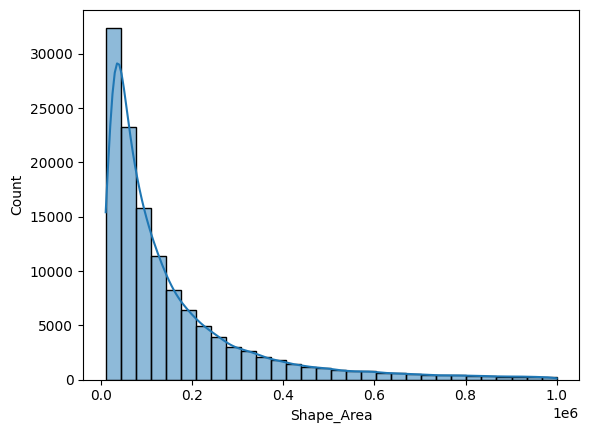

In [40]:
sns.histplot(all_block_df[(all_block_df['Shape_Area']<1000000) & (all_block_df['Shape_Area']>10000)]['Shape_Area'], bins=30, kde=True)

<Axes: xlabel='FSI', ylabel='Count'>

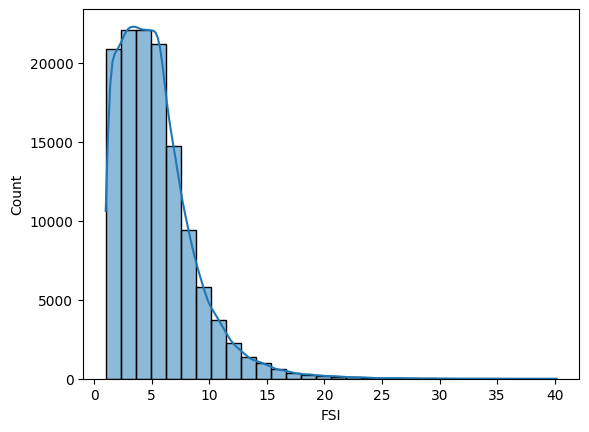

In [41]:
sns.histplot(all_block_df[(all_block_df['Shape_Area']<1000000) & (all_block_df['Shape_Area']>10000)]['FSI'], bins=30, kde=True)

<Axes: xlabel='GSI', ylabel='Count'>

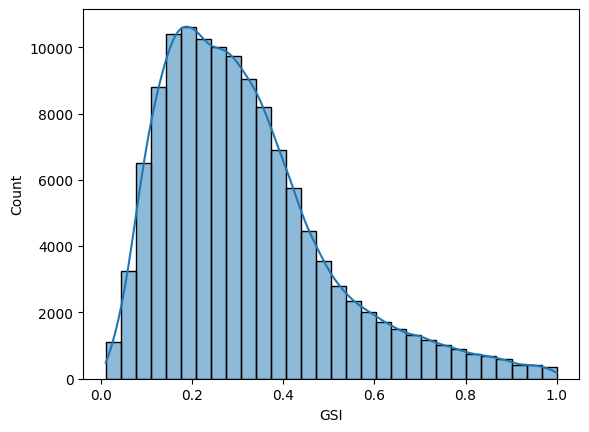

In [42]:
sns.histplot(all_block_df[(all_block_df['Shape_Area']<1000000) & (all_block_df['Shape_Area']>10000)]['GSI'], bins=30, kde=True)

### clustering

In [43]:
# define which year to use as base
building_metric_df = all_block_df[(all_block_df['Shape_Area']<1000000) & (all_block_df['Shape_Area']>10000)]
building_metric_df["mean_height"] = building_metric_df["FSI"]/building_metric_df["GSI"]

building_metric_df["building_FSI_normalized"] = building_metric_df["FSI"]/building_metric_df["FSI"].max()
building_metric_df["mean_height_normalized"] = building_metric_df["mean_height"]/building_metric_df["mean_height"].max()
building_metric_df["Shape_Area_normalized"] = building_metric_df["Shape_Area"]/building_metric_df["Shape_Area"].max()
#building_metric_df["dense_block"] = 0
#building_metric_df.loc[building_metric_df["GSI"]> 0.5,"dense_block"] = 1


In [45]:
kmeans = KMeans(n_clusters=7, random_state=48)
#kmeans.fit(building_metric_df[["building_FSI_normalized","building_GSI","mean_height_normalized","huge_block"]])
kmeans.fit(building_metric_df[["building_FSI_normalized","GSI","mean_height_normalized"]])
building_metric_df['cluster'] = kmeans.labels_
building_metric_gdf = gpd.GeoDataFrame(building_metric_df, geometry=building_metric_df['geometry'])

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


### Calculate silhouette values
silhouette_vals = silhouette_samples(building_metric_df[["building_FSI_normalized","GSI","mean_height_normalized"]], kmeans.labels_)
print("Silhouette values for each sample:\n", silhouette_vals)

### Calculate the mean silhouette score for all samples
mean_silhouette_score = silhouette_score(building_metric_df[["building_FSI_normalized","GSI","mean_height_normalized"]], kmeans.labels_)
print("Mean silhouette score:", mean_silhouette_score)

### merge the low dense

In [46]:
building_metric_gdf.loc[building_metric_gdf["cluster"] == 6,"cluster"] = 0
building_metric_df.loc[building_metric_df["cluster"] == 6,"cluster"] = 0

building_metric_df = building_metric_df[building_metric_df["GSI"]>0.05]
building_metric_gdf = building_metric_gdf[building_metric_gdf["GSI"]>0.05]

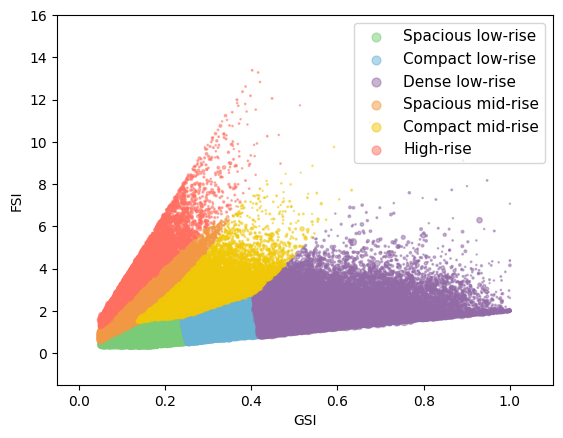

In [48]:
label_list = ["Dense low-rise", "Spacious mid-rise", "Compact low-rise","Spacious low-rise","Compact mid-rise","High-rise"]
ordered_label_list = ["Spacious low-rise","Compact low-rise","Dense low-rise", "Spacious mid-rise" ,"Compact mid-rise","High-rise"]

colors = ['#926AA6',"#F29844", '#68B3D4',  '#7ACB77','#F0C808',"#FF6F61"]  # Blue, Green, Gold, Red, 
cluster_colors = [colors[int(cluster)] for cluster in building_metric_df["cluster"]]

for i in range(len(ordered_label_list)):
    if i != -1:
        block_type = ordered_label_list[i]
        color_index = label_list.index(block_type)
        plot_df = building_metric_df[building_metric_df["cluster"] == color_index]
        plt.scatter(plot_df.GSI, plot_df.FSI/3,alpha = 0.5,s=5*plot_df["Shape_Area"]/plot_df["Shape_Area"].mean(),c=colors[color_index],label=f"{block_type}" )
plt.xlabel("GSI")
plt.ylabel("FSI")

plt.ylim(-1.5, 16)
plt.xlim(-0.05, 1.1)

# Create legend
legend = plt.legend(fontsize=11)
legend_handles = legend.legend_handles

# Set the marker size for each handle
marker_size = 40  # Change this value as needed
for handle in legend_handles:
    handle._sizes = [marker_size]

# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_cluster.png"), dpi=300, bbox_inches='tight')

plt.show()

### save for each city the result of clustered df

In [49]:
block_df_list = []

for i, city in enumerate(city_list):
    if len(block_year_list[i]) > 0:
        df_city = building_metric_df.loc[building_metric_df["city_id"] == i,:]
        #print(city)
        block_df_list.append([df_city])
        
        if not os.path.exists(os.path.join(block_categorized_singleYear_savepath,f"{city}_block_categorized.gpkg")):
            df_city.to_file((os.path.join(block_categorized_singleYear_savepath,f"{city}_block_categorized.gpkg")), driver='GPKG') 

### compare the block typology composation

In [50]:
building_metric_gdf['Block Type'] = building_metric_gdf['cluster'].map(lambda x: label_list[x])
building_metric_gdf['City'] = building_metric_gdf['city_id'].map(lambda x: city_list[x])
building_metric_gdf = building_metric_gdf[(building_metric_gdf['City']!="Nanning") &(building_metric_gdf['City']!="Baoding")]


building_metric_gdf['City'] = building_metric_gdf['City'] + building_metric_gdf['City'].map(lambda x: city_type_mapping[x])
building_metric_gdf.loc[building_metric_gdf['City'] == "Xi_an*",'City'] = "Xi'an*"


In [51]:
# Group by city_name and block_type, and get the size of each group
grouped = building_metric_gdf.groupby(['City', 'Block Type']).size().unstack(fill_value=0)

# Reorder the columns
grouped = grouped.reindex(columns=ordered_label_list)

# Calculate the percentage for each block type within each city
percentages = grouped.div(grouped.sum(axis=1), axis=0) * 100

# Order the cities by the number of blocks
total_blocks = grouped.sum(axis=1).sort_values(ascending=False).index
percentages = percentages.loc[total_blocks]

# Format the percentages to string representation with "%"
percentages = percentages.applymap(lambda x: f"{x:.0f}%")

percentages

Block Type,Spacious low-rise,Compact low-rise,Dense low-rise,Spacious mid-rise,Compact mid-rise,High-rise
City,,,,,,
Beijing⁺,22%,23%,27%,12%,12%,4%
Hangzhou*,34%,29%,14%,12%,8%,2%
Shanghai⁺,24%,31%,12%,13%,17%,3%
Foshan,16%,23%,52%,3%,4%,2%
Chengdu*,24%,29%,18%,14%,11%,5%
Shenzhenᵉ,21%,26%,27%,9%,10%,7%
Suzhou,31%,37%,18%,8%,5%,2%
Guangzhou*,17%,20%,44%,4%,10%,5%
Xi'an*,20%,20%,29%,11%,13%,6%


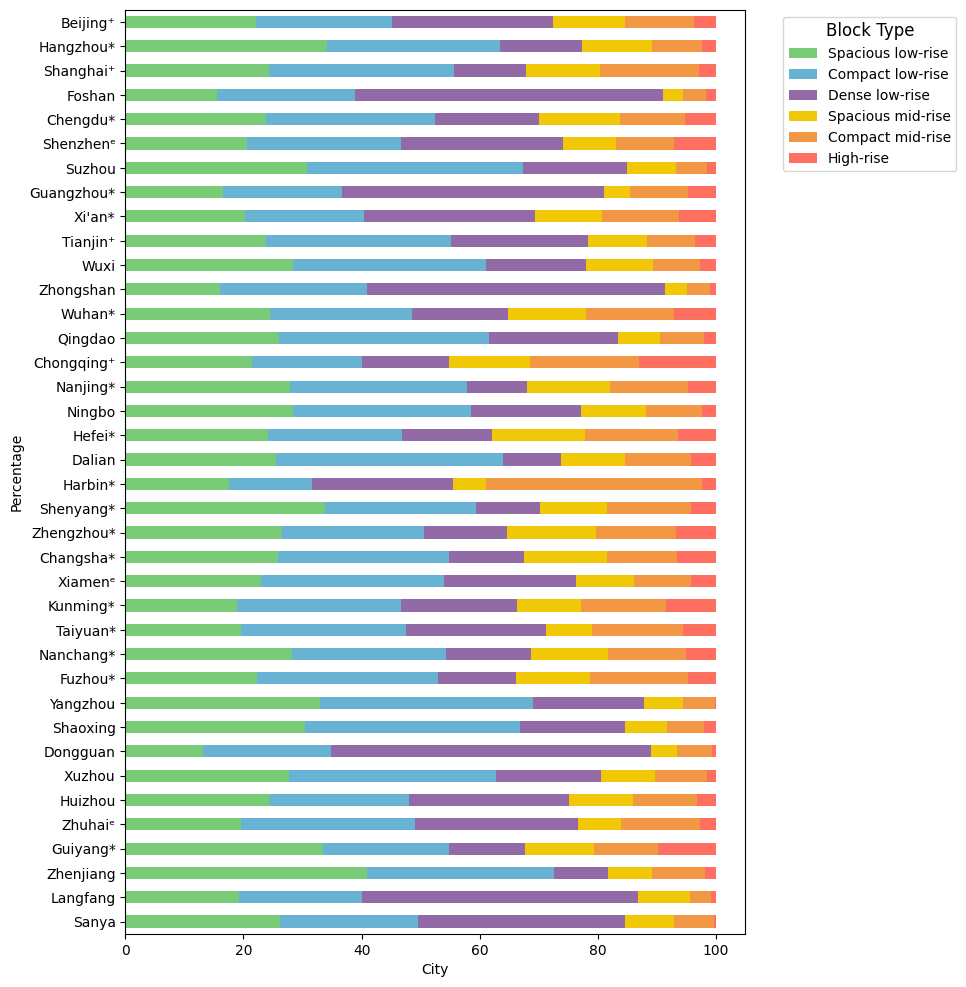

In [52]:
# Define colors for each block type
colors = [ '#7ACB77','#68B3D4','#926AA6','#F0C808', "#F29844", "#FF6F61"]


# Calculate the percentage for each block type within each city
percentages = grouped.div(grouped.sum(axis=1), axis=0) * 100

# Order the cities by the number of blocks
total_blocks = grouped.sum(axis=1).sort_values(ascending=True).index
percentages = percentages.loc[total_blocks]

# Plotting the stacked bar plot
ax = percentages.plot(kind='barh', stacked=True, color=colors, figsize=(8,12))

# Adding labels and title
ax.set_ylabel('Percentage')
ax.set_xlabel('City')
#ax.set_title('Percentage of Each Block Type per City')
plt.legend(title='Block Type', bbox_to_anchor=(1.05, 1), loc='upper left', title_fontsize=12)


# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_percentages.png"), dpi=300, bbox_inches='tight')

plt.show()


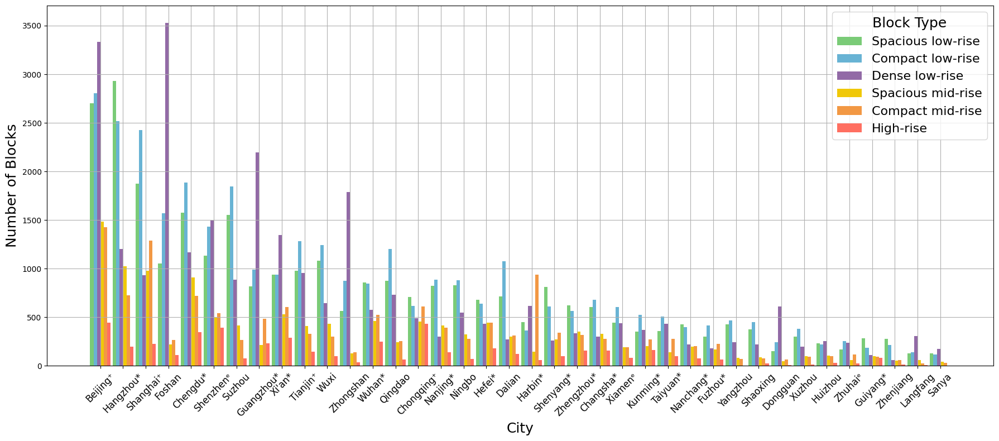

In [55]:
# Define colors for each block type
colors = ['#7ACB77', '#68B3D4', '#926AA6', '#F0C808', "#F29844", "#FF6F61"]

# Order the cities by the number of blocks
total_blocks = grouped.sum(axis=1).sort_values(ascending=False).index
absolute_values = grouped.loc[total_blocks]

# Plotting the overpred as side-by-side bar plots
fig, ax = plt.subplots(figsize=(18, 8))

# Setting the bar width
bar_width = 0.15
# Number of columns
n_cols = len(absolute_values.columns)
# Indices for the x-axis
indices = range(len(absolute_values))

# Plotting each block type
for i, (col, color) in enumerate(zip(absolute_values.columns, colors)):
    ax.bar([x + i * bar_width for x in indices], absolute_values[col], color=color, width=bar_width, label=col)

# Adding grid lines
ax.grid(True)

# Adding labels and title
ax.set_xlabel('City', fontsize=18)
ax.set_ylabel('Number of Blocks', fontsize=18)
plt.legend(title='Block Type', loc='upper right', fontsize=16, title_fontsize=18)
plt.xticks([x + (n_cols - 1) * bar_width / 2 for x in indices], absolute_values.index, rotation=45, fontsize=12)
plt.tight_layout()

# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path, "4.1_num.png"), dpi=300, bbox_inches='tight')

plt.show()


### line plot, not used anymore

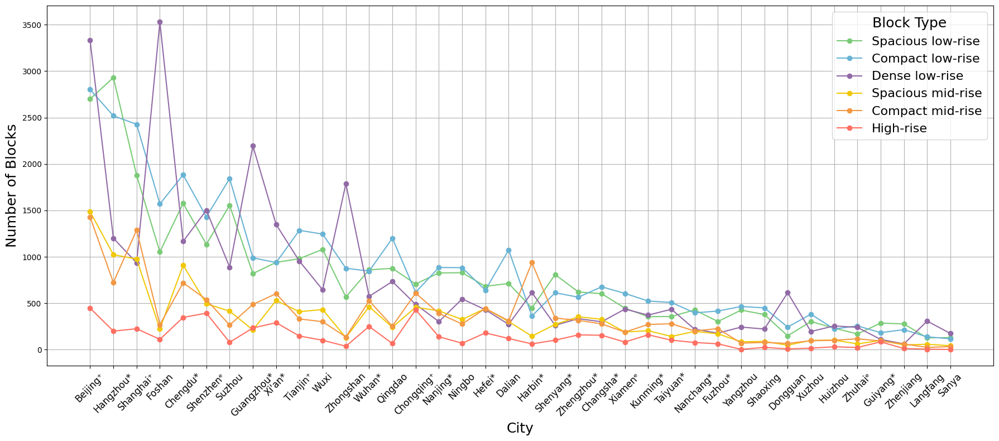

In [56]:
### Define colors for each block type
colors = ['#7ACB77', '#68B3D4', '#926AA6', '#F0C808', "#F29844", "#FF6F61"]

### Order the cities by the number of blocks
total_blocks = grouped.sum(axis=1).sort_values(ascending=False).index
absolute_values = grouped.loc[total_blocks]

### Plotting the line plot
fig, ax = plt.subplots(figsize=(18, 8))
for col, color in zip(absolute_values.columns, colors):
    ax.plot(absolute_values.index, absolute_values[col], marker='o', color=color, label=col)

### Adding grid lines
ax.grid(True)

### Adding labels and title
ax.set_xlabel('City', fontsize=18)
ax.set_ylabel('Number of Blocks', fontsize=18)
#ax.set_title('Number of Each Block Type per City')
plt.legend(title='Block Type', loc='upper right', fontsize=16, title_fontsize=18)
plt.xticks(rotation=45, fontsize=12)
plt.tight_layout()

### Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_num.png"), dpi=300, bbox_inches='tight')

plt.show()

### final version: append also the invalid urban blocks and mark in cluster as -1

In [58]:
block_df_list = []

for i in range(len(city_list)):
    city_df = building_metric_gdf.loc[building_metric_gdf["city_id"] == i,:].copy()
    print(city_list[i],city_df.shape)
    
    if city_df.shape[0] == 0:
        block_df_list.append([])
        
    else:
        city_df_all = block_df_original_list[i][0]
        city_df_all = city_df_all.dropna()
        city_df_all["city_id"] = i
        city_df_all["cluster"] = -1

        # To get rows of city_df_all where the column "block_id" is not in the "block_id" column of city_df
        city_df_non_urban = city_df_all[~city_df_all['block_id'].isin(city_df['block_id'])]
        block_df = pd.concat([city_df,city_df_non_urban],axis=0)
        
        block_df_list.append([block_df])

Baoding (0, 13)
Beijing (12192, 13)
Changsha (2339, 13)
Chengdu (6603, 13)
Chongqing (3309, 13)
Dalian (2793, 13)
Dongguan (1128, 13)
Foshan (6754, 13)
Fuzhou (1357, 13)
Guangzhou (4936, 13)
Guiyang (855, 13)
Hangzhou (8598, 13)
Harbin (2571, 13)
Hefei (2820, 13)
Huizhou (945, 13)
Kunming (1886, 13)
Langfang (660, 13)
Nanchang (1519, 13)
Nanjing (2960, 13)
Nanning (0, 13)
Ningbo (2928, 13)
Qingdao (3370, 13)


/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

Sanya (498, 13)
Shanghai (7729, 13)
Shaoxing (1240, 13)
Shenyang (2398, 13)
Shenzhen (5493, 13)
Suzhou (5046, 13)
Taiyuan (1823, 13)
Tianjin (4106, 13)
Wuhan (3518, 13)
Wuxi (3804, 13)
Xi_an (4648, 13)
Xiamen (1951, 13)
Xuzhou (1092, 13)
Yangzhou (1292, 13)
Zhengzhou (2349, 13)
Zhenjiang (678, 13)
Zhongshan (3536, 13)
Zhuhai (867, 13)


/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

### chinese name mapping

In [59]:
city_list_ch = [city_mapping[city] for city in city_list]

## b. load the accessible block

In [60]:
block_accessibility_list = []
for city in city_list:
    block_accessibility_list.append(pd.read_csv(os.path.join(accessible_block_path,f"{city}-accessible_blocks.csv")))

## c. load poi dataset

In [61]:
geomaster_path = "/data-sat-img/postprocessed/mujiang/geobound_master/"
geomaster = pd.read_csv(geomaster_path + "lookup_table.csv")
geomaster_selected = geomaster[["MID_m","地级","省级"]]

class1_map = pd.read_csv(poi_summary_path + "class1_map.csv")

In [62]:
poi_df_list = []
poi_year_list = []

for i, city in enumerate(city_list):
    city_ch = city_list_ch[i]
    poi_dfs = []
    poi_years = []
    
    for year in year_list:
        MID_city = geomaster_selected.loc[geomaster_selected["地级"] == city_list_ch[i]]["MID_m"].values.min()
        file_path = os.path.join(poi_city_path,f"{MID_city}_{city_ch}",f"{year}_{MID_city}_{city_ch}.csv")
        
        if os.path.exists(file_path):
            print(file_path)
            poi_df = pd.read_csv(os.path.join(file_path),encoding = "utf-8-sig")
            poi_df["poi_id"] = poi_df.index
            
            ### attach calss 1 label
            poi_df = pd.merge(poi_df,class1_map,on = "class1",how = "left")
            
            poi_dfs.append(poi_df)
            poi_years.append(year)
    
    poi_df_list.append(poi_dfs)
    poi_year_list.append(poi_years)

/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/127_北京市/2019_127_北京市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/241_长沙市/2019_241_长沙市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/139_成都市/2019_139_成都市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/54_重庆市/2019_54_重庆市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/322_大连市/2019_322_大连市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/212_东莞市/2019_212_东莞市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/121_佛山市/2019_121_佛山市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/106_福州市/2019_106_福州市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/161_广州市/2019_161_广州市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/274_贵阳市/2019_274_贵阳市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/96_杭州市/2019_96_杭州市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/4_哈尔滨市/2019_4_哈尔滨市.csv
/data-sat-img/postprocessed/mujiang/POI/cities_wgs84/70_合肥市/2019_70_合肥

## reclassify poi data based on the new paper: 
### 1: work dimensions (the location of companies and enterprises), 
### 2: financial and commercial dimensions (banking and financial institutions as well as shopping)
### 3: amenities (for leisure, entertainment, cultural venues, restaurants, etc.) 
### 4: medical services
### 5: education (schools and universities).

In [63]:
for i, city in enumerate(city_list):
    if len(poi_df_list[i]) > 0:
        test_df = poi_df_list[i][0]
        
        test_df.loc[:,["class1_label"]] = -1
        test_df.loc[test_df["class1"] == "公司企业",["class1_label"]] = 1
        
        test_df.loc[test_df["class1"] == "银行金融",["class1_label"]] = 2
        test_df.loc[test_df["class1"] == "购物",["class1_label"]] = 2

        test_df.loc[test_df["class1"] == "美食",["class1_label"]] = 3
        test_df.loc[test_df["class1"] == "休闲娱乐",["class1_label"]] = 3
        test_df.loc[test_df["class1"] == "生活服务",["class1_label"]] = 3
        test_df.loc[test_df["class1"] == "文化场馆",["class1_label"]] = 3
        
        test_df.loc[test_df["class1"] == "医疗保健",["class1_label"]] = 4

        test_df.loc[test_df["class1"] == "教育学校",["class1_label"]] = 5
        
        
        poi_df_list[i][0] = test_df

# 2. sptatial join poi to blocks

In [64]:
joined_gdf_list = []
joined_year_list = []

for i, city in enumerate(city_list):
    city_ch = city_list_ch[i]
    joined_gdfs = []
    joined_years = []
    
    for year in year_list:
        if (year in poi_year_list[i]) & (year in block_year_list[i]):
            joined_years.append(year)
            block_index = block_year_list[i].index(year)
            poi_index = poi_year_list[i].index(year)
            
            block_gdf = block_df_list[i][block_index]
            block_gdf = block_gdf.to_crs("epsg:4326")
            
            poi_df = poi_df_list[i][poi_index]
            poi_gdf = gpd.GeoDataFrame(poi_df, geometry=gpd.points_from_xy(poi_df.lon, poi_df.lat))
            poi_gdf = poi_gdf.set_crs(block_gdf.crs, allow_override=True)
            
            joined_gdf = gpd.sjoin(block_gdf,poi_gdf, how="inner", predicate='intersects')
            joined_gdfs.append(joined_gdf)
    
    joined_gdf_list.append(joined_gdfs)
    joined_year_list.append(joined_years)

# 3. calculate for each block the count of POI, for each type of POI

In [65]:
poi_class1_list = []
block_gdf_joined_poi_list = []

for i, city in enumerate(city_list):
    city_ch = city_list_ch[i]
    
    poi_class1_years = []
    block_gdf_joined_poi_city = []
    
    for year_index, year in enumerate(joined_year_list[i]):
        joined_gdf = joined_gdf_list[i][year_index]
        block_gdf = block_df_list[i][year_index]
        
        poi_class1_year = joined_gdf["class1_label"].unique()
        poi_class1_year = [x for x in poi_class1_year if not np.isnan(x)]
        poi_class1_year = [int(x) for x in poi_class1_year]
        poi_class1_year.sort()
        poi_class1_years.append(poi_class1_year)
        
        grouped_class1_df_list = []
        poi_column_list = []
        
        # aggregate on the class of poi for each year
        for poi_class1 in poi_class1_year:
            poi_column_list.append(f"poi_count_{poi_class1}")
            sub_joined_gdf = joined_gdf.loc[joined_gdf["class1_label"] == poi_class1, :]
            grouped_df = sub_joined_gdf.groupby(by="block_id",as_index = False).count()
            grouped_df[f"poi_count_{poi_class1}"] = grouped_df["GSI"]
            grouped_df = grouped_df[["block_id",f"poi_count_{poi_class1}"]]
            grouped_class1_df_list.append(grouped_df)
        
        # join back the count for each poi class back to the block_gdf
        block_gdf_joined_poi = block_gdf.copy()
        for grouped_class1_df in grouped_class1_df_list:
            block_gdf_joined_poi = pd.merge(block_gdf_joined_poi,grouped_class1_df,on = "block_id",how="left")

        # fill nan
        block_gdf_joined_poi = block_gdf_joined_poi.fillna(0)

        # add a sum of counts for selcected kinds of poi
        #block_gdf_joined_poi["poi_count_sum"] = block_gdf_joined_poi[['poi_count_1','poi_count_3', 'poi_count_4', 'poi_count_5','poi_count_7']].sum(axis=1)
        block_gdf_joined_poi["poi_count_sum"] = block_gdf_joined_poi[['poi_count_1','poi_count_2', 'poi_count_3', 'poi_count_4', 'poi_count_5']].sum(axis=1)
        
        
        block_gdf_joined_poi_city.append(block_gdf_joined_poi)
    
    block_gdf_joined_poi_list.append(block_gdf_joined_poi_city)
    poi_class1_list.append(poi_class1_years)
    

In [67]:
poi_columns = ["Shape_Area","built_area","floor_area","poi_count_1","poi_count_2","poi_count_3","poi_count_4","poi_count_5"]
data = []

# Loop through the list
for i in range(len(block_gdf_joined_poi_list)):
    if len(block_gdf_joined_poi_list[i]) > 0:
        # Sum the specified columns
        block_gdf_joined_poi_list[i][0]["built_area"] = block_gdf_joined_poi_list[i][0]["Shape_Area"] * block_gdf_joined_poi_list[i][0]["GSI"]
        block_gdf_joined_poi_list[i][0]["floor_area"] = block_gdf_joined_poi_list[i][0]["Shape_Area"] * block_gdf_joined_poi_list[i][0]["FSI"]
        
        sum_list = list(block_gdf_joined_poi_list[i][0][poi_columns].sum(axis=0))
        count_list = list(block_gdf_joined_poi_list[i][0][poi_columns].count(axis=0))
        
        # Create a dictionary for the current city
        city_data = {
            "City": city_list[i],
            "Size of the study area": sum_list[0]/1000000,
            "Number of blocks": count_list[2],
            "Built area": sum_list[1]/1000000,
            "Total floor area": sum_list[2]/1000000,
            "Count of POI: work": sum_list[-5],
            "Count of POI: financial and commercial": sum_list[-4],
            "Count of POI: amenities": sum_list[-3],
            "Count of POI: medical services": sum_list[-2],
            "Count of POI: education": sum_list[-1]           
        }
        
        # Append the dictionary to the list
        data.append(city_data)

# Convert the list of dictionaries to a DataFrame
poi_count_df = pd.DataFrame(data, columns=["City", "Size of the study area", "Number of blocks", "Built area","Total floor area","Count of POI: work","Count of POI: financial and commercial","Count of POI: amenities","Count of POI: medical services","Count of POI: education"])

poi_count_df = poi_count_df.sort_values(by="Size of the study area",ascending=False)
poi_count_df

,City,Size of the study area,Number of blocks,Built area,Total floor area,Count of POI: work,Count of POI: financial and commercial,Count of POI: amenities,Count of POI: medical services,Count of POI: education
0,Beijing,10651.849782,28575,927.333608,12187.683635,245164.0,372012.0,344824.0,35087.0,45358.0
30,Xi_an,7596.891145,12711,476.732873,6753.098055,56896.0,189925.0,185344.0,17078.0,18648.0
23,Shenyang,5554.574017,6679,276.991437,4346.106520,41640.0,123001.0,130590.0,13863.0,14989.0
11,Harbin,5190.734207,7396,291.537510,4204.553479,27361.0,81559.0,101398.0,10449.0,10257.0
2,Chengdu,4428.119798,20391,319.810963,5200.804311,113419.0,322845.0,317905.0,32924.0,23559.0
32,Xuzhou,4299.641733,3585,358.398675,3152.045587,18783.0,63902.0,58763.0,6727.0,7349.0
27,Tianjin,3999.413896,11269,385.556883,4883.864100,58808.0,124424.0,119002.0,12461.0,12071.0
21,Shanghai,3826.587085,16900,492.914591,8012.272477,304681.0,355129.0,335193.0,23506.0,35543.0
9,Guiyang,3744.617947,5373,88.981452,1281.486794,23369.0,71458.0,69670.0,7751.0,6991.0
10,Hangzhou,3429.718204,20720,348.331646,5237.884756,111638.0,186969.0,188750.0,13213.0,18535.0


# 4. calculate for each block the distance weighted acceesible POI count

### how the function look like

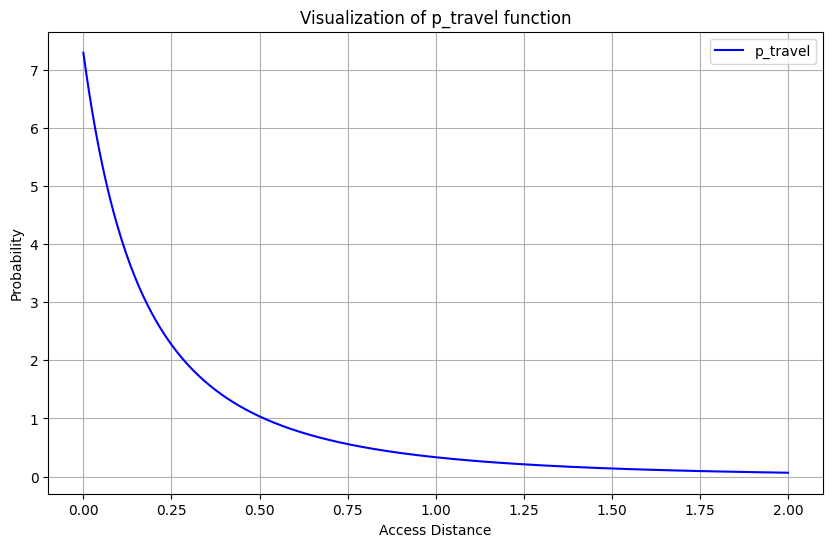

In [68]:
# Define the function with the given parameters
def p_travel(access_distance, beta=1.65, k=1.5, r0=0.3):
    return 1 / (math.pow((access_distance + r0), beta)) * math.exp(-access_distance / k)

# Generate a range of access_distance values
access_distances = np.linspace(0, 2,500)  # from 0 to 10000 with 500 points

# Calculate the corresponding p_travel values
p_travel_values = [p_travel(d) for d in access_distances]

# Plot the function
plt.figure(figsize=(10, 6))
plt.plot(access_distances, p_travel_values, label='p_travel', color='b')
plt.xlabel('Access Distance')
plt.ylabel('Probability')
plt.title('Visualization of p_travel function')
plt.legend()
plt.grid(True)
plt.show()

In [69]:
def create_attractiveness_df(block_gdf_joined_poi,block_accessibility_df,beta=1.65, k=1.5, r0=1.5):

    flow_list = []
    flow1_list = []
    flow2_list = []
    flow3_list = []
    flow4_list = []
    flow5_list = []
    #flow7_list = []
    
    avg_fsi_list = []
    avg_gsi_list = []
    avg_fsi_1000_list = []
    avg_gsi_1000_list = []
    avg_fsi_500_list = []
    avg_gsi_500_list = []
    
    for index,row in tqdm(block_accessibility_df.iterrows(), total=len(block_accessibility_df)):
        block_id = row["block_id"]

        #m_o = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == block_id, "poi_count_sum"].item()       
        flow = 0
        flow1 = 0
        flow2 = 0
        flow3 = 0
        flow4 = 0
        flow5 = 0
        #flow7 = 0

        avg_fsi = 0
        avg_gsi = 0
        total_area = 0

        avg_fsi_1000 = 0
        avg_gsi_1000 = 0
        total_area_1000 = 0


        avg_fsi_500 = 0
        avg_gsi_500 = 0
        total_area_500 = 0
        
        row["accessible_blocks"] = ast.literal_eval(row["accessible_blocks"])
        for accessible_block_id, access_distance in row["accessible_blocks"].items():
            if accessible_block_id in list(block_gdf_joined_poi["block_id"]):
                m_d = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "poi_count_sum"].item()       
                m_d1 = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "poi_count_1"].item()
                m_d2 = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "poi_count_2"].item()
                m_d3 = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "poi_count_3"].item()  
                m_d4 = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "poi_count_4"].item()  
                m_d5 = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "poi_count_5"].item()
                #m_d7 = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "poi_count_7"].item()
            
                p_travel = 1 / math.pow((access_distance/1000+r0),beta) * math.exp(-access_distance/1000/k)

                p_od = m_d * p_travel
                p_od1 = m_d1 * p_travel
                p_od2 = m_d2 * p_travel
                p_od3 = m_d3 * p_travel
                p_od4 = m_d4 * p_travel
                p_od5 = m_d5 * p_travel
                #p_od7 = m_d7 /math.pow((access_distance+1),beta) 

                flow += p_od
                flow1 += p_od1
                flow2 += p_od2
                flow3 += p_od3
                flow4 += p_od4
                flow5 += p_od5
                #flow7 += p_od7


                block_fsi = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "FSI"].item()
                block_gsi = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "GSI"].item()
                area = block_gdf_joined_poi.loc[block_gdf_joined_poi["block_id"] == accessible_block_id, "Shape_Area"].item()

                avg_fsi += block_fsi*area
                avg_gsi += block_gsi*area
                total_area += area
            
                if access_distance<1000:
                    avg_fsi_1000 += block_fsi*area
                    avg_gsi_1000 += block_gsi*area
                    total_area_1000 += area

                if access_distance<500:
                    avg_fsi_500 += block_fsi*area
                    avg_gsi_500 += block_gsi*area
                    total_area_500 += area
                
        flow_list.append(flow)
        flow1_list.append(flow1)
        flow2_list.append(flow2)
        flow3_list.append(flow3)
        flow4_list.append(flow4)
        flow5_list.append(flow5)
        #flow7_list.append(flow7)

        avg_fsi_list.append(avg_fsi/(total_area+1))
        avg_gsi_list.append(avg_gsi/(total_area+1))
        
        if total_area_1000 > 0:
            avg_fsi_1000_list.append(avg_fsi_1000/total_area_1000)
            avg_gsi_1000_list.append(avg_gsi_1000/total_area_1000)
        else:
            avg_fsi_1000_list.append(avg_fsi/(total_area+1))
            avg_gsi_1000_list.append(avg_gsi/(total_area+1))
        
        if total_area_500 > 0:            
            avg_fsi_500_list.append(avg_fsi_500/total_area_500)
            avg_gsi_500_list.append(avg_gsi_500/total_area_500)
        else:
            avg_fsi_500_list.append(avg_fsi/(total_area+1))
            avg_gsi_500_list.append(avg_gsi/(total_area+1))
            
    flow_df = block_accessibility_df.copy()
    flow_df["flow"] = flow_list
    flow_df["flow1"] = flow1_list
    flow_df["flow2"] = flow2_list
    flow_df["flow3"] = flow3_list
    flow_df["flow4"] = flow4_list
    flow_df["flow5"] = flow5_list
    #flow_df["flow7"] = flow7_list


    flow_df["avg_fsi_1500"] = avg_fsi_list
    flow_df["avg_gsi_1500"] = avg_gsi_list
    flow_df["avg_fsi_1000"] = avg_fsi_1000_list
    flow_df["avg_gsi_1000"] = avg_gsi_1000_list
    flow_df["avg_fsi_500"] = avg_fsi_500_list
    flow_df["avg_gsi_500"] = avg_gsi_500_list
    
    return flow_df

In [ ]:
atn_df_list = []
atn_city_list = []
version = "paper_new"
force = False

for i, city in enumerate(city_list):
    city_ch = city_list_ch[i]
    atn_dfs = []

    for year_index, year in enumerate(joined_year_list[i]):
        print(city, year)
        if os.path.exists(os.path.join(atn_df_savepath,f"{city}-{year}{version}.csv")) and force == False:
            atn_df = pd.read_csv(os.path.join(atn_df_savepath,f"{city}-{year}{version}.csv"))
        else:
            accessibility_df = block_accessibility_list[i]
            
            joined_gdf_non_zero = block_gdf_joined_poi_list[i][year_index][block_gdf_joined_poi_list[i][year_index]["poi_count_sum"]>0]
            print(joined_gdf_non_zero.shape)
            block_ids = joined_gdf_non_zero["block_id"]
            # Filter accessibility_df to only include rows where 'block_id' is in block_ids
            filtered_accessibility_df = accessibility_df[accessibility_df["block_id"].isin(block_ids)]
            atn_df = create_attractiveness_df(joined_gdf_non_zero,filtered_accessibility_df)
            atn_df.to_csv(os.path.join(atn_df_savepath,f"{city}-{year}{version}.csv"))
        atn_dfs.append(atn_df)
    
    atn_df_list.append(atn_dfs)
    atn_city_list.append(city)

Beijing 2019
(15257, 22)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14632/14632 [24:45<00:00,  9.85it/s]


Changsha 2019
(3407, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3185/3185 [03:04<00:00, 17.26it/s]


Chengdu 2019
(10007, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9645/9645 [14:36<00:00, 11.01it/s]


Chongqing 2019
(3714, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3550/3550 [03:17<00:00, 17.99it/s]


Dalian 2019
(3139, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3030/3030 [04:35<00:00, 11.01it/s]


Dongguan 2019
(1429, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1273/1273 [01:02<00:00, 20.42it/s]


Foshan 2019
(8021, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7793/7793 [09:28<00:00, 13.70it/s]


Fuzhou 2019
(1795, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1662/1662 [01:45<00:00, 15.80it/s]


Guangzhou 2019
(6295, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5954/5954 [07:04<00:00, 14.02it/s]


Guiyang 2019
(1548, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1469/1469 [00:48<00:00, 30.16it/s]


Hangzhou 2019
(9862, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9454/9454 [15:12<00:00, 10.36it/s]


Harbin 2019
(3059, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2964/2964 [04:36<00:00, 10.71it/s]


Hefei 2019
(3386, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3278/3278 [03:04<00:00, 17.73it/s]


Huizhou 2019
(1425, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1357/1357 [01:10<00:00, 19.26it/s]


Kunming 2019
(2463, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2348/2348 [02:26<00:00, 16.02it/s]


Langfang 2019
(743, 22)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 702/702 [00:20<00:00, 34.68it/s]


Nanchang 2019
(2114, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1947/1947 [01:31<00:00, 21.21it/s]


Nanjing 2019
(3635, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3485/3485 [03:19<00:00, 17.49it/s]


Ningbo 2019
(3743, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3594/3594 [03:56<00:00, 15.18it/s]


Qingdao 2019
(3933, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3774/3774 [05:47<00:00, 10.85it/s]


Sanya 2019
(630, 22)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 597/597 [00:20<00:00, 29.74it/s]


Shanghai 2019
(9795, 22)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9425/9425 [17:01<00:00,  9.22it/s]


Shaoxing 2019
(1583, 22)


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1509/1509 [01:00<00:00, 24.79it/s]


Shenyang 2019
(3421, 22)


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3331/3331 [04:30<00:00, 12.32it/s]


Shenzhen 2019
(6969, 22)


  1%|██                                                                                                                                                                     | 78/6486 [00:07<15:05,  7.08it/s]

### check cities where results are created successfully

In [1613]:
valid_city_list = []
for i in range(len(atn_city_list)):
    if len(joined_year_list[i]) > 0:
        valid_city_list.append(atn_city_list[i])
    else:
        print(atn_city_list[i], "is not valid")

print(len(valid_city_list),valid_city_list)

Baoding is not valid
Nanning is not valid
38 ['Beijing', 'Changsha', 'Chengdu', 'Chongqing', 'Dalian', 'Dongguan', 'Foshan', 'Fuzhou', 'Guangzhou', 'Guiyang', 'Hangzhou', 'Harbin', 'Hefei', 'Huizhou', 'Kunming', 'Langfang', 'Nanchang', 'Nanjing', 'Ningbo', 'Qingdao', 'Sanya', 'Shanghai', 'Shaoxing', 'Shenyang', 'Shenzhen', 'Suzhou', 'Taiyuan', 'Tianjin', 'Wuhan', 'Wuxi', 'Xi_an', 'Xiamen', 'Xuzhou', 'Yangzhou', 'Zhengzhou', 'Zhenjiang', 'Zhongshan', 'Zhuhai']


### export all built area

In [1618]:
built_block_list = []

for i in range(len(atn_city_list)):
    if (len(joined_year_list[i]) > 0):
        block_df = block_df_list[i][0]
        
        print(atn_city_list[i])
        built_df = block_df[block_df["cluster"] != -1]
        #built_df = block_df[block_df["area"] <= 100000000]
        #built_df = block_df[block_df["GSI"] > 0.05]
        print(built_df["GSI"].min())
        print("total number of blocks before filtering",block_df.shape[0])
        print("total number of blocks after filtering",built_df.shape[0])
        
        built_block_list.append(built_df)

built_df_all = pd.concat(built_block_list, axis=0)
built_df_all.to_file(os.path.join(built_area_savepath,f"built_area_all.shp"))

Beijing
0.05031982942430704
total number of blocks before filtering 28575
total number of blocks after filtering 12192
Changsha
0.050411522633744855
total number of blocks before filtering 8709
total number of blocks after filtering 2339
Chengdu
0.05029585798816568
total number of blocks before filtering 20391
total number of blocks after filtering 6603
Chongqing
0.05146888734674994
total number of blocks before filtering 12486
total number of blocks after filtering 3309
Dalian
0.05042816365366318
total number of blocks before filtering 4755
total number of blocks after filtering 2793
Dongguan
0.05327605278728166
total number of blocks before filtering 3275
total number of blocks after filtering 1128
Foshan
0.05098462368492042
total number of blocks before filtering 15278
total number of blocks after filtering 6754
Fuzhou
0.05064087442006763
total number of blocks before filtering 4411
total number of blocks after filtering 1357
Guangzhou
0.05150501672240803
total number of blocks befo

/tmp/ipykernel_1830125/764196097.py:18: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  built_df_all.to_file(os.path.join(built_area_savepath,f"built_area_all.shp"))


## regression with all cities

In [1619]:
def create_Linear_regression(df, x_list, plot_cat="flow", area_cap=1000000, min_FSI=0):
    # Filter the dataframe based on area and FSI
    df = df[df["Shape_Area"] < area_cap]
    df = df[df["FSI"] > min_FSI]
    df = df[df["cluster"] != -1]
    
    df = df[~(pd.isna(df[plot_cat]) | np.isinf(df[plot_cat]))]

    # Select relevant columns
    var_list = x_list.copy()
    var_list.append(plot_cat)
    df = df[var_list + [col for col in df.columns if col.startswith('city_dummy')]]

    # Ensure all data is numeric
    df = df.apply(pd.to_numeric, errors='coerce')

    # Drop rows with any NaN values
    df = df.dropna()

    print(df.shape)

    # Define the target variable
    y = df[plot_cat]

    # Convert 'city_dummy' to dummy variables
    df = pd.get_dummies(df, columns=[col for col in df.columns if col.startswith('city_dummy')], drop_first=True)

    # Define the feature set
    X = df[x_list + [col for col in df.columns if col.startswith('city_dummy')]]
    print(X.columns)

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Add a constant to the model (intercept)
    X_train = sm.add_constant(X_train)
    X_test = sm.add_constant(X_test)

    # Ensure the data type is correct (float64)
    X_train = X_train.astype(float)
    X_test = X_test.astype(float)
    y_train = y_train.astype(float)
    y_test = y_test.astype(float)

    # Fit the OLS model on the training data
    model = sm.OLS(y_train, X_train)
    results = model.fit()

    # Print the summary of the model
    print(results.summary())
    
    # Print the p-values for each coefficient
    #print("P-values for each coefficient:\n", results.pvalues)
    
    # Make predictions on the test set
    y_pred = results.predict(X_test)

    # Evaluate the model using Mean Squared Error
    mse = mean_squared_error(y_test, y_pred)
    print(f'Mean Squared Error: {mse}')

    # Access the intercept and coefficients
    intercept = results.params['const']
    coefficients = results.params.drop('const')


    return intercept, coefficients

In [1620]:
def create_NegativeBinomial_regression(df,x_list,plot_cat = "flow4",area_cap=100000000,min_FSI=0,plot_city = 1):

    df = df[df["Shape_Area"]<area_cap]
    df = df[df["FSI"]>min_FSI]
    df = df[df["cluster"]!=-1]
    df = df[df[plot_cat]>0]
    
    var_list = x_list.copy()
    var_list.append(plot_cat)
    df_all = df[var_list+ [col for col in df.columns if col.startswith('city_dummy')]]
    
    # Ensure all data is numeric
    #df_all = df_all.apply(pd.to_numeric, errors='coerce')

    # Drop rows with any NaN values
    #df_all = df_all.dropna()
    

    # Define your target variable
    y = df_all[plot_cat]
    
    city_index = df_all[df_all['city_dummy'] == plot_city].index

    # Convert 'city_dummy' to dummy variables
    df_all = pd.get_dummies(df_all, columns=['city_dummy'], drop_first=True)
    
    # select df for the city
    df_city = df_all.loc[city_index].copy()

    block_id_city = df.loc[city_index,"block_id"]
    block_plot_cat_city = df.loc[city_index,plot_cat]

    
    # Define your feature set after creating dummy variables
    X = df_all[x_list + [col for col in df_all.columns if col.startswith('city_dummy')]]
    
    # create X for the city
    X_city = X.loc[city_index].copy()
    X_city = sm.add_constant(X_city)  

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Add a constant to the model (intercept)
    X_train = sm.add_constant(X_train)
    X_test = sm.add_constant(X_test)  
    
    # Ensure the data type is correct (float64)
    X_train = X_train.astype(float)
    X_test = X_test.astype(float)
    y_train = y_train.astype(float)
    y_test = y_test.astype(float)
    
    # Fit the Negative Binomial model on the training data
    model = sm.GLM(y_train, X_train, family=sm.families.NegativeBinomial())
    results = model.fit()

    # Print the summary of the model
    print(results.summary())

    # Make predictions on the test set
    y_pred = results.predict(X_test)

    # Evaluate the model (e.g., using Mean Squared Error)
    from sklearn.metrics import mean_squared_error
    mse = mean_squared_error(y_test, y_pred)
    print(f'Mean Squared Error: {mse}')

    # Access the intercept and coefficients
    #intercept = results.params['const']
    #coefficients = results.params.drop('const')

    # Plotting the fitted curve
    plt.figure(figsize=(10, 6))

    # Plot actual data points
    plt.scatter(df_city[x_list[0]], df_city[plot_cat], s = 1, label=f'Actual data for city {city_list[plot_city]}')

    # Generate a range of values for the predictor variable
    x_values = np.linspace(df_city[x_list[0]].min(), df_city[x_list[0]].max(), 100)
    X_plot = pd.DataFrame({x_list[0]: x_values})
    
    # Add constant and other predictors set to their mean values
    for col in X.columns:
        if col != x_list[0]:
            X_plot[col] = 0
        if plot_city != 1:
            if col == f"city_dummy_{plot_city}":
                print(f"plot for city {city_list[plot_city]}")
                X_plot[col] = 1
    X_plot = sm.add_constant(X_plot,has_constant='add')
    
    print(X_plot.columns)
    
    # Predict using the model
    y_plot_pred = results.predict(X_plot)

    # Plot the fitted curve
    plt.plot(x_values, y_plot_pred, color='red', label='Fitted curve')

    plt.xlabel(x_list[0])
    plt.ylabel(plot_cat)
    plt.title('Negative Binomial Regression Fit')
    plt.legend()
    plt.show()
    
    X_city = X_city.astype(float)
    city_pred = results.predict(X_city)
    
    # Create a DataFrame from the lists
    result_df = pd.DataFrame({
        'block_id': block_id_city,
        'pred': city_pred,
        f'{plot_cat}-og': block_plot_cat_city
    })
    
    return result_df

In [1743]:
def create_Linear_regression_df(df,x_list,plot_cat = "flow4",area_cap=100000000,min_FSI=0,plot_city = 1):

    df = df[df["Shape_Area"]<area_cap]
    df = df[df["FSI"]>min_FSI]
    df = df[df["cluster"]!=-1]
    df = df[df[plot_cat]>0]
    
    var_list = x_list.copy()
    var_list.append(plot_cat)
    df_all = df[var_list+ [col for col in df.columns if col.startswith('city_dummy')]]
    
    # Ensure all data is numeric
    #df_all = df_all.apply(pd.to_numeric, errors='coerce')

    # Drop rows with any NaN values
    df_all = df_all.dropna()
    df_all = df_all[~df_all[plot_cat].isin([np.inf, -np.inf])]
    
    

    # Define your target variable
    y = df_all[plot_cat]
    
    city_index = df_all[df_all['city_dummy'] == plot_city].index

    # Convert 'city_dummy' to dummy variables
    df_all = pd.get_dummies(df_all, columns=['city_dummy'], drop_first=True)
    
    # select df for the city
    df_city = df_all.loc[city_index].copy()

    block_id_city = df.loc[city_index,"block_id"]
    block_plot_cat_city = df.loc[city_index,plot_cat]

    
    # Define your feature set after creating dummy variables
    X = df_all[x_list + [col for col in df_all.columns if col.startswith('city_dummy')]]
    
    # create X for the city
    X_city = X.loc[city_index].copy()
    X_city = sm.add_constant(X_city)  

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Add a constant to the model (intercept)
    X_train = sm.add_constant(X_train)
    X_test = sm.add_constant(X_test)  
    
    # Ensure the data type is correct (float64)
    X_train = X_train.astype(float)
    X_test = X_test.astype(float)
    y_train = y_train.astype(float)
    y_test = y_test.astype(float)
    
    # Fit the Negative Binomial model on the training data
    model = sm.OLS(y_train, X_train)
    results = model.fit()

    # Print the summary of the model
    print(results.summary())

    # Make predictions on the test set
    y_pred = results.predict(X_test)

    # Evaluate the model (e.g., using Mean Squared Error)
    from sklearn.metrics import mean_squared_error
    mse = mean_squared_error(y_test, y_pred)
    print(f'Mean Squared Error: {mse}')

    # Access the intercept and coefficients
    #intercept = results.params['const']
    #coefficients = results.params.drop('const')

    # Plotting the fitted curve
    #plt.figure(figsize=(10, 6))

    # Plot actual data points
    #plt.scatter(df_city[x_list[0]], df_city[plot_cat], s = 1, label=f'Actual data for city {city_list[plot_city]}')

    # Generate a range of values for the predictor variable
    #x_values = np.linspace(df_city[x_list[0]].min(), df_city[x_list[0]].max(), 100)
    #X_plot = pd.DataFrame({x_list[0]: x_values})
    
    # Add constant and other predictors set to their mean values
    #for col in X.columns:
    #    if col != x_list[0]:
    #        X_plot[col] = 0
    #    if plot_city != 1:
    #        if col == f"city_dummy_{plot_city}":
    #            print(f"plot for city {city_list[plot_city]}")
    #            X_plot[col] = 1
    #X_plot = sm.add_constant(X_plot,has_constant='add')
    
    #print(X_plot.columns)
    
    # Predict using the model
    #y_plot_pred = results.predict(X_plot)

    # Plot the fitted curve
    #plt.plot(x_values, y_plot_pred, color='red', label='Fitted curve')

    #plt.xlabel(x_list[0])
    #plt.ylabel(plot_cat)
    #plt.title('Negative Binomial Regression Fit')
    #plt.legend()
    #plt.show()
    
    X_city = X_city.astype(float)
    city_pred = results.predict(X_city)
    
    # Create a DataFrame from the lists
    result_df = pd.DataFrame({
        'block_id': block_id_city,
        'pred': city_pred,
        f'{plot_cat}-og': block_plot_cat_city
    })
    
    return result_df

In [1622]:
def plot_regression(df,i,coefficients,intercept,plot_cat = "flow",plot_x = "FSI", plot_c = "GSI",x_max=15,y_max = 2,y_min = -2):
    print(i,atn_city_list[i])
    print(joined_year_list[i])

    area_cap=100000
    min_FSI=0

    df = df[df["Shape_Area"]<area_cap]
    df = df[df["FSI"]>min_FSI]
    df = df[df["cluster"]!=-1]

    df = df[df["city_dummy"] == i]

    plt.scatter(df[plot_x],df[plot_cat], s=1,alpha=0.2,c=df[plot_c])
    plt.xlim(0,x_max) 
    plt.ylim(y_min,y_max) 

    plt.xlabel(plot_x)
    plt.ylabel(f'Attractiveness of {plot_cat}')

    # Add the line with slope k and intercept b
    k = coefficients[0]

    if i == 1:
        b = intercept
    else:
        b = intercept + coefficients[f"city_dummy_{i}"]

    # Define x values for the line
    x_values = np.linspace(0, 15, 400)

    # Calculate y values using the line equation y = kx + b
    y_values = k * x_values + b

    # Add the line to the plot
    plt.plot(x_values, y_values, color='red', label=f'Line: y = {k}x + {b}')
    plt.legend()

In [1623]:
def map_regression(i,coefficients,intercept,plot_y,plot_x):
    print(i,atn_city_list[i])
    print(joined_year_list[i])

    area_cap=100000

    df = concatenated_df.copy()
    df = df[df["area"]<area_cap]
    df = df[df["cluster"]!=-1]

    df = df[df["city_dummy"] == i]

    # Add the line with slope k and intercept b
    k = coefficients[0]

    if i == 1:
        b = intercept
    else:
        b = intercept + coefficients[f"city_dummy_{i}"]
        
    df["residual"] = df[plot_x]*k+b - df[plot_y]
    df = gpd.GeoDataFrame(df, geometry=df.geometry)

    plot = df.plot(column='residual', cmap="viridis", linewidth=0.1, ax=ax, edgecolor='0.8')

    # Adding a colorbar
    fig.colorbar(plot.collections[0], ax=ax, orientation='vertical', shrink=0.4)

    # Adding title and labels (optional)
    ax.set_title(f'clustered block visualization for {city} at year {joined_year_list[city_id][year_id]}')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

    # Remove x and y axis for a cleaner look (optional)
    ax.set_xticks([])
    ax.set_yticks([])

    # Show the plot
    plt.show()

### prepare regression imput

In [1624]:
year_id = 0
for i, city in enumerate(atn_city_list):
    if len(joined_year_list[i]) > 0:
        atn_df_list[i][year_id]["city_dummy"] = i

df_list = []

for i, city in enumerate(atn_city_list):
    if len(joined_year_list[i]) > 0:
        df_list.append(pd.merge(atn_df_list[i][year_id],block_gdf_joined_poi_list[i][year_id],on="block_id"))
    
concatenated_df = pd.concat(df_list, axis=0, ignore_index=True)
if "area" in concatenated_df.columns:
    concatenated_df["Shape_Area"] = concatenated_df["area"]
concatenated_df = concatenated_df[concatenated_df["Shape_Area"] > 10000]
concatenated_df = concatenated_df[concatenated_df["Shape_Area"] < 1000000]
concatenated_df = concatenated_df[concatenated_df["GSI"] > 0.05]
concatenated_df = concatenated_df[concatenated_df["FSI"] > 1]

### rescale to 0-1

In [2207]:
from sklearn.preprocessing import MinMaxScaler

def rescale_column(concatenated_df,column):
    # Step 1: Take the log of the "FSI" column
    concatenated_df[f'{column}_log'] = np.log(concatenated_df[column])

    # Step 2: Normalize using mean and standard deviation to obtain z-scores
    mean_fsi_log = concatenated_df[f'{column}_log'].mean()
    std_fsi_log = concatenated_df[f'{column}_log'].std()
    concatenated_df[f'{column}_log_z'] = (concatenated_df[f'{column}_log'] - mean_fsi_log) / std_fsi_log

    # Step 3: Rescale the z-scores to the range 0-1
    scaler = MinMaxScaler()
    concatenated_df[f'{column}_rescaled'] = scaler.fit_transform(concatenated_df[[f'{column}_log_z']])
    
    return concatenated_df


In [2208]:
df = concatenated_df[concatenated_df["flow"] > 0]
df = rescale_column(df,"flow") 
df = rescale_column(df,"flow1")
df = rescale_column(df,"flow2") 
df = rescale_column(df,"flow3") 
df = rescale_column(df,"FSI") 
df = rescale_column(df,"GSI") 



/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


### save log data for visualization

In [1627]:
df = gpd.GeoDataFrame(df,geometry=df.geometry)

df.to_file(os.path.join(block_attractiveness_path,"block_attractiveness_all.gpkg"), driver='GPKG')

### show distribution

<Axes: xlabel='FSI_log', ylabel='Count'>

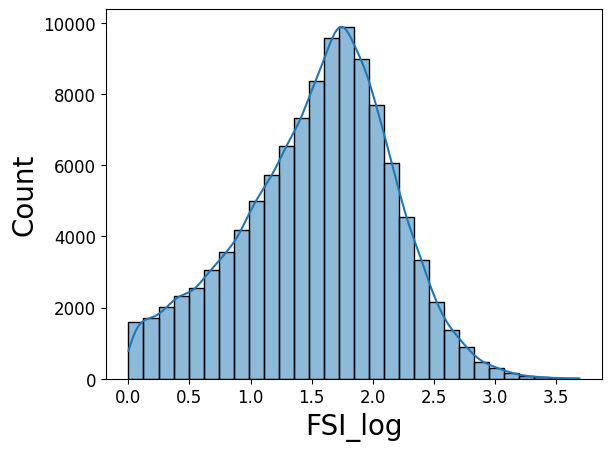

In [1628]:
sns.histplot(df[(df['Shape_Area']<1000000) & (df['Shape_Area']>10000)]['FSI_log'], bins=30, kde=True)

<Axes: xlabel='flow_log', ylabel='Count'>

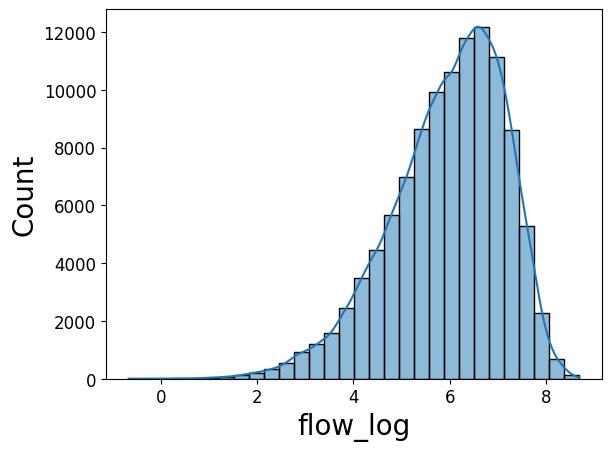

In [1629]:
sns.histplot(df[(df['Shape_Area']<1000000) & (df['Shape_Area']>10000)]['flow_log'], bins=30, kde=True)

<Axes: xlabel='flow1_log', ylabel='Count'>

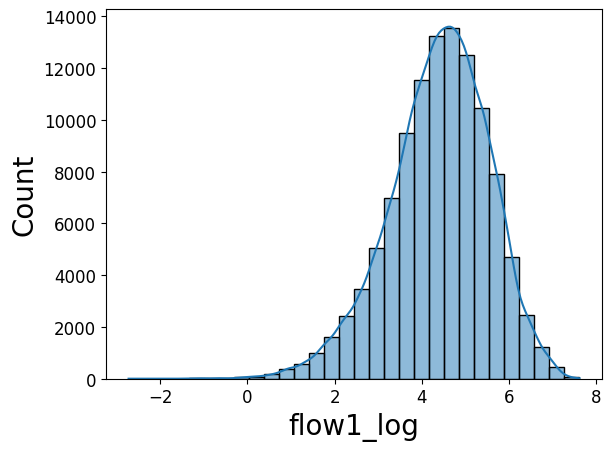

In [1630]:
sns.histplot(df[(df['Shape_Area']<1000000) & (df['Shape_Area']>10000)]['flow1_log'], bins=30, kde=True)

<Axes: xlabel='flow2_log', ylabel='Count'>

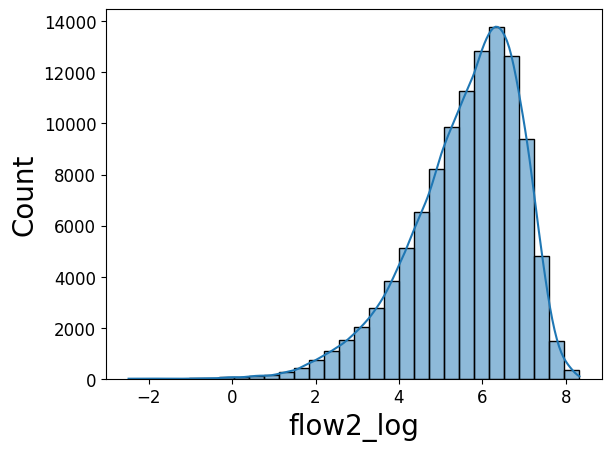

In [1631]:
sns.histplot(df[(df['Shape_Area']<1000000) & (df['Shape_Area']>10000)]['flow2_log'], bins=30, kde=True)

<Axes: xlabel='flow3_log', ylabel='Count'>

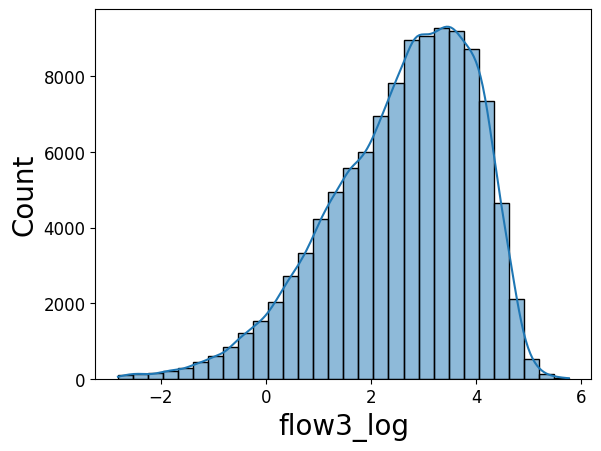

In [1632]:
sns.histplot(df[(df['Shape_Area']<1000000) & (df['Shape_Area']>10000)]['flow3_log'], bins=30, kde=True)

Text(0, 0.5, 'log Attractiveness')

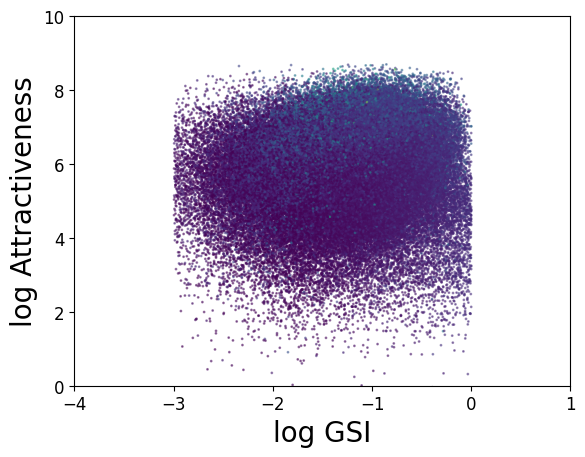

In [1633]:
plt.scatter(df["GSI_log"],df["flow_log"], s=1,alpha=0.5,c=df["FSI"])
plt.xlim(-4, 1) 
plt.ylim(0, 10) 

plt.xlabel('log GSI')
plt.ylabel('log Attractiveness')

Text(0, 0.5, 'log Attractiveness')

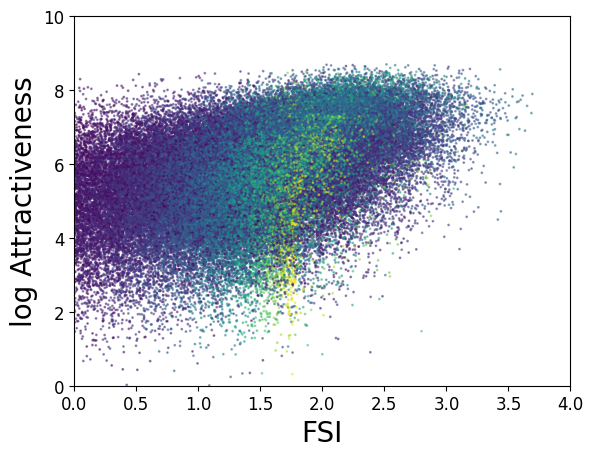

In [1634]:
plt.scatter(df["FSI_log"],df["flow_log"], s=1,alpha=0.5,c=df["GSI"])
plt.xlim(0, 4) 
plt.ylim(0, 10) 

plt.xlabel('FSI')
plt.ylabel('log Attractiveness')

## regression

In [1635]:
intercept_FSI_flow1, coefficients_FSI_flow1 = create_Linear_regression(df,["FSI_log"],plot_cat = "flow1_log",area_cap=1000000,min_FSI=1)
intercept_GSI_flow1, coefficients_GSI_flow1 = create_Linear_regression(df,["GSI_log"],plot_cat = "flow1_log",area_cap=1000000,min_FSI=1)

#results_flow1 = create_NegativeBinomial_regression(df,["FSI_log"],plot_cat = "flow1_log",area_cap=1000000,min_FSI=1)

(109409, 3)
Index(['FSI_log', 'city_dummy_2', 'city_dummy_3', 'city_dummy_4',
       'city_dummy_5', 'city_dummy_6', 'city_dummy_7', 'city_dummy_8',
       'city_dummy_9', 'city_dummy_10', 'city_dummy_11', 'city_dummy_12',
       'city_dummy_13', 'city_dummy_14', 'city_dummy_15', 'city_dummy_16',
       'city_dummy_17', 'city_dummy_18', 'city_dummy_20', 'city_dummy_21',
       'city_dummy_22', 'city_dummy_23', 'city_dummy_24', 'city_dummy_25',
       'city_dummy_26', 'city_dummy_27', 'city_dummy_28', 'city_dummy_29',
       'city_dummy_30', 'city_dummy_31', 'city_dummy_32', 'city_dummy_33',
       'city_dummy_34', 'city_dummy_35', 'city_dummy_36', 'city_dummy_37',
       'city_dummy_38', 'city_dummy_39'],
      dtype='object')
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.284
Model:                            OLS   Adj. R-squared:                  0.284
Method:                 Le

In [1636]:
intercept_FSI_flow2, coefficients_FSI_flow2 = create_Linear_regression(df,["FSI_log"],plot_cat = "flow2_log",area_cap=1000000,min_FSI=1)
intercept_GSI_flow2, coefficients_GSI_flow2 = create_Linear_regression(df,["GSI_log"],plot_cat = "flow2_log",area_cap=1000000,min_FSI=1)

#intercept_FSI_flow2, coefficients_FSI_flow2 = create_NegativeBinomial_regression(df,["FSI_log"],plot_cat = "flow2_log",area_cap=1000000,min_FSI=1)

(109406, 3)
Index(['FSI_log', 'city_dummy_2', 'city_dummy_3', 'city_dummy_4',
       'city_dummy_5', 'city_dummy_6', 'city_dummy_7', 'city_dummy_8',
       'city_dummy_9', 'city_dummy_10', 'city_dummy_11', 'city_dummy_12',
       'city_dummy_13', 'city_dummy_14', 'city_dummy_15', 'city_dummy_16',
       'city_dummy_17', 'city_dummy_18', 'city_dummy_20', 'city_dummy_21',
       'city_dummy_22', 'city_dummy_23', 'city_dummy_24', 'city_dummy_25',
       'city_dummy_26', 'city_dummy_27', 'city_dummy_28', 'city_dummy_29',
       'city_dummy_30', 'city_dummy_31', 'city_dummy_32', 'city_dummy_33',
       'city_dummy_34', 'city_dummy_35', 'city_dummy_36', 'city_dummy_37',
       'city_dummy_38', 'city_dummy_39'],
      dtype='object')
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.274
Model:                            OLS   Adj. R-squared:                  0.274
Method:                 Le

In [1637]:
intercept_FSI_flow3, coefficients_FSI_flow3 = create_Linear_regression(df,["FSI_log"],plot_cat = "flow3_log",area_cap=1000000,min_FSI=1)
intercept_GSI_flow3, coefficients_GSI_flow3 = create_Linear_regression(df,["GSI_log"],plot_cat = "flow3_log",area_cap=1000000,min_FSI=1)

#intercept_FSI_flow3, coefficients_FSI_flow3 = create_NegativeBinomial_regression(df,["FSI_log"],plot_cat = "flow3_log",area_cap=1000000,min_FSI=1)

(109117, 3)
Index(['FSI_log', 'city_dummy_2', 'city_dummy_3', 'city_dummy_4',
       'city_dummy_5', 'city_dummy_6', 'city_dummy_7', 'city_dummy_8',
       'city_dummy_9', 'city_dummy_10', 'city_dummy_11', 'city_dummy_12',
       'city_dummy_13', 'city_dummy_14', 'city_dummy_15', 'city_dummy_16',
       'city_dummy_17', 'city_dummy_18', 'city_dummy_20', 'city_dummy_21',
       'city_dummy_22', 'city_dummy_23', 'city_dummy_24', 'city_dummy_25',
       'city_dummy_26', 'city_dummy_27', 'city_dummy_28', 'city_dummy_29',
       'city_dummy_30', 'city_dummy_31', 'city_dummy_32', 'city_dummy_33',
       'city_dummy_34', 'city_dummy_35', 'city_dummy_36', 'city_dummy_37',
       'city_dummy_38', 'city_dummy_39'],
      dtype='object')
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.268
Model:                            OLS   Adj. R-squared:                  0.268
Method:                 Le

In [1638]:
intercept_FSI_flow, coefficients_FSI_flow = create_Linear_regression(df,["FSI_log"],plot_cat = "flow_log",area_cap=1000000,min_FSI=1)
intercept_GSI_flow, coefficients_GSI_flow = create_Linear_regression(df,["GSI_log"],plot_cat = "flow_log",area_cap=1000000,min_FSI=1)

#intercept_FSI_flow, coefficients_FSI_flow = create_NegativeBinomial_regression(df,["FSI_log"],plot_cat = "flow_log",area_cap=1000000,min_FSI=1)

(109409, 3)
Index(['FSI_log', 'city_dummy_2', 'city_dummy_3', 'city_dummy_4',
       'city_dummy_5', 'city_dummy_6', 'city_dummy_7', 'city_dummy_8',
       'city_dummy_9', 'city_dummy_10', 'city_dummy_11', 'city_dummy_12',
       'city_dummy_13', 'city_dummy_14', 'city_dummy_15', 'city_dummy_16',
       'city_dummy_17', 'city_dummy_18', 'city_dummy_20', 'city_dummy_21',
       'city_dummy_22', 'city_dummy_23', 'city_dummy_24', 'city_dummy_25',
       'city_dummy_26', 'city_dummy_27', 'city_dummy_28', 'city_dummy_29',
       'city_dummy_30', 'city_dummy_31', 'city_dummy_32', 'city_dummy_33',
       'city_dummy_34', 'city_dummy_35', 'city_dummy_36', 'city_dummy_37',
       'city_dummy_38', 'city_dummy_39'],
      dtype='object')
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.285
Model:                            OLS   Adj. R-squared:                  0.284
Method:                 Le

In [1891]:
x_list = ["FSI_log", "FSI_log", "FSI_log", "FSI_log", "GSI_log", "GSI_log", "GSI_log", "GSI_log"]
y_list = ["flow1_log", "flow2_log", "flow3_log", "flow_log", "flow1_log", "flow2_log", "flow3_log", "flow_log"]

coefficients_list = [
    coefficients_FSI_flow1, coefficients_FSI_flow2, coefficients_FSI_flow3, coefficients_FSI_flow,
    coefficients_GSI_flow1, coefficients_GSI_flow2, coefficients_GSI_flow3, coefficients_GSI_flow
]
intercept_list = [
    intercept_FSI_flow1, intercept_FSI_flow2, intercept_FSI_flow3, intercept_FSI_flow,
    intercept_GSI_flow1, intercept_GSI_flow2, intercept_GSI_flow3, intercept_GSI_flow
]

xlabel_list = [
    'FSI (log scale)', 
    'FSI (log scale)', 
    'FSI (log scale)', 
    'FSI (log scale)', 
    'GSI (log scale)', 
    'GSI (log scale)', 
    'GSI (log scale)', 
    'GSI (log scale)'
]
ylabel_list = [
    'Economic strength (log scale)', 
    'Livability (log scale)', 
    'Cultural dynamics, R&D (log scale)', 
    'Overall attractiveness (log scale)',
    'Economic strength (log scale)', 
    'Livability (log scale)', 
    'Cultural dynamics, R&D (log scale)', 
    'Overall attractiveness (log scale)'
]

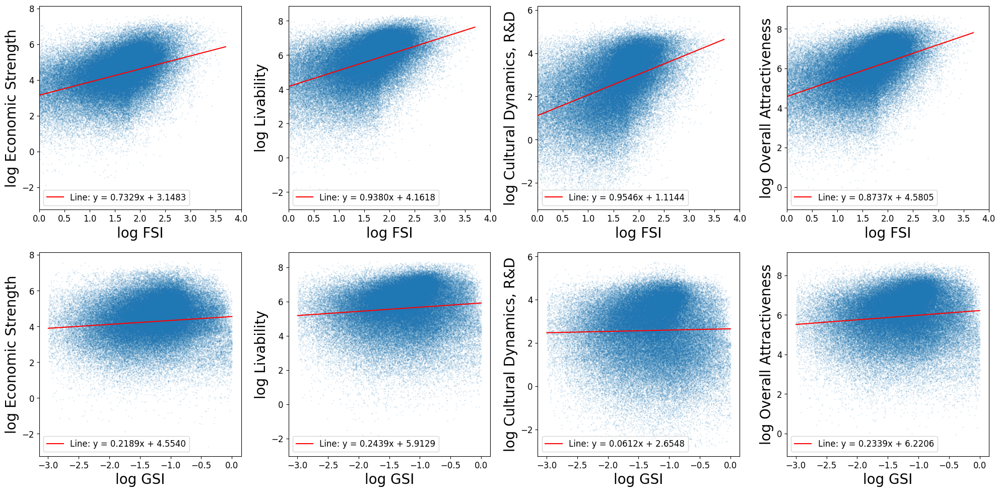

In [1640]:
# Set global font size
plt.rc('font', size=14)        # controls default text size
plt.rc('axes', titlesize=20)   # fontsize of the axes title
plt.rc('axes', labelsize=20)   # fontsize of the x and y labels
plt.rc('xtick', labelsize=12)  # fontsize of the tick labels
plt.rc('ytick', labelsize=12)  # fontsize of the tick labels
plt.rc('legend', fontsize=12)  # legend fontsize
plt.rc('figure', titlesize=16) # fontsize of the figure title

fig, axes = plt.subplots(2, 4, figsize=(20, 10))
axes = axes.flatten()

for i in range(8):
    ax = axes[i]
    
    x_data = df[x_list[i]]
    y_data = df[y_list[i]]
    
    ax.scatter(x_data, y_data, s=1, alpha=0.1)

    # Remove NaN and Inf values
    mask = np.isfinite(x_data) & np.isfinite(y_data)
    x_data = x_data[mask]
    y_data = y_data[mask]
    x_min, x_max = x_data.min(), x_data.max()
    y_min, y_max = y_data.min(), y_data.max()

    if xlabel_list[i] == 'log FSI':
        ax.set_xlim(0, 4)
    #ax.set_ylim(y_min, y_max)
    
    ax.set_xlabel(xlabel_list[i])
    ax.set_ylabel(ylabel_list[i])
    
    k = coefficients_list[i][0]
    b = intercept_list[i] + coefficients_list[i][1:].mean()
    
    x_values = np.linspace(x_min, x_max, 400)
    y_values = k * x_values + b
    
    ax.plot(x_values, y_values, color='red', label=f'Line: y = {k:.4f}x + {b:.4f}')
    ax.legend(loc='lower left')

plt.tight_layout()

plt.savefig(os.path.join(graph_save_path, f"4_scatter_plot_regression.png"), dpi=300, bbox_inches='tight')


plt.show()

29 Tianjin
[2019]


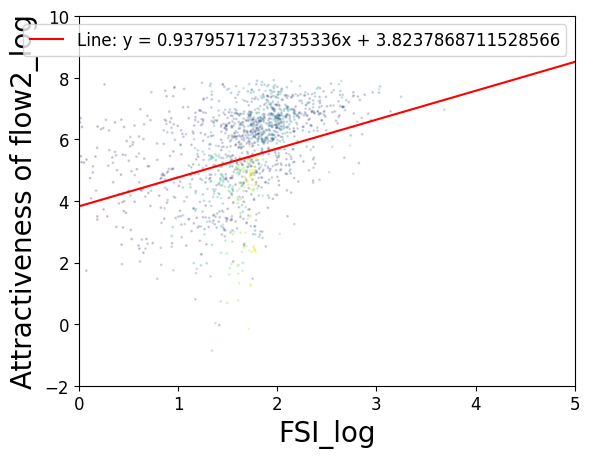

In [1772]:
city = "Tianjin"
plot_regression(df,atn_city_list.index(city),coefficients_FSI_flow2,intercept_FSI_flow2,plot_cat = "flow2_log",plot_x = "FSI_log", plot_c = "GSI",y_max = 10,x_max = 5)

In [1642]:
#create_NegativeBinomial_regression(concatenated_df,["FSI"],plot_cat = "flow",area_cap=100000,min_FSI=0)

# spatial analysis: seperate

In [1643]:
#city_id = 23
city = "Chengdu"
city_id = atn_city_list.index(city)
year_id = 0
print(city_id,atn_city_list[city_id])
#print(joined_year_list[city_id],joined_year_list[city_id][year_id])

3 Chengdu


In [1644]:
# Custom color list
from matplotlib.colors import ListedColormap

colors = ['#D3D3D3','#926AA6',"#F29844", '#68B3D4',  '#7ACB77','#F0C808',"#FF6F61"]
cmap = ListedColormap(colors)

(9645, 33)
(5038, 33)


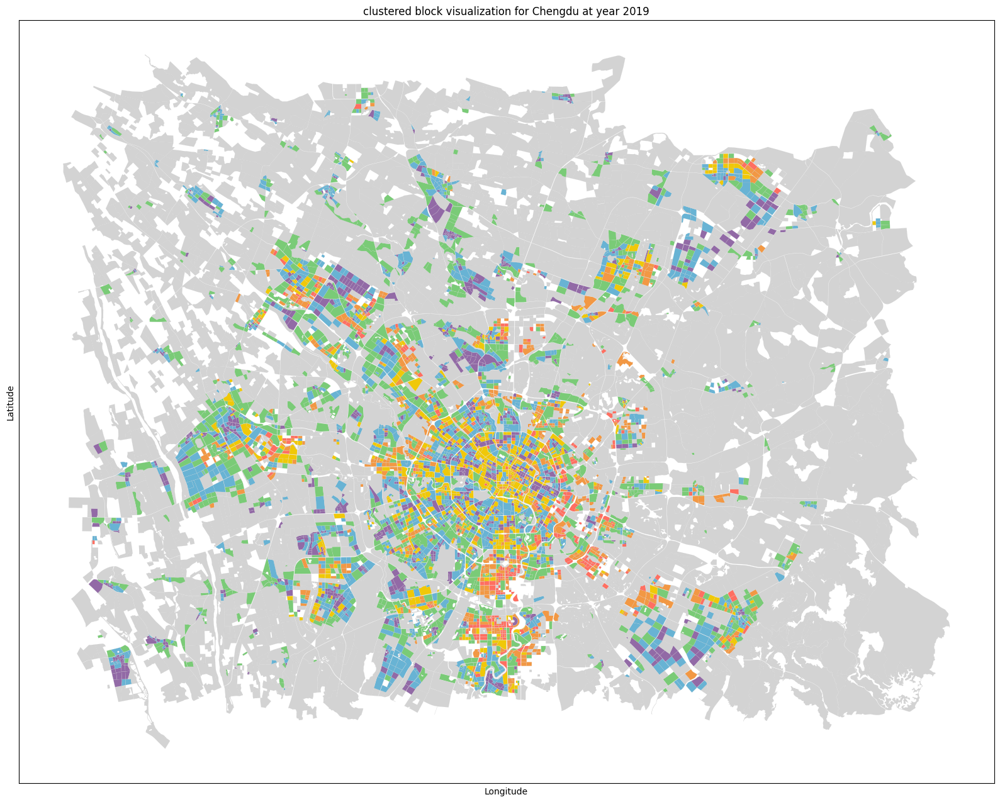

In [1045]:
# Create a plot
fig, ax = plt.subplots(1, 1, figsize=(20, 20))

flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
print(flow_df_merged.shape)
print(flow_df_merged[flow_df_merged["cluster"]>0].shape)
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"]<100000000]
#flow_df_merged = flow_df_merged[flow_df_merged["FSI"]>1]
#flow_df_merged = flow_df_merged[flow_df_merged["GSI"]>0.05]
#flow_df_merged = flow_df_merged[flow_df_merged["cluster"]>0]


# Plot the GeoDataFrame
# 'column' specifies the column used for coloring, 'cmap' is the colormap
#plot = block_df_original_list[city_list.index(city)][0].plot(color='#D3D3D3', linewidth=0.1, ax=ax, edgecolor='0.8')
plot = flow_df_merged.plot(column='cluster', cmap=cmap, linewidth=0.1, ax=ax, edgecolor='0.8')

# Adding a colorbar
#fig.colorbar(plot.collections[0], ax=ax, orientation='vertical', shrink=0.4)

# Adding title and labels (optional)
ax.set_title(f'clustered block visualization for {atn_city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Remove x and y axis for a cleaner look (optional)
ax.set_xticks([])
ax.set_yticks([])

# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_city_{atn_city_list[city_id]}.png"), dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


(8875, 39)


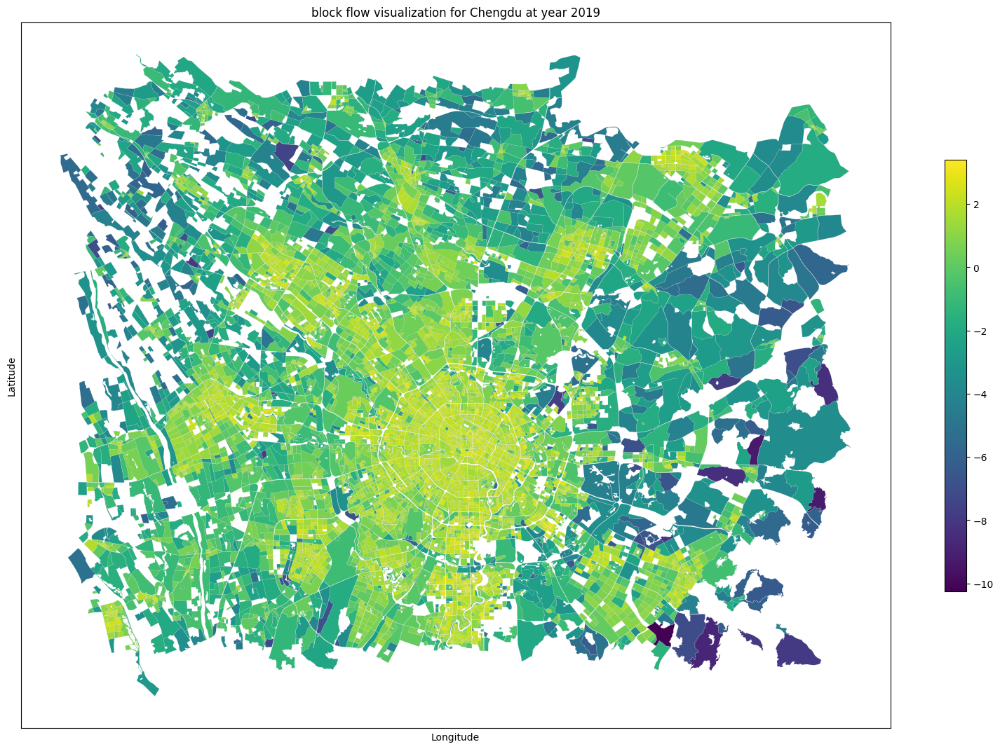

In [1079]:
plot_cat = "FSI_log"
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)

flow_df_merged = rescale_column(flow_df_merged,"flow") 
flow_df_merged = rescale_column(flow_df_merged,"FSI") 
flow_df_merged = flow_df_merged[flow_df_merged["FSI"] > 0]

flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"]<100000000]

print(flow_df_merged.shape)

#flow_df_merged =  flow_df_merged[flow_df_merged["area"]<1000000]
#flow_df_merged =  flow_df_merged[flow_df_merged["area"]<1000000]
#flow_df_merged =  flow_df_merged[flow_df_merged["area"]>10000]
#flow_df_merged = flow_df_merged[flow_df_merged["FSI"]>1]
#flow_df_merged = flow_df_merged[flow_df_merged["GSI"]>0.01]


# Create a plot
fig, ax = plt.subplots(1, 1, figsize=(20, 20))

# Plot the GeoDataFrame
# 'column' specifies the column used for coloring, 'cmap' is the colormap
plot = flow_df_merged.plot(column=plot_cat, cmap="viridis", linewidth=0.1, ax=ax, edgecolor='0.8')

# Adding a colorbar with range 0 to 1
norm = plt.Normalize(vmin=flow_df_merged[plot_cat].min(), vmax=flow_df_merged[plot_cat].max())
sb = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
sb.set_array([])
fig.colorbar(sb, ax=ax, orientation='vertical', shrink=0.4)

# Adding title and labels (optional)
ax.set_title(f'block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Remove x and y axis for a cleaner look (optional)
ax.set_xticks([])
ax.set_yticks([])

# Show the plot
plt.show()

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


(9645, 39)


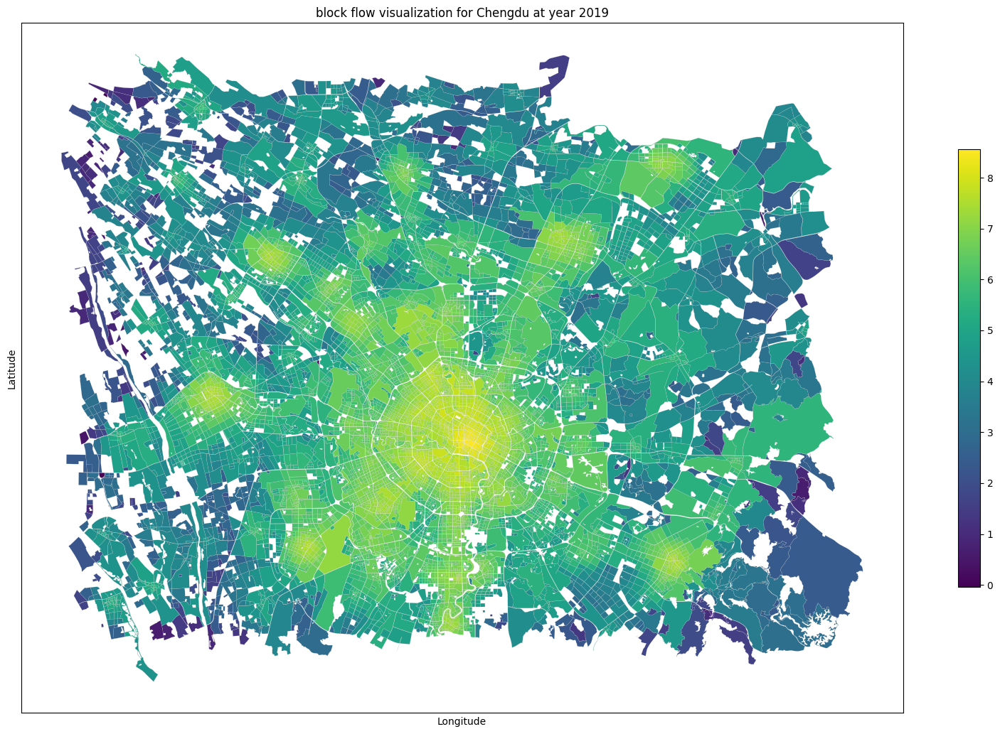

In [1077]:
plot_cat = "flow_log"
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)

flow_df_merged = rescale_column(flow_df_merged,"flow") 
flow_df_merged = rescale_column(flow_df_merged,"FSI") 
flow_df_merged = flow_df_merged[flow_df_merged["flow"] > 0]

flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"]<100000000]


print(flow_df_merged.shape)

#flow_df_merged =  flow_df_merged[flow_df_merged["area"]<1000000]
#flow_df_merged =  flow_df_merged[flow_df_merged["area"]<1000000]
#flow_df_merged =  flow_df_merged[flow_df_merged["area"]>10000]
#flow_df_merged = flow_df_merged[flow_df_merged["FSI"]>1]
#flow_df_merged = flow_df_merged[flow_df_merged["GSI"]>0.01]


# Create a plot
fig, ax = plt.subplots(1, 1, figsize=(20, 20))

# Plot the GeoDataFrame
# 'column' specifies the column used for coloring, 'cmap' is the colormap
plot = flow_df_merged.plot(column=plot_cat, cmap="viridis", linewidth=0.1, ax=ax, edgecolor='0.8')

# Adding a colorbar with range 0 to 1
norm = plt.Normalize(vmin=flow_df_merged[plot_cat].min(), vmax=flow_df_merged[plot_cat].max())
sb = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
sb.set_array([])
fig.colorbar(sb, ax=ax, orientation='vertical', shrink=0.4)

# Adding title and labels (optional)
ax.set_title(f'block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Remove x and y axis for a cleaner look (optional)
ax.set_xticks([])
ax.set_yticks([])

# Show the plot
plt.show()

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


(6141, 39)
(6141, 39)
(6141, 40)


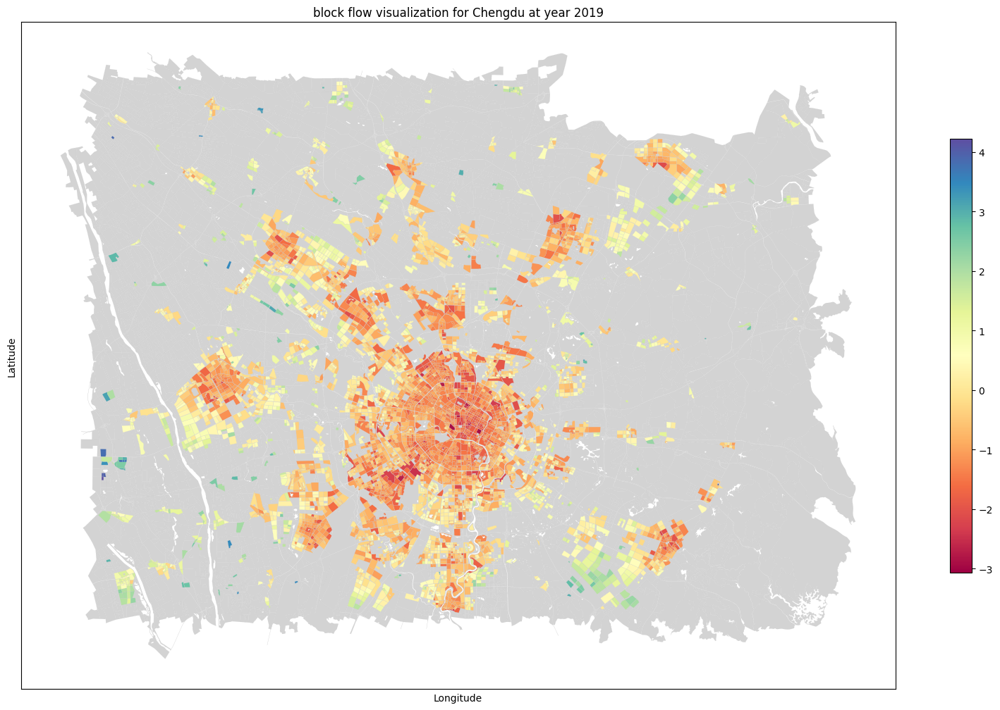

In [1048]:
plot_x = "FSI_log"

flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)

flow_df_merged = rescale_column(flow_df_merged,"flow") 
flow_df_merged = rescale_column(flow_df_merged,"FSI") 
#flow_df_merged = flow_df_merged[flow_df_merged["flow"] > 0]
#flow_df_merged = flow_df_merged[flow_df_merged["FSI"] > 0]
flow_df_merged = flow_df_merged[flow_df_merged["cluster"] > -1]
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"]<100000000]


k = coefficients_FSI_flow[0]

if city_id == 1:
    b = intercept_FSI_flow
else:
    b = intercept_FSI_flow + coefficients_FSI_flow[f"city_dummy_{i}"]

print(flow_df_merged.shape)
print(flow_df_merged[flow_df_merged[plot_x]>0].shape)
flow_df_merged["residual"] = flow_df_merged[plot_x]*k+b - flow_df_merged[plot_cat]
#flow_df_merged["residual"][flow_df_merged["residual"] < -1] = -1
#flow_df_merged["residual"][flow_df_merged["residual"] > 1] = 1
#flow_df_merged.loc[flow_df_merged["area"]>1000000,"residual"] = -1
print(flow_df_merged[flow_df_merged["residual"]>-10].shape)


# Create a plot
fig, ax = plt.subplots(1, 1, figsize=(20, 20))

# Plot the GeoDataFrame
# 'column' specifies the column used for coloring, 'cmap' is the colormap
base_df = block_df_list[city_list.index(city)][0]
base_df = base_df[base_df["Shape_Area"]<100000000]
plot = base_df.plot(color='#D3D3D3', linewidth=0.1, ax=ax, edgecolor='0.8')
plot = flow_df_merged.plot(column="residual", cmap="Spectral", linewidth=0.1, ax=ax, edgecolor='0.8')

# Adding a colorbar with range 0 to 1
norm = plt.Normalize(vmin=flow_df_merged["residual"].min(), vmax=flow_df_merged["residual"].max())
sb = plt.cm.ScalarMappable(cmap="Spectral", norm=norm)
sb.set_array([])
fig.colorbar(sb, ax=ax, orientation='vertical', shrink=0.4)

# Adding title and labels (optional)
ax.set_title(f'block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Remove x and y axis for a cleaner look (optional)
ax.set_xticks([])
ax.set_yticks([])

# Show the plot
plt.show()

## spatial analysis: together

In [2209]:
plot_x = "FSI_log"

atc_type = 0
plot_y = y_list[atc_type]
label_x = xlabel_list[atc_type]
label_y = ylabel_list[atc_type]
print(plot_y,"|",label_x,"|",label_y)

flow1_log | FSI (log scale) | Economic strength (log scale)


In [2210]:
#city_id = 23
city = "Beijing"
city_id = atn_city_list.index(city)
year_id = 0
print(city_id,atn_city_list[city_id])
#print(joined_year_list[city_id],joined_year_list[city_id][year_id])

result_df = create_Linear_regression_df(df,[plot_x],plot_cat = plot_y,area_cap=100000000,min_FSI=0,plot_city = city_id)

1 Beijing
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.283
Model:                            OLS   Adj. R-squared:                  0.282
Method:                 Least Squares   F-statistic:                     906.7
Date:                Mon, 01 Jul 2024   Prob (F-statistic):               0.00
Time:                        14:23:28   Log-Likelihood:            -1.2113e+05
No. Observations:               87456   AIC:                         2.423e+05
Df Residuals:                   87417   BIC:                         2.427e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.2203      0.014 

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sk

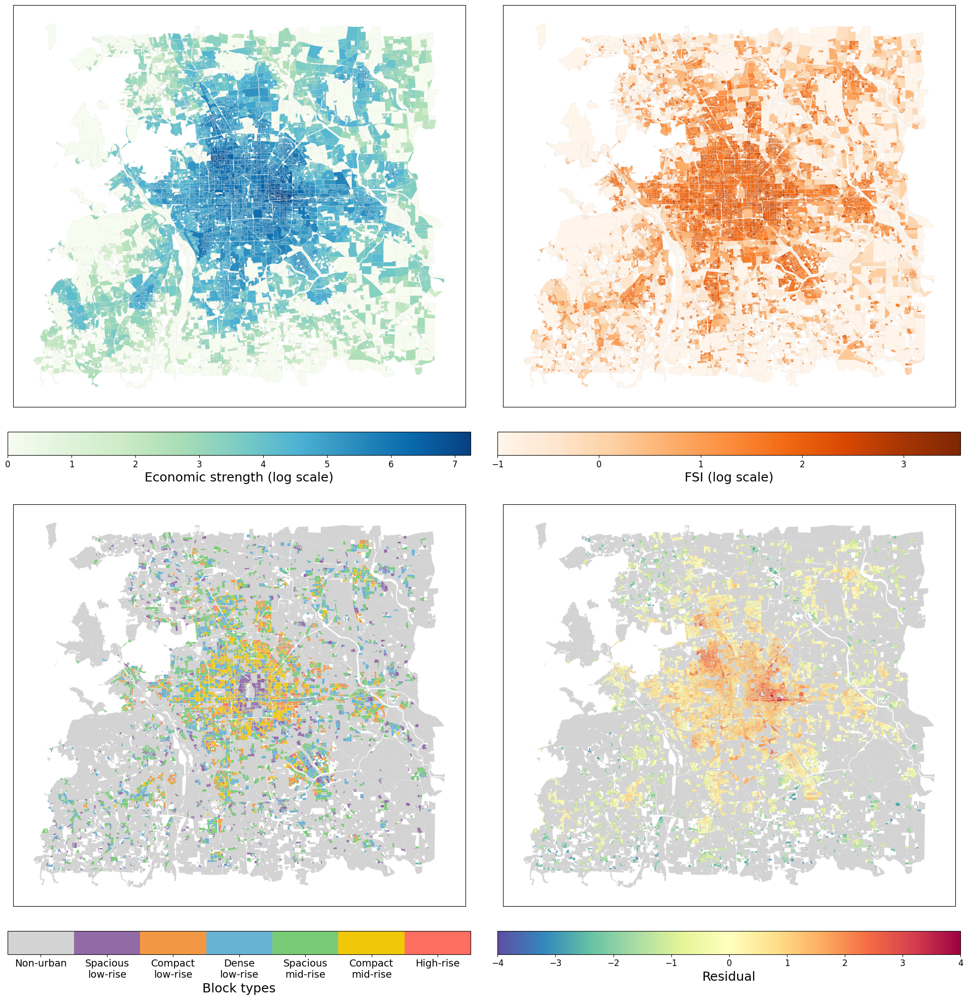

In [2211]:
# Set a larger font size
font_size_tick = 14
font_size_legend = 18
font_size_title = 18

# Create 2x2 grid of subplots
fig, axs = plt.subplots(2, 2, figsize=(20, 20))

# First plot
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]

ax = axs[1, 0]
plot = flow_df_merged.plot(column='cluster', cmap=cmap, linewidth=0.1, ax=ax, edgecolor='0.8')
#ax.set_title(f'Clustered block visualization for {atn_city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# Create a ScalarMappable and colorbar with custom labels
norm = plt.Normalize(vmin=-1, vmax=6)
sb = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=0.9, pad=0.05)
cbar.set_label('Block types', fontsize=font_size_legend)
cbar.set_ticks([-0.5, 0.5, 1.5, 2.5, 3.5, 4.5, 5.5])
cbar.set_ticklabels(["Non-urban","Spacious\nlow-rise", "Compact\nlow-rise", "Dense\nlow-rise", "Spacious\nmid-rise", "Compact\nmid-rise", "High-rise"])
cbar.ax.tick_params(labelsize=font_size_tick)

# Second plot
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = rescale_column(flow_df_merged, "flow")
flow_df_merged = rescale_column(flow_df_merged, "FSI")
# Replace inf and -inf with NaN first
flow_df_merged[plot_x] = flow_df_merged[plot_x].replace([np.inf, -np.inf], np.nan)
# Now replace NaN with 0
flow_df_merged[plot_x] = flow_df_merged[plot_x].fillna(-1)
flow_df_merged.loc[flow_df_merged["FSI"]<0.3678,plot_x] = -1
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]
flow_df_merged.loc[flow_df_merged["Shape_Area"]>10000000,plot_x] = -1


ax = axs[0, 1]
plot = flow_df_merged.plot(column=plot_x, cmap="Oranges", linewidth=0.1, ax=ax, edgecolor='0.8',vmin=-1, vmax=flow_df_merged[plot_x].max())
norm = plt.Normalize(vmin=-1, vmax=flow_df_merged[plot_x].max())
sb = plt.cm.ScalarMappable(cmap="Oranges", norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=0.9, pad=0.05)
cbar.set_label(label_x, fontsize=font_size_legend)
#ax.set_title(f'Block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# Third plot
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = rescale_column(flow_df_merged, "flow")
flow_df_merged = rescale_column(flow_df_merged, "flow1")
flow_df_merged = rescale_column(flow_df_merged, "flow2")
flow_df_merged = rescale_column(flow_df_merged, "flow3")
flow_df_merged = rescale_column(flow_df_merged, "FSI")
flow_df_merged = flow_df_merged[flow_df_merged["flow"] > 0]
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]
flow_df_merged.loc[flow_df_merged["FSI"]<0.3678,plot_y] = 0
flow_df_merged.loc[flow_df_merged["Shape_Area"]>10000000,plot_y] = 0

ax = axs[0, 0]
plot = flow_df_merged.plot(column=plot_y, cmap="GnBu", linewidth=0.1, ax=ax, edgecolor='0.8',vmin=0, vmax=flow_df_merged[plot_y].max())
norm = plt.Normalize(vmin=0, vmax=flow_df_merged[plot_y].max())
sb = plt.cm.ScalarMappable(cmap="GnBu", norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=0.9, pad=0.05)
cbar.set_label(label_y, fontsize=font_size_legend)
#ax.set_title(f'Block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# Fourth plot
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = rescale_column(flow_df_merged, "flow")
flow_df_merged = rescale_column(flow_df_merged, "FSI")
flow_df_merged = flow_df_merged[flow_df_merged["cluster"] > -1]
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]
flow_df_merged = flow_df_merged[flow_df_merged["flow"] > 0]

k = coefficients_FSI_flow[0]
if city_id == 1:
    b = intercept_FSI_flow
else:
    b = intercept_FSI_flow + coefficients_FSI_flow[f"city_dummy_{i}"]

#flow_df_merged["residual"] = flow_df_merged["FSI_log"] * k + b - flow_df_merged["flow_log"]
flow_df_merged = pd.merge(flow_df_merged,result_df,on="block_id",how="inner")
flow_df_merged["residual"] =  flow_df_merged[f"{plot_y}-og"] - flow_df_merged["pred"]
flow_df_merged.loc[flow_df_merged["residual"]>4,"residual"] = 4
flow_df_merged.loc[flow_df_merged["residual"]<-4,"residual"] = -4

ax = axs[1, 1]
base_df = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
base_df = gpd.GeoDataFrame(base_df, geometry=base_df.geometry)
base_df = base_df[base_df["Shape_Area"] < 100000000]
base_df.plot(color='#D3D3D3', linewidth=0.1, ax=ax, edgecolor='0.8')
plot = flow_df_merged.plot(column="residual", cmap="Spectral_r", linewidth=0.1, ax=ax, edgecolor='0.8', vmin=-4, vmax=4)


norm = plt.Normalize(vmin=-4, vmax=4)
sb = plt.cm.ScalarMappable(cmap="Spectral_r", norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=0.9, pad=0.05)
cbar.set_label('Residual', fontsize=font_size_legend)
#ax.set_title(f'Residual block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# Adjust layout and save/show the plot
plt.tight_layout(pad=0.5)
plt.savefig(os.path.join(graph_save_path, f"4_plots_grid_city_{atn_city_list[city_id]}_{plot_y}.png"), dpi=300, bbox_inches='tight')
plt.show()

                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.283
Model:                            OLS   Adj. R-squared:                  0.282
Method:                 Least Squares   F-statistic:                     906.7
Date:                Mon, 01 Jul 2024   Prob (F-statistic):               0.00
Time:                        14:23:51   Log-Likelihood:            -1.2113e+05
No. Observations:               87456   AIC:                         2.423e+05
Df Residuals:                   87417   BIC:                         2.427e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.2203      0.014    238.135

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sk

                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.278
Model:                            OLS   Adj. R-squared:                  0.278
Method:                 Least Squares   F-statistic:                     886.9
Date:                Mon, 01 Jul 2024   Prob (F-statistic):               0.00
Time:                        14:24:07   Log-Likelihood:            -1.3217e+05
No. Observations:               87468   AIC:                         2.644e+05
Df Residuals:                   87429   BIC:                         2.648e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.8237      0.015    249.299

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:480: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:479: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/sk

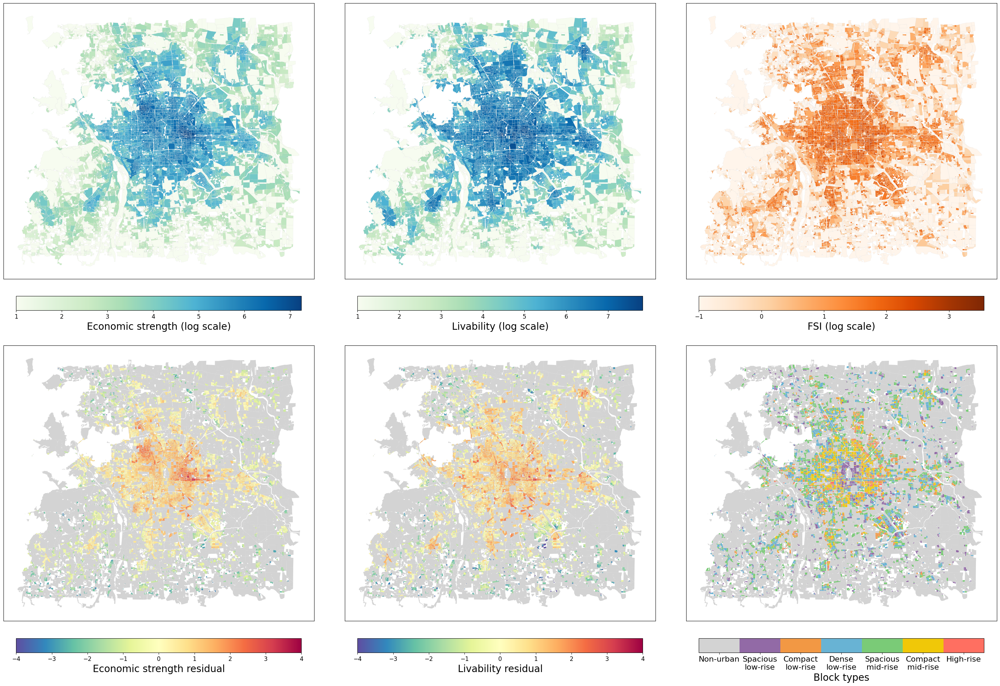

In [2212]:
# Set a larger font size
font_size_tick = 16
font_size_legend = 20
font_size_title = 20
bar_shrink = 0.8

# Create 2x2 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(30, 20))

atc_type = 0
plot_y = y_list[atc_type]
label_x = xlabel_list[atc_type]
label_y = ylabel_list[atc_type]
result_df = create_Linear_regression_df(df,[plot_x],plot_cat = plot_y,area_cap=100000000,min_FSI=0,plot_city = city_id)

# plot: building typology
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]

ax = axs[1, 2]
plot = flow_df_merged.plot(column='cluster', cmap=cmap, linewidth=0.1, ax=ax, edgecolor='0.8')
#ax.set_title(f'Clustered block visualization for {atn_city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# Create a ScalarMappable and colorbar with custom labels
norm = plt.Normalize(vmin=-1, vmax=6)
sb = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=bar_shrink, pad=0.05)
cbar.set_label('Block types', fontsize=font_size_legend)
cbar.set_ticks([-0.5, 0.5, 1.5, 2.5, 3.5, 4.5, 5.5])
cbar.set_ticklabels(["Non-urban","Spacious\nlow-rise", "Compact\nlow-rise", "Dense\nlow-rise", "Spacious\nmid-rise", "Compact\nmid-rise", "High-rise"])
cbar.ax.tick_params(labelsize=font_size_tick)

# plot: building density 
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = rescale_column(flow_df_merged, "flow")
flow_df_merged = rescale_column(flow_df_merged, "FSI")
# Replace inf and -inf with NaN first
flow_df_merged[plot_x] = flow_df_merged[plot_x].replace([np.inf, -np.inf], np.nan)
# Now replace NaN with 0
flow_df_merged[plot_x] = flow_df_merged[plot_x].fillna(-1)
flow_df_merged.loc[flow_df_merged["FSI"]<0.3678,plot_x] = -1
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]
flow_df_merged.loc[flow_df_merged["Shape_Area"]>10000000,plot_x] = -1


ax = axs[0, 2]
plot = flow_df_merged.plot(column=plot_x, cmap="Oranges", linewidth=0.1, ax=ax, edgecolor='0.8',vmin=-1, vmax=flow_df_merged[plot_x].max())
norm = plt.Normalize(vmin=-1, vmax=flow_df_merged[plot_x].max())
sb = plt.cm.ScalarMappable(cmap="Oranges", norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=bar_shrink, pad=0.05)
cbar.set_label(label_x, fontsize=font_size_legend)
#ax.set_title(f'Block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# plot: flow 1
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = rescale_column(flow_df_merged, "flow")
flow_df_merged = rescale_column(flow_df_merged, "flow1")
flow_df_merged = rescale_column(flow_df_merged, "flow2")
flow_df_merged = rescale_column(flow_df_merged, "flow3")
flow_df_merged = rescale_column(flow_df_merged, "FSI")
flow_df_merged = flow_df_merged[flow_df_merged["flow"] > 0]
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]
flow_df_merged.loc[flow_df_merged["FSI"]<0.3678,plot_y] = 1
flow_df_merged.loc[flow_df_merged["Shape_Area"]>10000000,plot_y] = 1

ax = axs[0, 0]
plot = flow_df_merged.plot(column=plot_y, cmap="GnBu", linewidth=0.1, ax=ax, edgecolor='0.8',vmin=1, vmax=flow_df_merged[plot_y].max())
norm = plt.Normalize(vmin=1, vmax=flow_df_merged[plot_y].max())
sb = plt.cm.ScalarMappable(cmap="GnBu", norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=bar_shrink, pad=0.05)
cbar.set_label(label_y, fontsize=font_size_legend)
#ax.set_title(f'Block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# plot: residual 1
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = rescale_column(flow_df_merged, "flow")
flow_df_merged = rescale_column(flow_df_merged, "flow1")
flow_df_merged = rescale_column(flow_df_merged, "flow2")
flow_df_merged = rescale_column(flow_df_merged, "flow3")
flow_df_merged = rescale_column(flow_df_merged, "FSI")
flow_df_merged = flow_df_merged[flow_df_merged["cluster"] > -1]
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]
flow_df_merged = flow_df_merged[flow_df_merged["flow"] > 0]

k = coefficients_FSI_flow[0]
if city_id == 1:
    b = intercept_FSI_flow
else:
    b = intercept_FSI_flow + coefficients_FSI_flow[f"city_dummy_{i}"]

#flow_df_merged["residual"] = flow_df_merged["FSI_log"] * k + b - flow_df_merged["flow_log"]
flow_df_merged = pd.merge(flow_df_merged,result_df,on="block_id",how="inner")
flow_df_merged["residual"] = flow_df_merged[f"{plot_y}-og"] - flow_df_merged["pred"]
flow_df_merged.loc[flow_df_merged["residual"]>4,"residual"] = 4
flow_df_merged.loc[flow_df_merged["residual"]<-4,"residual"] = -4

ax = axs[1, 0]
base_df = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
base_df = gpd.GeoDataFrame(base_df, geometry=base_df.geometry)
base_df = base_df[base_df["Shape_Area"] < 100000000]
base_df.plot(color='#D3D3D3', linewidth=0.1, ax=ax, edgecolor='0.8')
plot = flow_df_merged.plot(column="residual", cmap="Spectral_r", linewidth=0.1, ax=ax, edgecolor='0.8', vmin=-4, vmax=4)


norm = plt.Normalize(vmin=-4, vmax=4)
sb = plt.cm.ScalarMappable(cmap="Spectral_r", norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=bar_shrink, pad=0.05)
cbar.set_label('Economic strength residual', fontsize=font_size_legend)
#ax.set_title(f'Residual block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])


atc_type = 1
plot_y = y_list[atc_type]
label_x = xlabel_list[atc_type]
label_y = ylabel_list[atc_type]
result_df = create_Linear_regression_df(df,[plot_x],plot_cat = plot_y,area_cap=100000000,min_FSI=0,plot_city = city_id)

# plot: flow 2
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = rescale_column(flow_df_merged, "flow")
flow_df_merged = rescale_column(flow_df_merged, "flow1")
flow_df_merged = rescale_column(flow_df_merged, "flow2")
flow_df_merged = rescale_column(flow_df_merged, "flow3")
flow_df_merged = rescale_column(flow_df_merged, "FSI")
flow_df_merged = flow_df_merged[flow_df_merged["flow"] > 0]
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]
flow_df_merged.loc[flow_df_merged["FSI"]<0.3678,plot_y] = 1
flow_df_merged.loc[flow_df_merged["Shape_Area"]>10000000,plot_y] = 1

ax = axs[0, 1]
plot = flow_df_merged.plot(column=plot_y, cmap="GnBu", linewidth=0.1, ax=ax, edgecolor='0.8',vmin=1, vmax=flow_df_merged[plot_y].max())
norm = plt.Normalize(vmin=1, vmax=flow_df_merged[plot_y].max())
sb = plt.cm.ScalarMappable(cmap="GnBu", norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=bar_shrink, pad=0.05)
cbar.set_label(label_y, fontsize=font_size_legend)
#ax.set_title(f'Block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# plot: residual 2
flow_df_merged = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = rescale_column(flow_df_merged, "flow")
flow_df_merged = rescale_column(flow_df_merged, "flow1")
flow_df_merged = rescale_column(flow_df_merged, "flow2")
flow_df_merged = rescale_column(flow_df_merged, "flow3")
flow_df_merged = rescale_column(flow_df_merged, "FSI")
flow_df_merged = flow_df_merged[flow_df_merged["cluster"] > -1]
flow_df_merged = flow_df_merged[flow_df_merged["Shape_Area"] < 100000000]
flow_df_merged = flow_df_merged[flow_df_merged["flow"] > 0]

k = coefficients_FSI_flow[0]
if city_id == 1:
    b = intercept_FSI_flow
else:
    b = intercept_FSI_flow + coefficients_FSI_flow[f"city_dummy_{i}"]

#flow_df_merged["residual"] = flow_df_merged["FSI_log"] * k + b - flow_df_merged["flow_log"]
flow_df_merged = pd.merge(flow_df_merged,result_df,on="block_id",how="inner")
flow_df_merged["residual"] = flow_df_merged[f"{plot_y}-og"] - flow_df_merged["pred"]
flow_df_merged.loc[flow_df_merged["residual"]>4,"residual"] = 4
flow_df_merged.loc[flow_df_merged["residual"]<-4,"residual"] = -4

ax = axs[1, 1]
base_df = pd.merge(atn_df_list[city_id][year_id], block_gdf_joined_poi_list[city_id][year_id], on="block_id")
base_df = gpd.GeoDataFrame(base_df, geometry=base_df.geometry)
base_df = base_df[base_df["Shape_Area"] < 100000000]
base_df.plot(color='#D3D3D3', linewidth=0.1, ax=ax, edgecolor='0.8')
plot = flow_df_merged.plot(column="residual", cmap="Spectral_r", linewidth=0.1, ax=ax, edgecolor='0.8', vmin=-4, vmax=4)


norm = plt.Normalize(vmin=-4, vmax=4)
sb = plt.cm.ScalarMappable(cmap="Spectral_r", norm=norm)
sb.set_array([])
cbar = fig.colorbar(sb, ax=ax, orientation='horizontal', shrink=bar_shrink, pad=0.05)
cbar.set_label('Livability residual', fontsize=font_size_legend)
#ax.set_title(f'Residual block flow visualization for {city_list[city_id]} at year {joined_year_list[city_id][year_id]}')
#ax.set_xlabel('Longitude')
#ax.set_ylabel('Latitude')
ax.set_xticks([])
ax.set_yticks([])

# Adjust layout and save/show the plot
plt.tight_layout(pad=0.5)
plt.savefig(os.path.join(graph_save_path, f"4_plots_grid_city_{atn_city_list[city_id]}_all.png"), dpi=300, bbox_inches='tight')
plt.show()

### save resudual result

In [1707]:
flow_df_merged.to_file(os.path.join(block_residual_path,f"{city}_residual.gpkg"),driver="GPKG")

### residual composition

<Axes: xlabel='residual', ylabel='Count'>

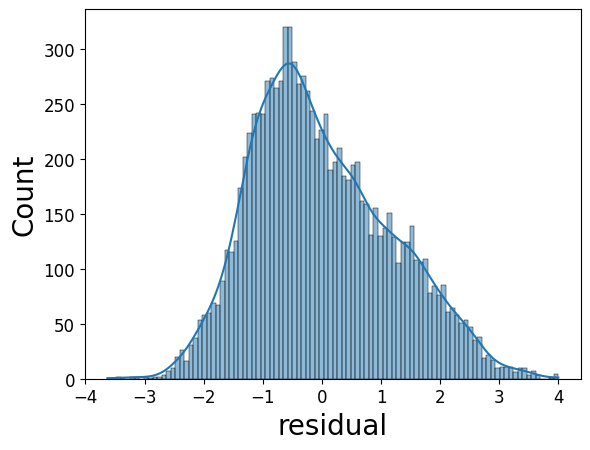

In [1691]:
sns.histplot(flow_df_merged["residual"], bins=100, kde=True)
#plt.xlim(-0.25, 0.25)

## predict for all cities and collect mse

Beijing
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:14   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

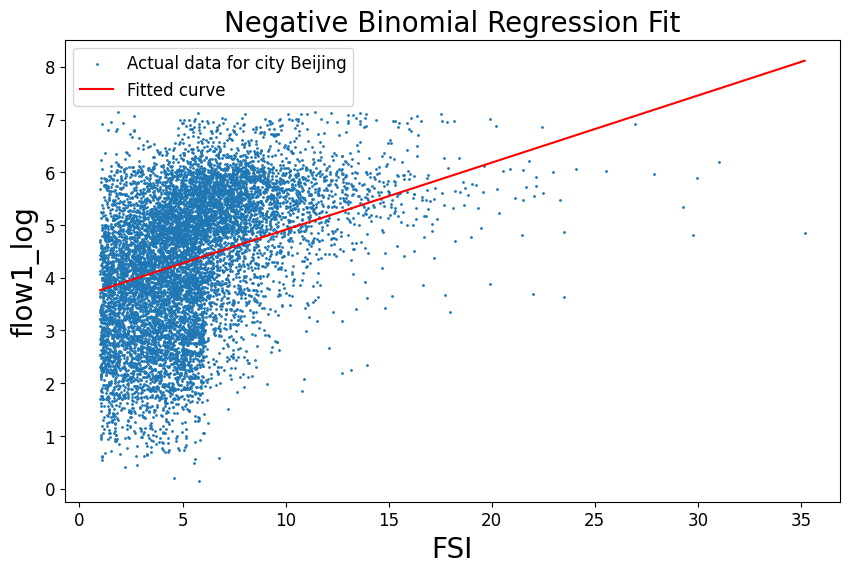

Changsha
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:15   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

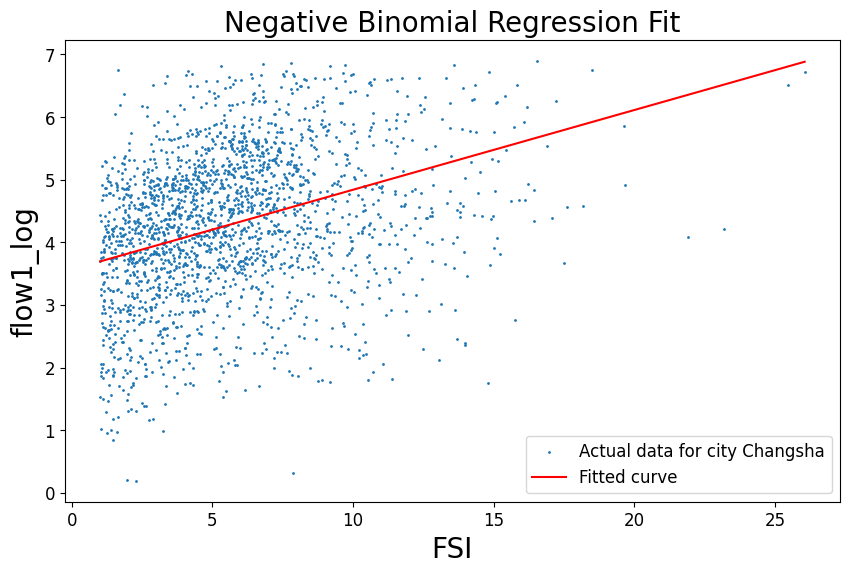

Chengdu
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:15   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

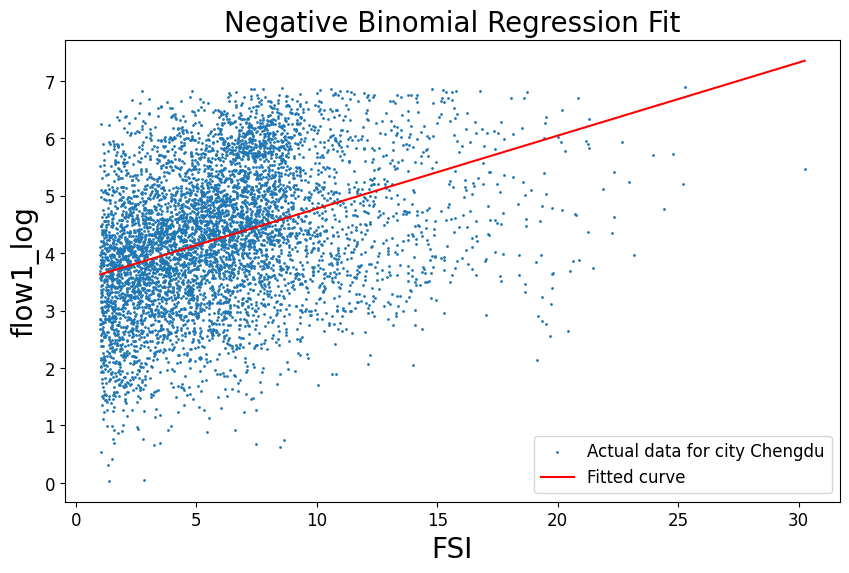

Chongqing
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:16   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012 

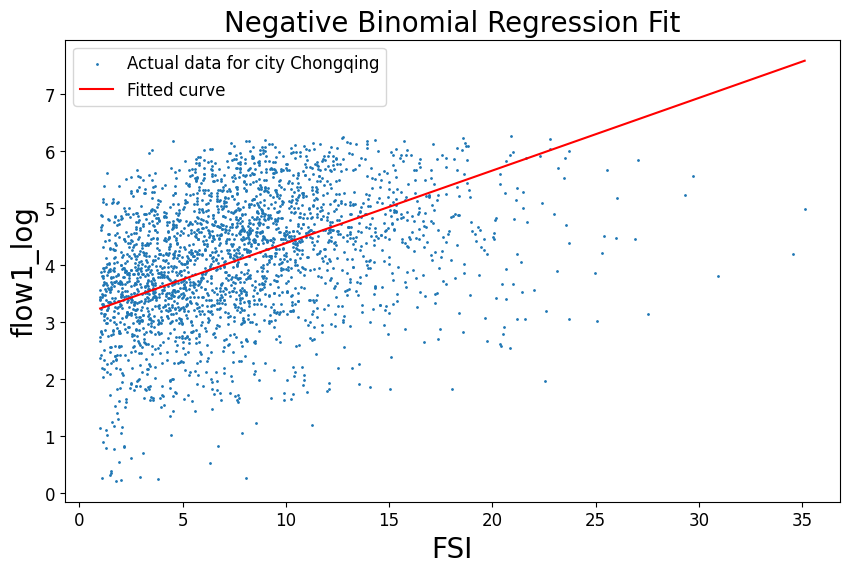

Dalian
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:16   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

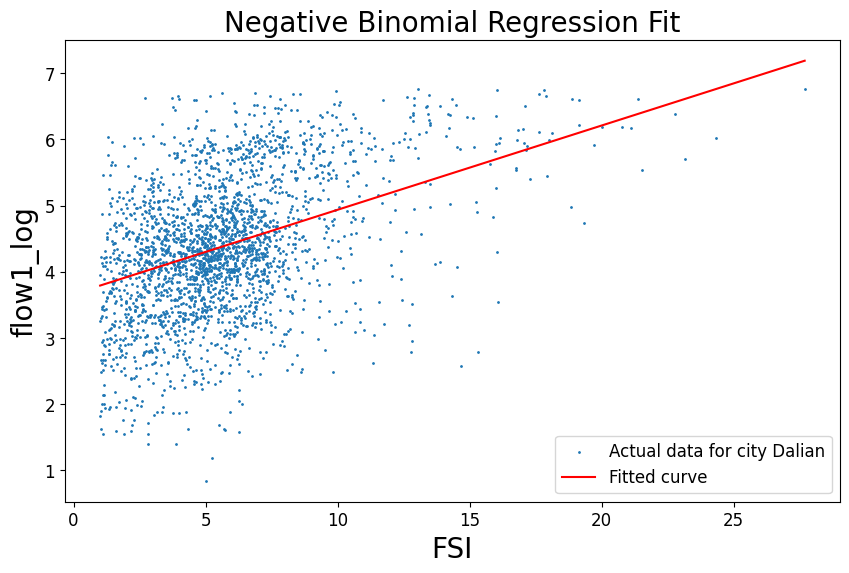

Dongguan
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:17   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

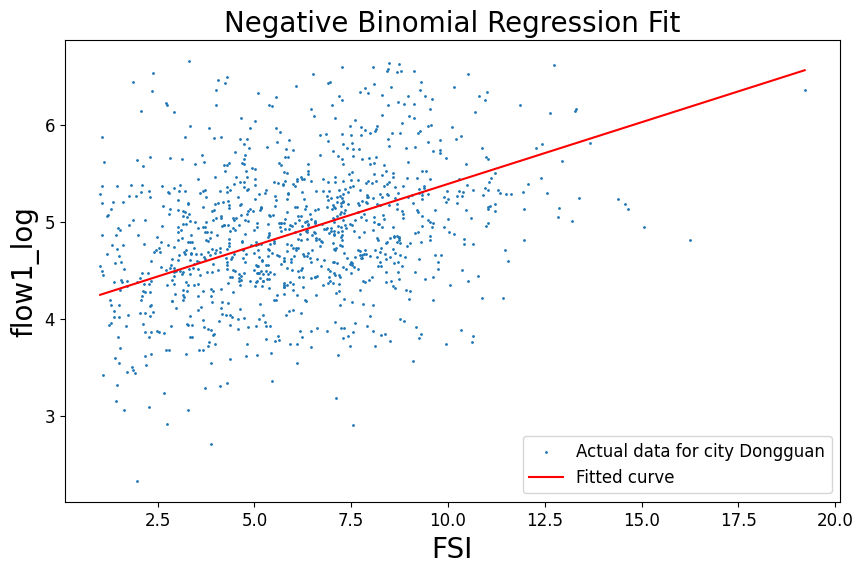

Foshan
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:17   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

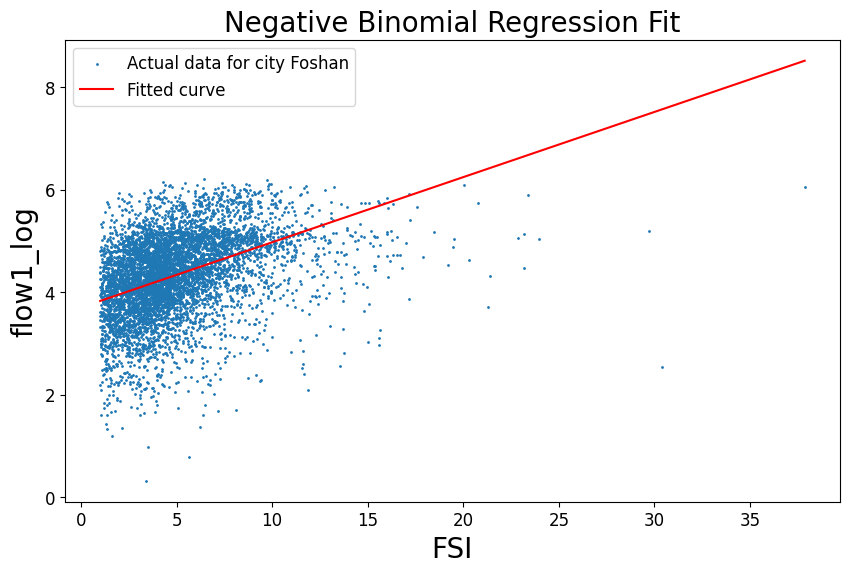

Fuzhou
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:18   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

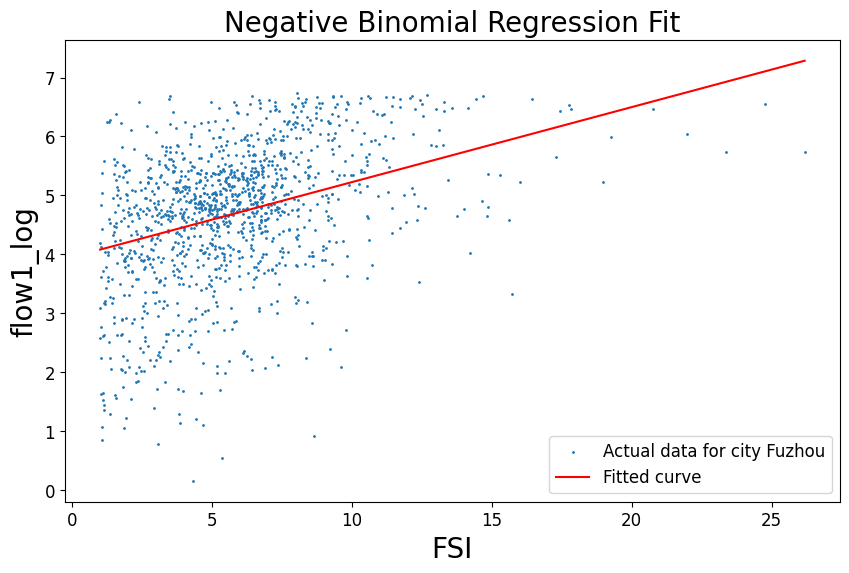

Guangzhou
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:18   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012 

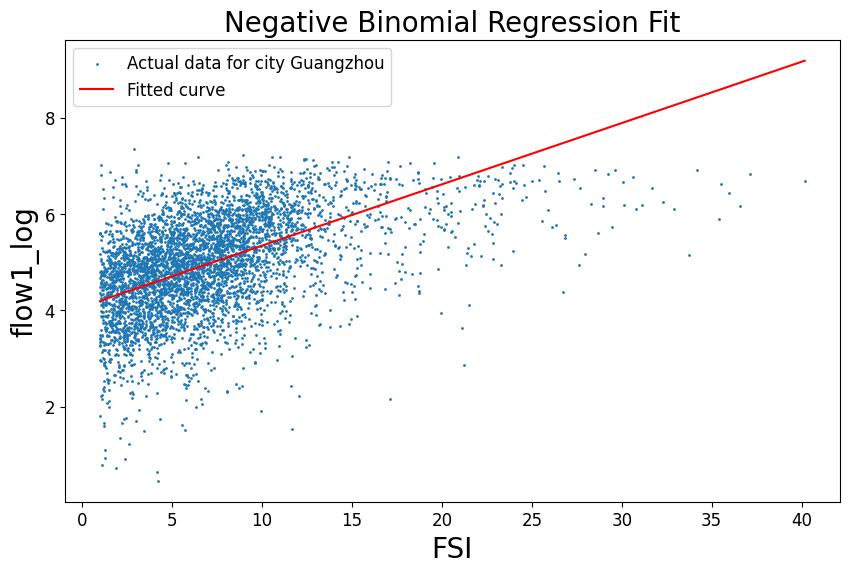

Guiyang
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:19   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

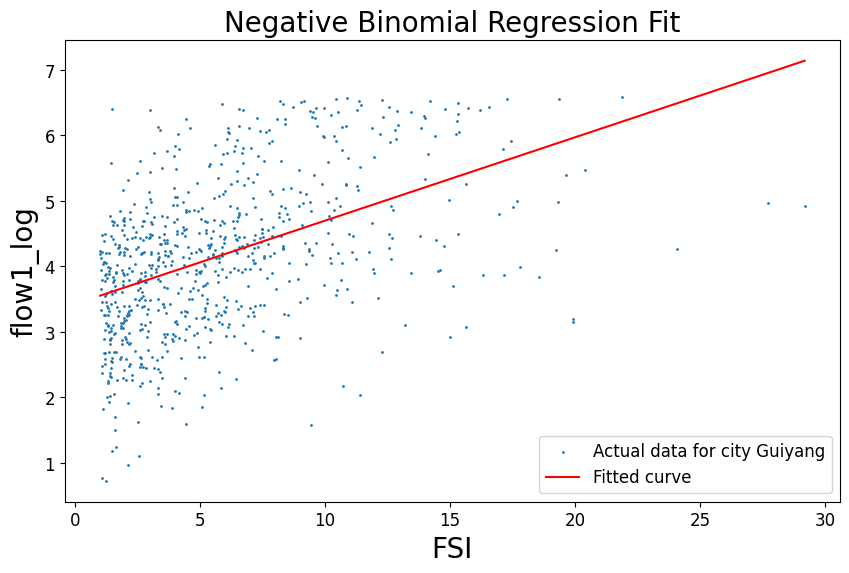

Hangzhou
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:19   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

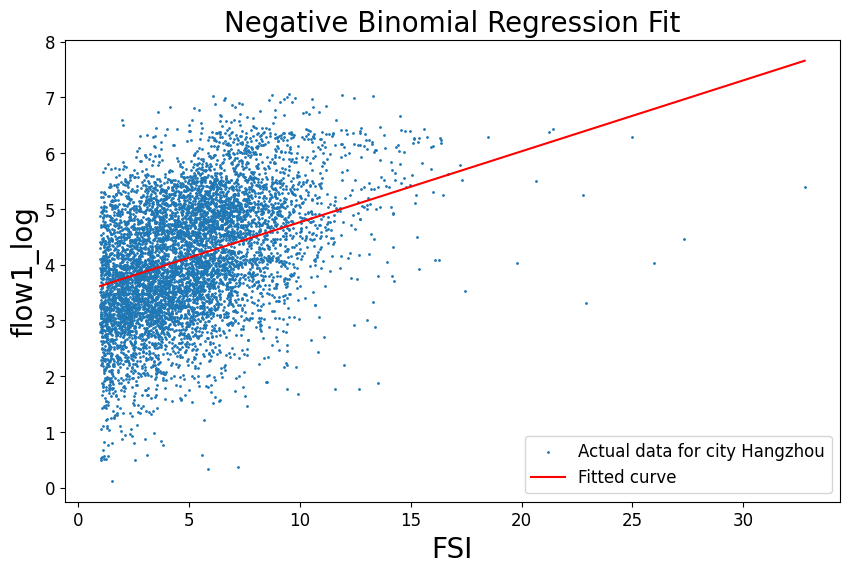

Harbin
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:20   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

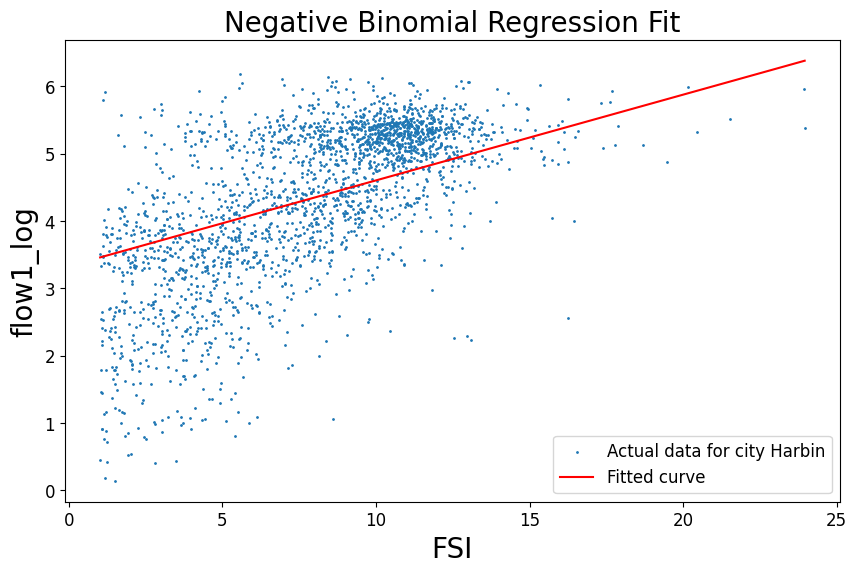

Hefei
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:20   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    3

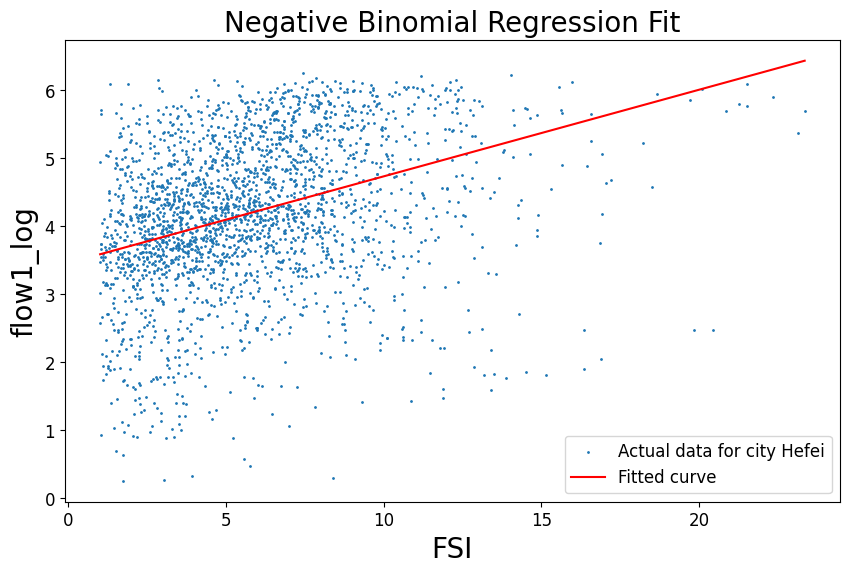

Huizhou
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:21   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

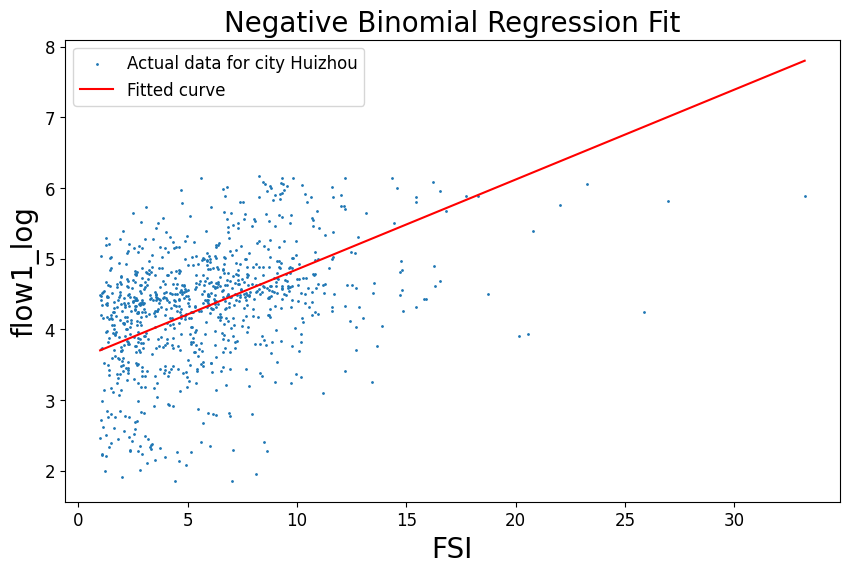

Kunming
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:21   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

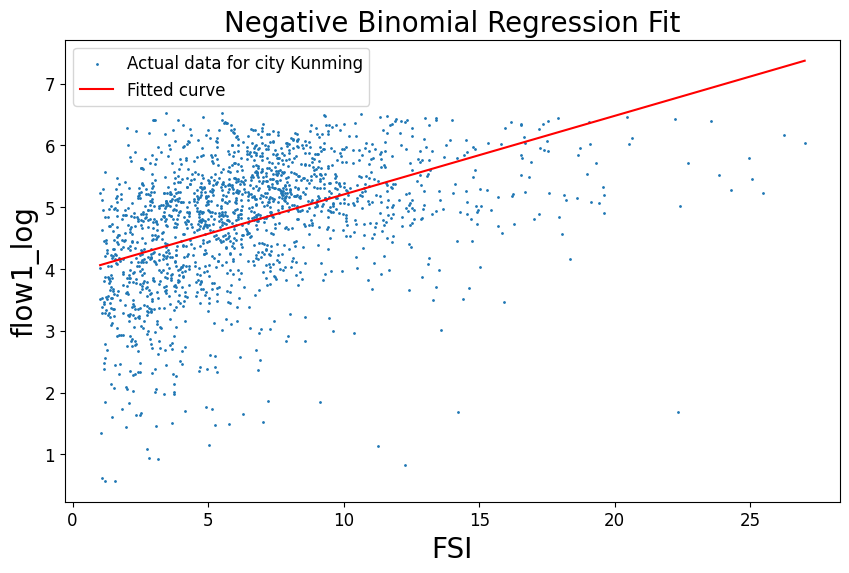

Langfang
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:22   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

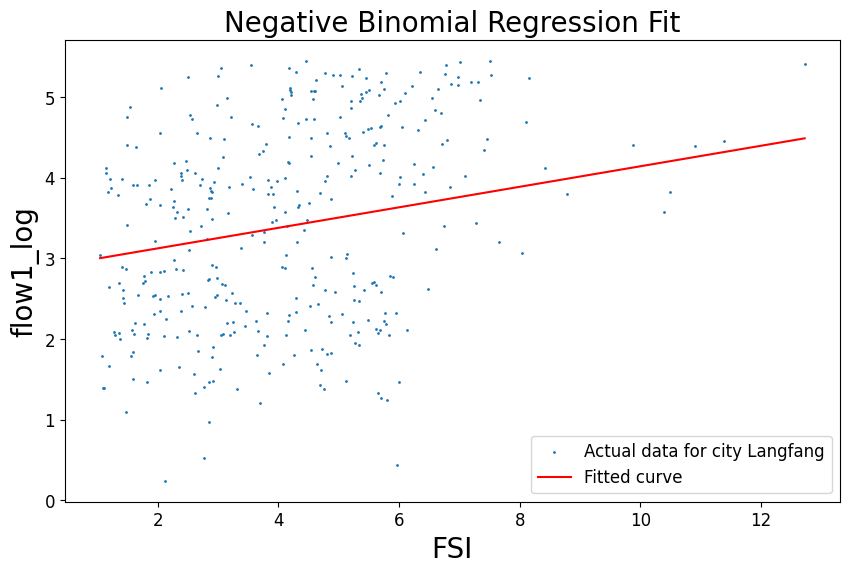

Nanchang
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:22   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

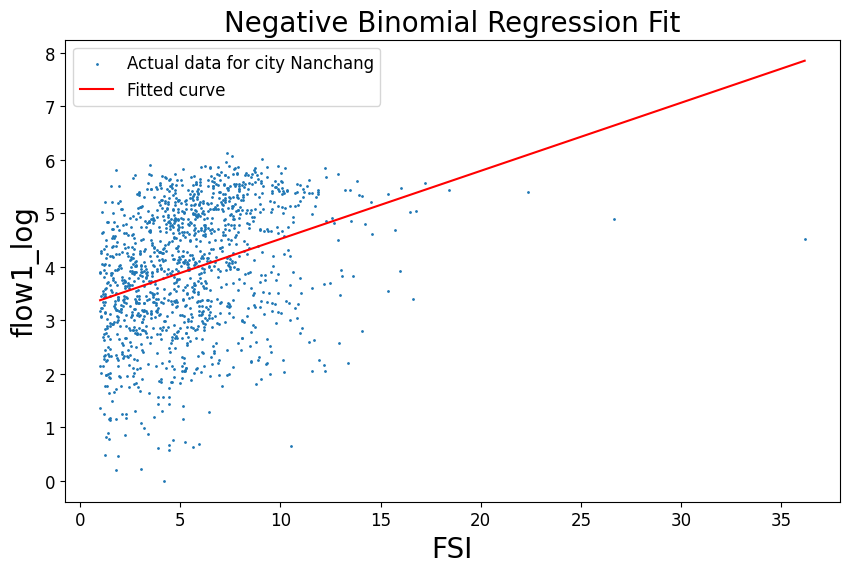

Nanjing
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:22   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

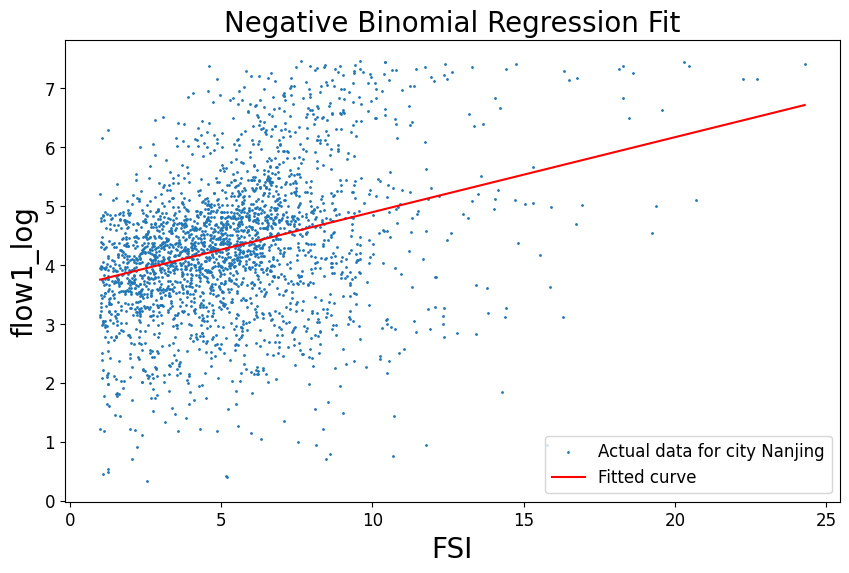

Ningbo
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:23   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

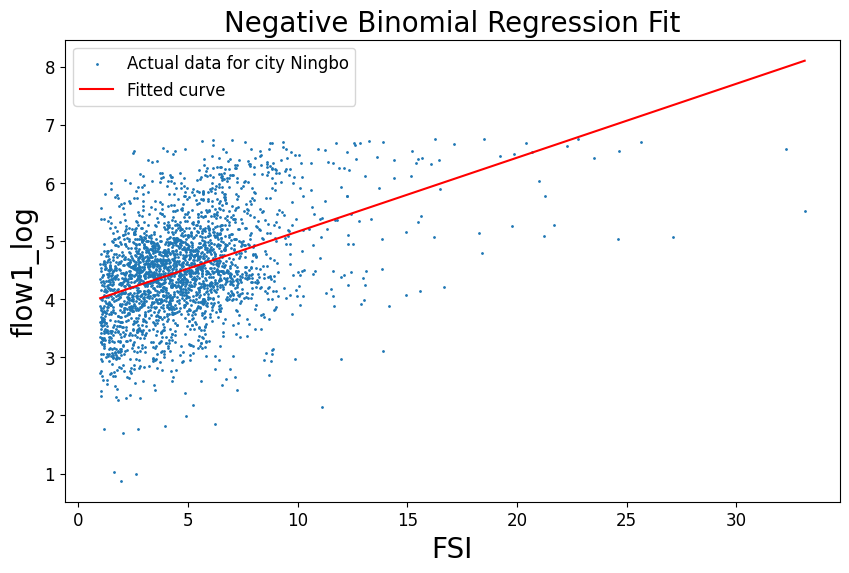

Qingdao
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:23   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

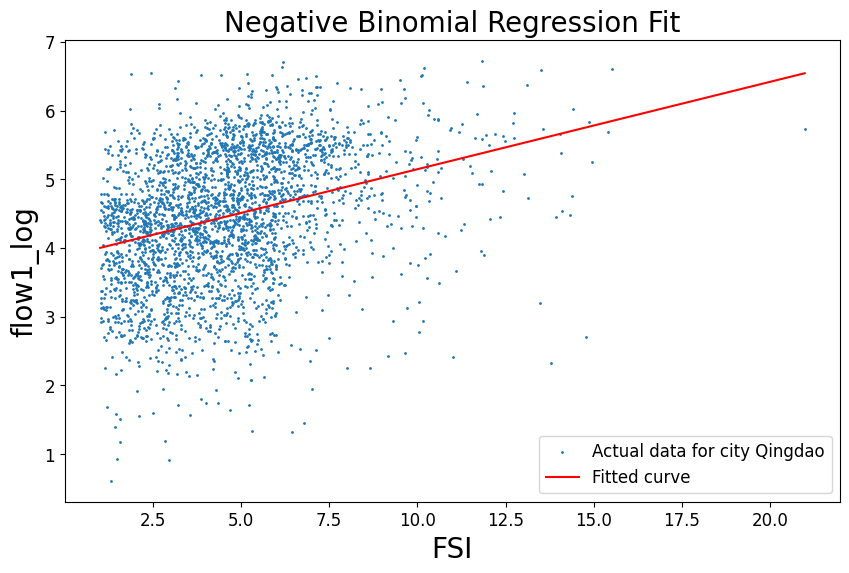

Sanya
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:24   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    3

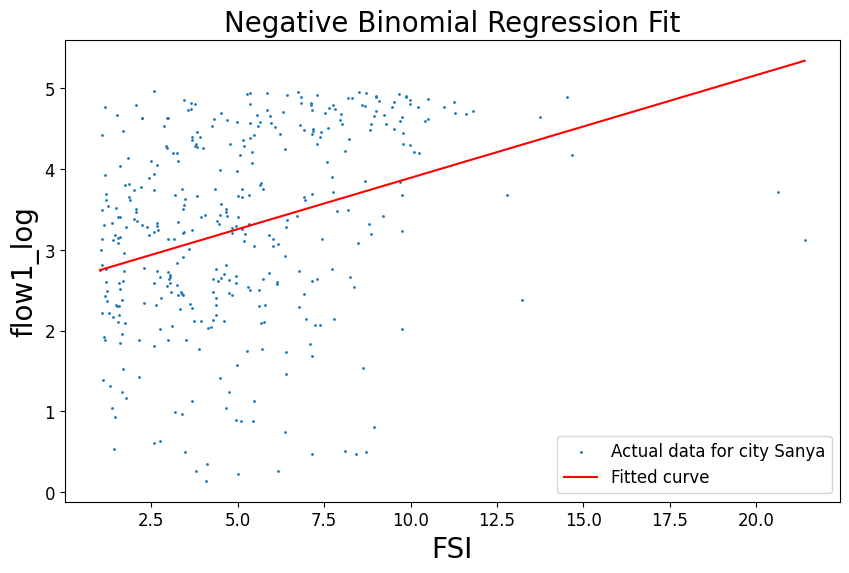

Shanghai
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:24   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

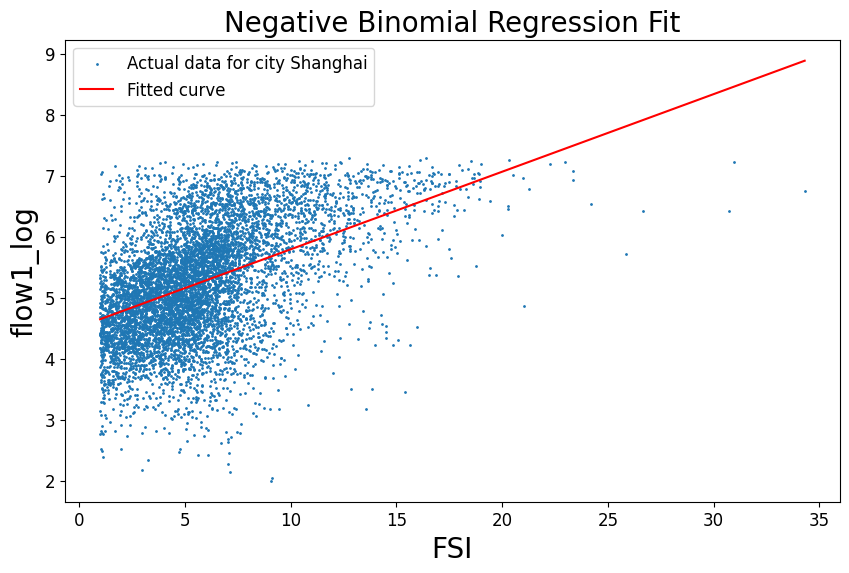

Shaoxing
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:25   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

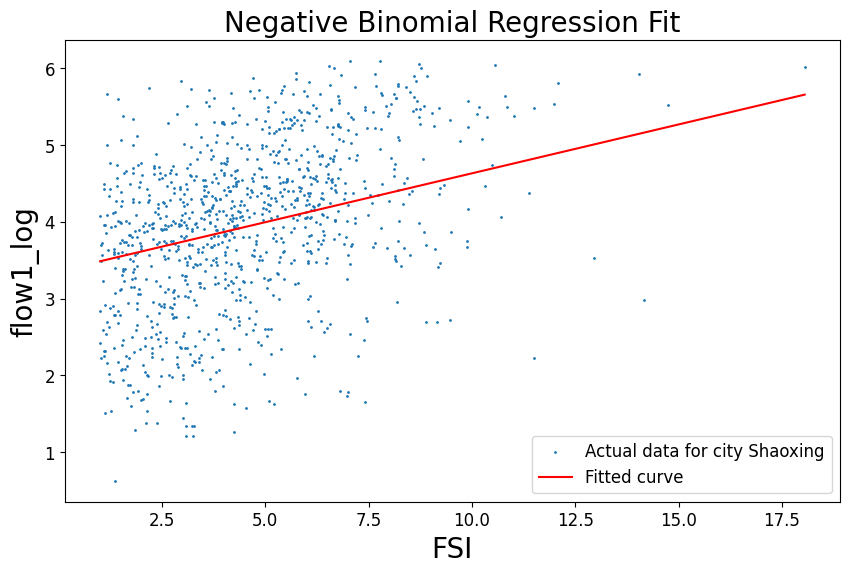

Shenyang
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:25   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

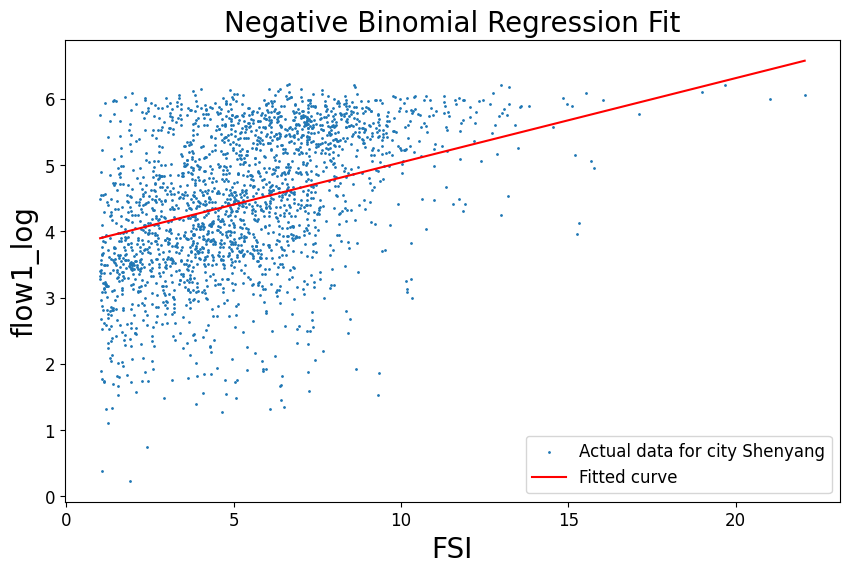

Shenzhen
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:26   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

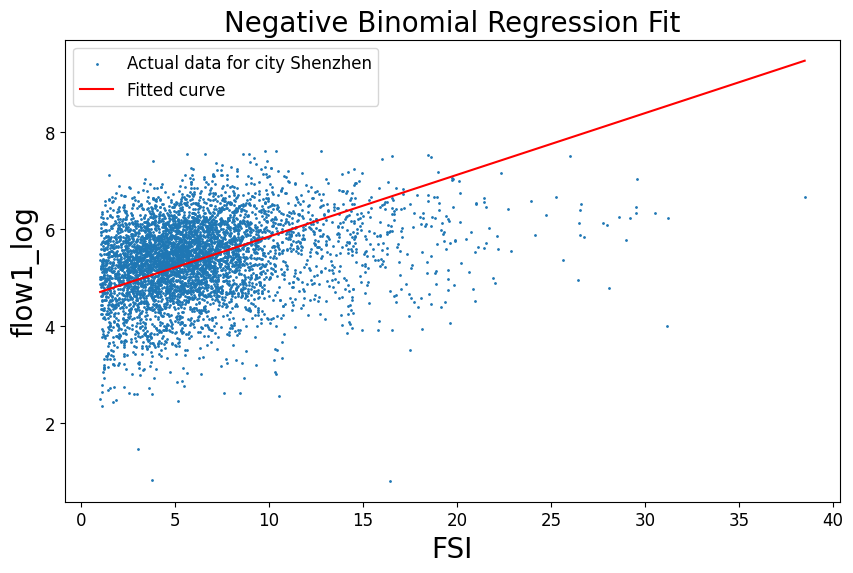

Suzhou
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:27   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

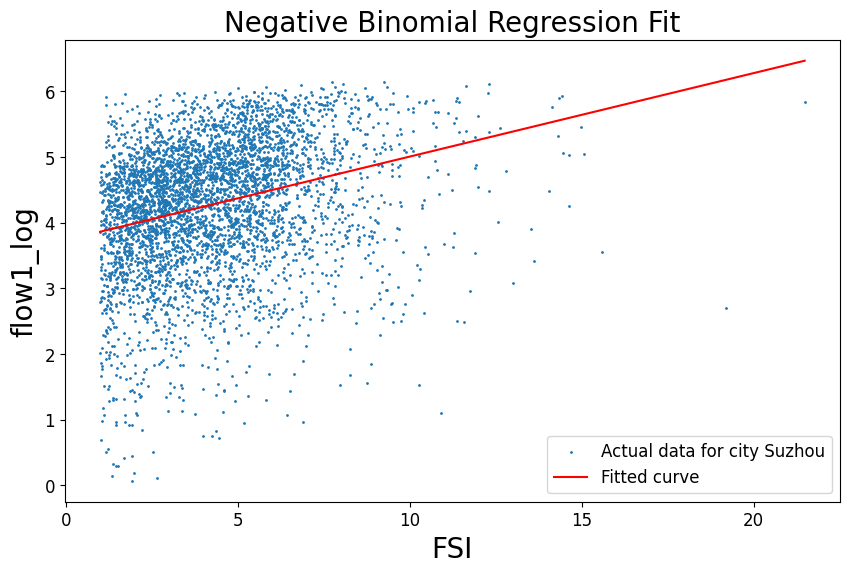

Taiyuan
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:27   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

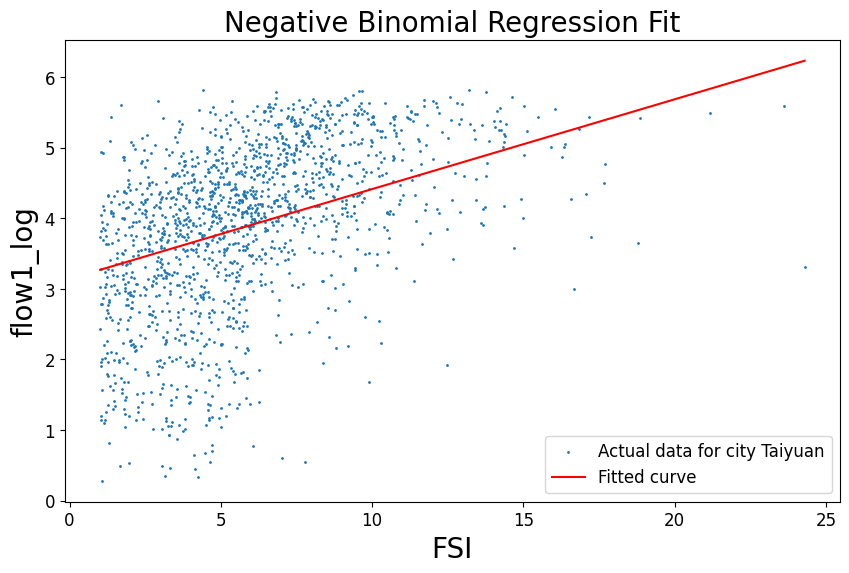

Tianjin
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:28   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012   

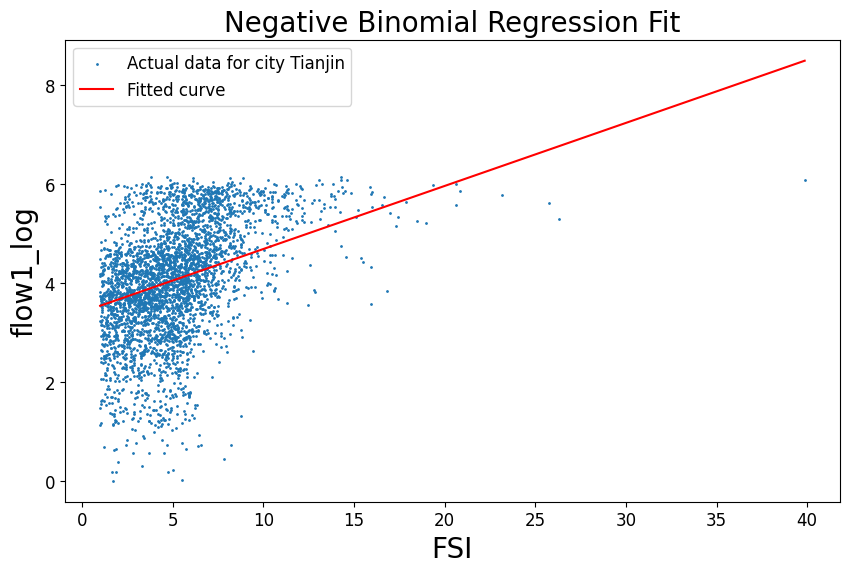

Wuhan
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:28   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    3

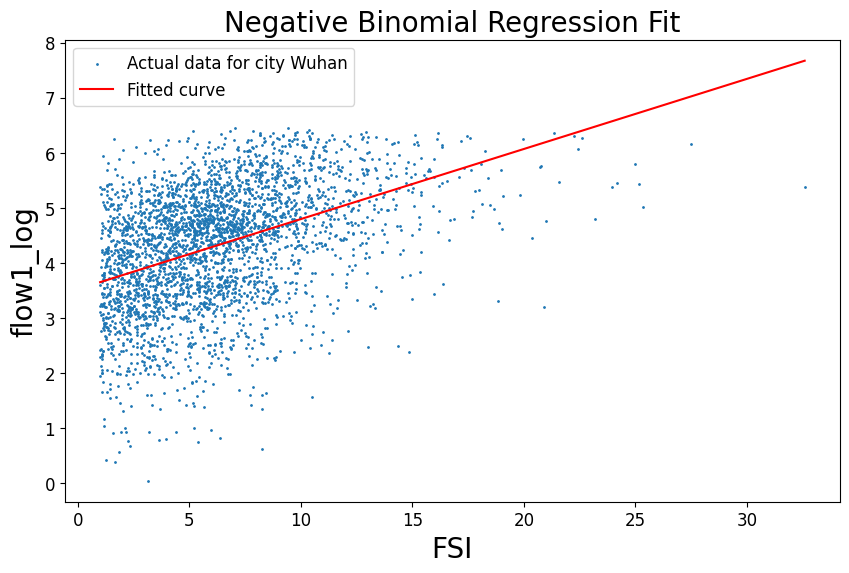

Wuxi
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:29   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    30

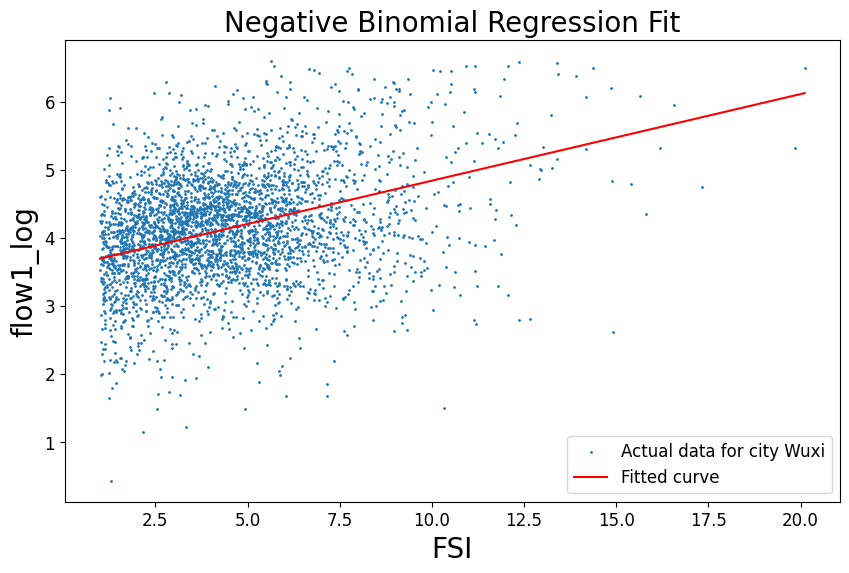

Xi_an
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:29   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    3

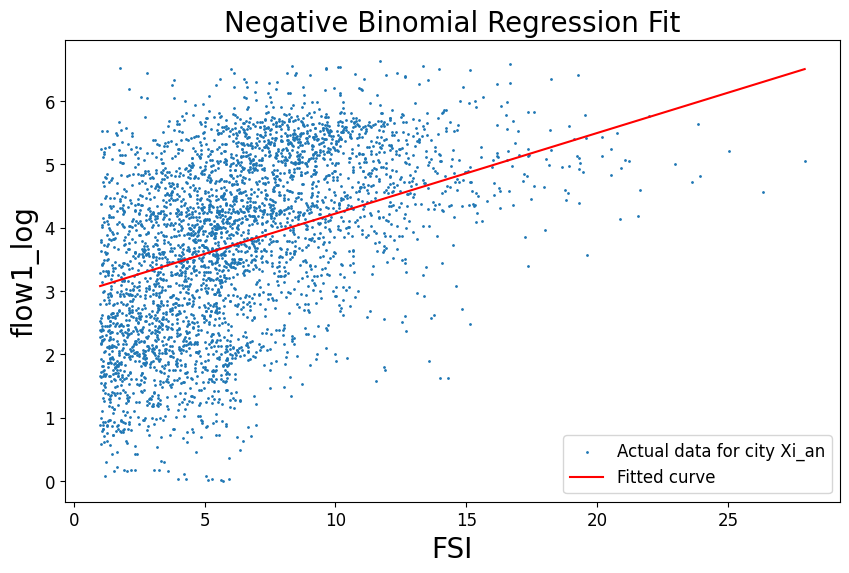

Xiamen
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:30   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

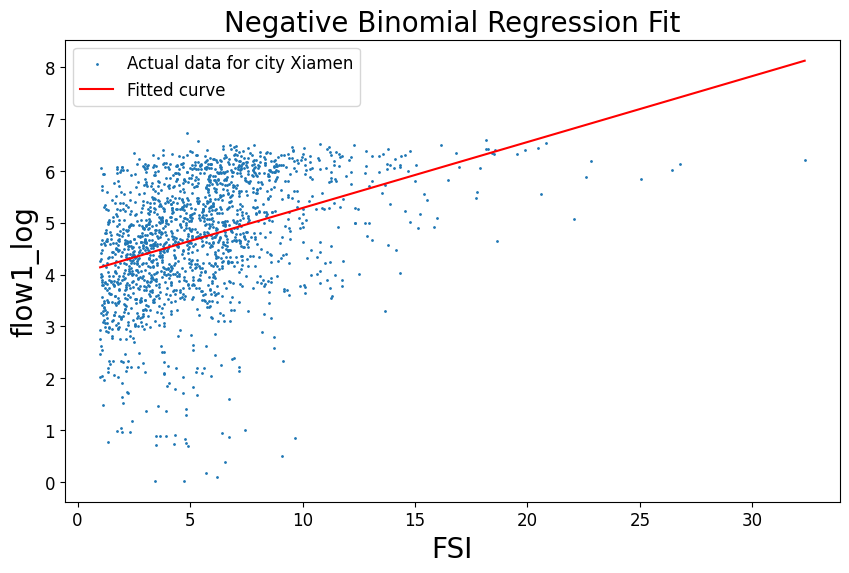

Xuzhou
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:30   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

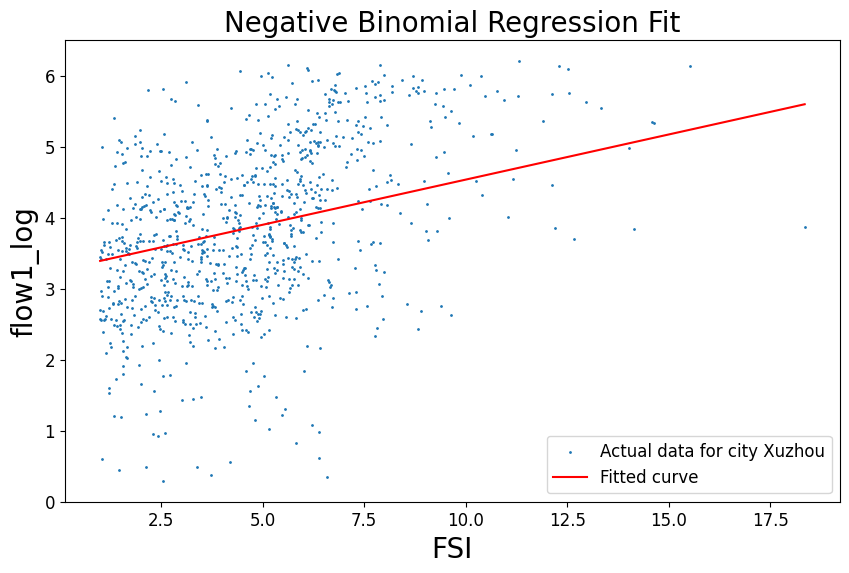

Yangzhou
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:31   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012  

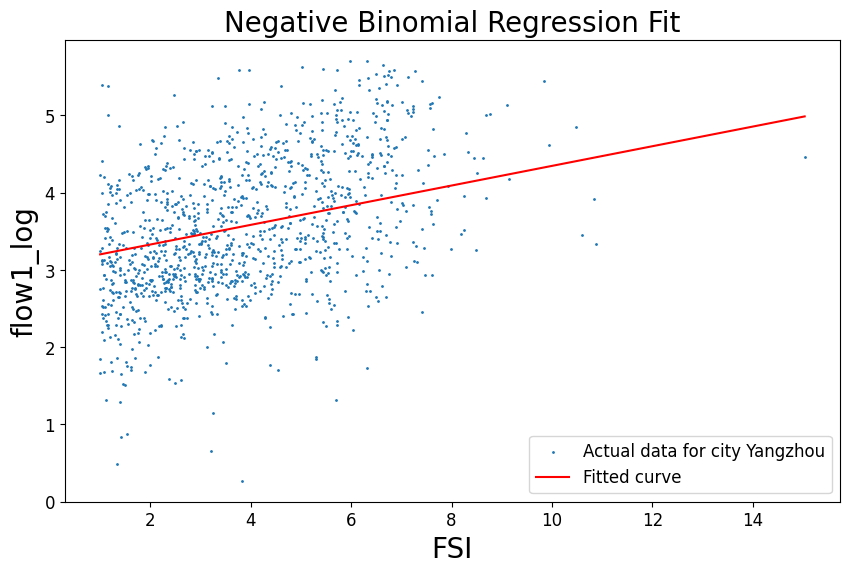

Zhengzhou
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:31   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012 

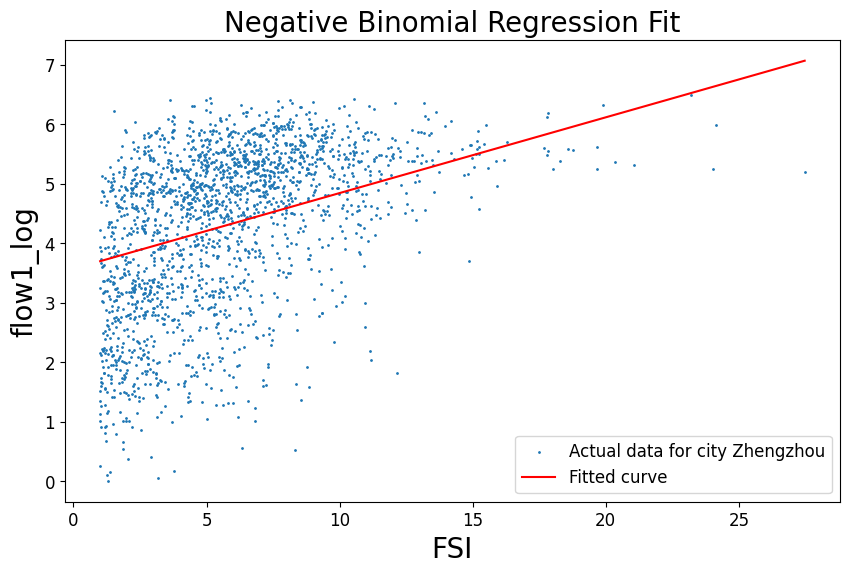

Zhenjiang
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:32   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012 

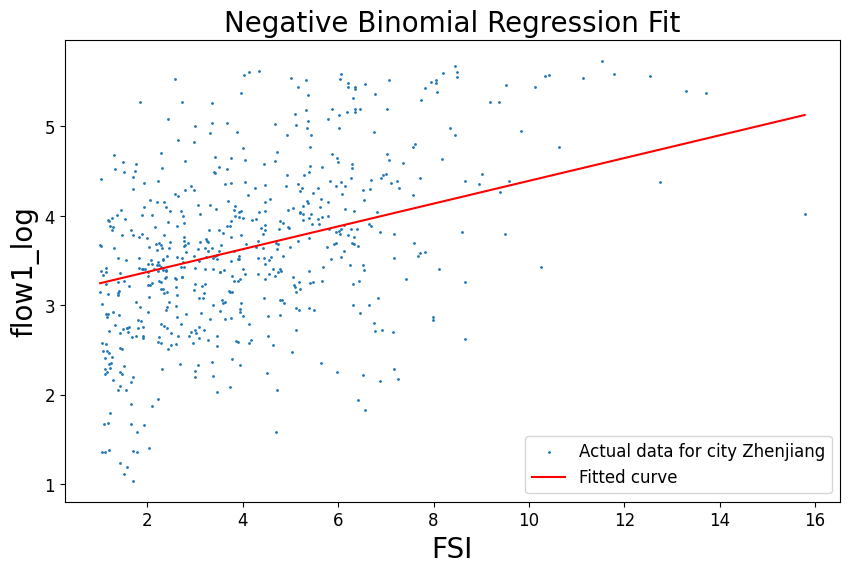

Zhongshan
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:32   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012 

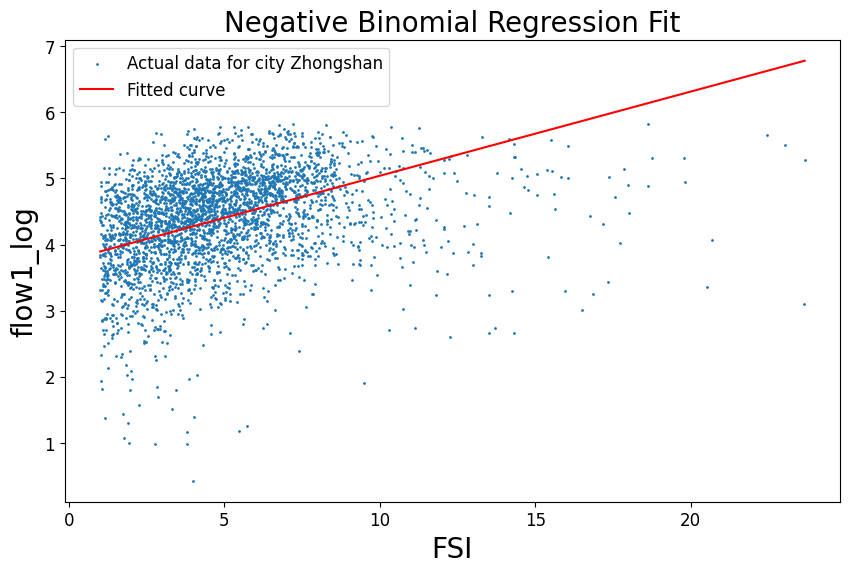

Zhuhai
                            OLS Regression Results                            
Dep. Variable:              flow1_log   R-squared:                       0.270
Model:                            OLS   Adj. R-squared:                  0.269
Method:                 Least Squares   F-statistic:                     849.5
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:33   Log-Likelihood:            -1.2191e+05
No. Observations:               87456   AIC:                         2.439e+05
Df Residuals:                   87417   BIC:                         2.443e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6374      0.012    

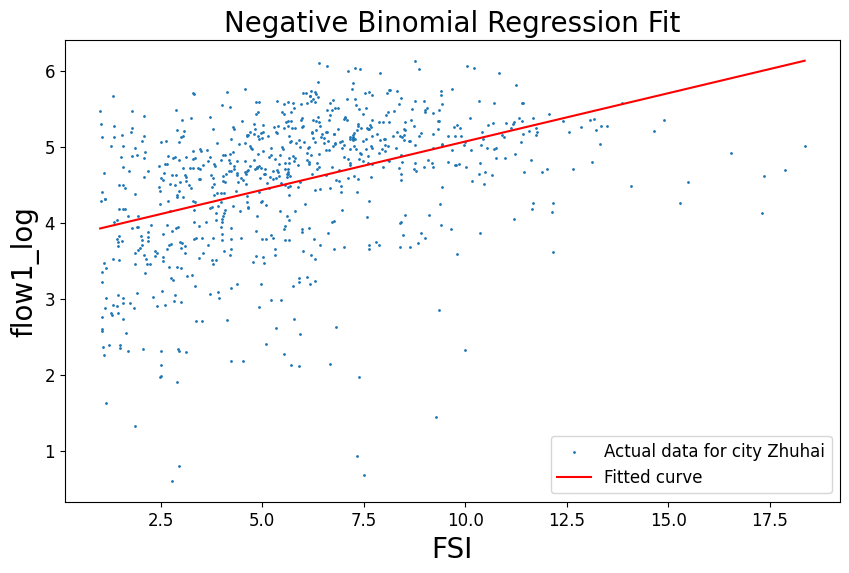

In [1646]:
pred_city_list = []
pred_flow1_df_list = []
mse_flow1_list = []


for i in range(len(city_list)):
    if len(joined_gdf_list[i])>0:
        print(city_list[i])
        result_df = create_Linear_regression_df(df,["FSI"],plot_cat = "flow1_log",area_cap=100000000,min_FSI=1,plot_city = i)
        result_df["city"] = city_list[i]
        if result_df.shape[0]>0:
            pred_city_list.append(city_list[i])
            pred_flow1_df_list.append(result_df)
            mse = mean_squared_error(result_df["flow1_log-og"], result_df["pred"])
            mse_flow1_list.append(mse)

Beijing
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:33   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

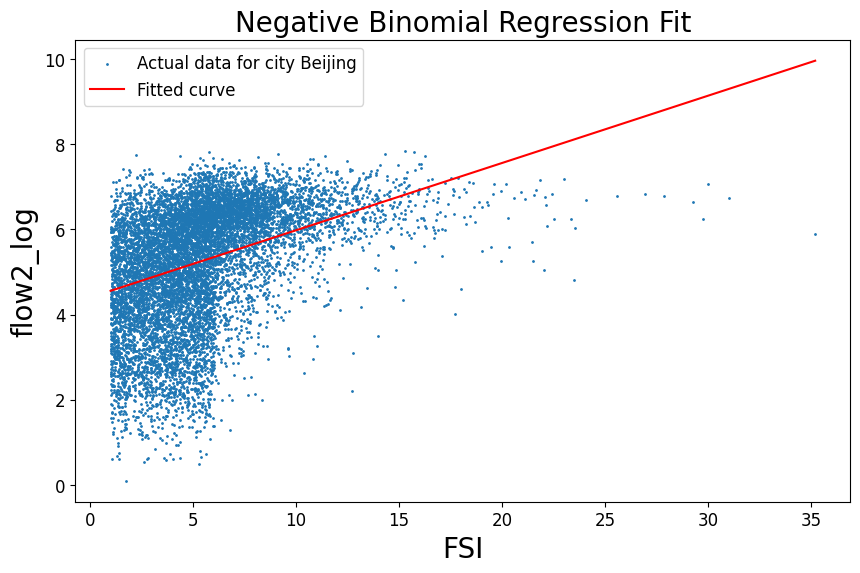

Changsha
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:34   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

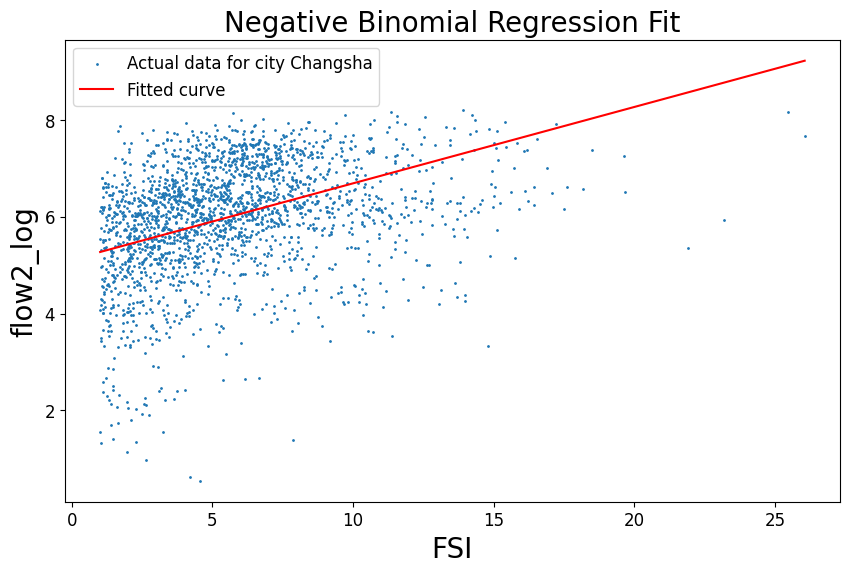

Chengdu
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:34   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

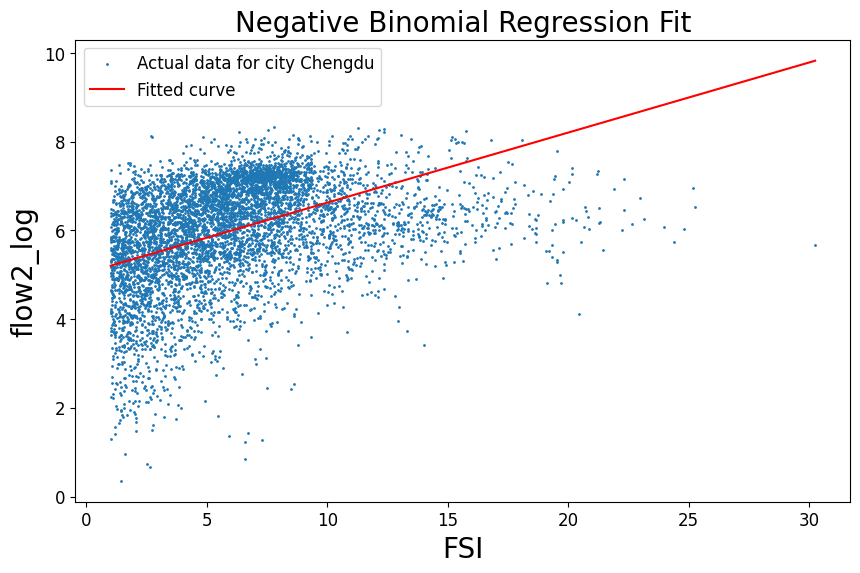

Chongqing
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:35   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014 

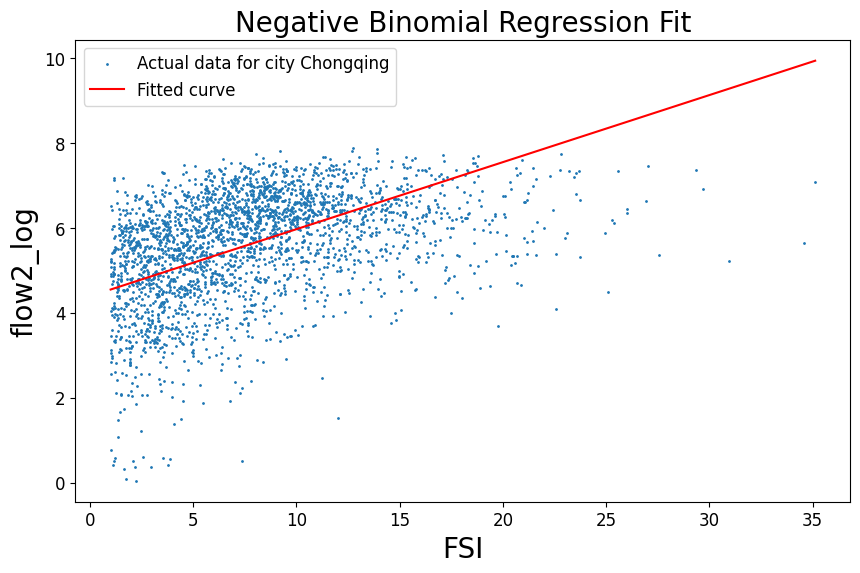

Dalian
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:35   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

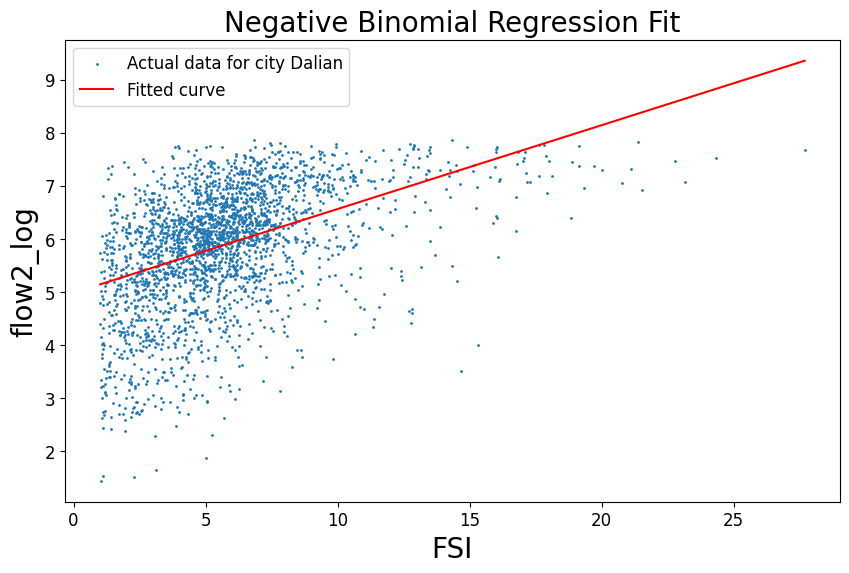

Dongguan
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:36   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

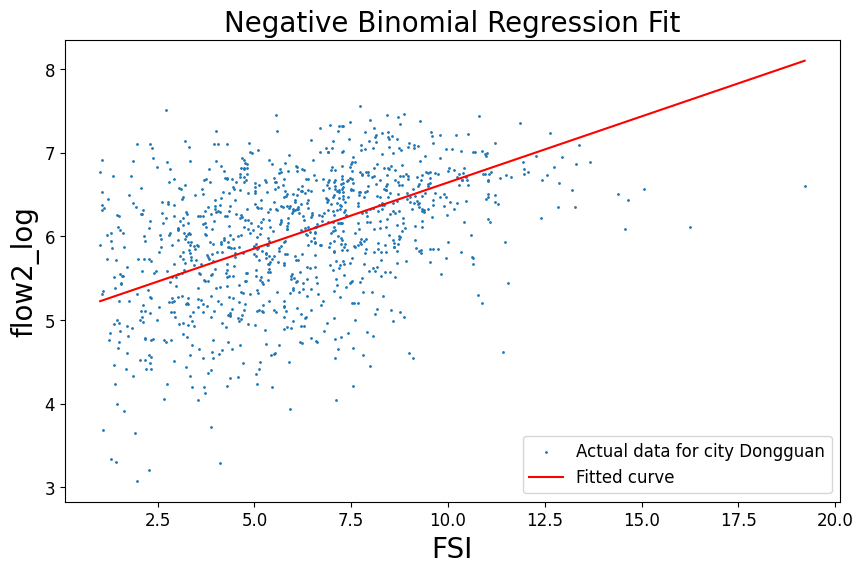

Foshan
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:36   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

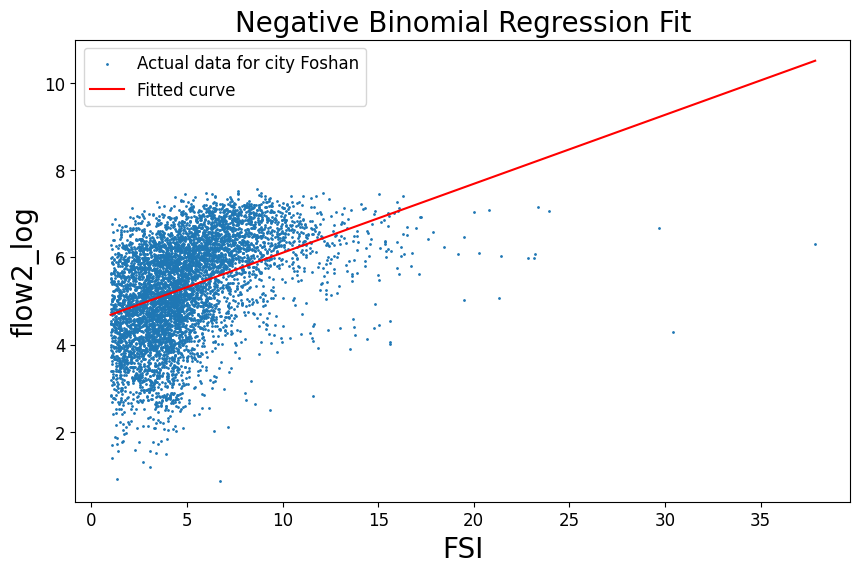

Fuzhou
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:37   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

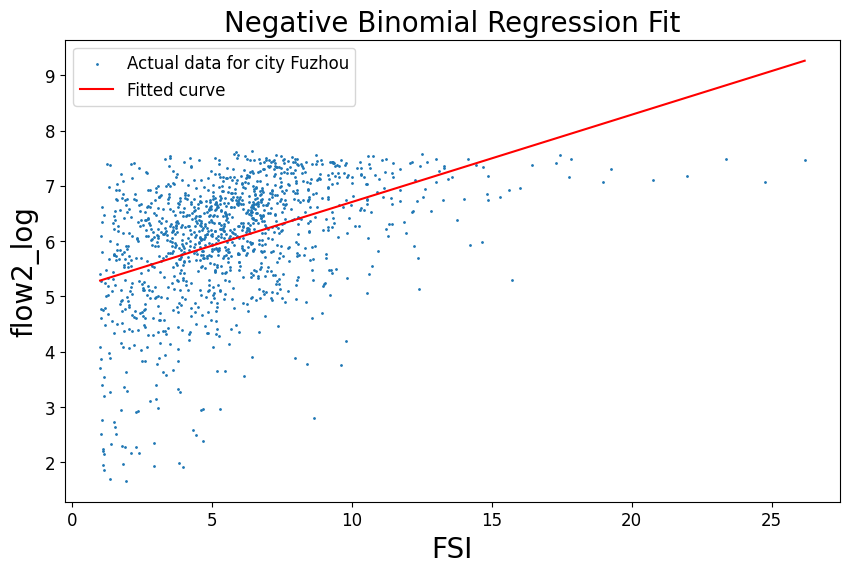

Guangzhou
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:37   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014 

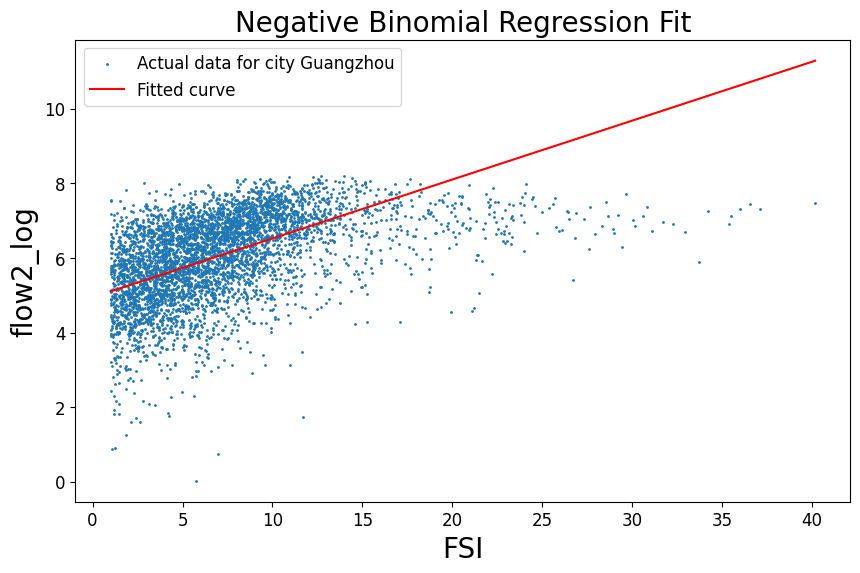

Guiyang
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:38   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

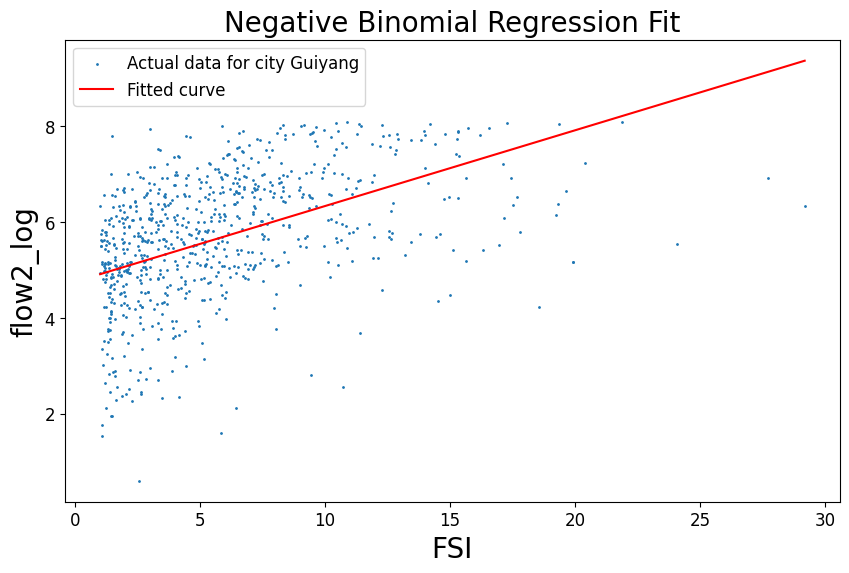

Hangzhou
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:38   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

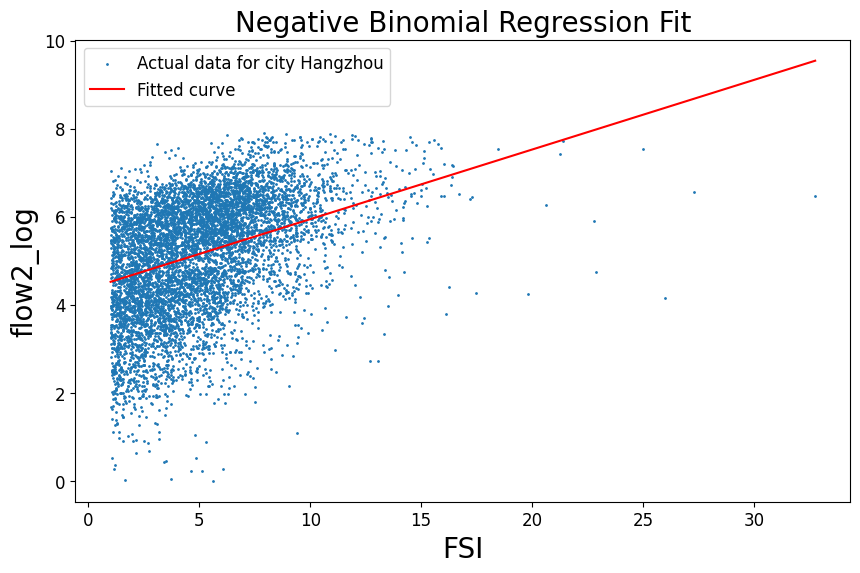

Harbin
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:39   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

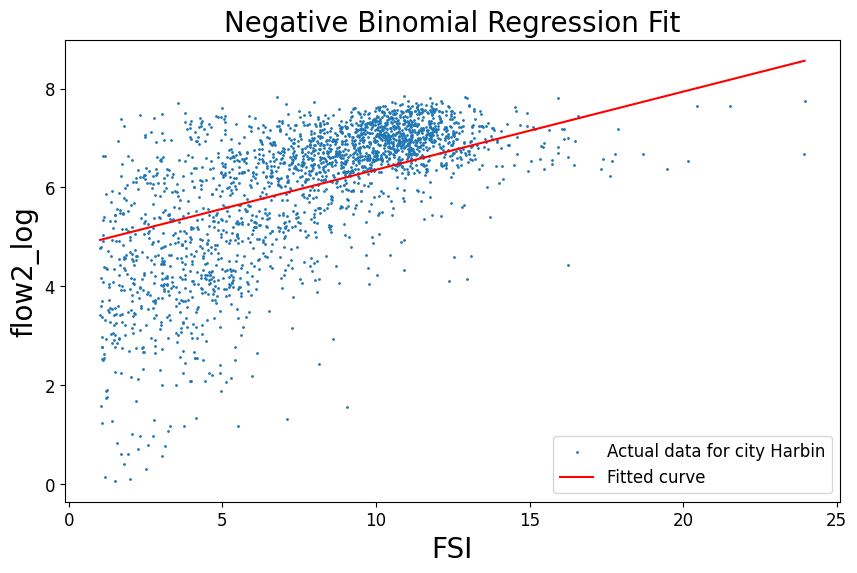

Hefei
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:39   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    3

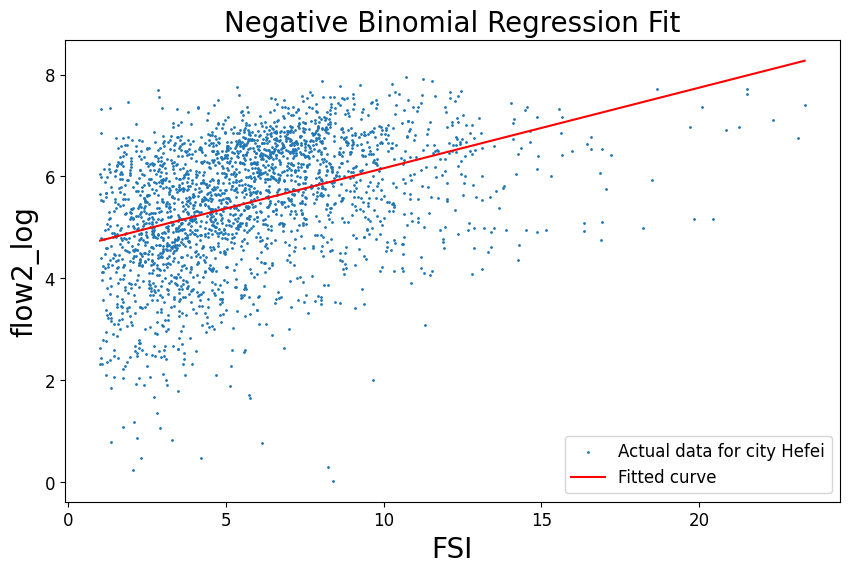

Huizhou
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:40   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

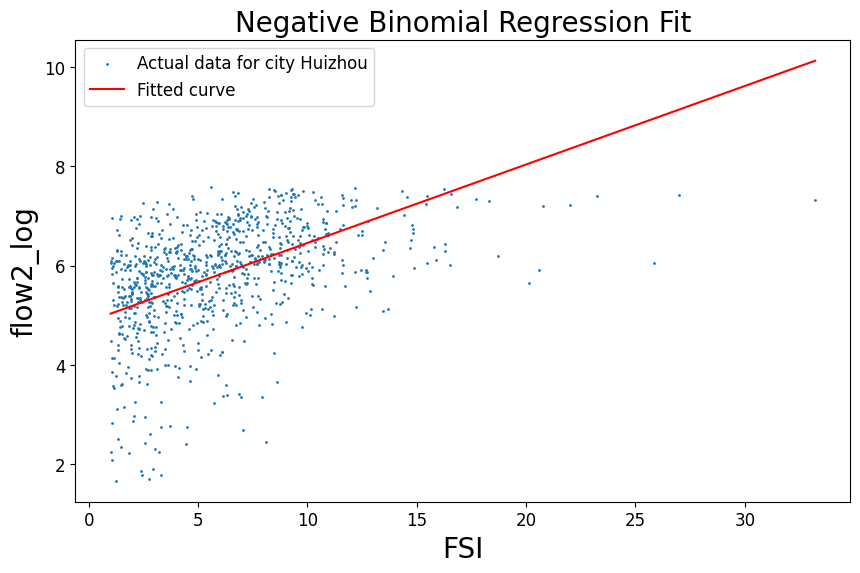

Kunming
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:40   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

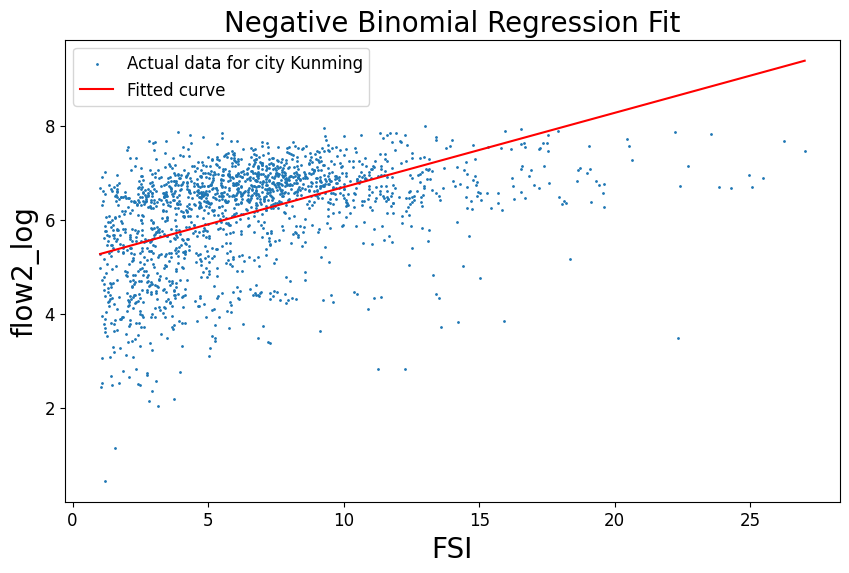

Langfang
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:41   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

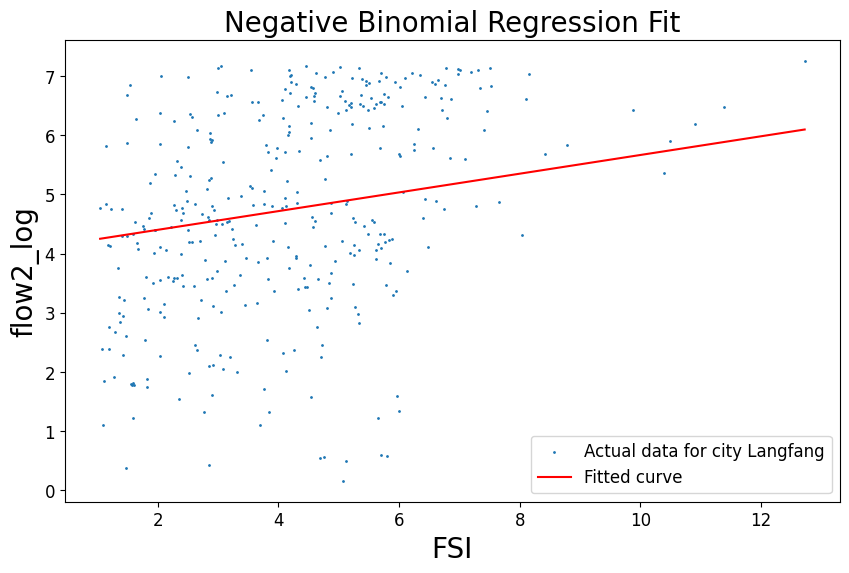

Nanchang
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:41   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

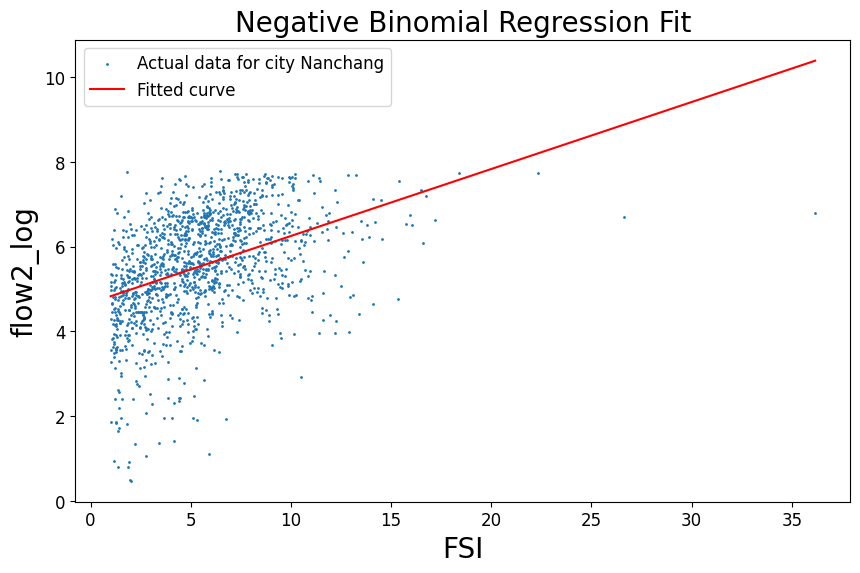

Nanjing
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:42   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

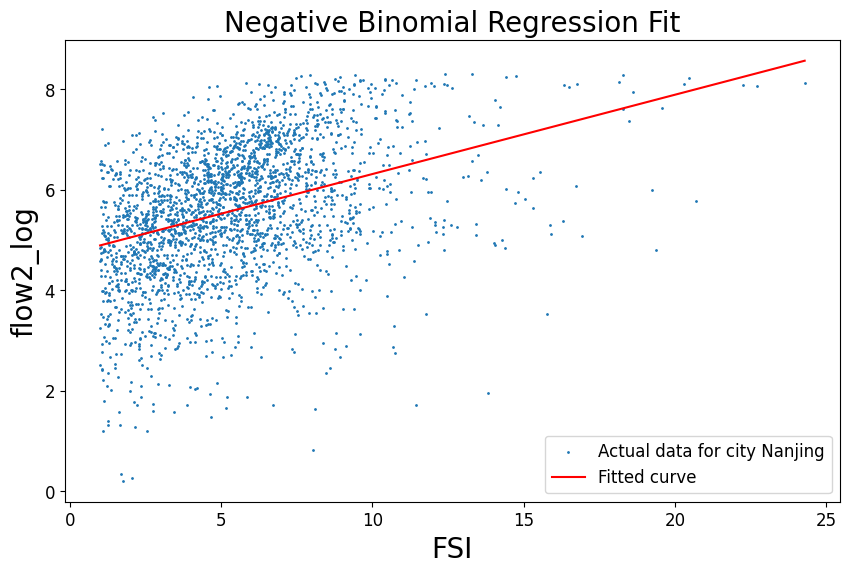

Ningbo
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:42   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

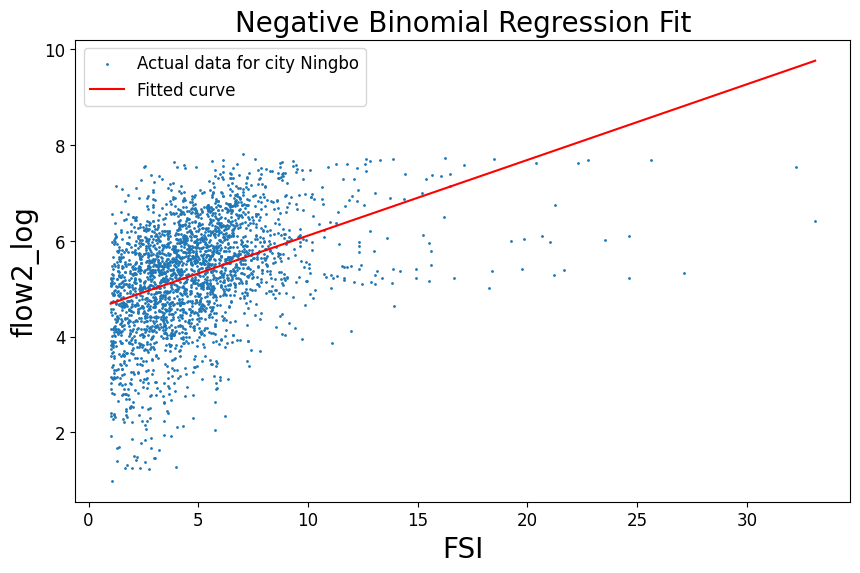

Qingdao
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:43   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

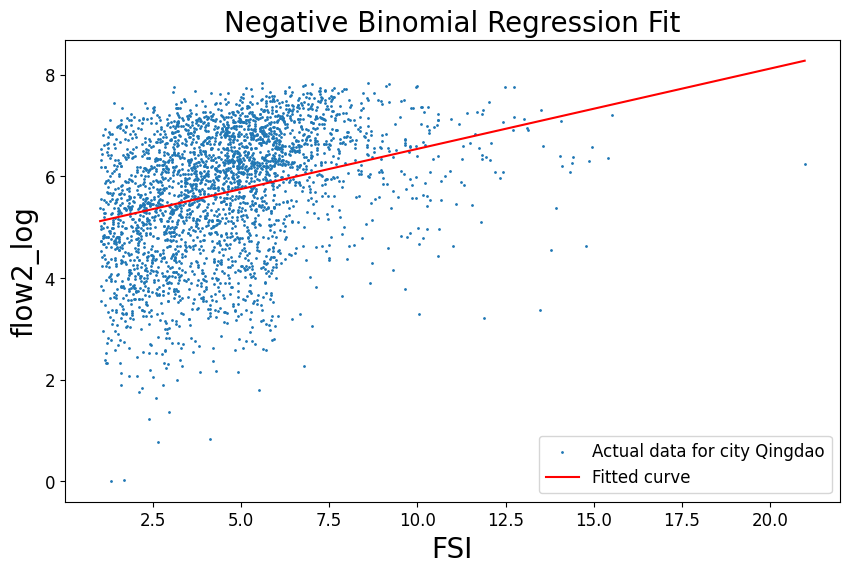

Sanya
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:43   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    3

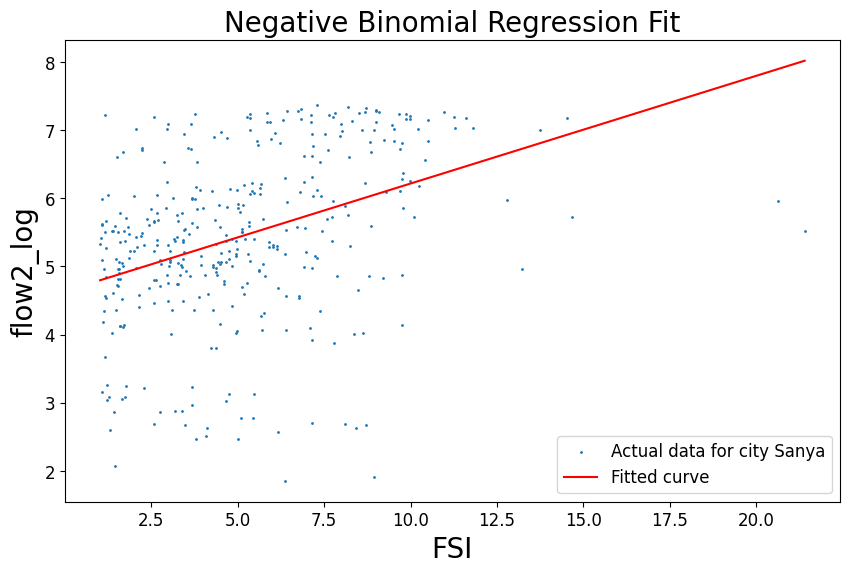

Shanghai
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:44   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

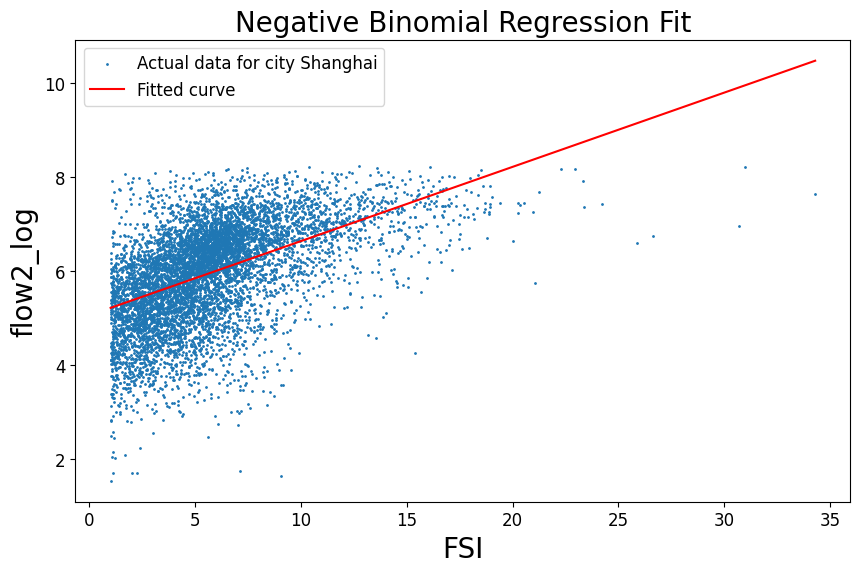

Shaoxing
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:44   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

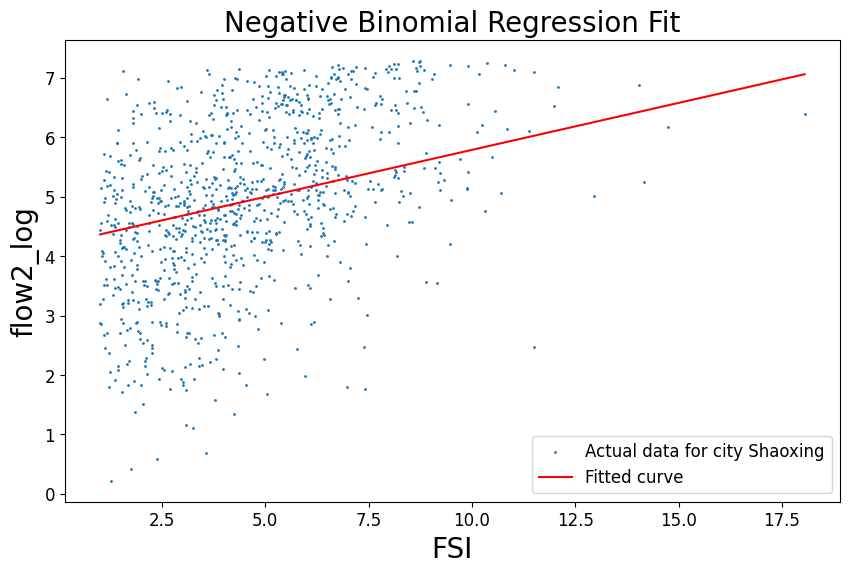

Shenyang
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:45   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

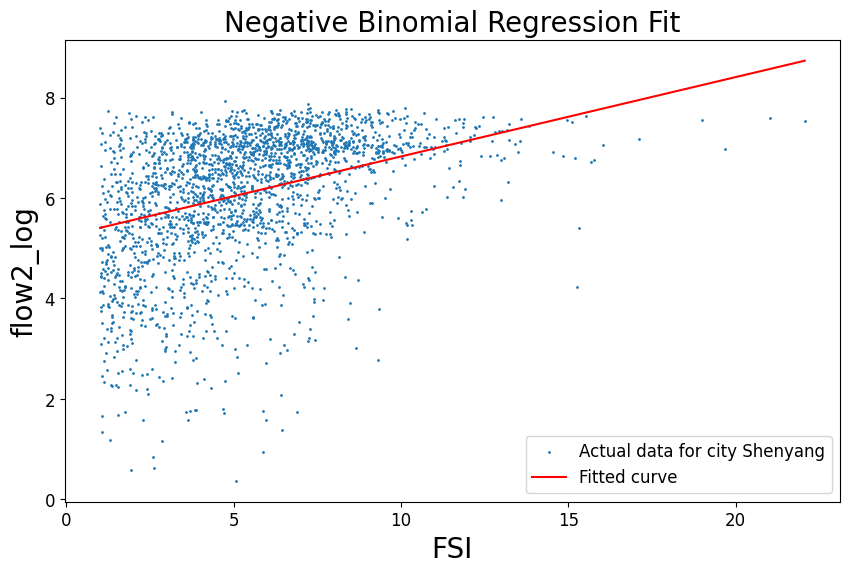

Shenzhen
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:45   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

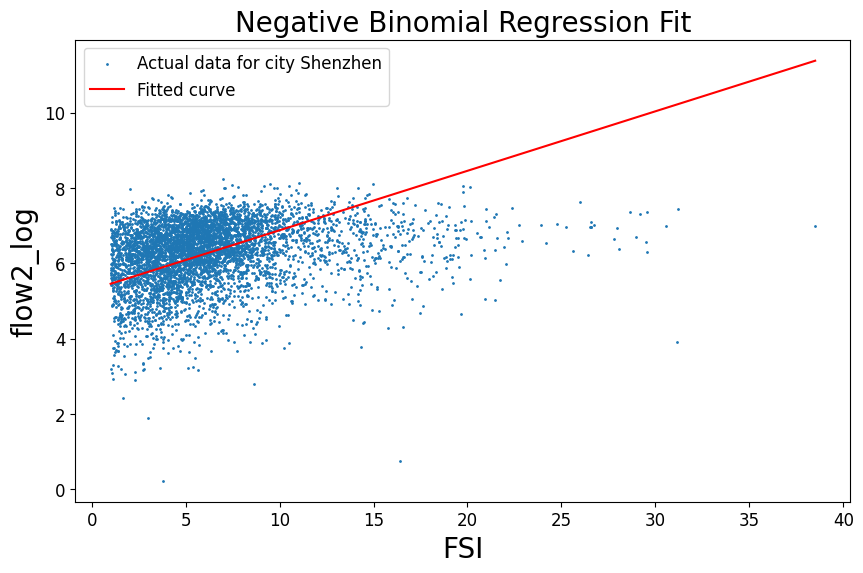

Suzhou
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:46   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

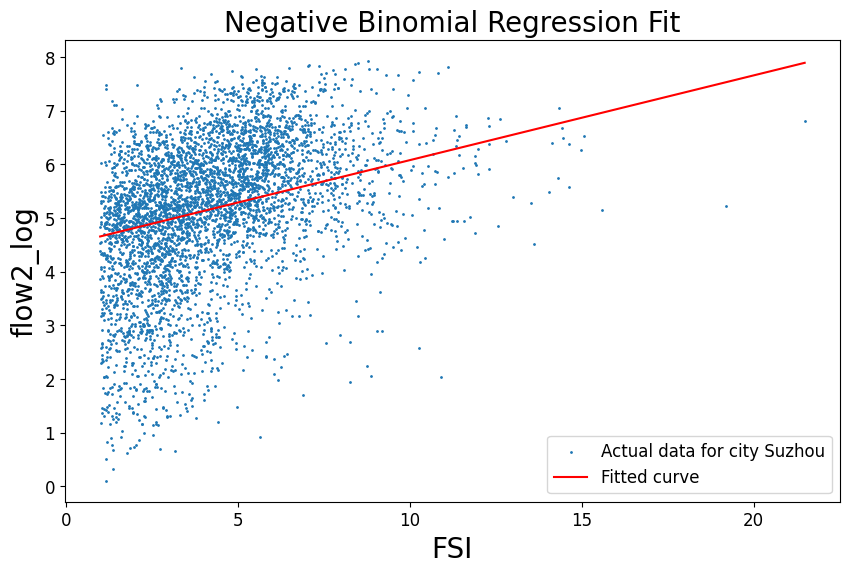

Taiyuan
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:46   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

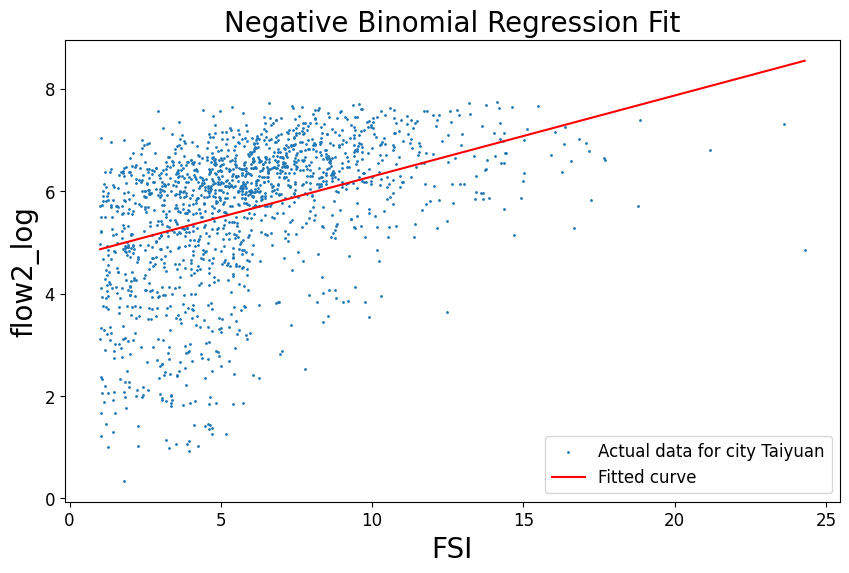

Tianjin
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:47   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014   

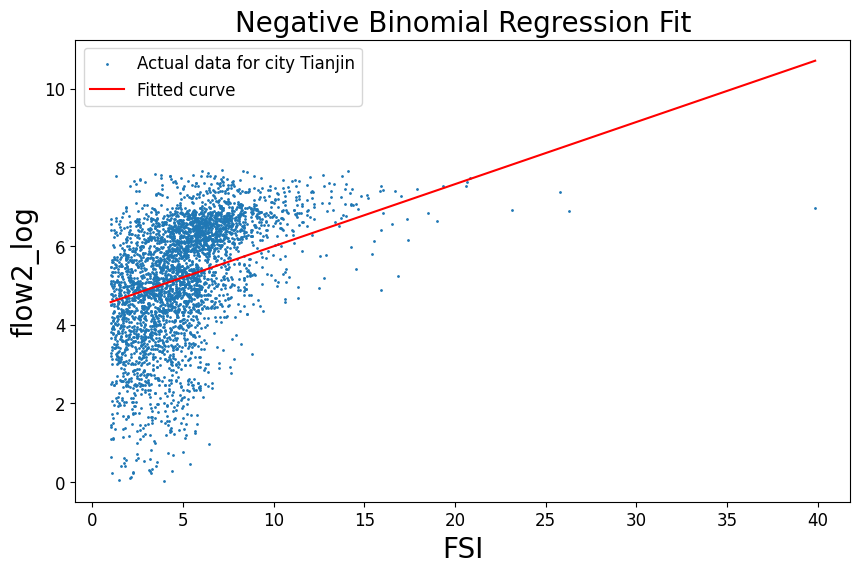

Wuhan
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:47   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    3

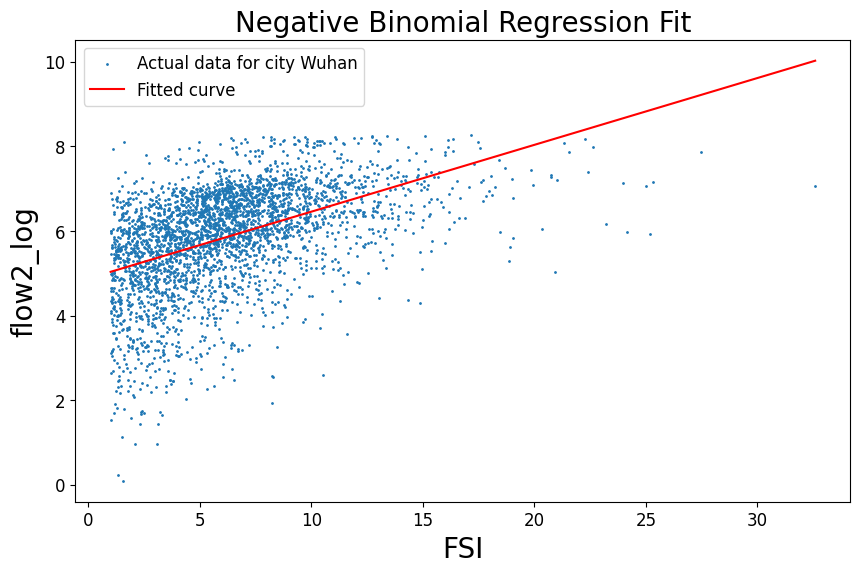

Wuxi
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:48   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    31

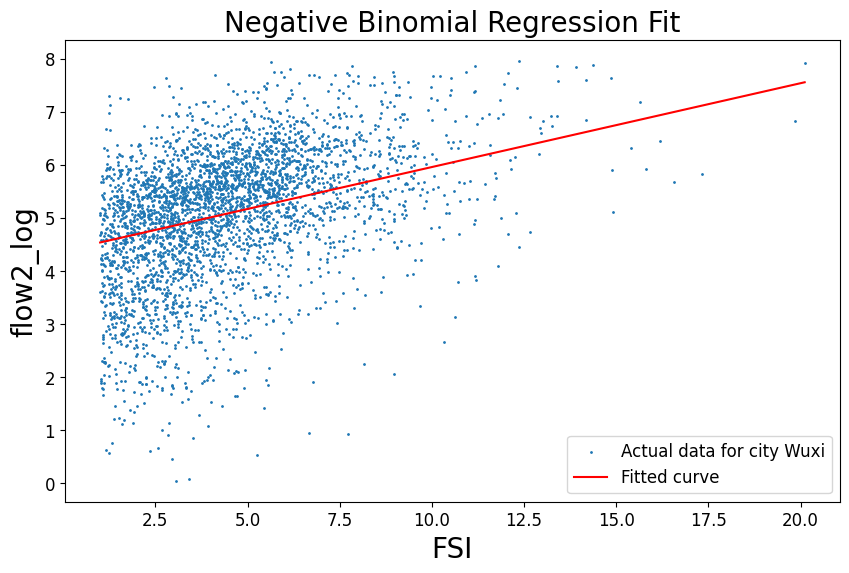

Xi_an
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:48   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    3

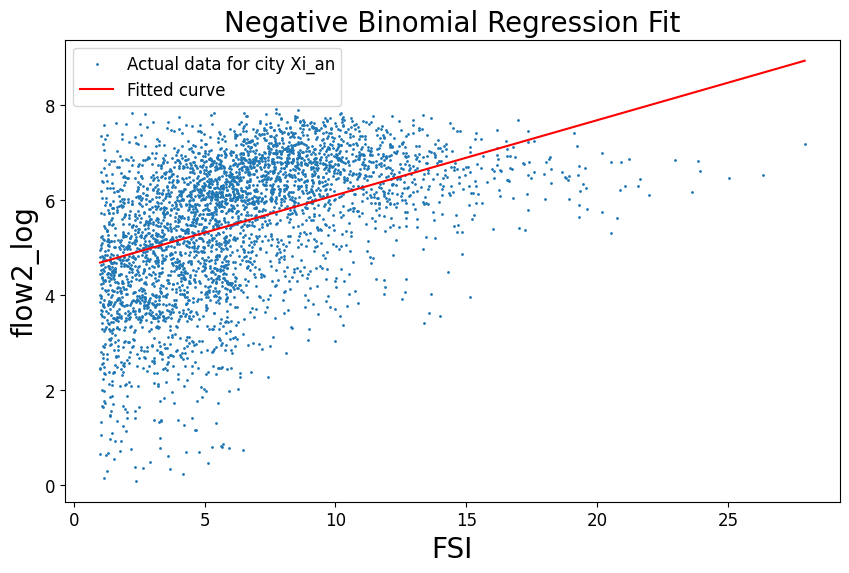

Xiamen
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:50   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

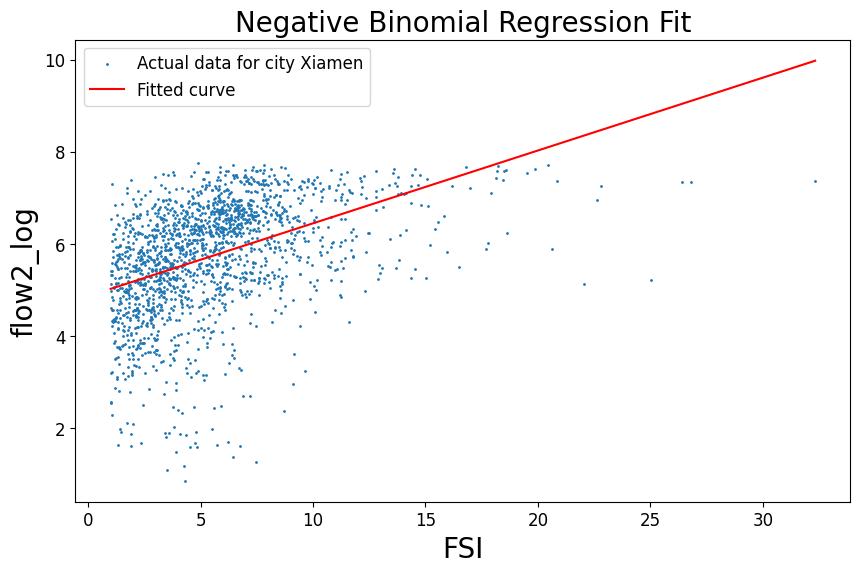

Xuzhou
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:51   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

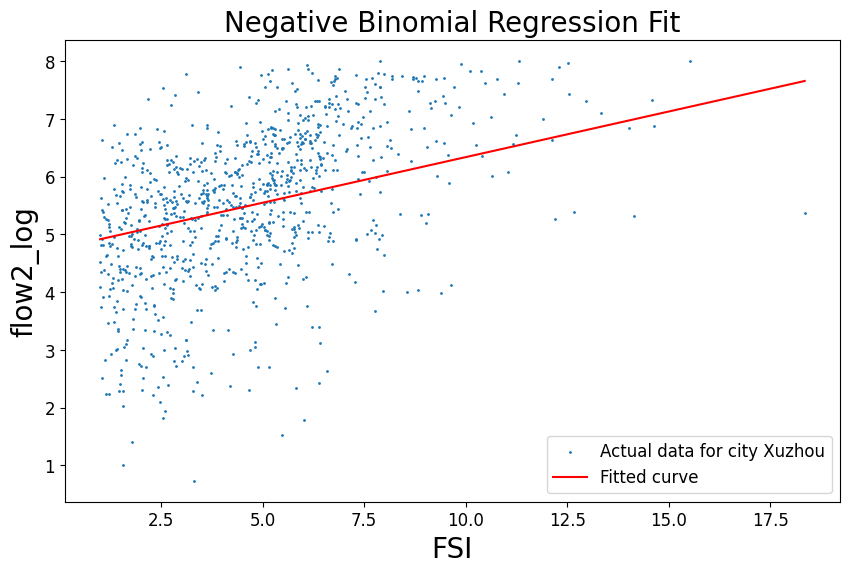

Yangzhou
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:51   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014  

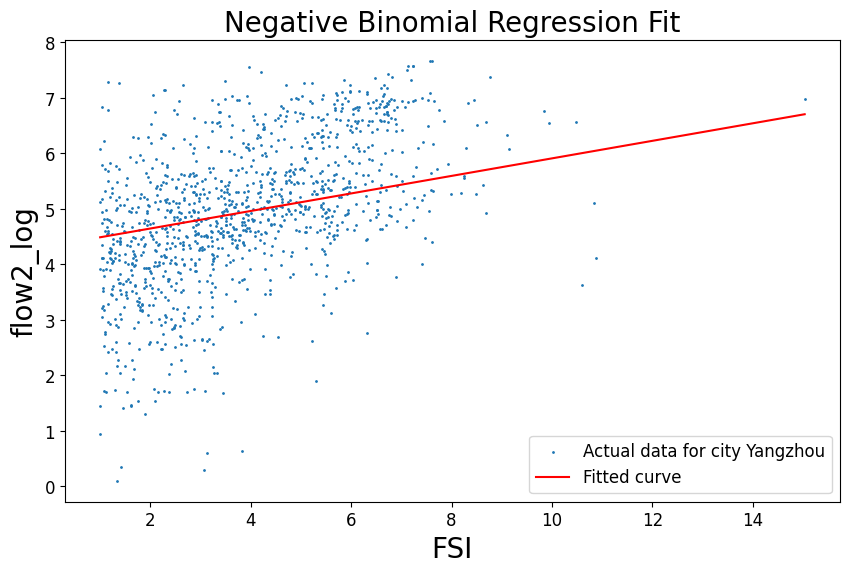

Zhengzhou
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:52   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014 

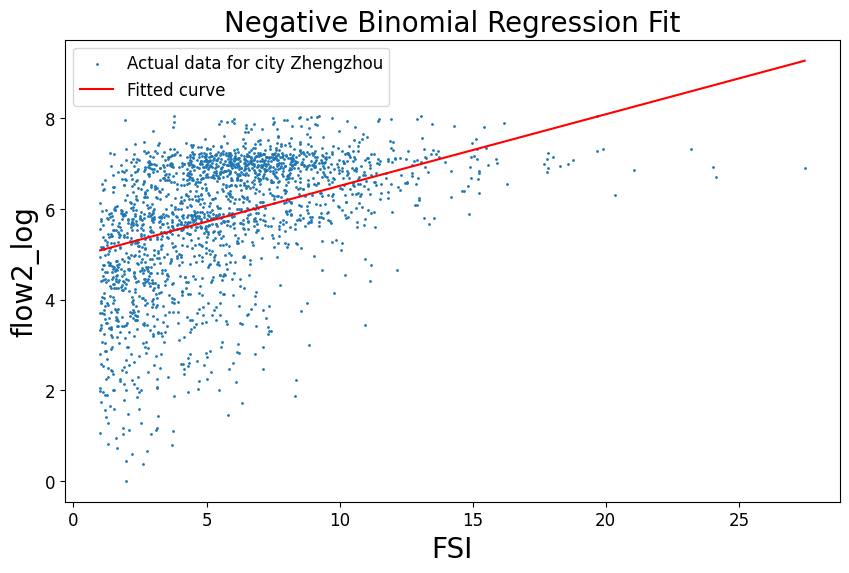

Zhenjiang
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:52   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014 

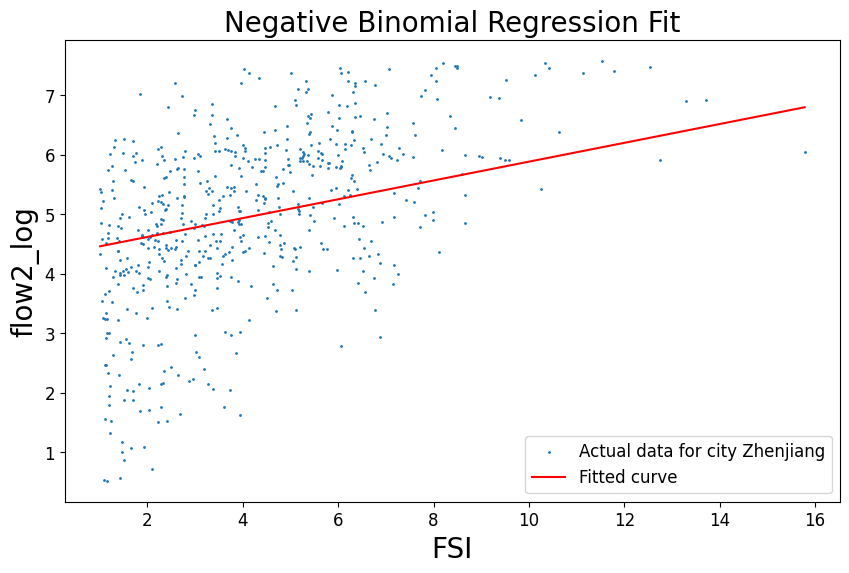

Zhongshan
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:53   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014 

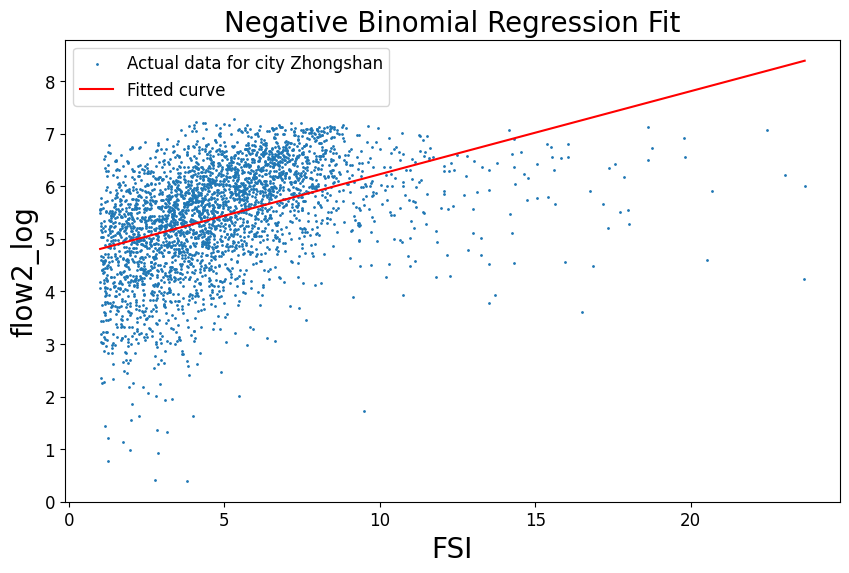

Zhuhai
                            OLS Regression Results                            
Dep. Variable:              flow2_log   R-squared:                       0.245
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     748.4
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:53   Log-Likelihood:            -1.3411e+05
No. Observations:               87468   AIC:                         2.683e+05
Df Residuals:                   87429   BIC:                         2.687e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.4008      0.014    

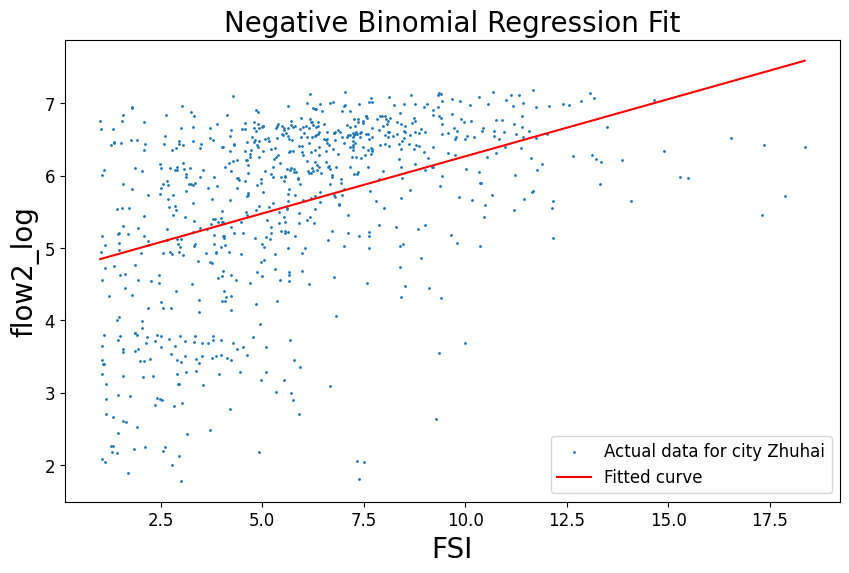

In [1647]:
pred_city_list = []
pred_flow2_df_list = []
mse_flow2_list = []


for i in range(len(city_list)):
    if len(joined_gdf_list[i])>0:
        print(city_list[i])
        result_df = create_Linear_regression_df(df,["FSI"],plot_cat = "flow2_log",area_cap=100000000,min_FSI=1,plot_city = i)
        result_df["city"] = city_list[i]
        if result_df.shape[0]>0:
            pred_city_list.append(city_list[i])
            pred_flow2_df_list.append(result_df)
            mse = mean_squared_error(result_df["flow2_log-og"], result_df["pred"])
            mse_flow2_list.append(mse)

Beijing
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:54   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

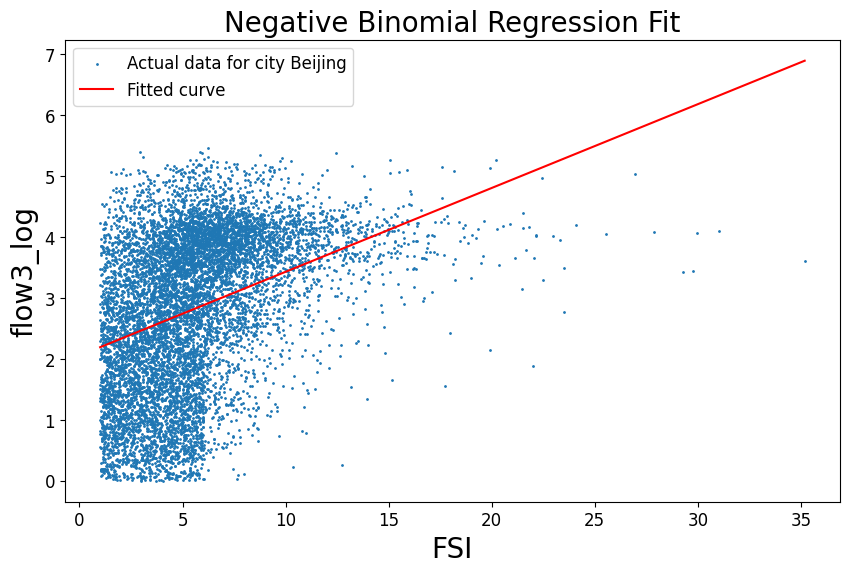

Changsha
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:54   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

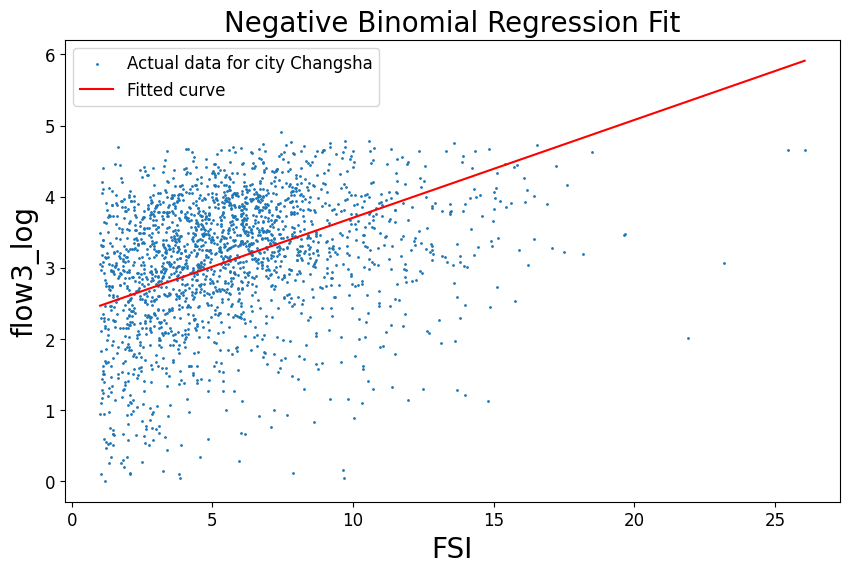

Chengdu
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:55   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

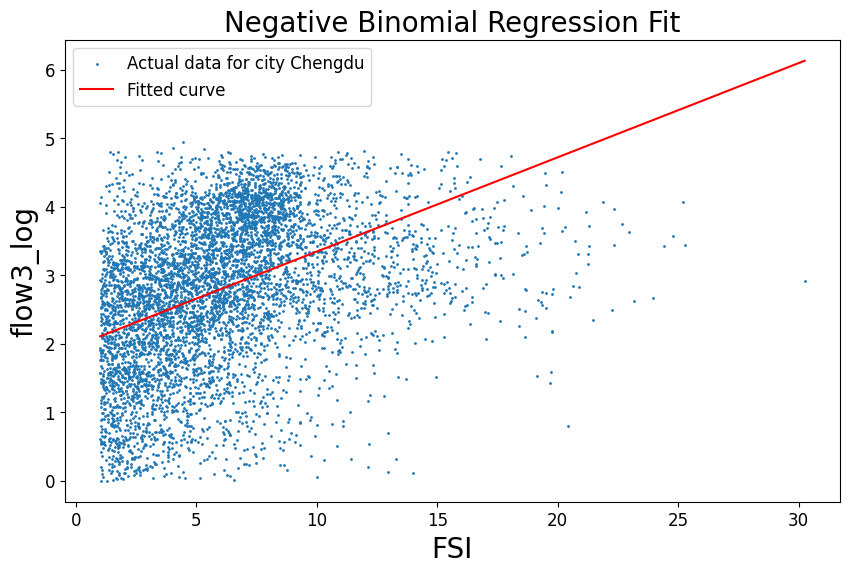

Chongqing
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:55   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013 

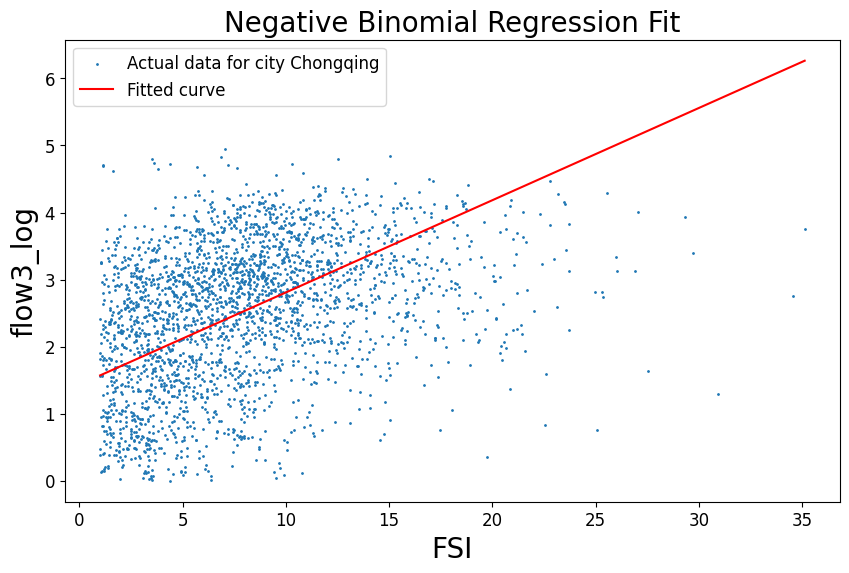

Dalian
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:56   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

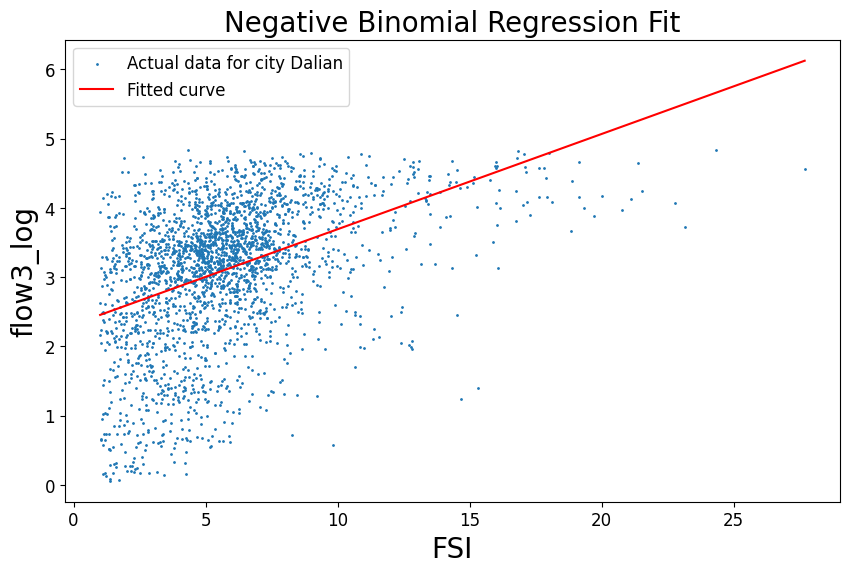

Dongguan
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:56   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

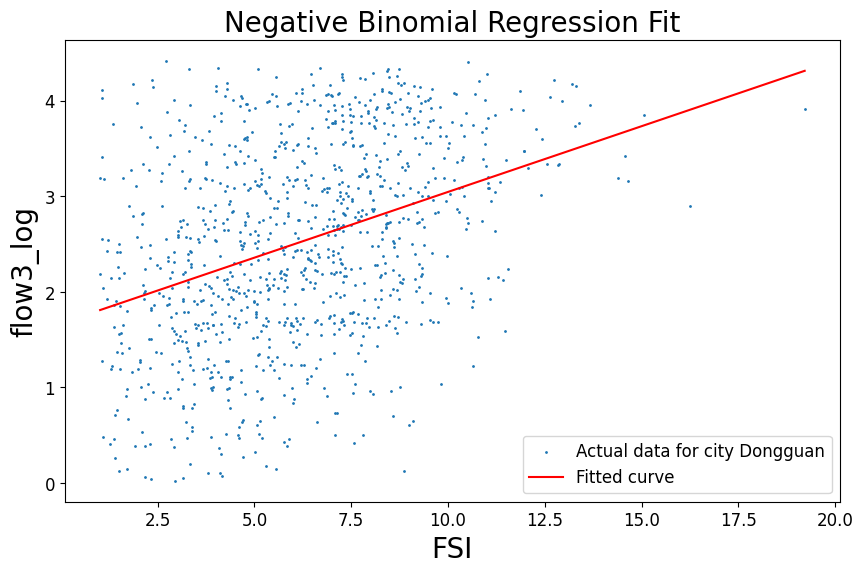

Foshan
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:57   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

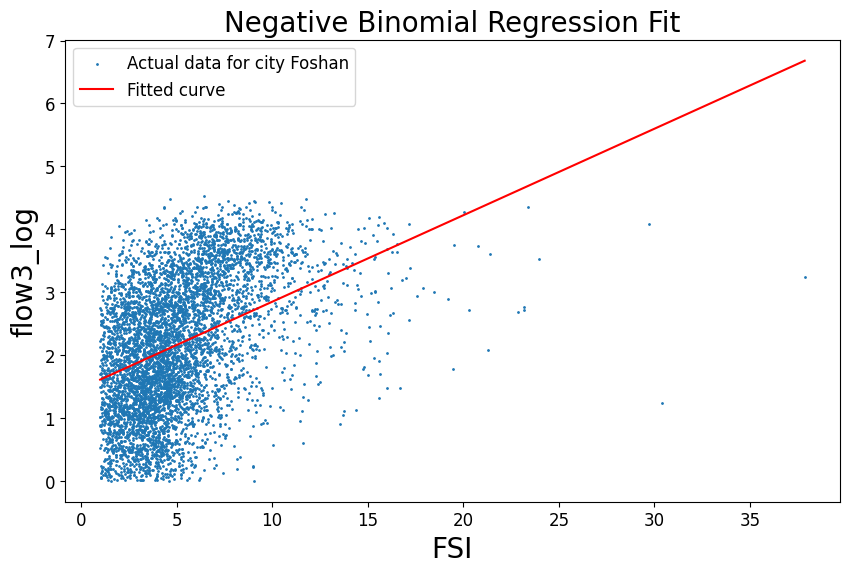

Fuzhou
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:57   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

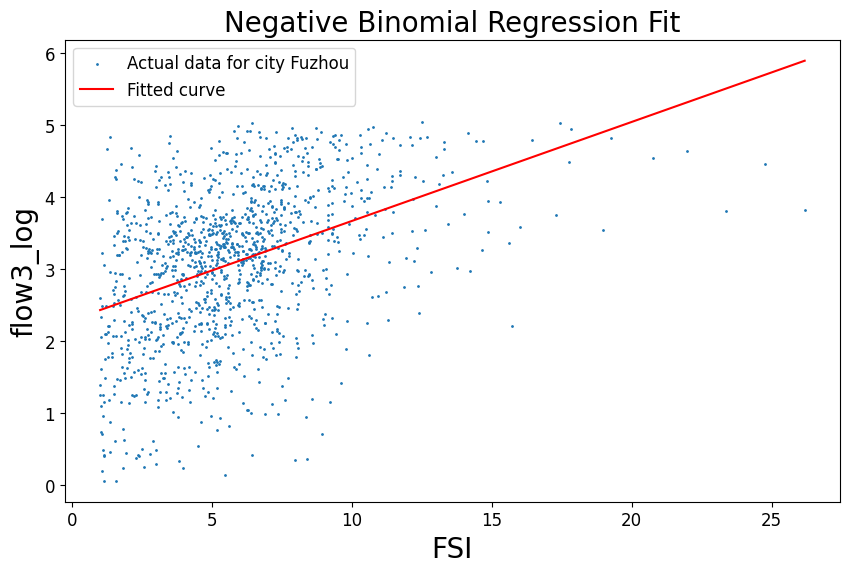

Guangzhou
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:58   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013 

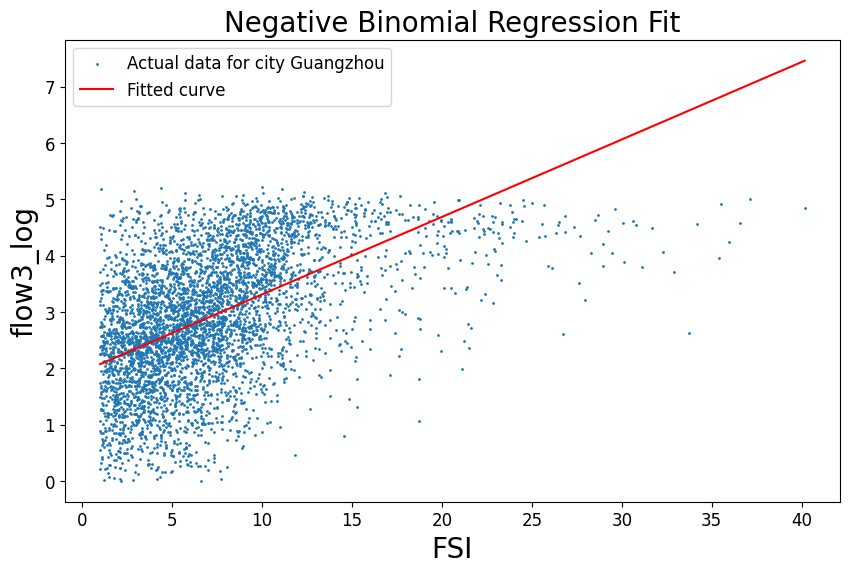

Guiyang
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:58   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

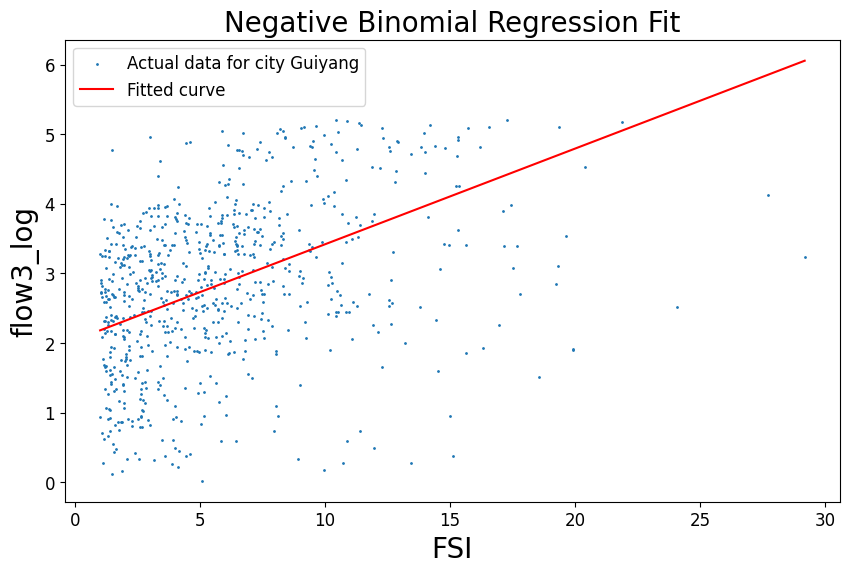

Hangzhou
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:59   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

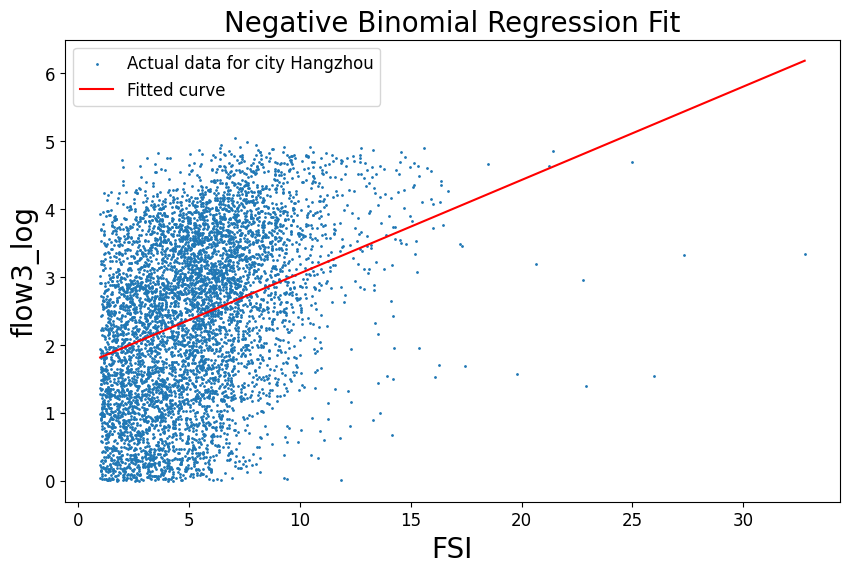

Harbin
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:28:59   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

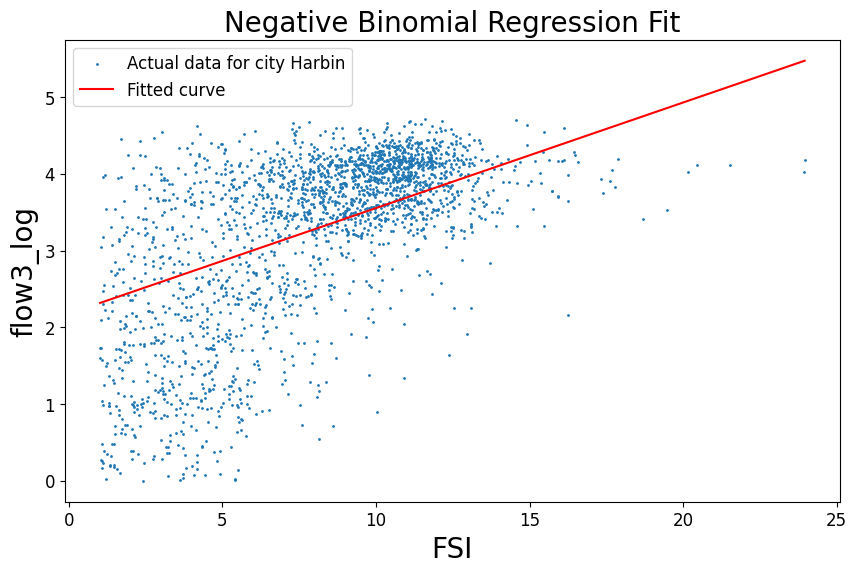

Hefei
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:00   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    1

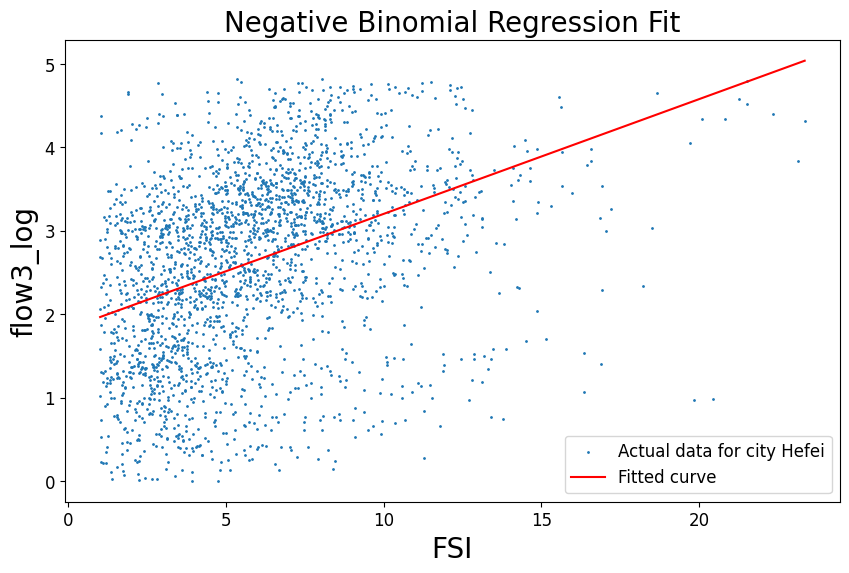

Huizhou
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:00   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

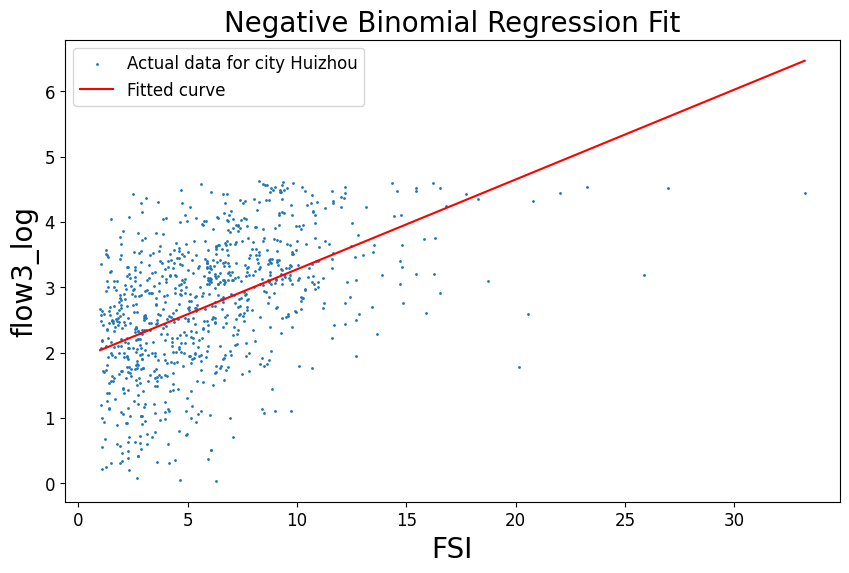

Kunming
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:01   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

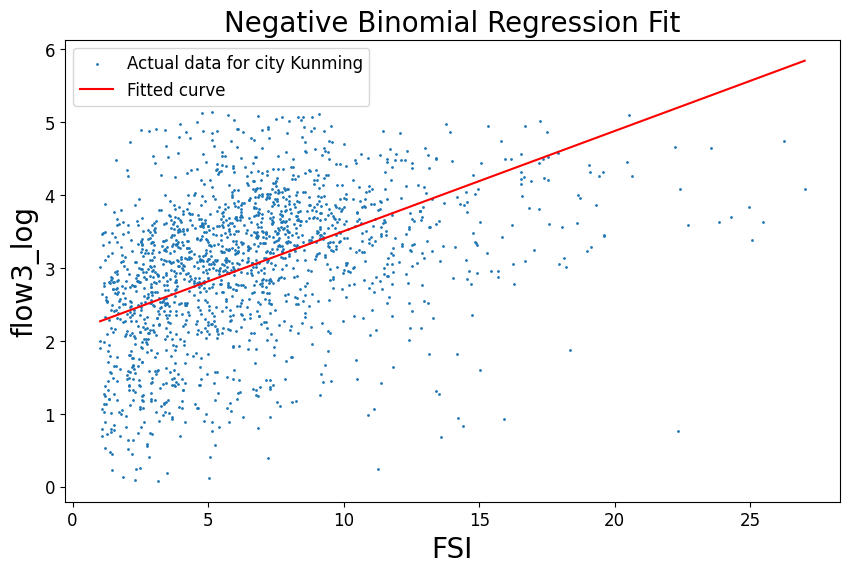

Langfang
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:01   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

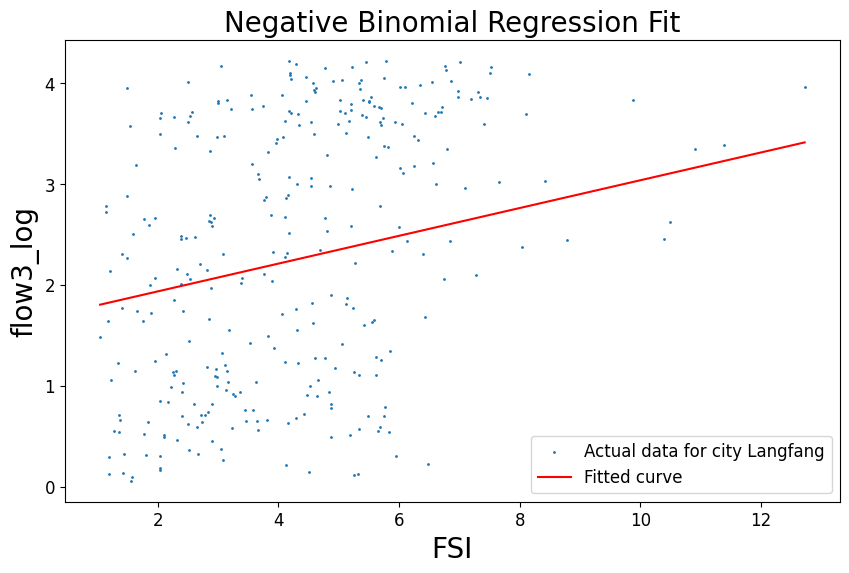

Nanchang
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:02   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

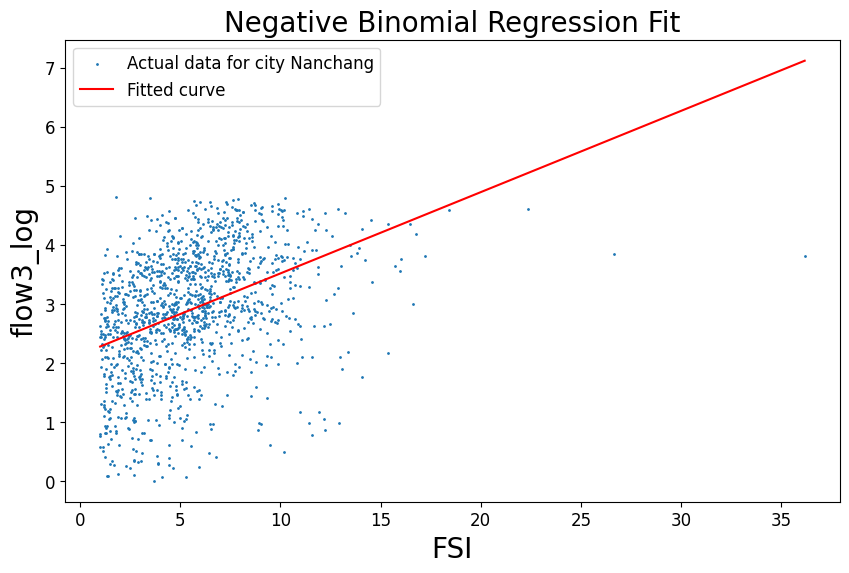

Nanjing
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:02   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

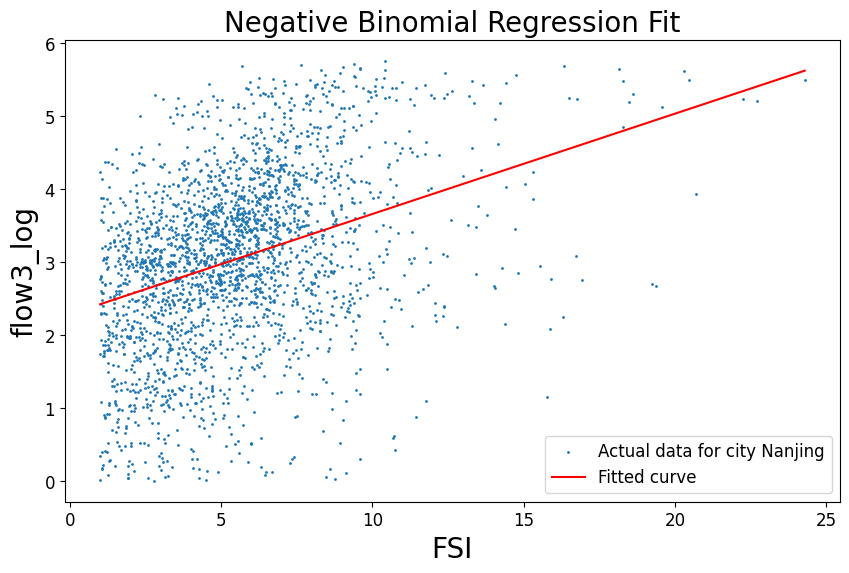

Ningbo
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:03   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

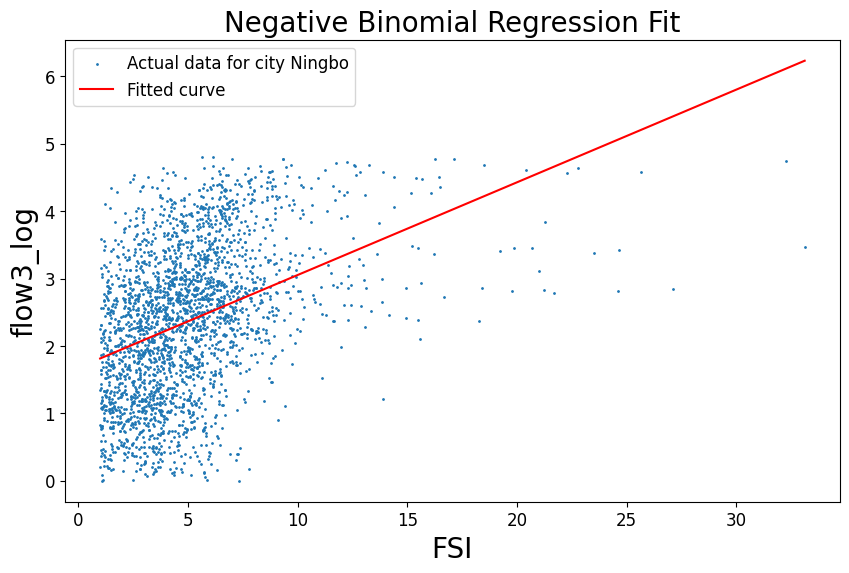

Qingdao
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:03   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

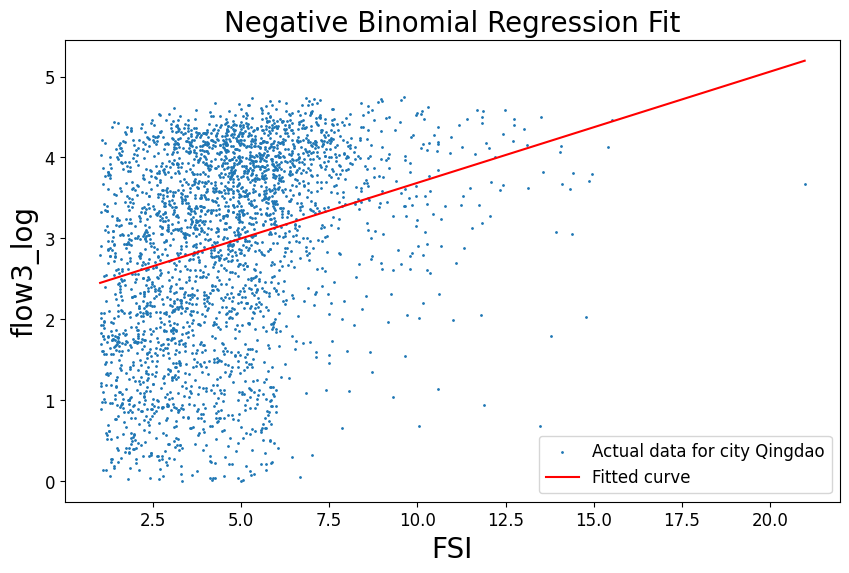

Sanya
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:04   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    1

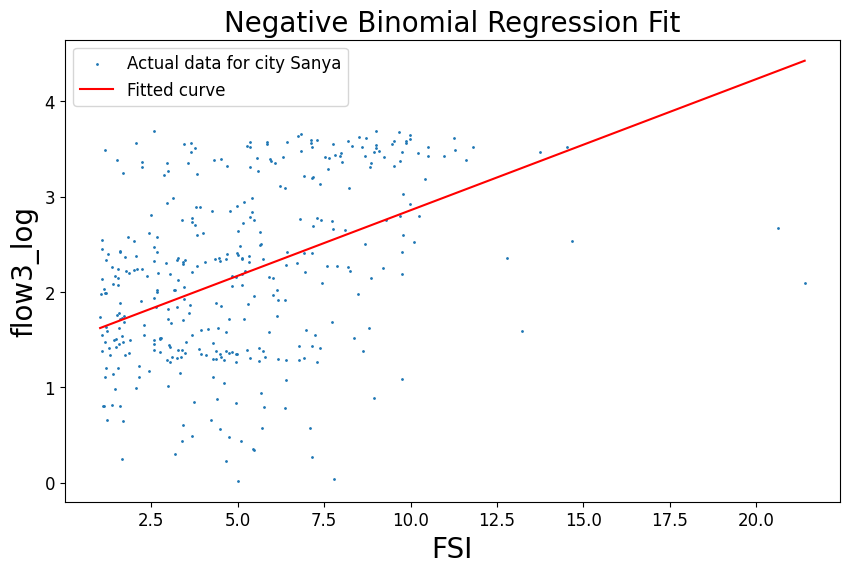

Shanghai
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:04   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

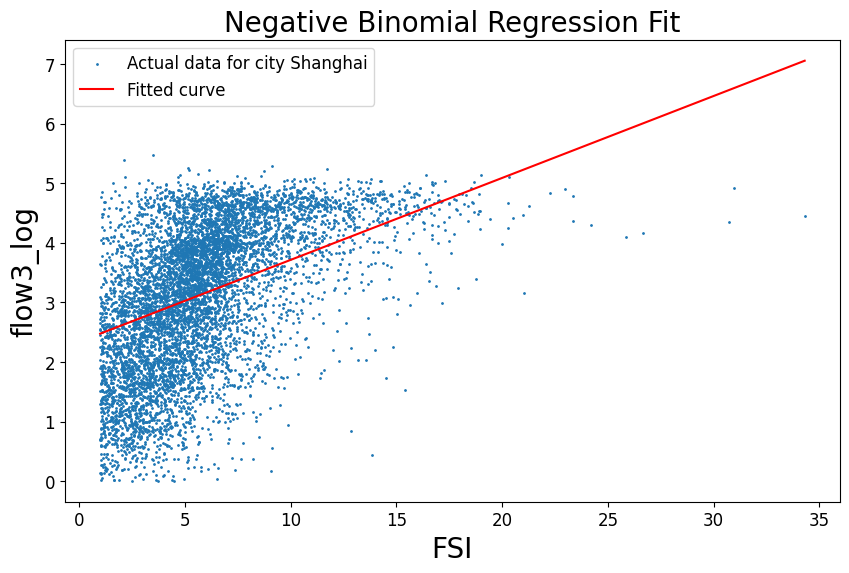

Shaoxing
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:05   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

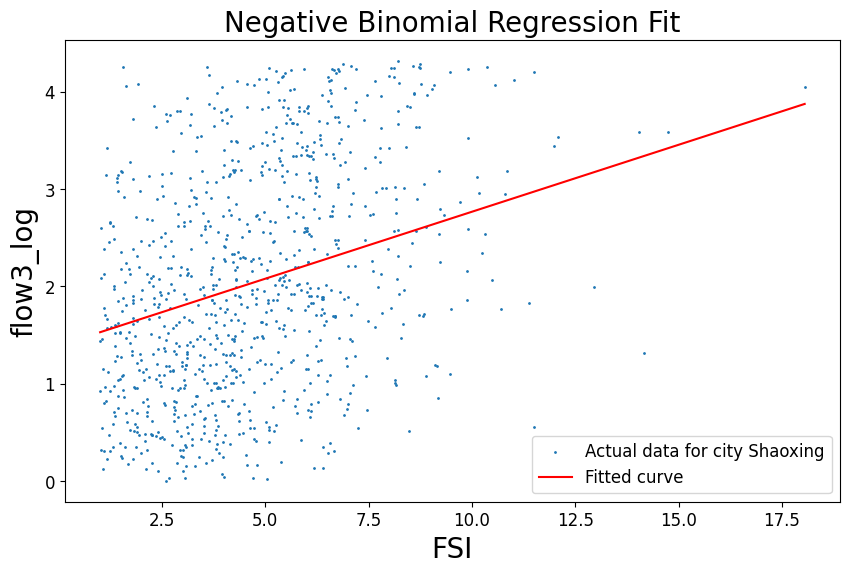

Shenyang
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:05   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

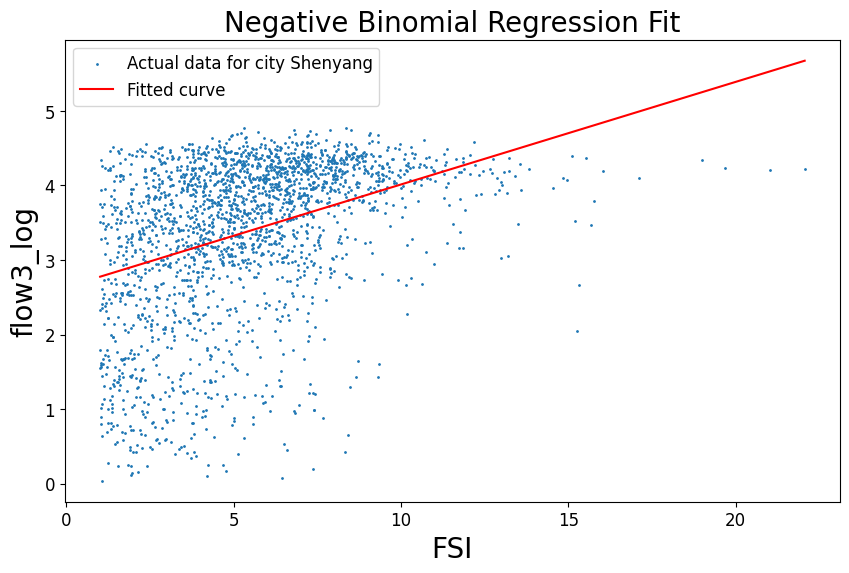

Shenzhen
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:06   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

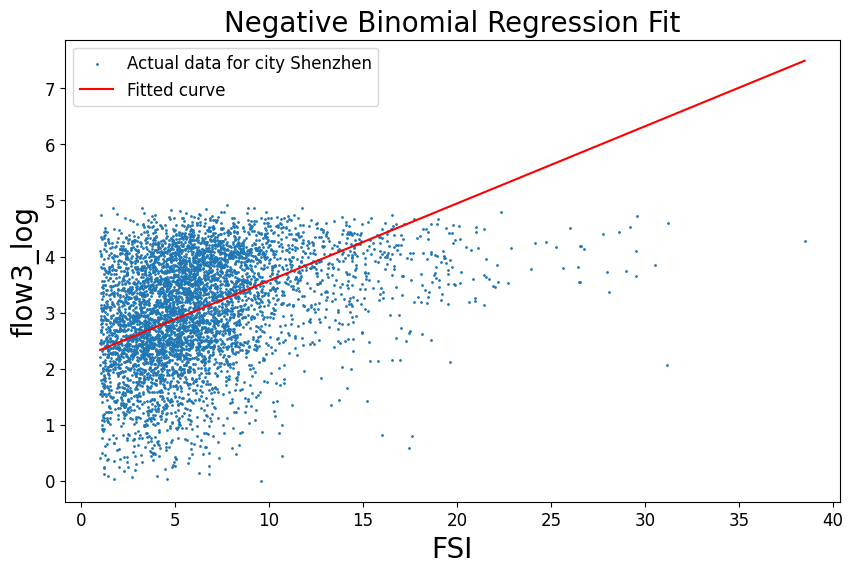

Suzhou
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:06   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

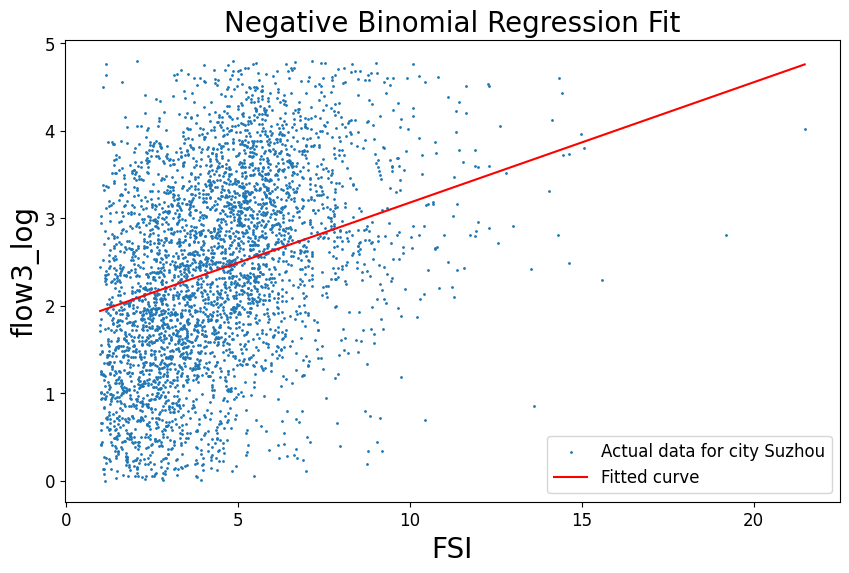

Taiyuan
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:07   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

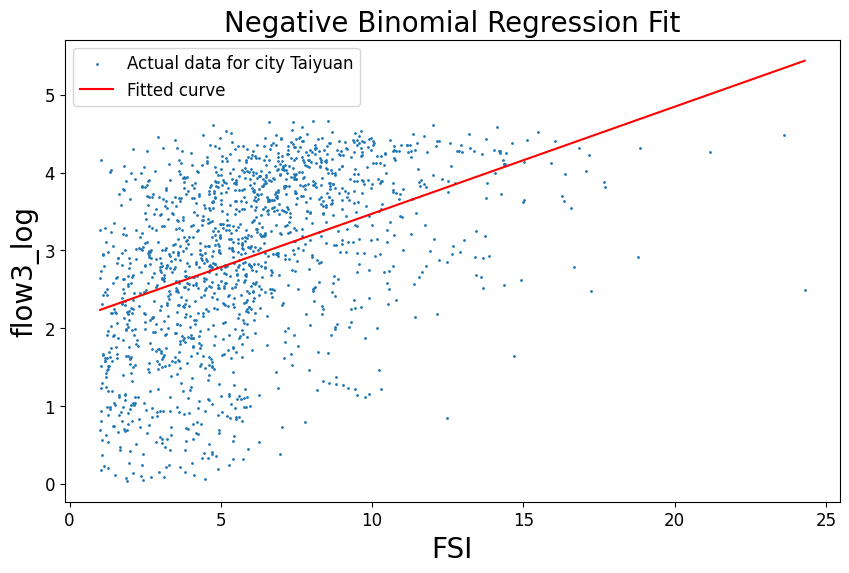

Tianjin
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:07   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013   

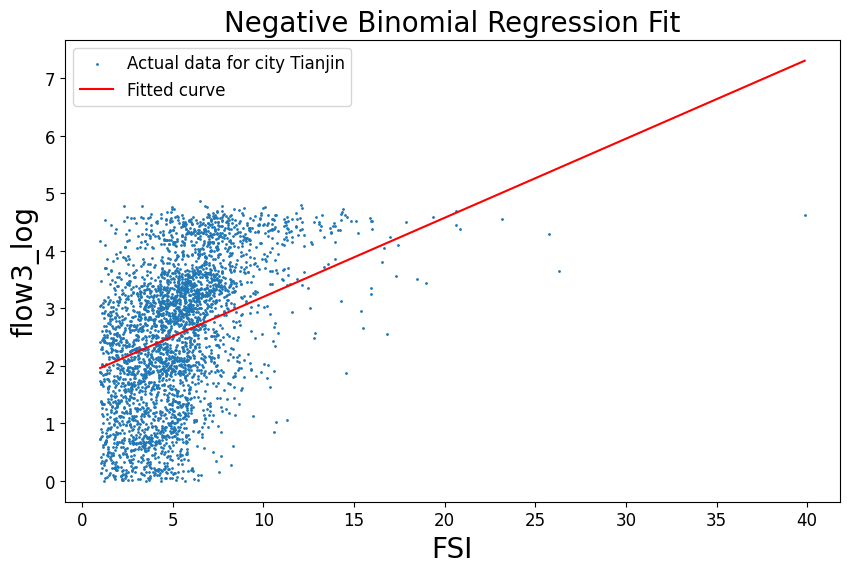

Wuhan
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:08   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    1

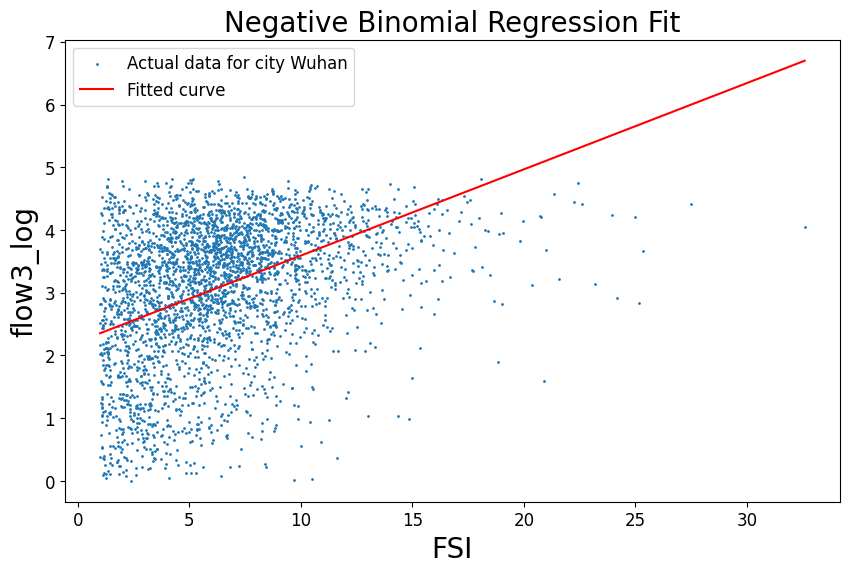

Wuxi
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:08   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    15

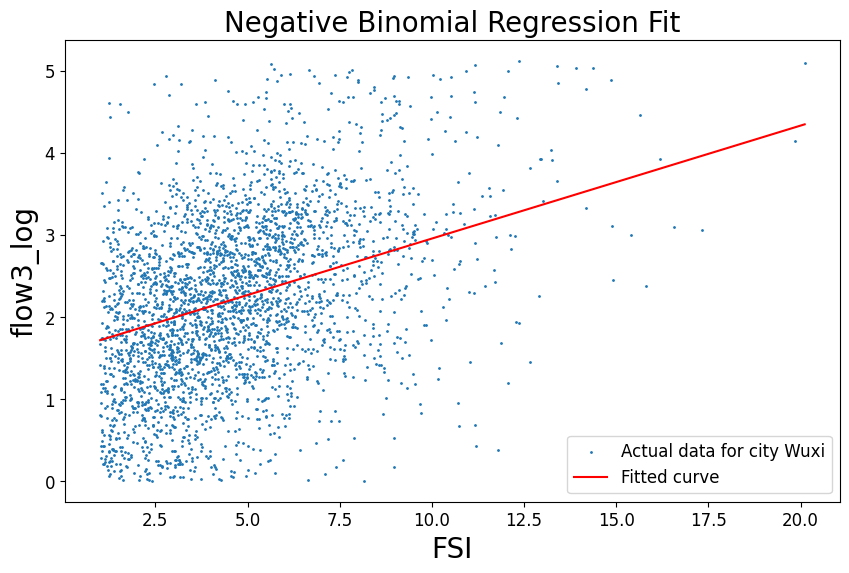

Xi_an
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:08   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    1

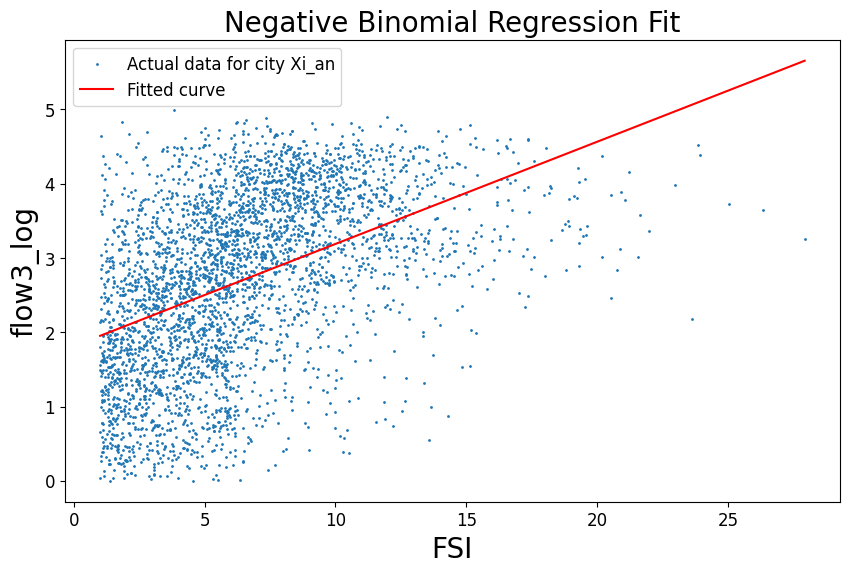

Xiamen
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:09   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

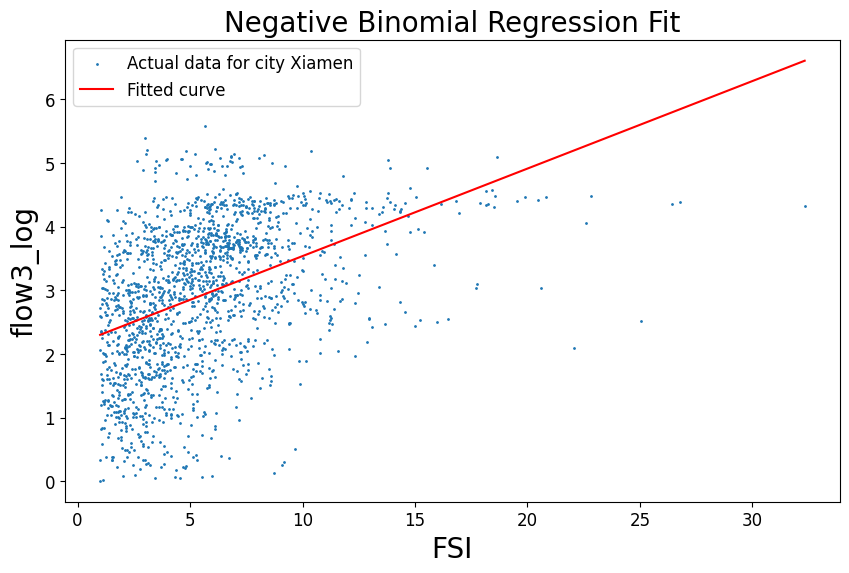

Xuzhou
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:09   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

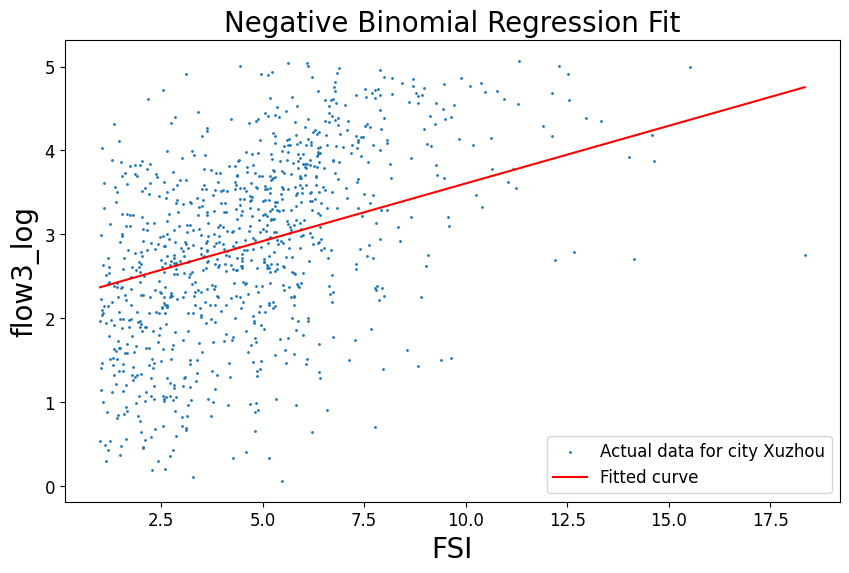

Yangzhou
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:10   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013  

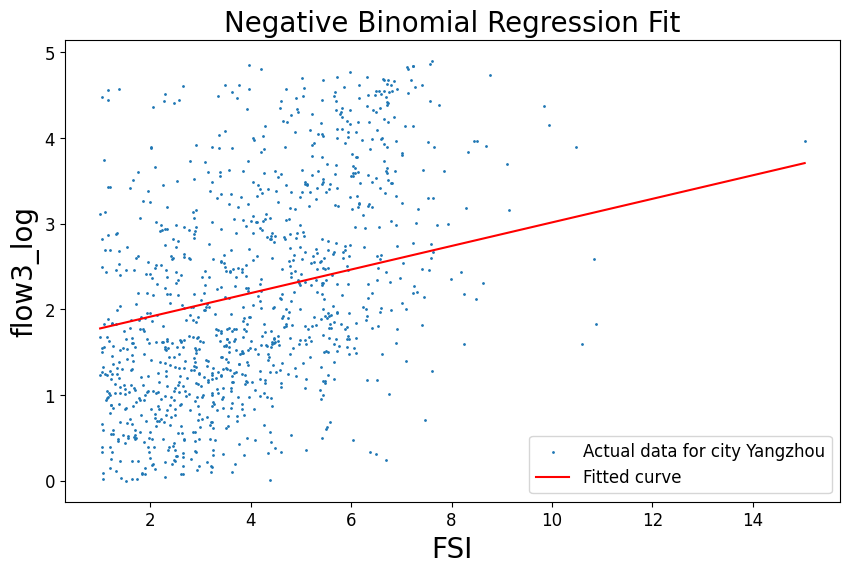

Zhengzhou
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:10   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013 

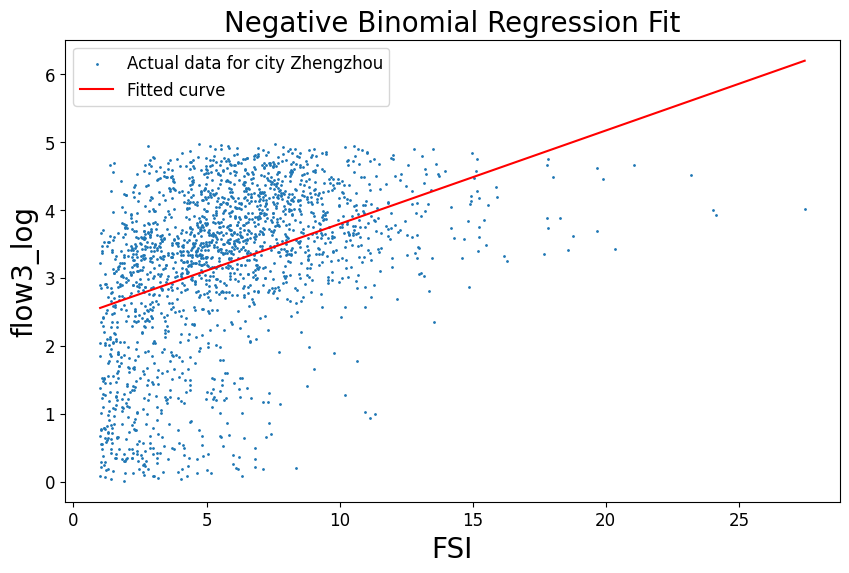

Zhenjiang
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:11   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013 

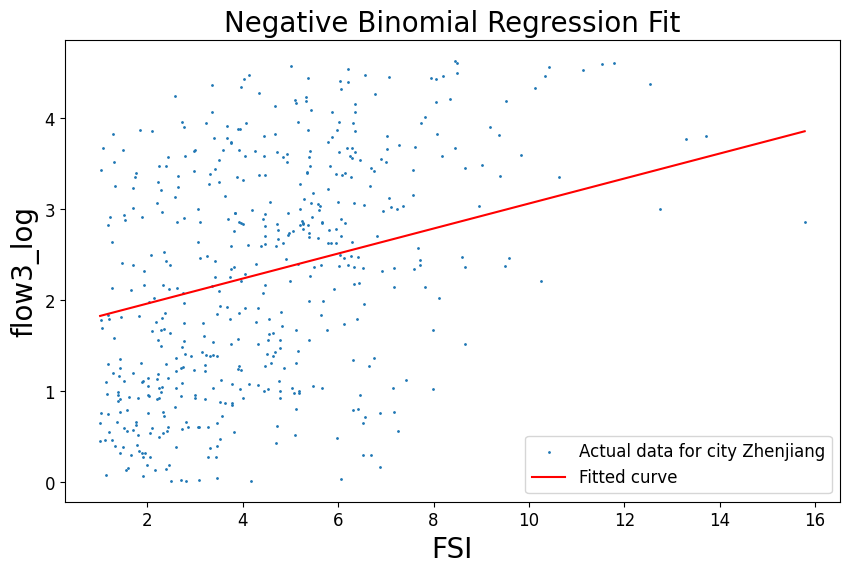

Zhongshan
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:11   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013 

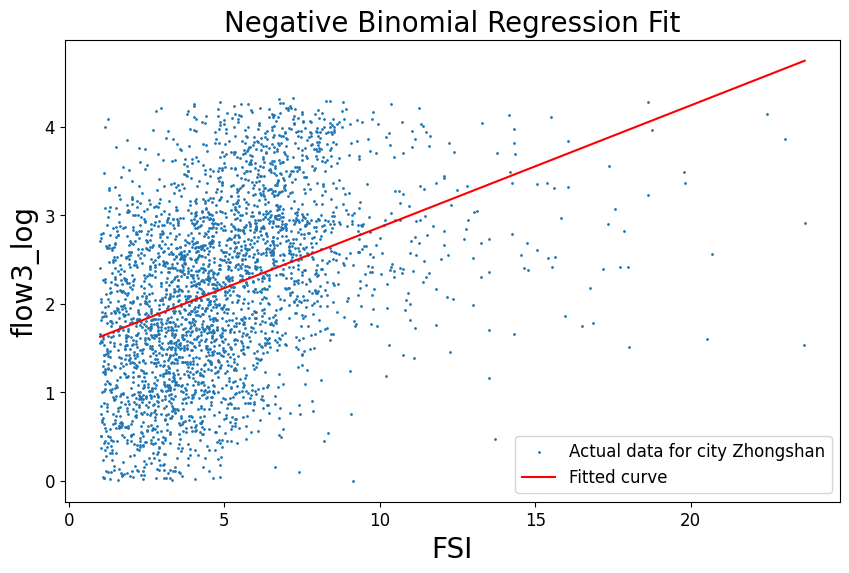

Zhuhai
                            OLS Regression Results                            
Dep. Variable:              flow3_log   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     677.3
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:12   Log-Likelihood:            -1.2011e+05
No. Observations:               83140   AIC:                         2.403e+05
Df Residuals:                   83101   BIC:                         2.407e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             2.0558      0.013    

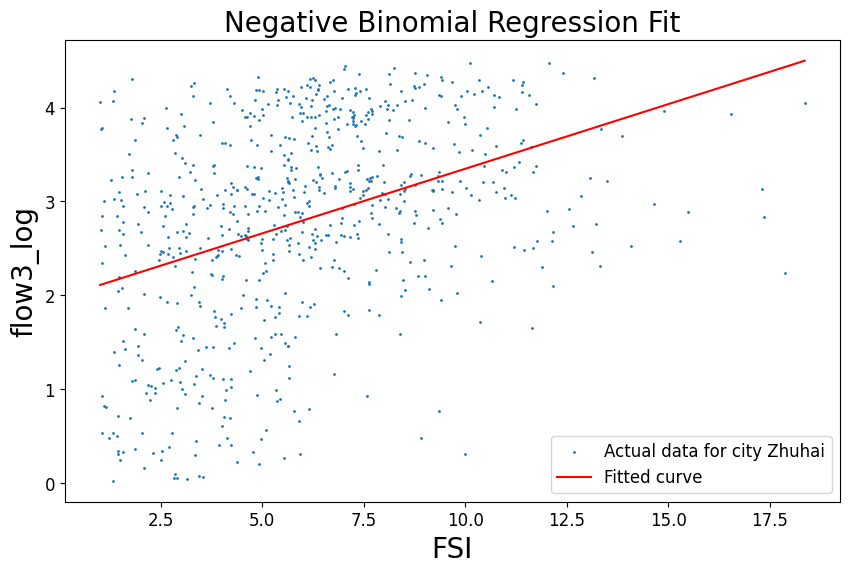

In [1648]:
pred_city_list = []
pred_flow3_df_list = []
mse_flow3_list = []


for i in range(len(city_list)):
    if len(joined_gdf_list[i])>0:
        print(city_list[i])
        result_df = create_Linear_regression_df(df,["FSI"],plot_cat = "flow3_log",area_cap=100000000,min_FSI=1,plot_city = i)
        result_df["city"] = city_list[i]
        if result_df.shape[0]>0:
            pred_city_list.append(city_list[i])
            pred_flow3_df_list.append(result_df)
            mse = mean_squared_error(result_df["flow3_log-og"], result_df["pred"])
            mse_flow3_list.append(mse)

Beijing
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:12   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

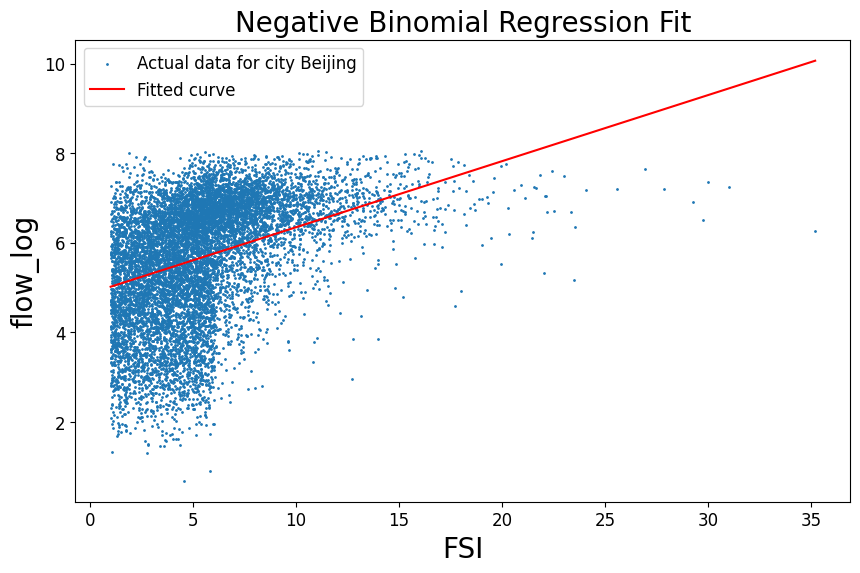

Changsha
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:13   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

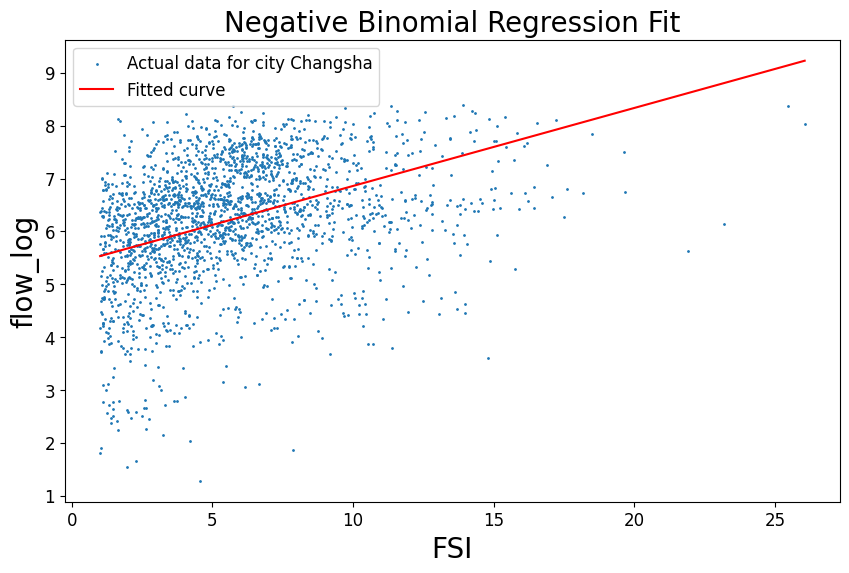

Chengdu
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:13   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

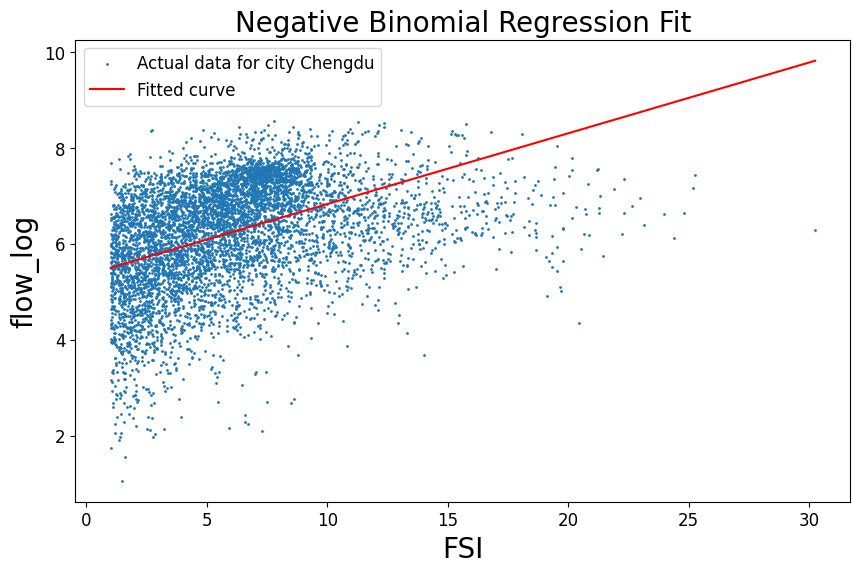

Chongqing
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:14   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013 

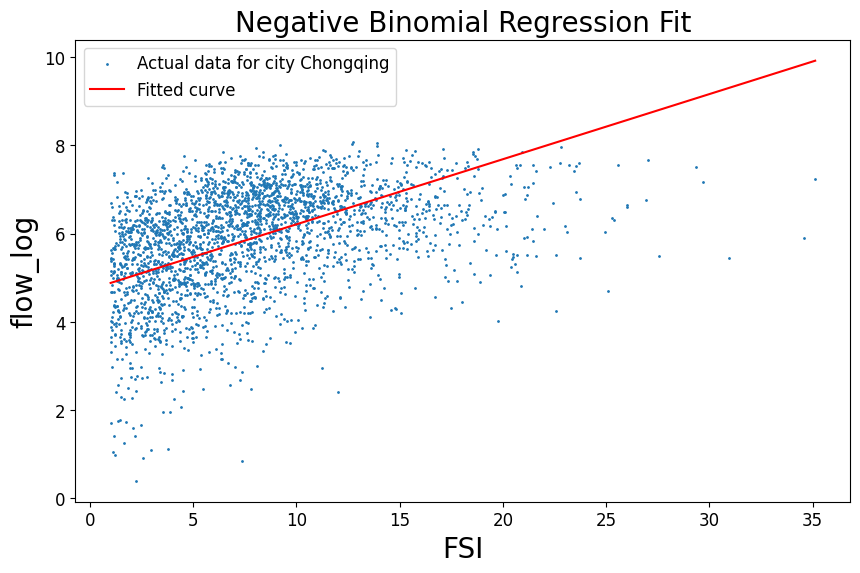

Dalian
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:14   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

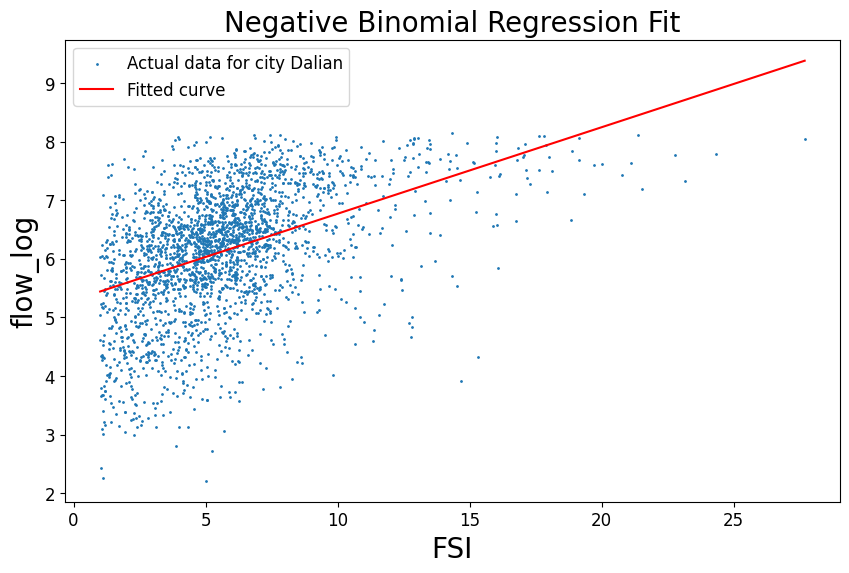

Dongguan
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:15   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

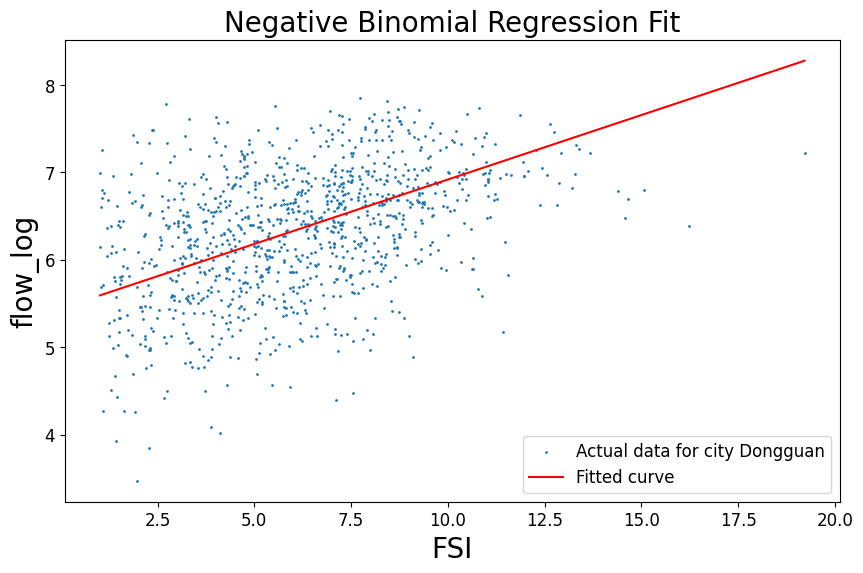

Foshan
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:15   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

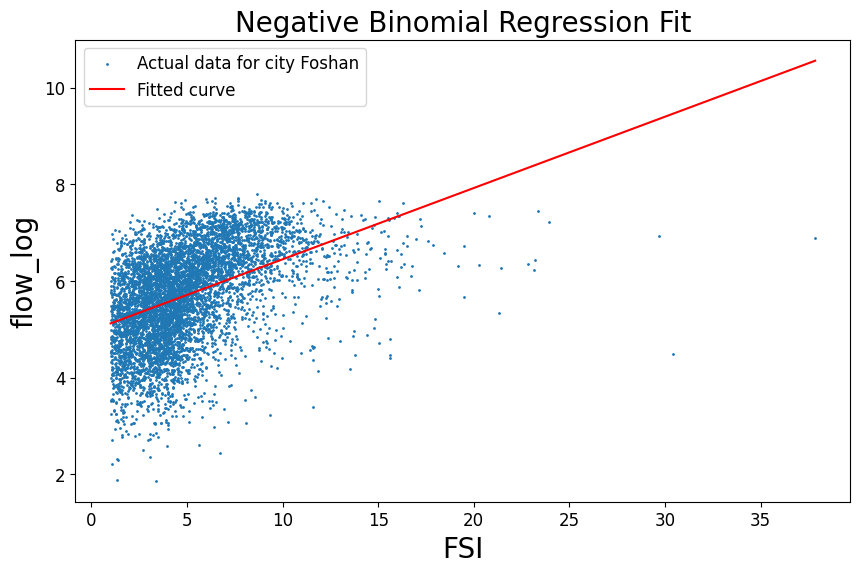

Fuzhou
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:16   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

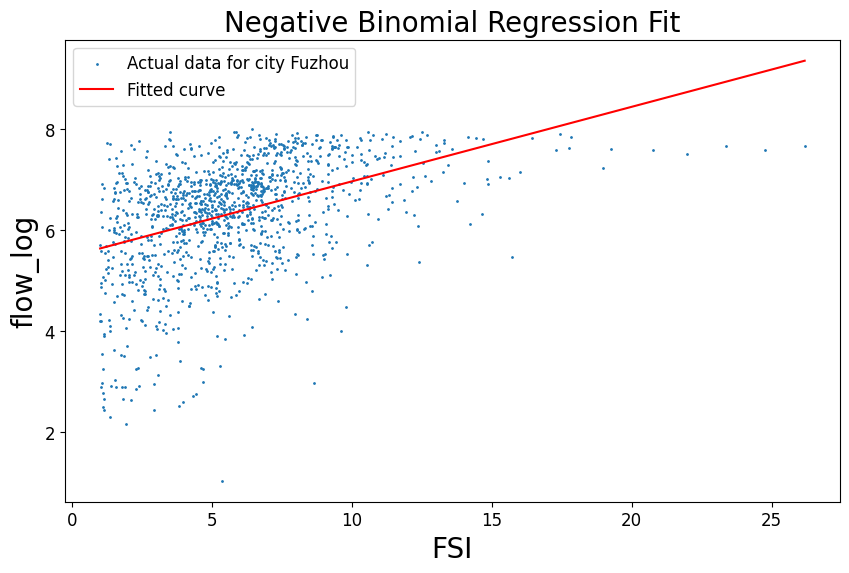

Guangzhou
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:16   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013 

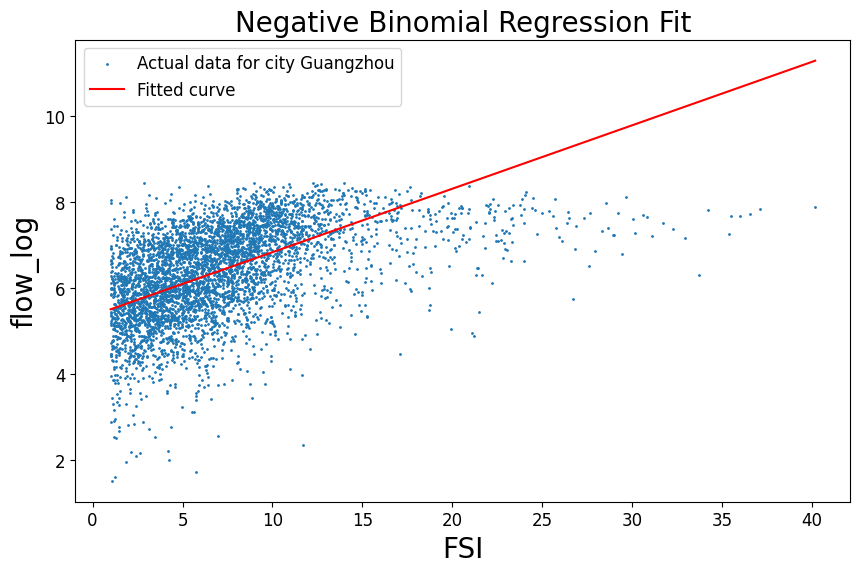

Guiyang
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:17   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

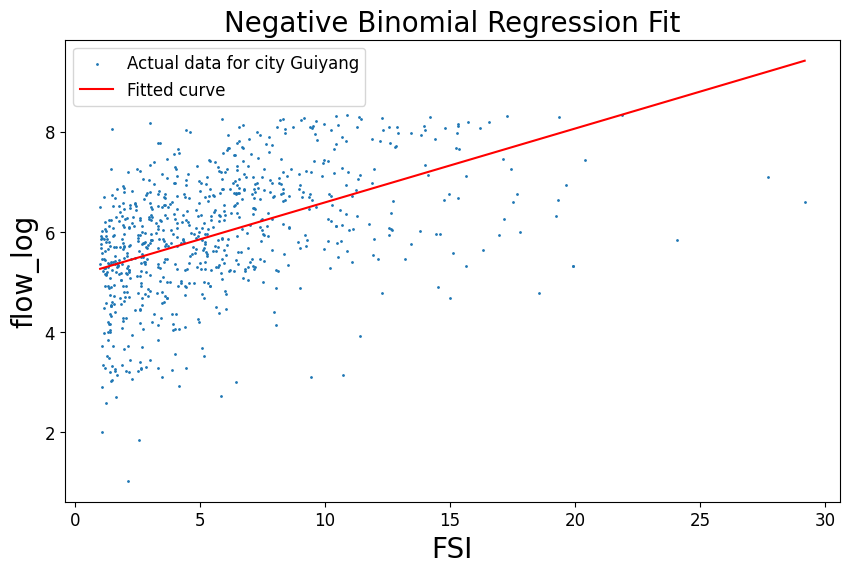

Hangzhou
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:17   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

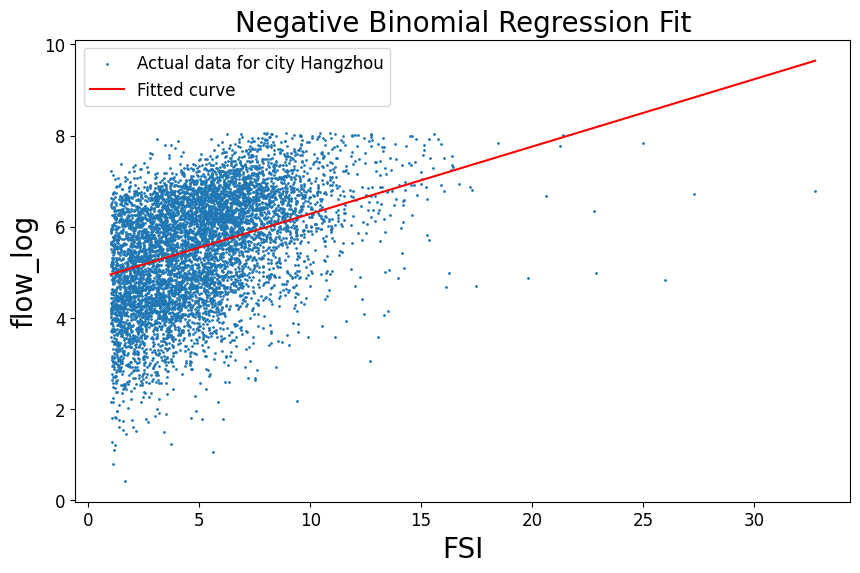

Harbin
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:18   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

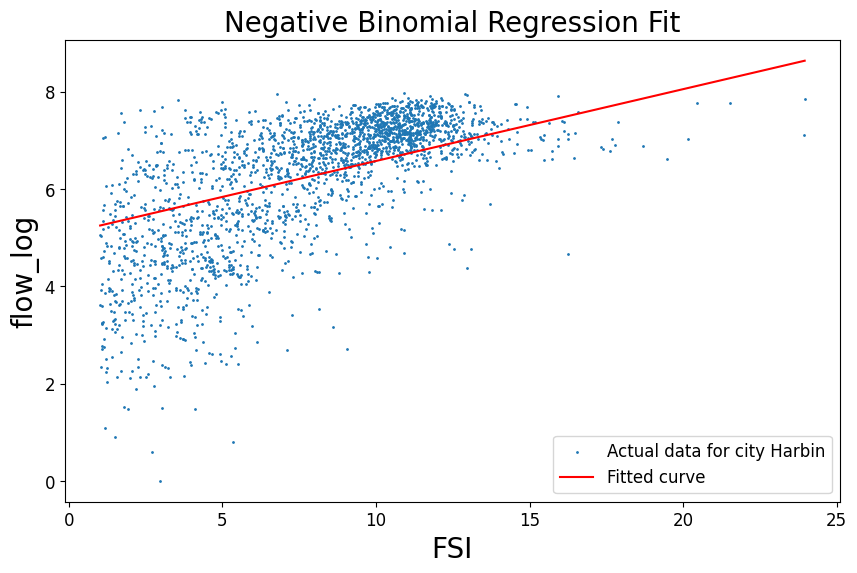

Hefei
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:18   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    3

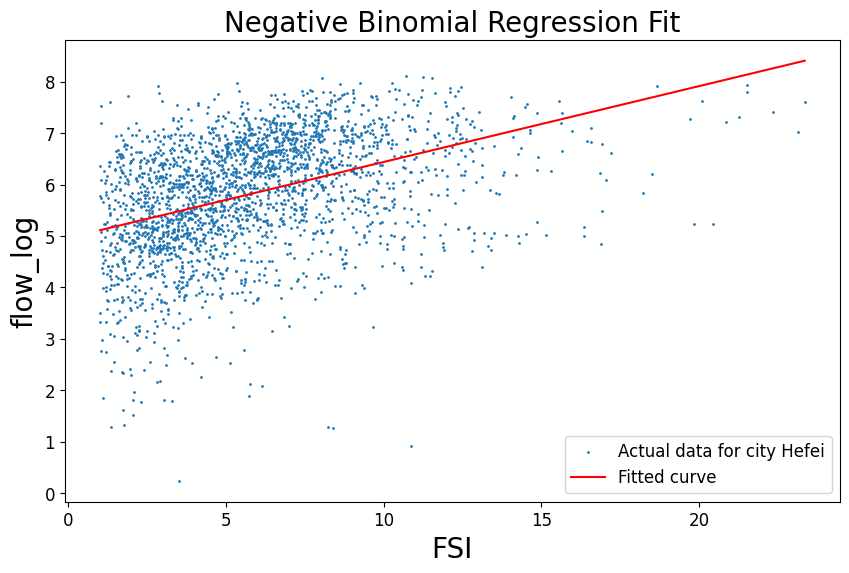

Huizhou
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:19   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

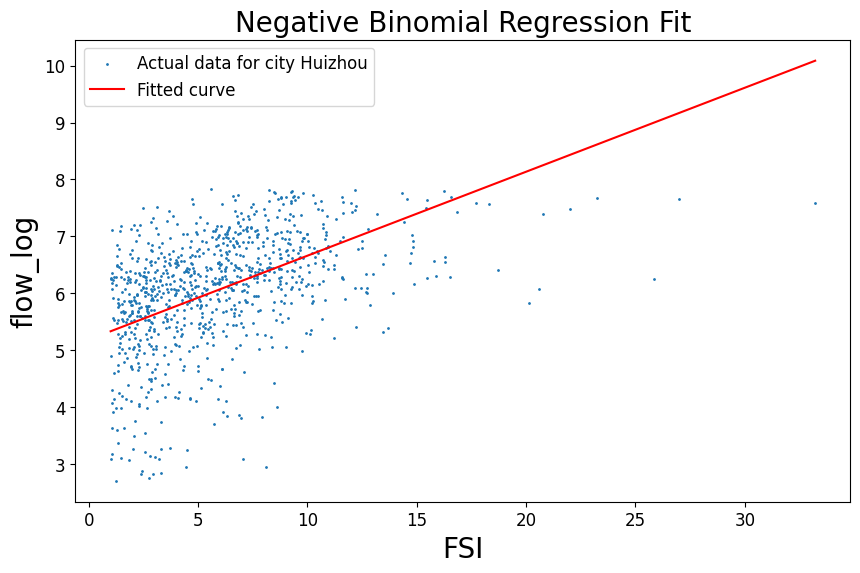

Kunming
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:19   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

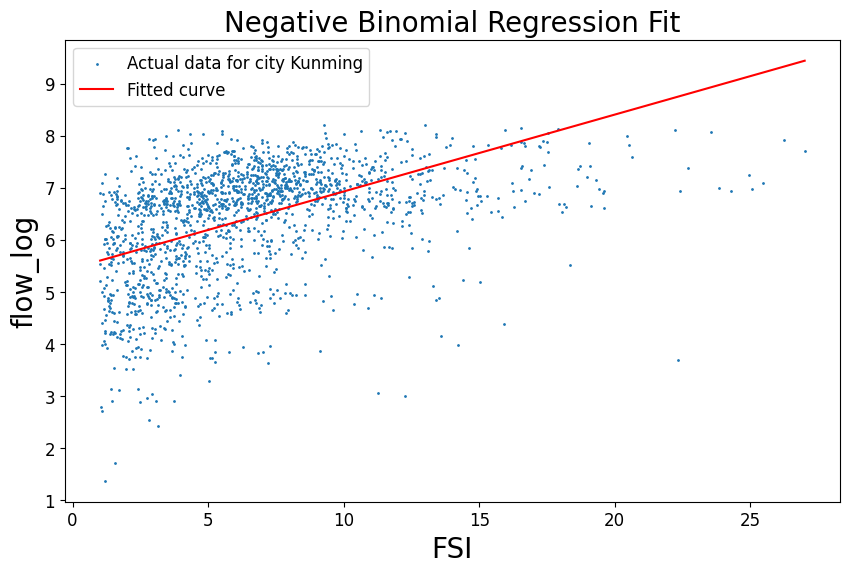

Langfang
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:20   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

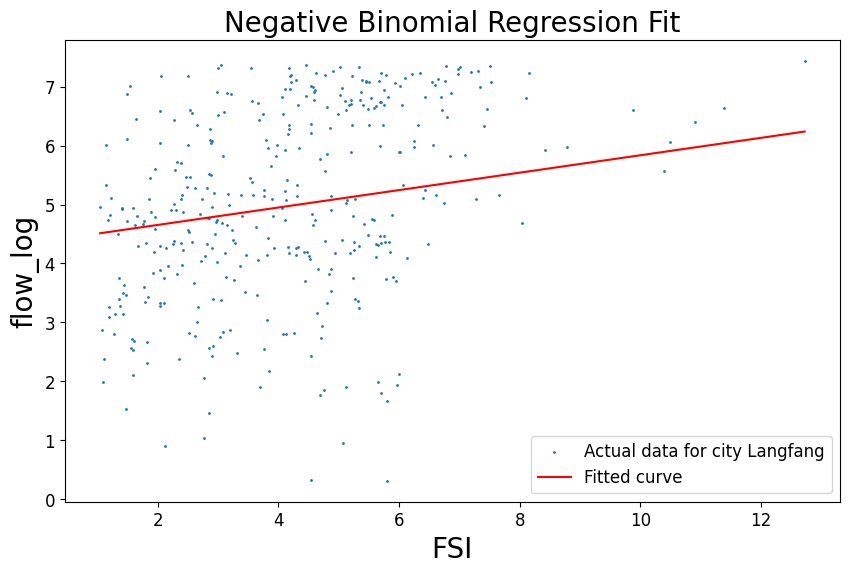

Nanchang
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:20   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

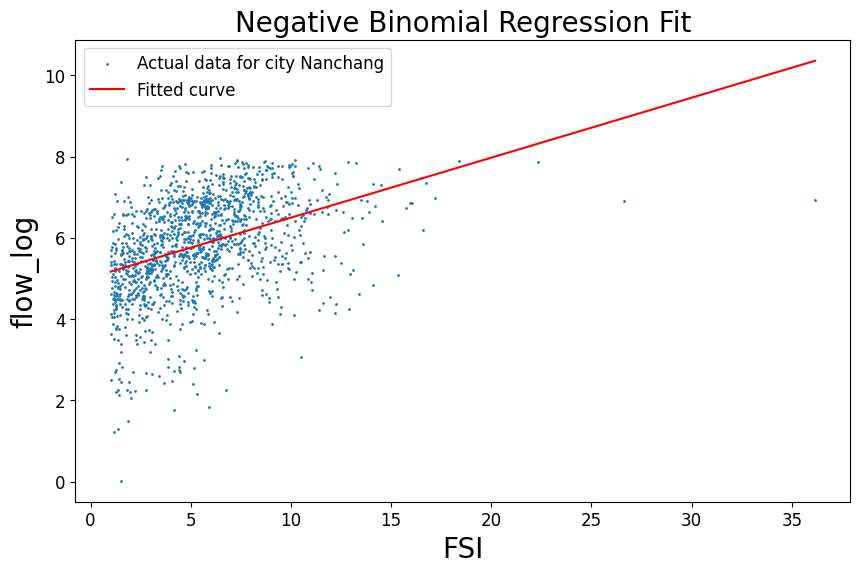

Nanjing
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:21   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

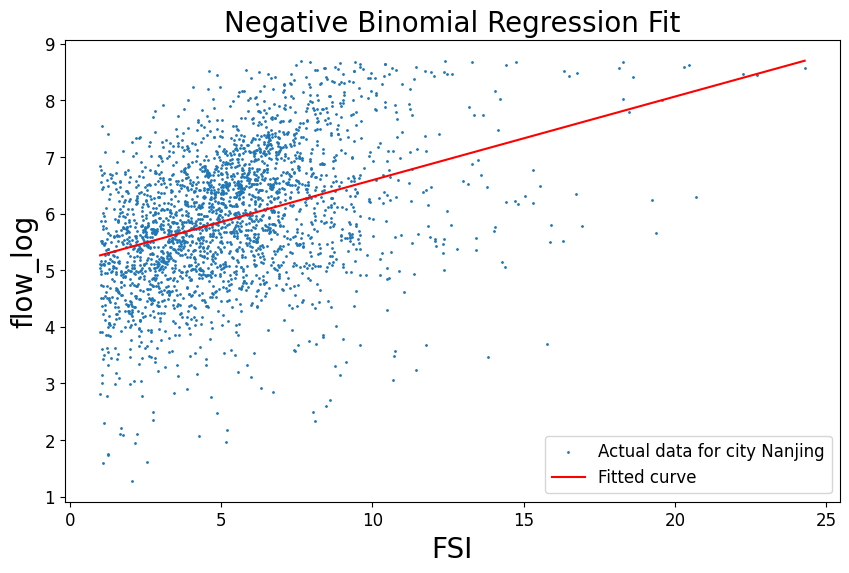

Ningbo
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:21   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

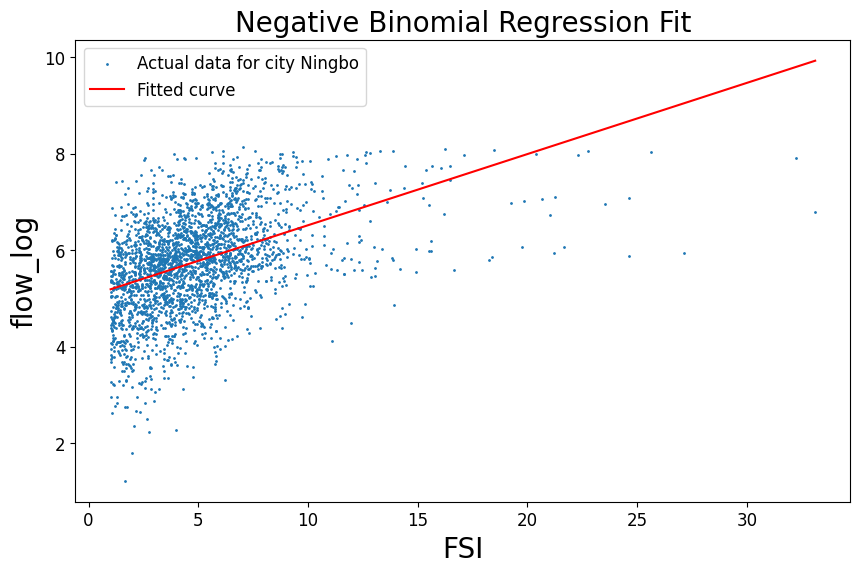

Qingdao
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:22   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

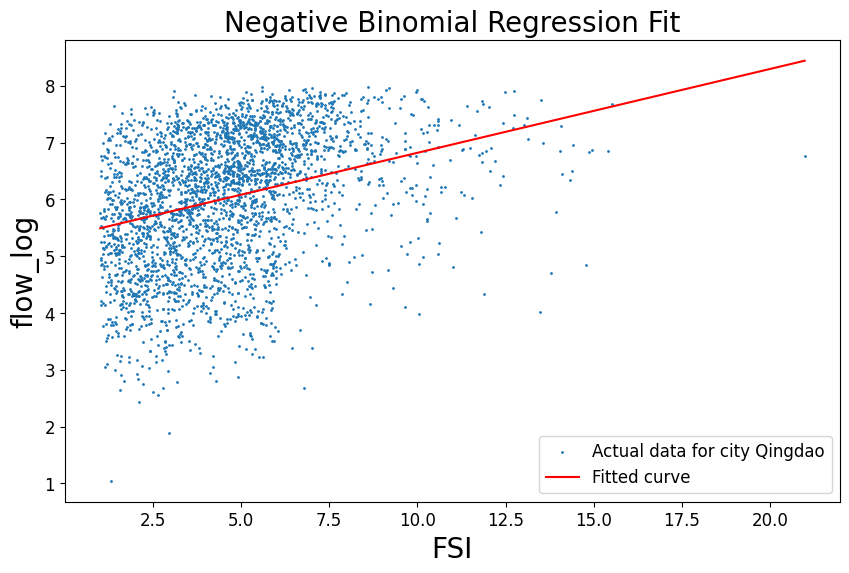

Sanya
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:22   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    3

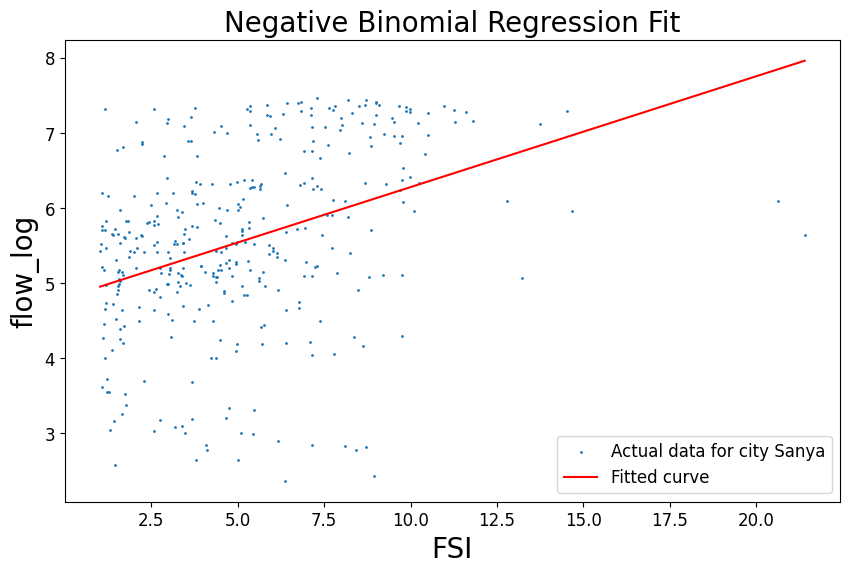

Shanghai
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:23   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

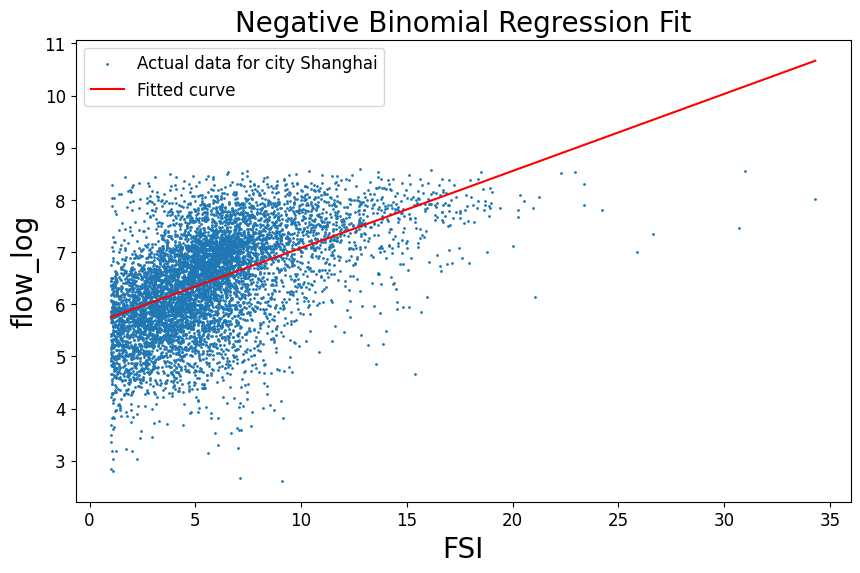

Shaoxing
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:23   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

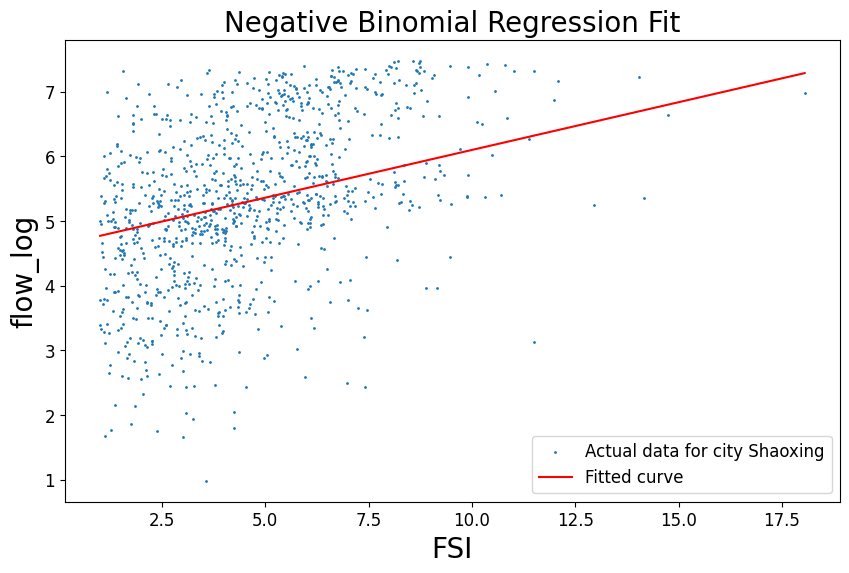

Shenyang
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:24   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

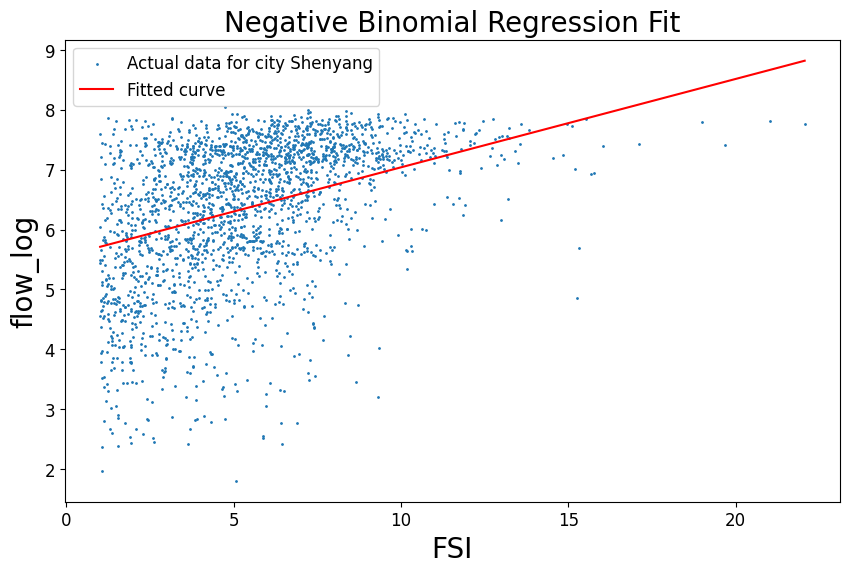

Shenzhen
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:24   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

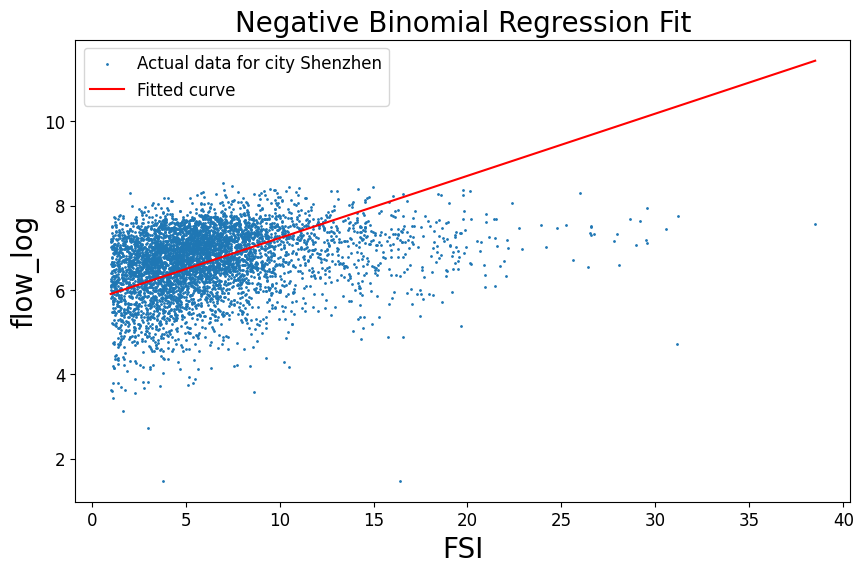

Suzhou
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:25   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

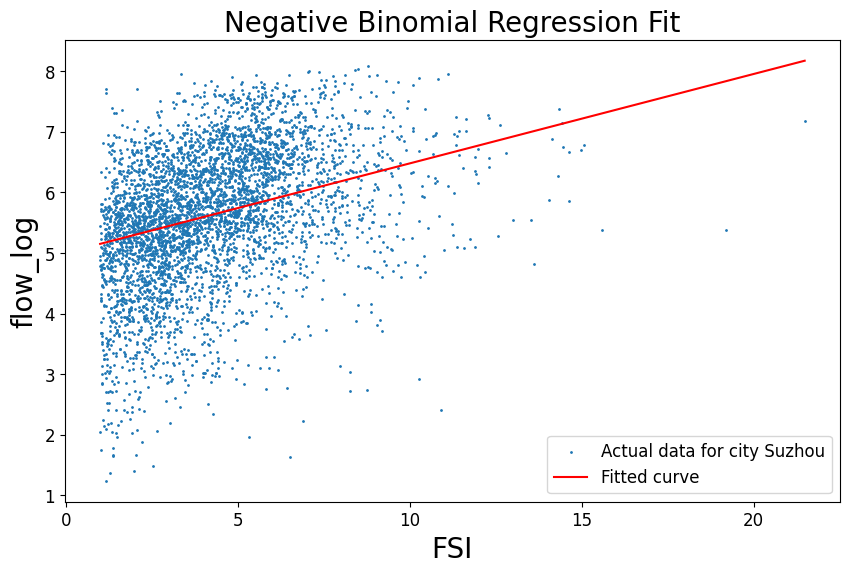

Taiyuan
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:25   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

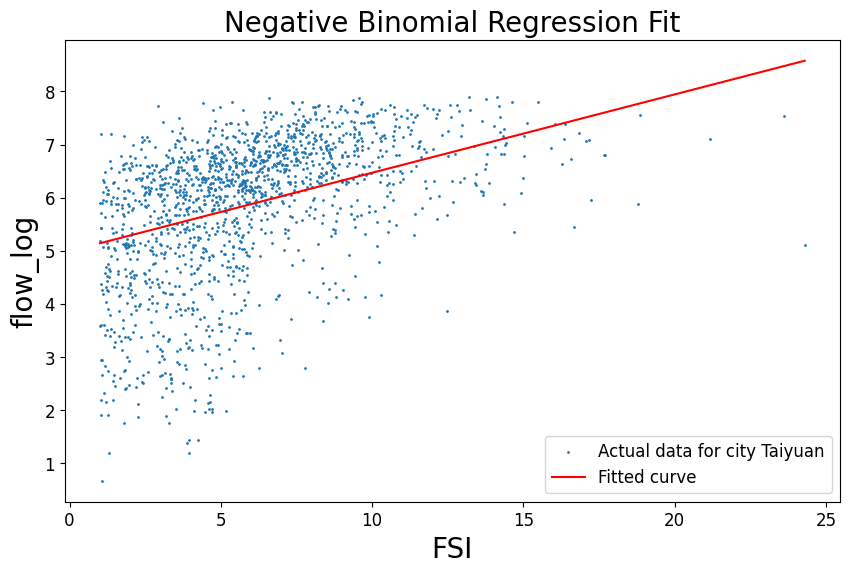

Tianjin
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:26   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013   

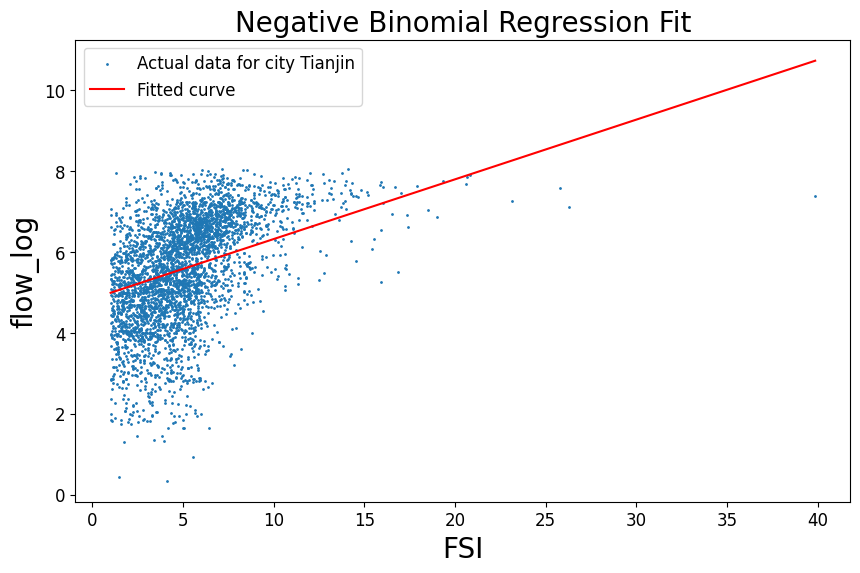

Wuhan
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:26   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    3

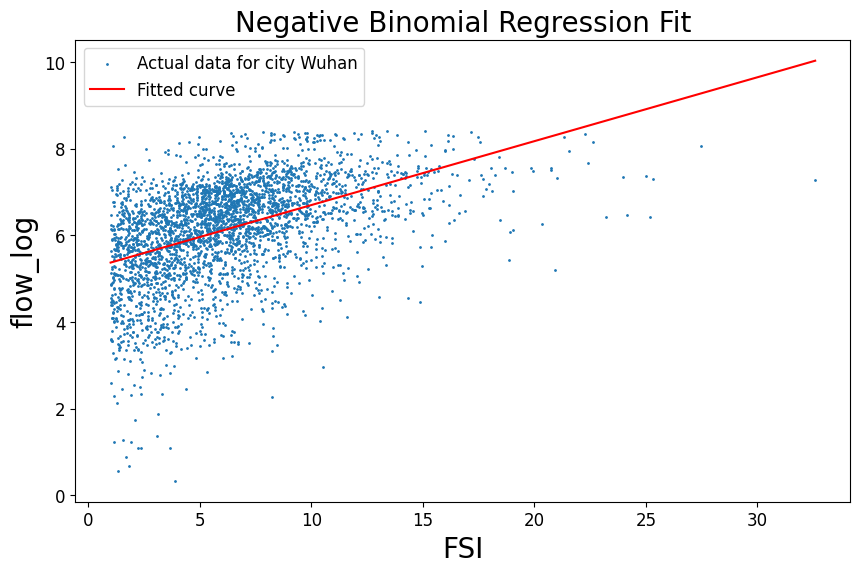

Wuxi
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:27   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    38

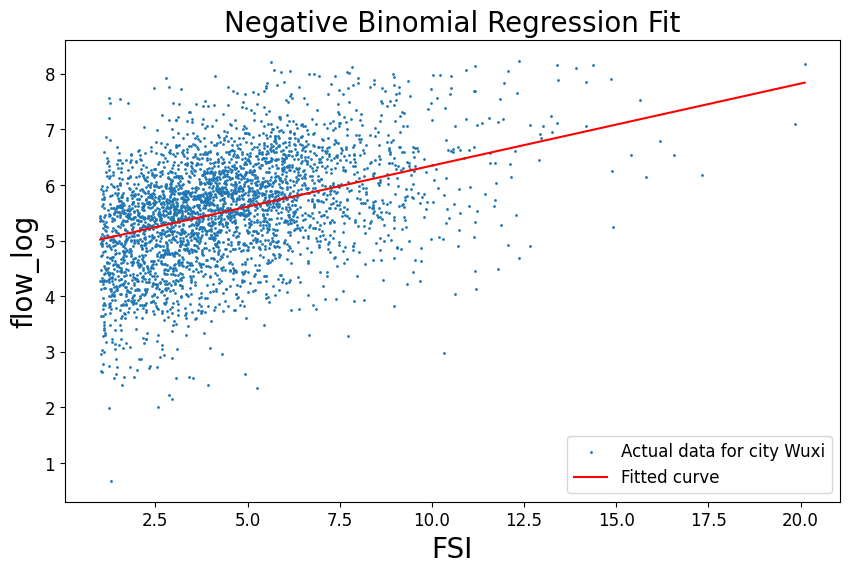

Xi_an
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:27   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    3

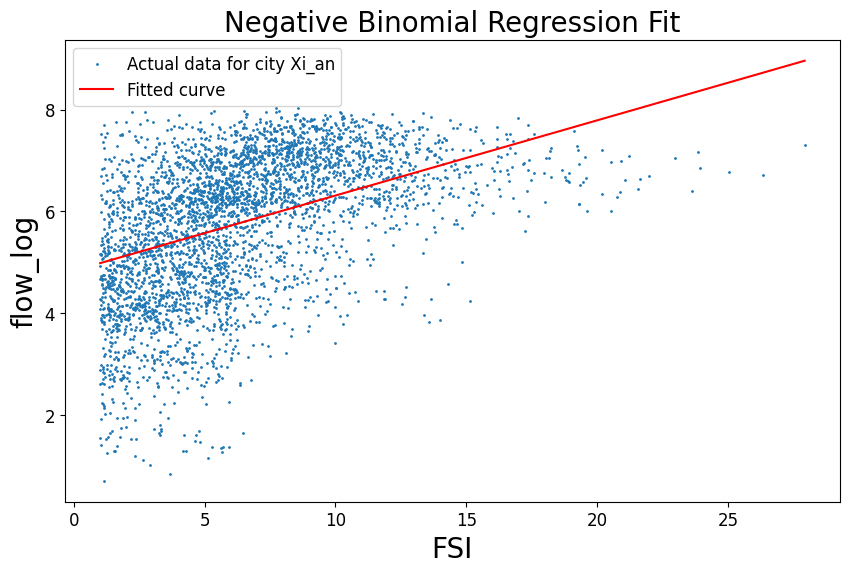

Xiamen
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:27   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

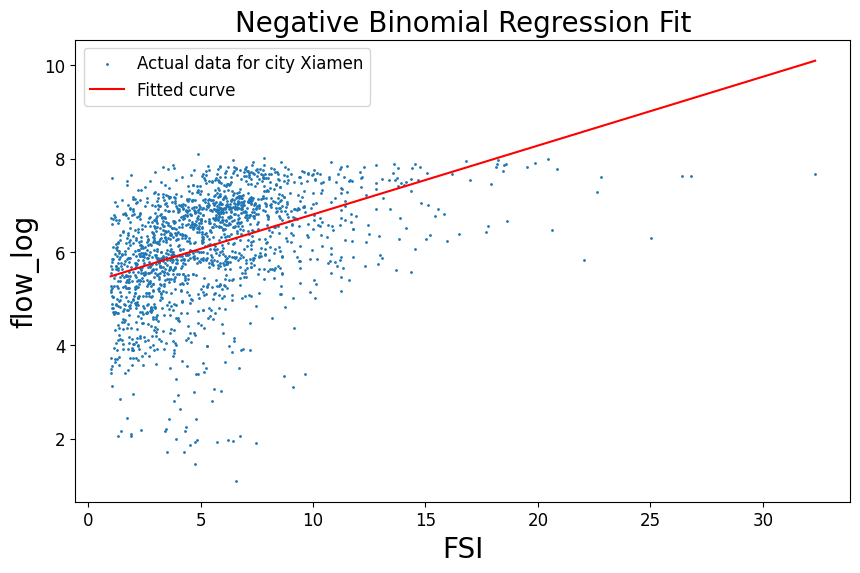

Xuzhou
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:28   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

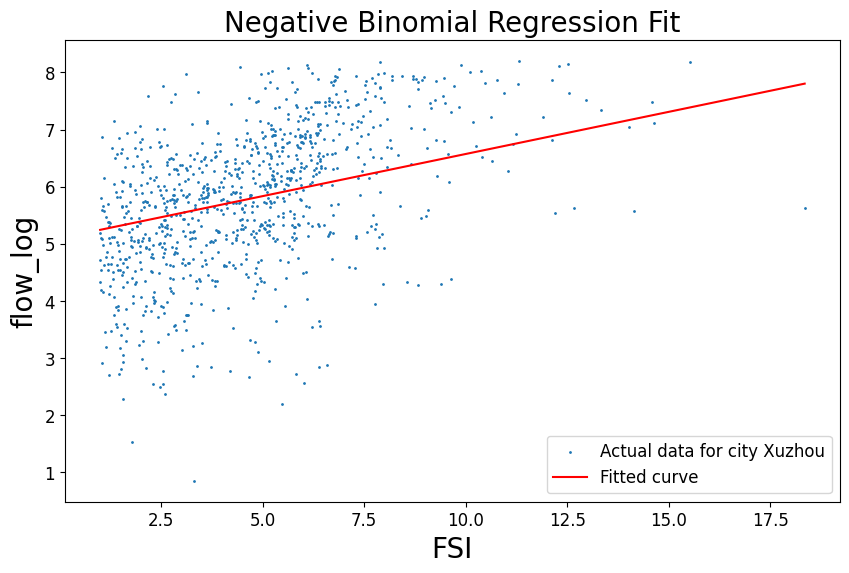

Yangzhou
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:28   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013  

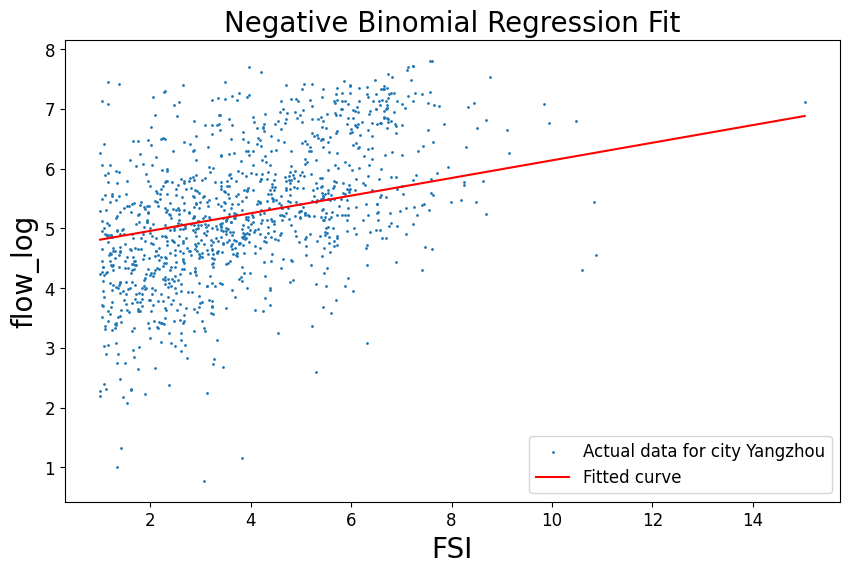

Zhengzhou
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:29   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013 

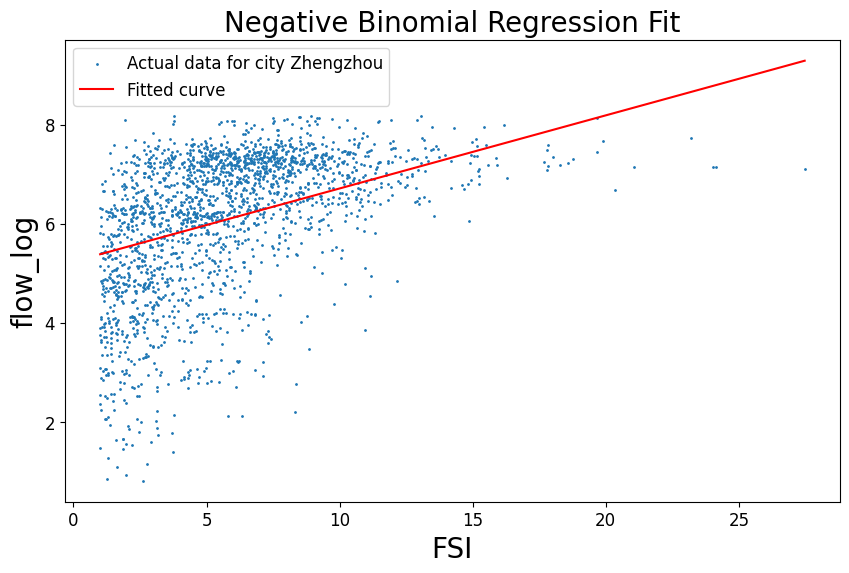

Zhenjiang
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:29   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013 

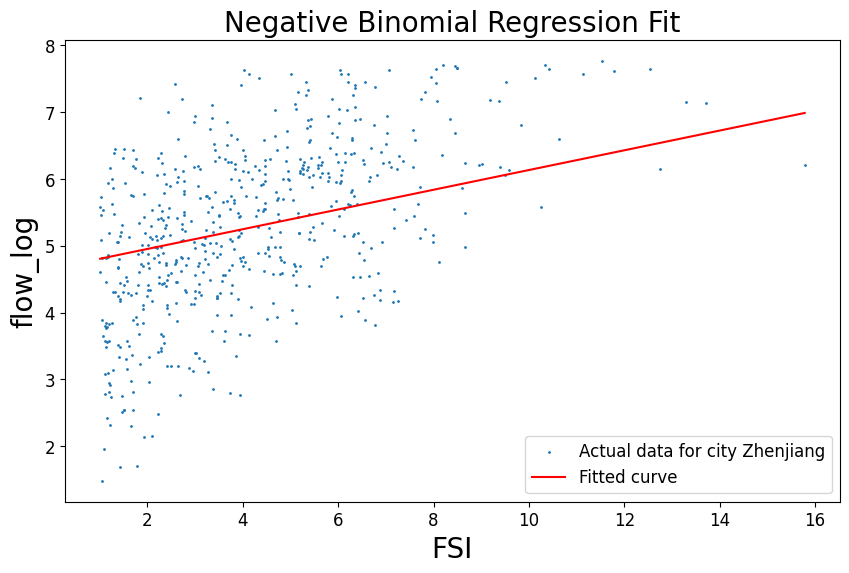

Zhongshan
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:30   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013 

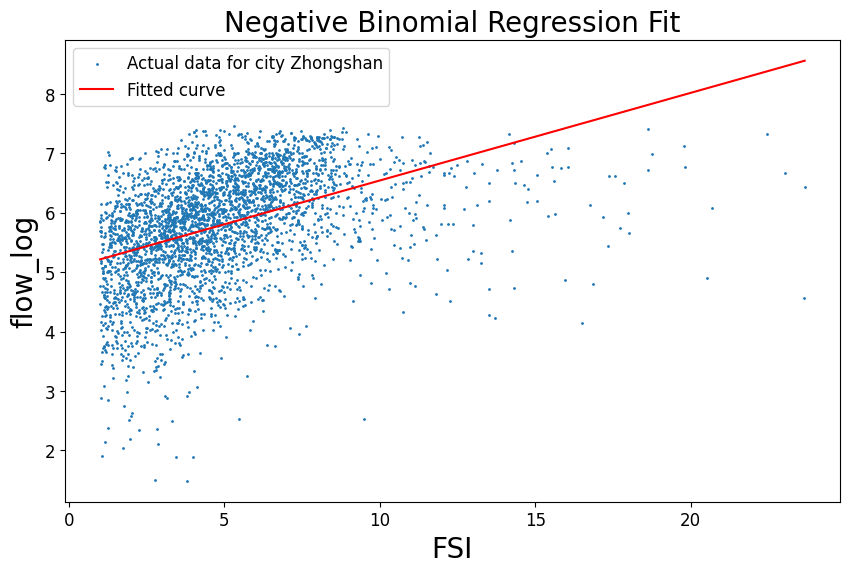

Zhuhai
                            OLS Regression Results                            
Dep. Variable:               flow_log   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.252
Method:                 Least Squares   F-statistic:                     776.7
Date:                Tue, 25 Jun 2024   Prob (F-statistic):               0.00
Time:                        18:29:30   Log-Likelihood:            -1.2689e+05
No. Observations:               87524   AIC:                         2.539e+05
Df Residuals:                   87485   BIC:                         2.542e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             4.8730      0.013    

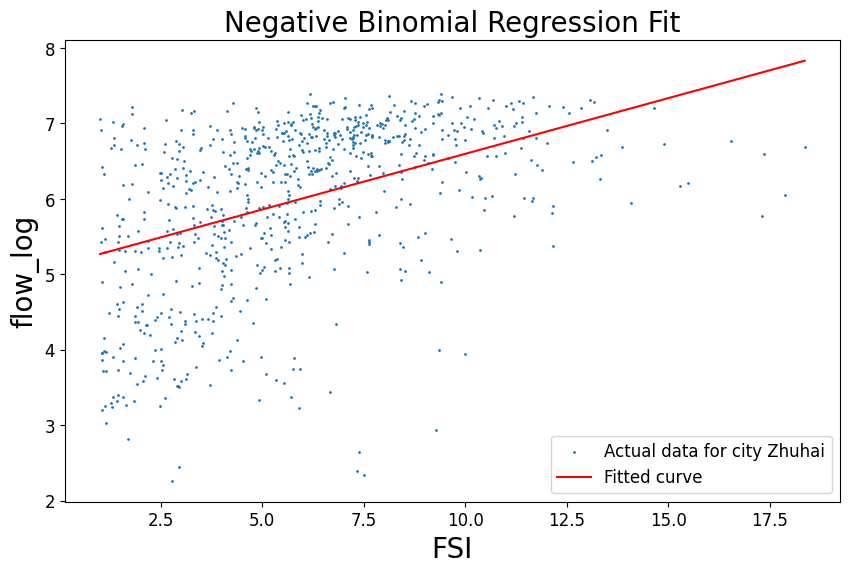

In [1649]:
pred_city_list = []
pred_flow_df_list = []
mse_flow_list = []


for i in range(len(city_list)):
    if len(joined_gdf_list[i])>0:
        print(city_list[i])
        result_df = create_Linear_regression_df(df,["FSI"],plot_cat = "flow_log",area_cap=100000000,min_FSI=1,plot_city = i)
        result_df["city"] = city_list[i]
        if result_df.shape[0]>0:
            pred_city_list.append(city_list[i])
            pred_flow_df_list.append(result_df)
            mse = mean_squared_error(result_df["flow_log-og"], result_df["pred"])
            mse_flow_list.append(mse)

### mse table for each city

In [1650]:
# Create a dictionary with the lists
data = {
    'city': pred_city_list,
    'mse_flow1': mse_flow1_list,
    'mse_flow2': mse_flow2_list,
    'mse_flow3': mse_flow3_list,
    'mse_flow': mse_flow_list
}

# Convert the dictionary to a DataFrame
mse_df = pd.DataFrame(data)

mse_df = pd.merge(mse_df,poi_count_df[["city","blocks"]],on="city")

mse_df['city'] = mse_df['city'] + mse_df['city'].map(lambda x: city_type_mapping[x])
mse_df.loc[mse_df['city'] == "Xi_an*",'city'] = "Xi'an*"

mse_df = mse_df.sort_values(by="blocks",ascending=False)
mse_df 

,city,mse_flow1,mse_flow2,mse_flow3,mse_flow,blocks
0,Beijing⁺,1.403587,1.622619,1.341706,1.481893,28575
10,Hangzhou*,0.956671,1.434710,1.295615,1.193616,20720
2,Chengdu*,1.271599,1.187789,1.037883,1.062684,20391
21,Shanghai⁺,0.636697,0.789775,1.053357,0.648347,16900
6,Foshan,0.545455,1.043450,0.899433,0.773077,15278
24,Shenzhenᵉ,0.676742,0.824449,0.879870,0.707061,14984
25,Suzhou,0.898508,1.521719,1.057138,1.044075,14030
30,Xi'an*,1.490964,1.598062,1.050450,1.465071,12711
3,Chongqing⁺,1.109862,1.382040,1.025997,1.208223,12486
8,Guangzhou*,0.798193,1.041810,1.006587,0.897813,12427


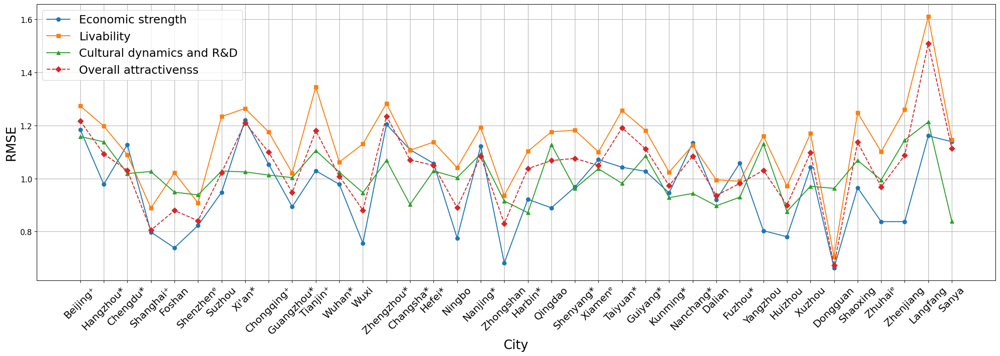

In [1888]:
# Plotting
plt.figure(figsize=(22, 8))
plt.plot(mse_df['city'], np.sqrt(mse_df['mse_flow1']), marker='o', label='Economic strength')
plt.plot(mse_df['city'], np.sqrt(mse_df['mse_flow2']), marker='s', label='Livability')
plt.plot(mse_df['city'], np.sqrt(mse_df['mse_flow3']), marker='^', label='Cultural dynamics and R&D')
plt.plot(mse_df['city'], np.sqrt(mse_df['mse_flow']), marker='D', linestyle='--', label='Overall attractivenss')

plt.xlabel('City')
plt.ylabel('RMSE')
#plt.title('MSE Values for Different Flows by City')
plt.legend(fontsize=18)

plt.xticks(rotation=45, fontsize=16)
plt.tight_layout()

plt.grid(True)


# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_mse.png"), dpi=300, bbox_inches='tight')

plt.show()

## overall distribution

In [1976]:
import pandas as pd

# Assuming pred_flow1_df_list, pred_flow2_df_list, and pred_flow3_df_list are already defined

# Step 1: Concatenate the dataframes
plot_pred_flow1_df_list = pred_flow1_df_list
plot_pred_flow2_df_list = pred_flow2_df_list
plot_pred_flow3_df_list = pred_flow3_df_list

# Concatenate dataframes for flow1, flow2, and flow3
all_pred_flow1_block_df = pd.concat(plot_pred_flow1_df_list, axis=0, ignore_index=True)
all_pred_flow2_block_df = pd.concat(plot_pred_flow2_df_list, axis=0, ignore_index=True)
all_pred_flow3_block_df = pd.concat(plot_pred_flow3_df_list, axis=0, ignore_index=True)

# Assuming city_type_mapping and building_metric_gdf are already defined

# Step 2: Modify 'City' column in all_pred_flow1_block_df, all_pred_flow2_block_df, and all_pred_flow3_block_df
for df in [all_pred_flow1_block_df, all_pred_flow2_block_df, all_pred_flow3_block_df]:
    df['City'] = df['city'] + df['city'].map(lambda x: city_type_mapping[x])
    df.loc[df['City'] == "Xi_an*", 'City'] = "Xi'an*"

# Step 3: Define plot_y for each flow
plot_y_flow1 = "flow1_log-og"
plot_y_flow2 = "flow2_log-og"
plot_y_flow3 = "flow3_log-og"
plot_y_list = [plot_y_flow1,plot_y_flow2,plot_y_flow3]

# Step 4: Merge with building_metric_gdf for each flow dataframe
all_pred_flow1_block_df_attached = pd.merge(building_metric_gdf, all_pred_flow1_block_df[["block_id", "pred", "City", plot_y_flow1]], on=["block_id", "City"])
all_pred_flow2_block_df_attached = pd.merge(building_metric_gdf, all_pred_flow2_block_df[["block_id", "pred", "City", plot_y_flow2]], on=["block_id", "City"])
all_pred_flow3_block_df_attached = pd.merge(building_metric_gdf, all_pred_flow3_block_df[["block_id", "pred", "City", plot_y_flow3]], on=["block_id", "City"])

# Step 5: Map 'Block Type' and calculate 'residual' for each flow dataframe
for df, plot_y in zip([all_pred_flow1_block_df_attached, all_pred_flow2_block_df_attached, all_pred_flow3_block_df_attached], 
                      [plot_y_flow1, plot_y_flow2, plot_y_flow3]):
    df['Block Type'] = df['cluster'].map(lambda x: label_list[x])
    df["residual"] = df[plot_y] - df["pred"]

# Print the shape of the final dataframes
print("Flow 1 attached shape:", all_pred_flow1_block_df_attached.shape)
print("Flow 2 attached shape:", all_pred_flow2_block_df_attached.shape)
print("Flow 3 attached shape:", all_pred_flow3_block_df_attached.shape)


Flow 1 attached shape: (109321, 16)
Flow 2 attached shape: (109335, 16)
Flow 3 attached shape: (103925, 16)


In [1970]:
all_pred_df_list = [ all_pred_flow1_block_df_attached, all_pred_flow2_block_df_attached, all_pred_flow3_block_df_attached]

In [1973]:
i=0

<Axes: xlabel='residual', ylabel='Count'>

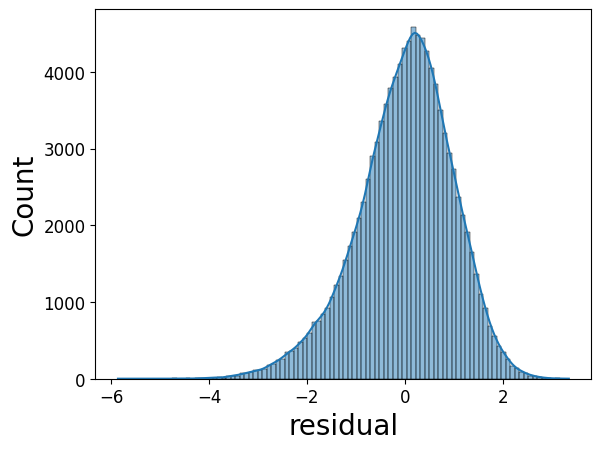

In [1974]:
sns.histplot(all_pred_df_list[i]["residual"], bins=100, kde=True)


### calculate mse

In [1977]:
mse = mean_squared_error(all_pred_df_list[i][plot_y_list[i]], all_pred_df_list[i]["pred"])
rmse = np.sqrt(mse)

print(f"RMSE: {rmse}")

RMSE: 0.9761494894773401


## over prediction

In [2189]:
all_overpred_df_list = []

for i in range(len(all_pred_df_list)):
    all_overpred_df_list.append(all_pred_df_list[i][all_pred_df_list[i]["residual"]  < -1])


In [2190]:
all_overpred_df_list[i]

,block_id,Shape_Area,GSI,FSI,geometry,city_id,mean_height,building_FSI_normalized,mean_height_normalized,Shape_Area_normalized,cluster,Block Type,City,pred,flow3_log-og,residual
0,2042,43865.114846,0.211319,1.890447,"POLYGON ((12915936.125 4807795.450, 12915930.7...",1,8.945946,0.047064,0.089091,0.043873,3,Spacious low-rise,Beijing⁺,2.315795,1.002487,-1.313307
1,2058,50701.933387,0.207454,1.592726,"POLYGON ((12907673.592 4807872.772, 12907736.8...",1,7.677489,0.039652,0.076459,0.050711,3,Spacious low-rise,Beijing⁺,2.274846,1.131872,-1.142973
2,2061,47288.113867,0.286405,2.788099,"POLYGON ((12907538.784 4807631.476, 12907534.5...",1,9.734797,0.069411,0.096947,0.047296,2,Compact low-rise,Beijing⁺,2.439259,1.153764,-1.285495
3,2062,29499.244706,0.291051,1.747082,"POLYGON ((12909520.193 4807647.454, 12909423.4...",1,6.002674,0.043494,0.059780,0.029504,2,Compact low-rise,Beijing⁺,2.296076,0.254848,-2.041229
4,2063,51244.305758,0.158667,2.228000,"POLYGON ((12907368.944 4807690.001, 12907365.9...",1,14.042017,0.055467,0.139842,0.051253,3,Spacious low-rise,Beijing⁺,2.362222,1.097414,-1.264808
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103916,4952,67316.193677,0.524585,3.546965,"POLYGON ((12640505.567 2558977.756, 12640274.7...",39,6.761474,0.088303,0.067336,0.067328,0,Dense low-rise,Zhuhaiᵉ,2.460930,0.071992,-2.388939
103917,4963,88231.030968,0.205540,3.147295,"POLYGON ((12640015.171 2559204.278, 12640008.8...",39,15.312343,0.078353,0.152493,0.088246,3,Spacious low-rise,Zhuhaiᵉ,2.405959,0.050001,-2.355958
103918,4969,205418.033747,0.161226,1.215745,"POLYGON ((12638598.419 2559263.263, 12638458.5...",39,7.540634,0.030267,0.075096,0.205454,3,Spacious low-rise,Zhuhaiᵉ,2.140291,0.487311,-1.652979
103923,5124,478442.248414,0.294522,2.941878,"POLYGON ((12631249.696 2549085.519, 12631267.0...",39,9.988658,0.073240,0.099475,0.478526,2,Compact low-rise,Zhuhaiᵉ,2.377706,1.233471,-1.144235


### composition

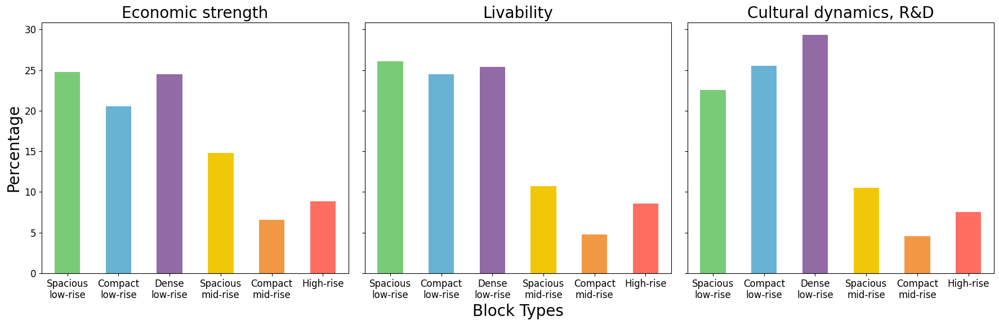

In [2191]:
# Define colors for each block type
colors = ['#7ACB77', '#68B3D4', '#926AA6', '#F0C808', "#F29844", "#FF6F61"]

# xtick labels
xtick_labels = ["Spacious\nlow-rise", "Compact\nlow-rise", "Dense\nlow-rise", "Spacious\nmid-rise", "Compact\nmid-rise", "High-rise"]

# Title list for each subplot
title_list = ["Economic strength","Livability","Cultural dynamics, R&D"]

def plot_block_type_percentage_combined(all_overpred_df_list):
    fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
    
    for i, df in enumerate(all_overpred_df_list[:3]):  # Only considering the first 3 DataFrames
        # Calculate percentage of each unique value in 'Block Type' column
        block_type_counts = df['Block Type'].value_counts(normalize=True) * 100
        
        # Create bar chart in the corresponding subplot
        ax = axes[i]
        
        desired_order = ['Spacious low-rise', 'Compact low-rise', 'Dense low-rise', 'Spacious mid-rise', 'Compact mid-rise', 'High-rise']
        block_type_counts = block_type_counts.reindex(desired_order)
        
        block_type_counts.plot(kind='bar', ax=ax, color=colors)
        ax.set_title(title_list[i])
        if i == 1:
            ax.set_xlabel('Block Types')
        else:
            ax.set_xlabel('')
        ax.set_ylabel('Percentage')
        ax.set_xticklabels(xtick_labels, rotation=0)
        #ax.grid( axis='y')
    
    plt.tight_layout()
    # Save the plot with DPI 300
    plt.savefig(os.path.join(graph_save_path, "4.3_percentages_overpred_barplot.png"), dpi=300, bbox_inches='tight')
    plt.show()

# Example usage
plot_block_type_percentage_combined(all_overpred_df_list)

### share in the total

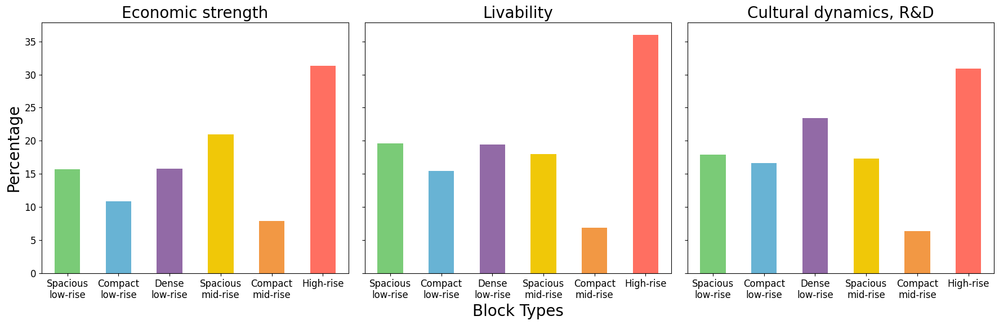

In [2192]:
# Define colors for each block type
colors = ['#7ACB77', '#68B3D4', '#926AA6', '#F0C808', "#F29844", "#FF6F61"]

# xtick labels
xtick_labels = ["Spacious\nlow-rise", "Compact\nlow-rise", "Dense\nlow-rise", "Spacious\nmid-rise", "Compact\nmid-rise", "High-rise"]

# Title list for each subplot
title_list = ["Economic strength","Livability","Cultural dynamics, R&D"]

def plot_block_type_percentage_combined(all_overpred_df_list):
    fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
    
    for i, df in enumerate(all_overpred_df_list[:3]):  # Only considering the first 3 DataFrames
        # Calculate percentage of each unique value in 'Block Type' column
        block_type_counts = all_overpred_df_list[i]['Block Type'].value_counts()/all_pred_df_list[i]['Block Type'].value_counts()*100
        
        # Create bar chart in the corresponding subplot
        ax = axes[i]
        
        desired_order = ['Spacious low-rise', 'Compact low-rise', 'Dense low-rise', 'Spacious mid-rise', 'Compact mid-rise', 'High-rise']
        block_type_counts = block_type_counts.reindex(desired_order)
        
        block_type_counts.plot(kind='bar', ax=ax, color=colors)
        ax.set_title(title_list[i])
        if i == 1:
            ax.set_xlabel('Block Types')
        else:
            ax.set_xlabel('')
        ax.set_ylabel('Percentage')
        ax.set_xticklabels(xtick_labels, rotation=0)
        #ax.grid( axis='y')
    
    plt.tight_layout()
    # Save the plot with DPI 300
    plt.savefig(os.path.join(graph_save_path, "4.3_share_within_class_overpred.png"), dpi=300, bbox_inches='tight')
    plt.show()

# Example usage
plot_block_type_percentage_combined(all_overpred_df_list)

In [2193]:
i=0

In [2194]:
# Group by city_name and block_type, and get the size of each group
grouped_overpred = all_overpred_df_list[i].groupby(['City', 'Block Type']).size().unstack(fill_value=0)

# Reorder the columns
grouped_overpred = grouped_overpred.reindex(columns=ordered_label_list)

# reset index
grouped_overpred = grouped_overpred.reindex(grouped.index)


# Calculate the percentage for each block type within each city
percentages_overpred = grouped_overpred.div(grouped.sum(axis=1), axis=0) * 100

# Format the percentages to string representation with "%"
percentages_overpred_table = percentages_overpred.applymap(lambda x: f"{x:.0f}%")

In [2195]:
# not overated
grouped_non_overpred = grouped - grouped_overpred

# Calculate the percentage for each block type within each city
percentages_non_overpred = grouped_non_overpred.div(grouped.sum(axis=1), axis=0) * 100

# Format the percentages to string representation with "%"
percentages_non_overpred_table = percentages_non_overpred.applymap(lambda x: f"{x:.0f}%")

In [2186]:
# horizontally merge them togehter
percentages_non_overpred_renamed = percentages_non_overpred.add_suffix(' in total')
percentages_overpred_renamed = percentages_overpred.add_suffix(' in underpredicting areas')

concat_df_overpred = pd.concat([percentages_overpred_renamed,percentages_non_overpred_renamed],axis=1)

# Desired column order
desired_order = [
    'Spacious low-rise in underpredicting areas', 'Spacious low-rise in total',
    'Compact low-rise in underpredicting areas', 'Compact low-rise in total',
    'Dense low-rise in underpredicting areas', 'Dense low-rise in total',
    'Spacious mid-rise in underpredicting areas', 'Spacious mid-rise in total',
    'Compact mid-rise in underpredicting areas', 'Compact mid-rise in total',
    'High-rise in underpredicting areas', 'High-rise in total'
]

# Reorder the DataFrame
concat_df_overpred = concat_df_overpred[desired_order]


# reset index
concat_df_overpred = concat_df_overpred.reindex(percentages.index)


In [2196]:
# horizontally merge them togehter
percentages_non_overpred_renamed = percentages_non_overpred.add_suffix(' in total')
percentages_overpred_renamed = percentages_overpred.add_suffix(' in overpredicting areas')

concat_df_overpred = pd.concat([percentages_overpred_renamed,percentages_non_overpred_renamed],axis=1)

# Desired column order
desired_order = [
    'Spacious low-rise in overpredicting areas', 'Spacious low-rise in total',
    'Compact low-rise in overpredicting areas', 'Compact low-rise in total',
    'Dense low-rise in overpredicting areas', 'Dense low-rise in total',
    'Spacious mid-rise in overpredicting areas', 'Spacious mid-rise in total',
    'Compact mid-rise in overpredicting areas', 'Compact mid-rise in total',
    'High-rise in overpredicting areas', 'High-rise in total'
]

# Reorder the DataFrame
concat_df_overpred = concat_df_overpred[desired_order]


# reset index
concat_df_overpred = concat_df_overpred.reindex(percentages.index)


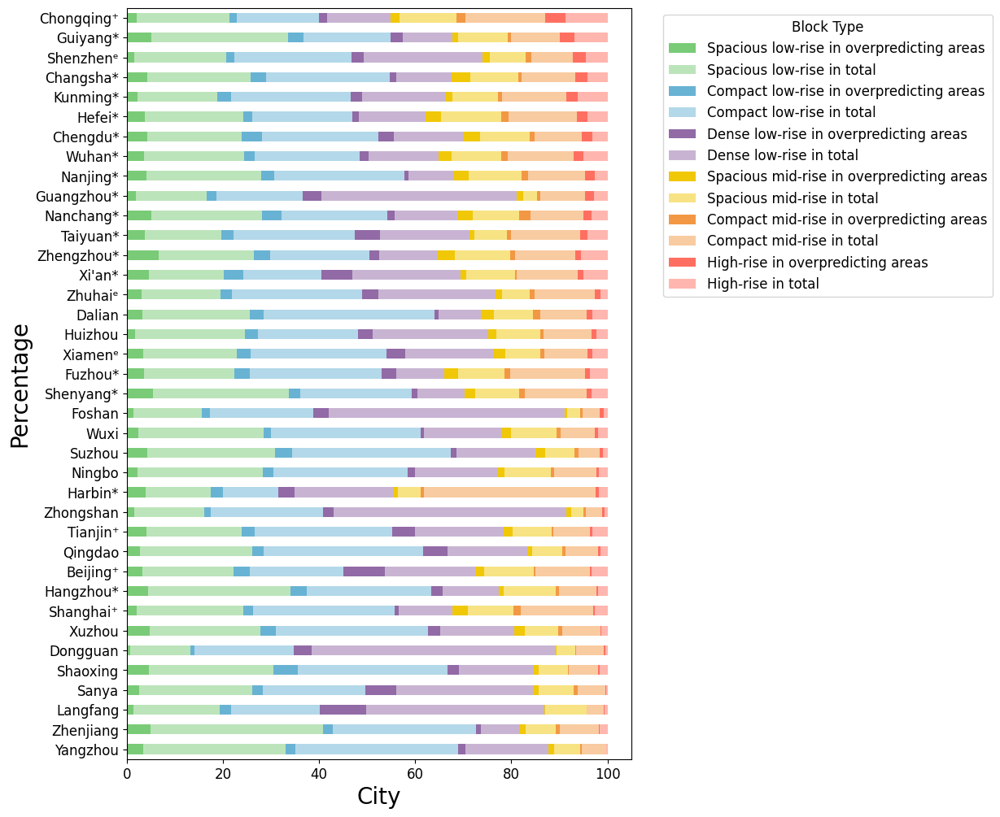

In [2201]:
# Define colors for each block type
colors = [ '#7ACB77','#68B3D4','#926AA6','#F0C808', "#F29844", "#FF6F61"]
colors = [mcolors.to_rgba(color, alpha=1) for color in colors]

# Convert colors to 50% transparency
colors_with_alpha = [mcolors.to_rgba(color, alpha=0.5) for color in colors]
combined_colors = [val for pair in zip(colors, colors_with_alpha) for val in pair]

# Plotting the stacked bar plot
ax = concat_df_overpred.sort_values(by="High-rise in overpredicting areas").plot(kind='barh', stacked=True, color=combined_colors, figsize=(8,12))

# Adding labels and title
ax.set_ylabel('Percentage')
ax.set_xlabel('City')
#ax.set_title('Percentage of Each Block Type per City')
plt.legend(title='Block Type', bbox_to_anchor=(1.05, 1), loc='upper left', title_fontsize=12)


# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_percentages_overpred.png"), dpi=300, bbox_inches='tight')

plt.show()


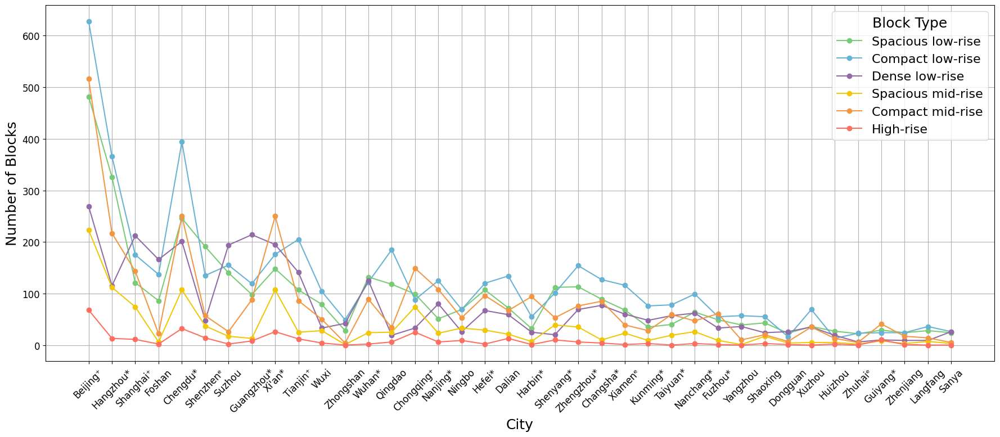

In [1924]:
# Define colors for each block type
colors = ['#7ACB77', '#68B3D4', '#926AA6', '#F0C808', "#F29844", "#FF6F61"]

# Order the cities by the number of blocks
total_blocks_overpred = grouped_overpred.sum(axis=1).sort_values(ascending=False).index
absolute_values_overpred = grouped_overpred.loc[total_blocks_overpred]

# Ensure that both dataframes have the same indices for accurate plotting
absolute_values_overpred = absolute_values_overpred.reindex(absolute_values.index)

# Plotting the overpred
fig, ax = plt.subplots(figsize=(18, 8))
for col, color in zip(absolute_values_overpred.columns, colors):
    ax.plot(absolute_values_overpred.index, absolute_values_overpred[col], marker='o', color=color, label=col)

# Plotting the original
#for col, color in zip(absolute_values.columns, colors):
#    ax.plot(absolute_values.index, absolute_values[col], marker='s', color=color,linestyle='--', label=(col+"oroginal"))

    
# Adding grid lines
ax.grid(True)

# Adding labels and title
ax.set_xlabel('City', fontsize=18)
ax.set_ylabel('Number of Blocks', fontsize=18)
#ax.set_title('Number of Each Block Type per City')
plt.legend(title='Block Type', loc='upper right', fontsize=16, title_fontsize=18)
plt.xticks(rotation=45, fontsize=12)
plt.tight_layout()

# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_num_overpred.png"), dpi=300, bbox_inches='tight')

plt.show()

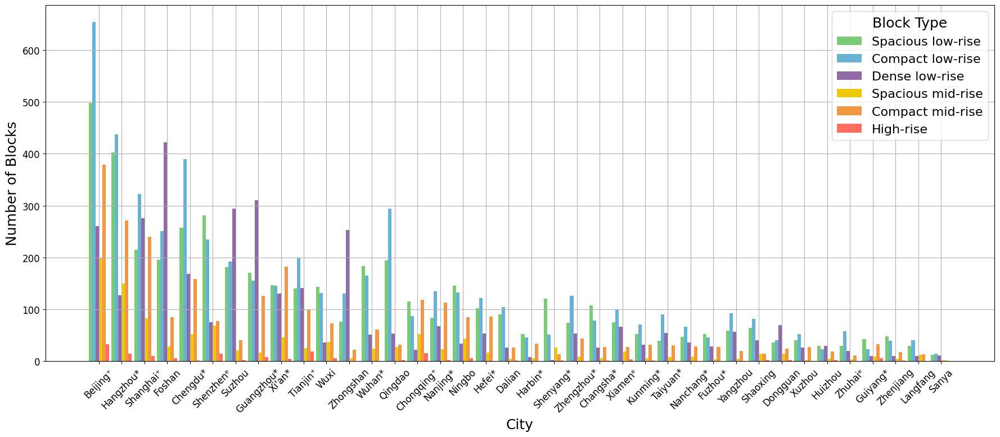

In [2111]:
import matplotlib.pyplot as plt
import os

# Define colors for each block type
colors = ['#7ACB77', '#68B3D4', '#926AA6', '#F0C808', "#F29844", "#FF6F61"]

# Order the cities by the number of blocks
total_blocks_overpred = grouped_overpred.sum(axis=1).sort_values(ascending=False).index
absolute_values_overpred = grouped_overpred.loc[total_blocks_overpred]

# Ensure that both dataframes have the same indices for accurate plotting
absolute_values_overpred = absolute_values_overpred.reindex(absolute_values.index)

# Plotting the overpred as side-by-side bar plots
fig, ax = plt.subplots(figsize=(18, 8))

# Setting the bar width
bar_width = 0.15
# Number of columns
n_cols = len(absolute_values_overpred.columns)
# Indices for the x-axis
indices = range(len(absolute_values_overpred))

# Plotting each block type
for i, (col, color) in enumerate(zip(absolute_values_overpred.columns, colors)):
    ax.bar([x + i * bar_width for x in indices], absolute_values_overpred[col], color=color, width=bar_width, label=col)

# Adding grid lines
ax.grid(True)

# Adding labels and title
ax.set_xlabel('City', fontsize=18)
ax.set_ylabel('Number of Blocks', fontsize=18)
plt.legend(title='Block Type', loc='upper right', fontsize=16, title_fontsize=18)
plt.xticks([x + (n_cols - 1) * bar_width / 2 for x in indices], absolute_values_overpred.index, rotation=45, fontsize=12)
plt.tight_layout()

# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path, "4.1_num_overpred.png"), dpi=300, bbox_inches='tight')

plt.show()


In [1327]:
all_pred_block_df_attached_underpred = all_pred_block_df_attached[all_pred_block_df_attached["redsidual"] < -1]
print(all_pred_block_df_attached_underpred.shape)

(15577, 16)


In [1328]:
# Group by city_name and block_type, and get the size of each group
grouped = all_pred_block_df_attached_underpred.groupby(['City', 'Block Type']).size().unstack(fill_value=0)

# Reorder the columns
grouped = grouped.reindex(columns=ordered_label_list)

# Calculate the percentage for each block type within each city
percentages = grouped.div(grouped.sum(axis=1), axis=0) * 100

# Order the cities by the number of blocks
total_blocks = grouped.sum(axis=1).sort_values(ascending=False).index
percentages = percentages.loc[total_blocks]

# Format the percentages to string representation with "%"
percentages = percentages.applymap(lambda x: f"{x:.0f}%")

percentages

Block Type,Spacious low-rise,Compact low-rise,Dense low-rise,Spacious mid-rise,Compact mid-rise,High-rise
City,,,,,,
Beijing⁺,32%,28%,12%,8%,17%,2%
Hangzhou*,38%,30%,11%,6%,14%,1%
Chengdu*,44%,32%,10%,4%,10%,0%
Xi'an*,23%,20%,22%,7%,27%,1%
Foshan,32%,32%,30%,1%,5%,0%
Tianjin⁺,27%,35%,21%,4%,10%,3%
Suzhou,32%,25%,41%,1%,2%,0%
Shanghai⁺,32%,19%,30%,8%,10%,1%
Qingdao,34%,47%,11%,4%,4%,0%


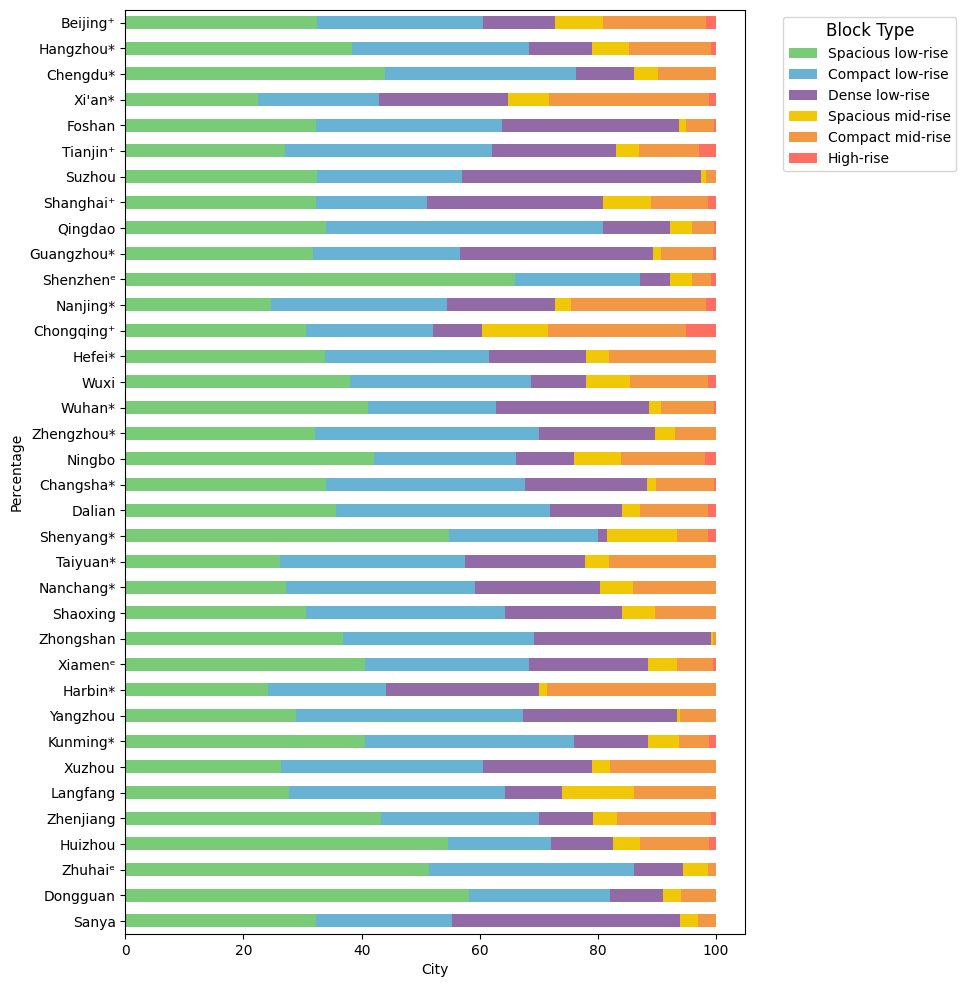

In [1329]:
# Define colors for each block type
colors = [ '#7ACB77','#68B3D4','#926AA6','#F0C808', "#F29844", "#FF6F61"]


# Calculate the percentage for each block type within each city
percentages = grouped.div(grouped.sum(axis=1), axis=0) * 100

# Order the cities by the number of blocks
total_blocks = grouped.sum(axis=1).sort_values(ascending=True).index
percentages = percentages.loc[total_blocks]

# Plotting the stacked bar plot
ax = percentages.plot(kind='barh', stacked=True, color=colors, figsize=(8,12))

# Adding labels and title
ax.set_ylabel('Percentage')
ax.set_xlabel('City')
#ax.set_title('Percentage of Each Block Type per City')
plt.legend(title='Block Type', bbox_to_anchor=(1.05, 1), loc='upper left', title_fontsize=12)


# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_percentages.png"), dpi=300, bbox_inches='tight')

plt.show()


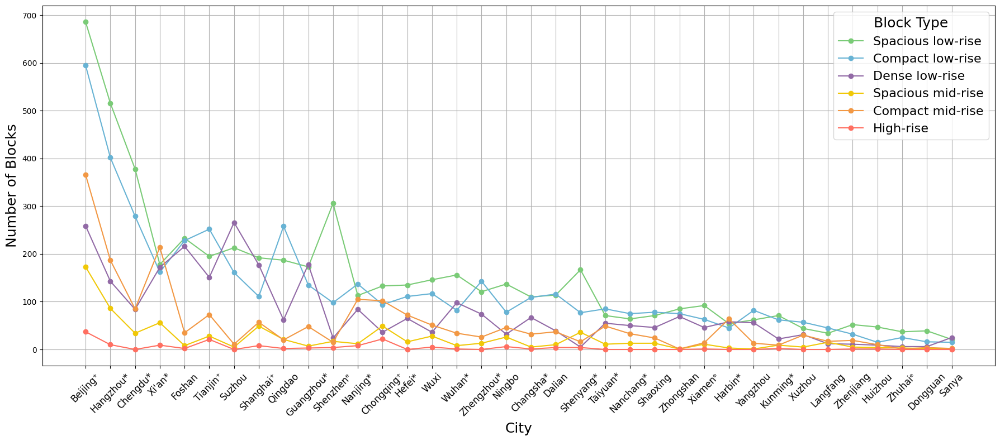

In [1330]:
# Define colors for each block type
colors = ['#7ACB77', '#68B3D4', '#926AA6', '#F0C808', "#F29844", "#FF6F61"]

# Order the cities by the number of blocks
total_blocks = grouped.sum(axis=1).sort_values(ascending=False).index
absolute_values = grouped.loc[total_blocks]

# Plotting the line plot
fig, ax = plt.subplots(figsize=(18, 8))
for col, color in zip(absolute_values.columns, colors):
    ax.plot(absolute_values.index, absolute_values[col], marker='o', color=color, label=col)

# Adding grid lines
ax.grid(True)

# Adding labels and title
ax.set_xlabel('City', fontsize=18)
ax.set_ylabel('Number of Blocks', fontsize=18)
#ax.set_title('Number of Each Block Type per City')
plt.legend(title='Block Type', loc='upper right', fontsize=16, title_fontsize=18)
plt.xticks(rotation=45, fontsize=12)
plt.tight_layout()

# Save the plot with DPI 300
plt.savefig(os.path.join(graph_save_path,f"4.1_num.png"), dpi=300, bbox_inches='tight')

plt.show()

In [ ]:
plt.figure(figsize=(10, 6))
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
sns.histplot(flow_df_merged["flow"][flow_df_merged["flow"]<2], bins=10, kde=True)
plt.xlim(0, 2)

In [1294]:
pred_df_list[0]

'Beijing'

(0.0, 1.2)

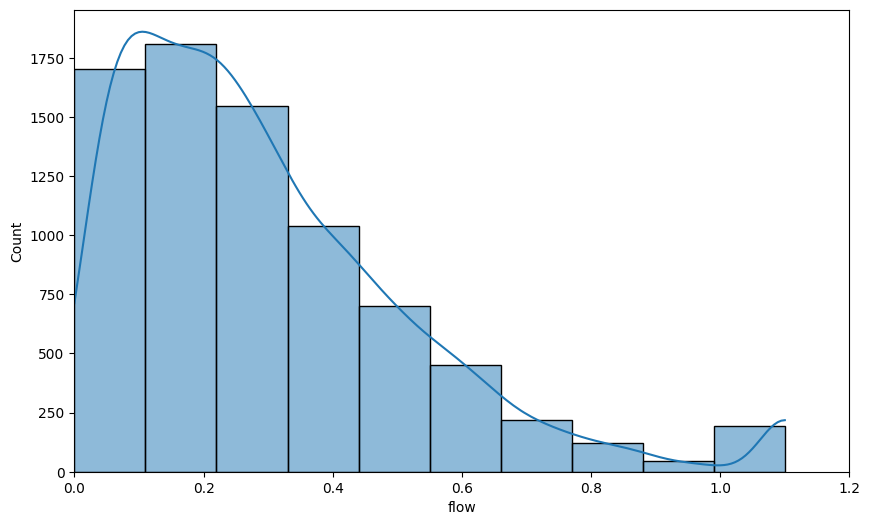

In [627]:
plt.figure(figsize=(10, 6))
plot_cat = "flow"
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged.loc[flow_df_merged[plot_cat]>1,plot_cat] = 1.1
sns.histplot(flow_df_merged["flow"][flow_df_merged["flow"]<2], bins=10, kde=True)
plt.xlim(0, 1.2)

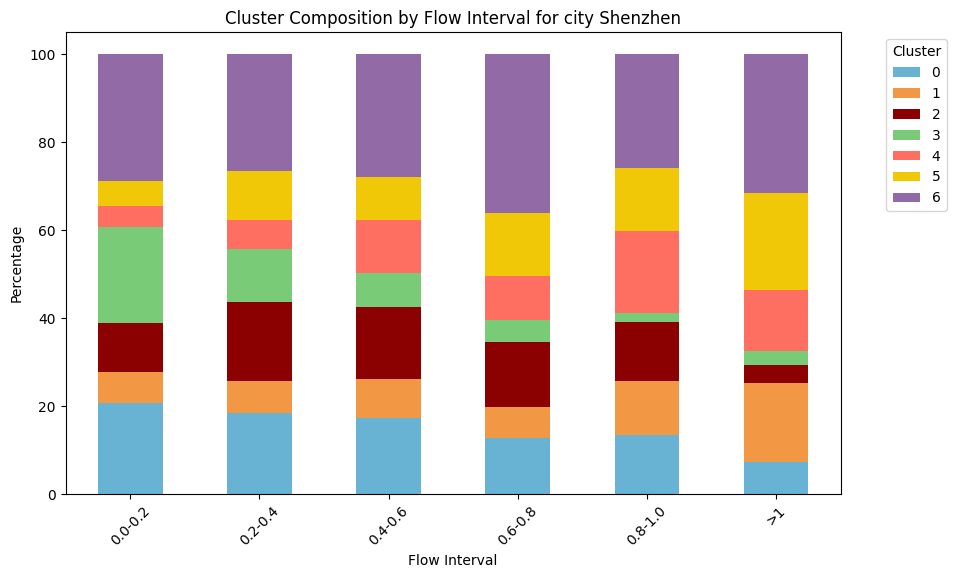

In [628]:
plot_cat = "flow"
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = flow_df_merged.loc[flow_df_merged["area"]<100000,:]

#flow_df_merged =  flow_df_merged[flow_df_merged["area"]<1000000]
flow_df_merged.loc[(flow_df_merged[plot_cat]>1) & (flow_df_merged[plot_cat]<2),plot_cat] = 1.1
flow_df_merged = flow_df_merged[flow_df_merged['cluster'] != -1]


bins = np.arange(0, 1.4, 0.2)
labels = [f'{round(bins[i], 1)}-{round(bins[i+1], 1)}' for i in range(len(bins)-1)]

# Bin the flow column
flow_df_merged['flow_bin'] = pd.cut(flow_df_merged['flow'], bins=bins, labels=labels, include_lowest=True)

# Group by the flow_bin and cluster, and count the occurrences
grouped = flow_df_merged.groupby(['flow_bin', 'cluster']).size().unstack(fill_value=0)

# Calculate the percentage composition of each cluster within each bin
percentage_composition = grouped.div(grouped.sum(axis=1), axis=0) * 100

# Custom colormap
colors = ['#68B3D4',"#F29844",  '#8B0000', '#7ACB77',"#FF6F61" ,'#F0C808','#926AA6']


# Plotting the stacked bar plot
ax = percentage_composition.plot(kind='bar', stacked=True, color=colors, figsize=(10, 6))

# Modify the x-tick labels
x_labels = labels[:-1] + ['>1']
ax.set_xticklabels(x_labels)

# Move the legend to the right
ax.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.ylabel('Percentage')
plt.xlabel('Flow Interval')
plt.title(f'Cluster Composition by Flow Interval for city {atn_city_list[city_id]}')
plt.xticks(rotation=45)
plt.show()

### regression

In [629]:
flow_df_merged.columns

Index(['Unnamed: 0', 'block_id', 'osmid', 'accessible_blocks', 'flow', 'flow1',
       'flow3', 'flow4', 'flow5', 'flow7', 'avg_fsi', 'avg_gsi',
       'avg_fsi_1000', 'avg_gsi_1000', 'avg_fsi_500', 'avg_gsi_500', 'area',
       'FSI', 'GSI', 'cluster', 'geometry', 'poi_count_-1', 'poi_count_1',
       'poi_count_2', 'poi_count_3', 'poi_count_4', 'poi_count_5',
       'poi_count_6', 'poi_count_7', 'poi_count_8', 'poi_count_9',
       'poi_count_10', 'poi_count_sum', 'flow_bin'],
      dtype='object')

In [640]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler

plot_cat = "flow4"

# Assuming flow_df_merged is your DataFrame
df = flow_df_merged
df = df[df["area"]<100000]

# Define your target variable
y = df[plot_cat]

# Convert 'cluster' to dummy variables
df = pd.get_dummies(df, columns=['cluster'], drop_first=True)

# Define your feature set after creating dummy variables
#X = df[['avg_fsi', 'avg_gsi', 'avg_fsi_1000', 'avg_gsi_1000', 'avg_fsi_500', 'avg_gsi_500', 'area', 'FSI', 'GSI'] + [col for col in df.columns if col.startswith('cluster_')]]
X = df[['avg_fsi', 'avg_gsi', 'area', 'FSI', 'GSI']] 

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize the numerical features
scaler = StandardScaler()
X_train[X.columns] = scaler.fit_transform(X_train[X.columns])
X_test[X.columns] = scaler.transform(X_test[X.columns])

# Create and train the model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse}')
print(f'R^2 Score: {r2}')

# Optionally, you can check the coefficients of the model
coefficients = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])
print(coefficients)

Mean Squared Error: 208.4907229949718
R^2 Score: -0.002374324665032068
         Coefficient
avg_fsi     0.044550
avg_gsi     0.014917
area       -0.019329
FSI         0.005206
GSI         0.035674


### coorelation

In [644]:
correlation_matrix

,avg_fsi,avg_gsi,avg_fsi_1000,avg_gsi_1000,avg_fsi_500,avg_gsi_500,area,FSI,GSI,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,flow
avg_fsi,1.000000,0.732834,0.729650,0.389120,0.450047,0.000422,-0.031478,0.300441,-0.057578,0.108442,-0.072141,-0.144936,0.160505,0.140063,-0.054424,-0.005832
avg_gsi,0.732834,1.000000,0.425755,0.644082,0.190109,0.305474,-0.011852,0.100004,0.206948,-0.023753,0.153864,-0.141771,-0.004316,-0.003877,0.047080,-0.011159
avg_fsi_1000,0.729650,0.425755,1.000000,0.585031,0.562645,0.032056,-0.020937,0.378660,-0.047695,0.116405,-0.080393,-0.200665,0.210336,0.167815,-0.039451,-0.015447
avg_gsi_1000,0.389120,0.644082,0.585031,1.000000,0.203549,0.489446,-0.022464,0.103601,0.347184,-0.094195,0.235086,-0.203312,-0.061330,-0.024234,0.118178,-0.020798
avg_fsi_500,0.450047,0.190109,0.562645,0.203549,1.000000,0.252097,-0.014963,0.586404,0.033283,0.181120,-0.015457,-0.335314,0.347374,0.134106,-0.020537,-0.030693
avg_gsi_500,0.000422,0.305474,0.032056,0.489446,0.252097,1.000000,-0.058159,0.092047,0.684259,-0.196234,0.481247,-0.331652,-0.194036,-0.138110,0.252712,-0.034715
area,-0.031478,-0.011852,-0.020937,-0.022464,-0.014963,-0.058159,1.000000,-0.056270,-0.107988,0.042242,-0.106736,-0.032922,-0.017373,0.112306,-0.004744,-0.017708
FSI,0.300441,0.100004,0.378660,0.103601,0.586404,0.092047,-0.056270,1.000000,0.208370,0.215308,0.085702,-0.478505,0.554320,0.092042,0.007663,-0.009533
GSI,-0.057578,0.206948,-0.047695,0.347184,0.033283,0.684259,-0.107988,0.208370,1.000000,-0.250783,0.708365,-0.477444,-0.258355,-0.172344,0.353764,0.003472
cluster_1,0.108442,-0.023753,0.116405,-0.094195,0.181120,-0.196234,0.042242,0.215308,-0.250783,1.000000,-0.121758,-0.114346,-0.085390,-0.095932,-0.183933,-0.007137


In [643]:
plot_cat = "flow"

df = flow_df_merged

# Convert 'cluster' to dummy variables
df = pd.get_dummies(df, columns=['cluster'], drop_first=True)

# Define your target variable
y = df[plot_cat]

# Define your feature set after creating dummy variables
features = ['avg_fsi', 'avg_gsi', 'avg_fsi_1000', 'avg_gsi_1000', 'avg_fsi_500', 'avg_gsi_500', 'area', 'FSI', 'GSI'] + [col for col in df.columns if col.startswith('cluster_')]

# Calculate the correlation matrix
correlation_matrix = df[features + [plot_cat]].corr()

# Extract the correlation of each feature with 'flow'
correlation_with_y = correlation_matrix[plot_cat].drop(plot_cat)

# Display the correlations
print(correlation_with_y)

# Identify the feature with the highest absolute correlation with 'flow'
most_correlated_feature = correlation_with_y.abs().idxmax()
most_correlated_value = correlation_with_y[most_correlated_feature]

print(f'Most correlated feature: {most_correlated_feature}')
print(f'Correlation value: {most_correlated_value}')

avg_fsi        -0.005832
avg_gsi        -0.011159
avg_fsi_1000   -0.015447
avg_gsi_1000   -0.020798
avg_fsi_500    -0.030693
avg_gsi_500    -0.034715
area           -0.017708
FSI            -0.009533
GSI             0.003472
cluster_1      -0.007137
cluster_2      -0.008078
cluster_3      -0.003887
cluster_4      -0.005689
cluster_5       0.002059
cluster_6       0.024095
Name: flow, dtype: float64
Most correlated feature: avg_gsi_500
Correlation value: -0.03471546329543813


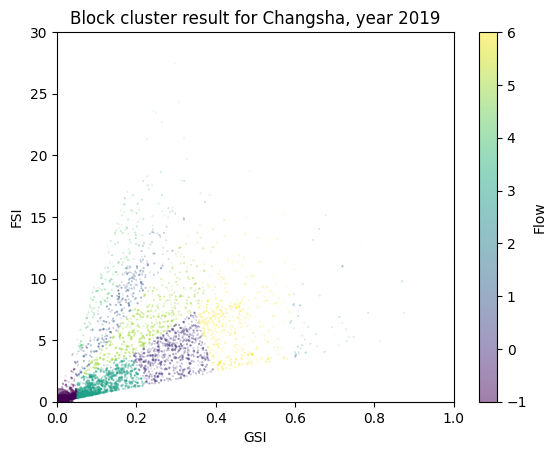

In [447]:
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged_s10 = flow_df_merged[(flow_df_merged["flow"]<10000) & (flow_df_merged["flow"]>0)]

scatter = plt.scatter(flow_df_merged_s10["GSI"],flow_df_merged_s10["FSI"], s=flow_df_merged_s10["area"]/flow_df_merged_s10["area"].max()*300,alpha=0.5,c=flow_df_merged_s10["cluster"])
plt.xlim(0, 1) 
plt.ylim(0, 30) 

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Flow')

# Add labels and title
plt.xlabel('GSI')
plt.ylabel('FSI')
plt.title(f'Block cluster result for {city_list[city_id]}, year {joined_year_list[city_id][year_id]}')

plt.show()

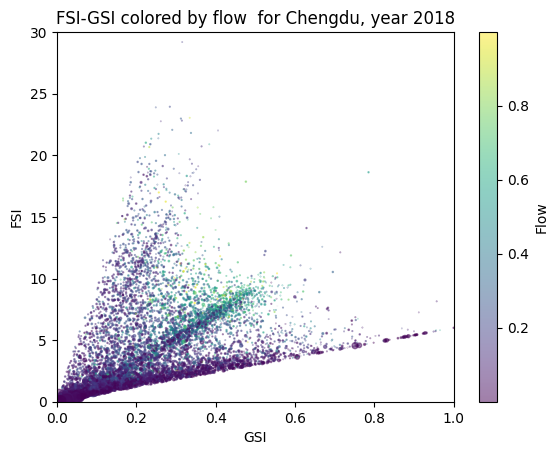

In [616]:
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged_s10 = flow_df_merged[(flow_df_merged["flow"]<1) & (flow_df_merged["flow"]>0)]

scatter = plt.scatter(flow_df_merged_s10["GSI"],flow_df_merged_s10["FSI"], s=flow_df_merged_s10["area"]/flow_df_merged_s10["area"].max()*300,alpha=0.5,c=flow_df_merged_s10["flow"])
plt.xlim(0, 1) 
plt.ylim(0, 30) 

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Flow')

# Add labels and title
plt.xlabel('GSI')
plt.ylabel('FSI')
plt.title(f'FSI-GSI colored by flow  for {city_list[city_id]}, year {joined_year_list[city_id][year_id]}')

plt.show()

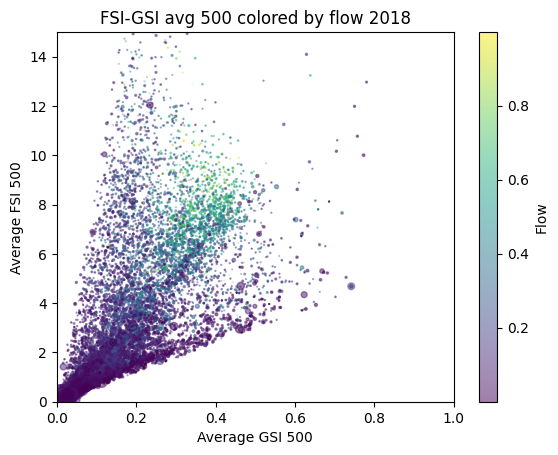

In [617]:
i = 1
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged_s10 = flow_df_merged[(flow_df_merged["flow"]<1) & (flow_df_merged["flow"]>0)]

scatter = plt.scatter(flow_df_merged_s10["avg_gsi_500"],flow_df_merged_s10["avg_fsi_500"], s=flow_df_merged_s10["area"]/flow_df_merged_s10["area"].max()*500,alpha=0.5,c=flow_df_merged_s10["flow"])
plt.xlim(0, 1) 
plt.ylim(0, 15) 

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Flow')

# Add labels and title
plt.xlabel('Average GSI 500')
plt.ylabel('Average FSI 500')
plt.title(f'FSI-GSI avg 500 colored by flow {joined_year_list[city_id][year_id]}')

plt.show()

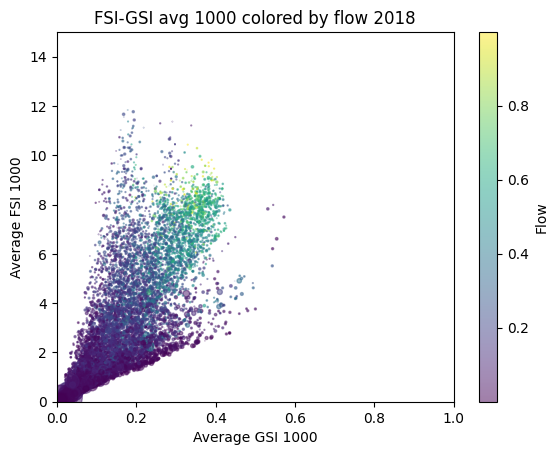

In [618]:
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged_s10 = flow_df_merged[(flow_df_merged["flow"]<1) & (flow_df_merged["flow"]>0)]

scatter = plt.scatter(flow_df_merged_s10["avg_gsi_1000"],flow_df_merged_s10["avg_fsi_1000"], s=flow_df_merged_s10["area"]/flow_df_merged_s10["area"].max()*500,alpha=0.5,c=flow_df_merged_s10["flow"])
plt.xlim(0, 1) 
plt.ylim(0, 15) 

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Flow')

# Add labels and title
plt.xlabel('Average GSI 1000')
plt.ylabel('Average FSI 1000')
plt.title(f'FSI-GSI avg 1000 colored by flow {joined_year_list[city_id][year_id]}')

plt.show()

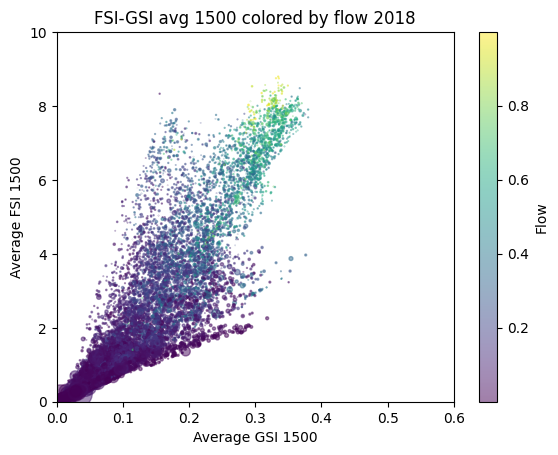

In [619]:
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged_s10 = flow_df_merged[(flow_df_merged["flow"]<1) & (flow_df_merged["flow"]>0)]

scatter = plt.scatter(flow_df_merged_s10["avg_gsi"],flow_df_merged_s10["avg_fsi"], s=flow_df_merged_s10["area"]/flow_df_merged_s10["area"].max()*500,alpha=0.5,c=flow_df_merged_s10["flow"])
plt.xlim(0, 0.6) 
plt.ylim(0, 10) 

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Flow')

# Add labels and title
plt.xlabel('Average GSI 1500')
plt.ylabel('Average FSI 1500')
plt.title(f'FSI-GSI avg 1500 colored by flow {joined_year_list[city_id][year_id]}')

plt.show()

(0.0, 20.0)

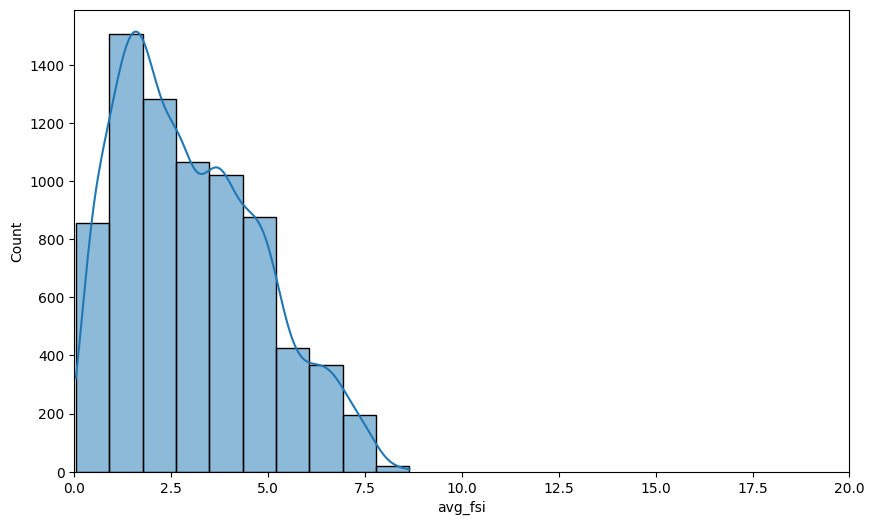

In [354]:
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged_s10 = flow_df_merged[(flow_df_merged["flow"]<1) & (flow_df_merged["flow"]>0)]

plt.figure(figsize=(10, 6))
sns.histplot(flow_df_merged_s10["avg_fsi"], bins=10, kde=True)
plt.xlim(0, 20)

(0.0, 1.0)

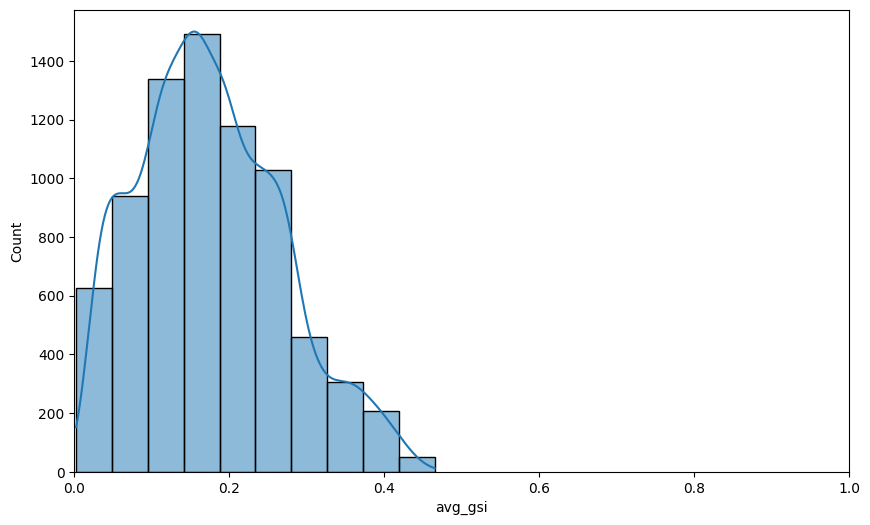

In [355]:
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged_s10 = flow_df_merged[(flow_df_merged["flow"]<1) & (flow_df_merged["flow"]>0)]

plt.figure(figsize=(10, 6))
sns.histplot(flow_df_merged_s10["avg_gsi"], bins=10, kde=True)
plt.xlim(0, 1)

56106.35850604996


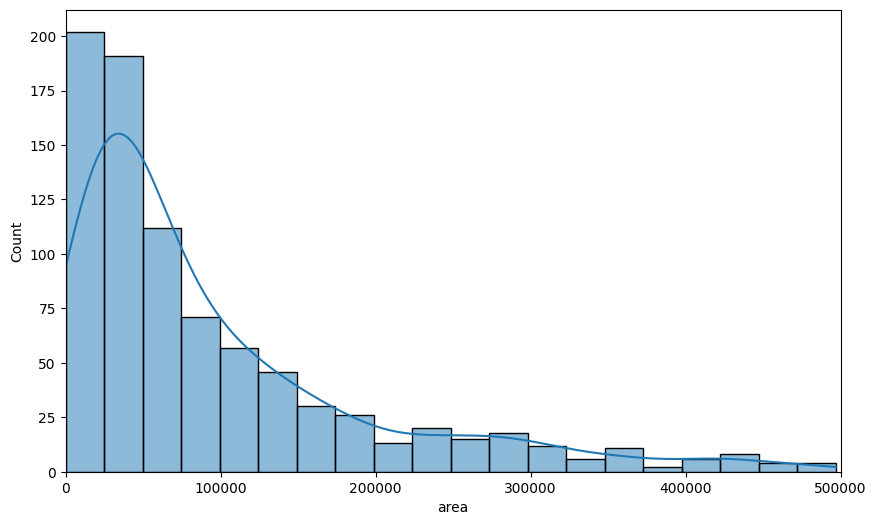

In [1149]:
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged =  flow_df_merged[flow_df_merged["area"]<500000]
plt.figure(figsize=(10, 6))
sns.histplot(flow_df_merged["area"], bins=20, kde=True)
plt.xlim(0, 500000)

print(flow_df_merged["area"].median())

(0.0, 1.0)

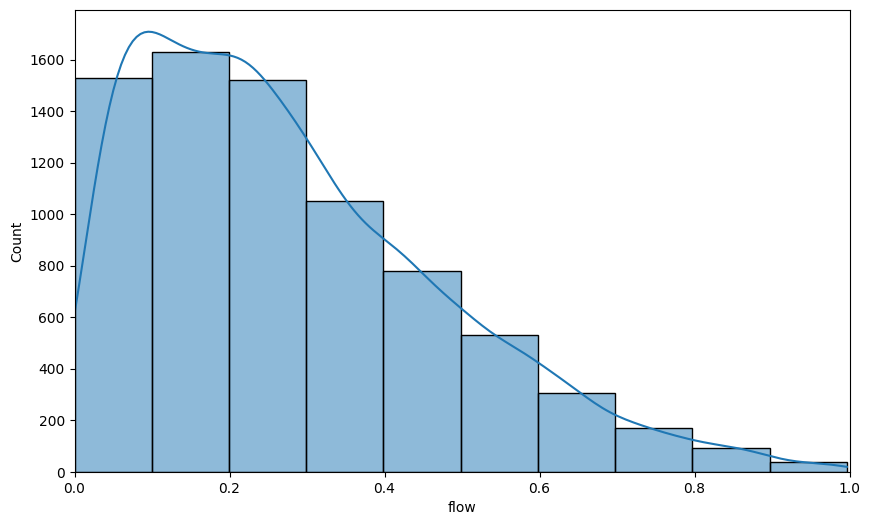

In [361]:
plt.figure(figsize=(10, 6))
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
sns.histplot(flow_df_merged["flow"][flow_df_merged["flow"]<1], bins=10, kde=True)
plt.xlim(0, 1)

In [645]:
flow_df_merged.shape

(4023, 34)

Text(0, 0.5, 'Attractiveness')

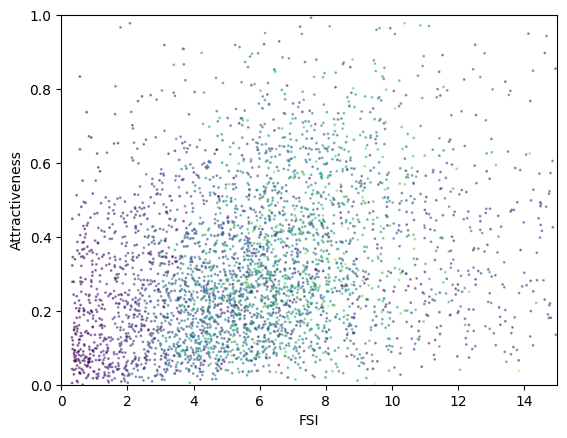

In [652]:
plt.scatter(flow_df_merged["FSI"],flow_df_merged["flow"], s=1,alpha=0.5,c=flow_df_merged["GSI"])
plt.xlim(0, 15) 
plt.ylim(0,1) 

plt.xlabel('FSI')
plt.ylabel('Attractiveness')

Text(0, 0.5, 'Attractiveness')

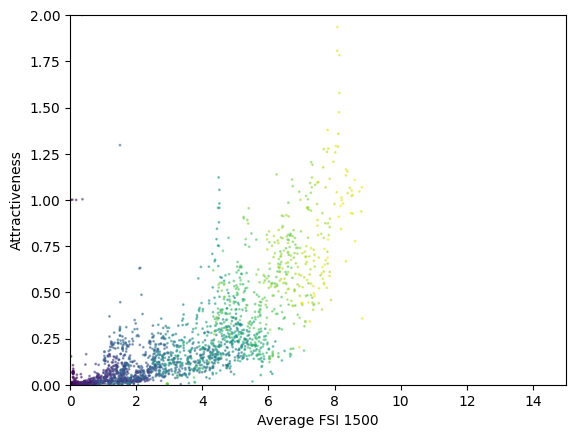

In [535]:
plot_cat = "flow"
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged = gpd.GeoDataFrame(flow_df_merged, geometry=flow_df_merged.geometry)
flow_df_merged = flow_df_merged.loc[flow_df_merged["area"]<100000,:]


plt.scatter(flow_df_merged["avg_fsi"],flow_df_merged["flow"], s=1,alpha=0.5,c=flow_df_merged["avg_gsi"])
plt.xlim(0, 15) 
plt.ylim(0,2) 

plt.xlabel('Average FSI 1500')
plt.ylabel('Attractiveness')

Text(0, 0.5, 'Attractiveness')

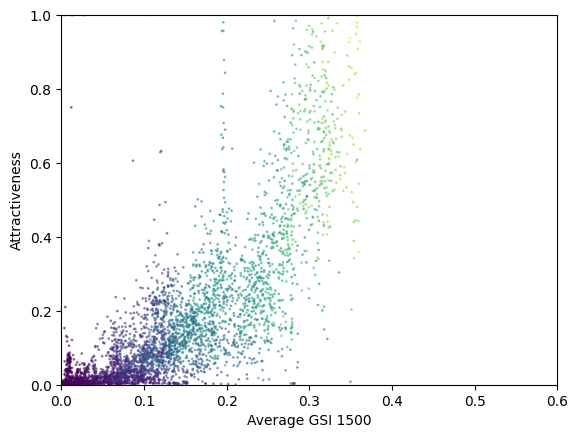

In [454]:
plt.scatter(flow_df_merged["avg_gsi"],flow_df_merged["flow"], s=1,alpha=0.5,c=flow_df_merged["avg_fsi"])
plt.xlim(0, 0.6) 
plt.ylim(0, 1) 

plt.xlabel('Average GSI 1500')
plt.ylabel('Attractiveness')

Text(0, 0.5, 'Attractiveness')

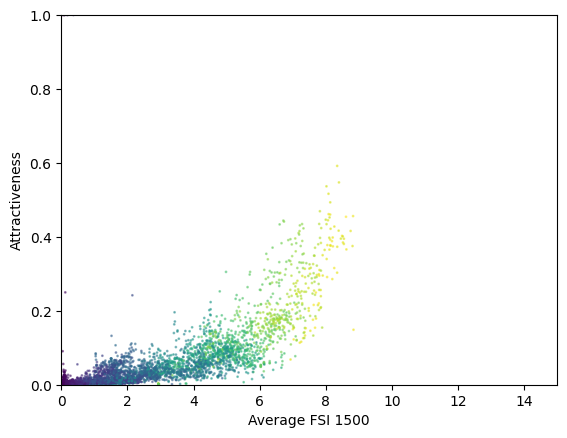

In [494]:
plt.scatter(flow_df_merged["avg_fsi"],flow_df_merged["flow1"], s=1,alpha=0.5,c=flow_df_merged["avg_gsi"])
plt.xlim(0, 15) 
plt.ylim(0,1) 

plt.xlabel('Average FSI 1500')
plt.ylabel('Attractiveness')

Text(0, 0.5, 'Attractiveness')

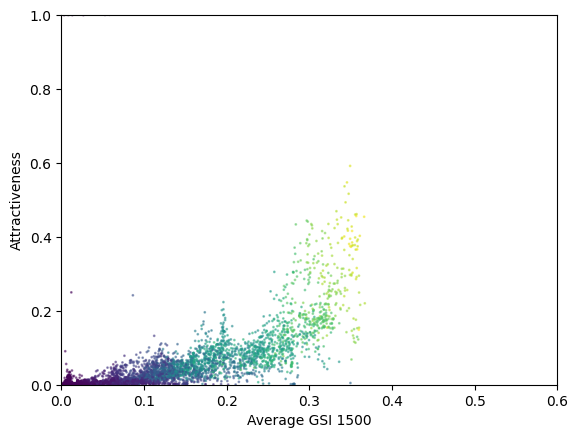

In [495]:
plt.scatter(flow_df_merged["avg_gsi"],flow_df_merged["flow1"], s=1,alpha=0.5,c=flow_df_merged["avg_fsi"])
plt.xlim(0, 0.6) 
plt.ylim(0, 1) 

plt.xlabel('Average GSI 1500')
plt.ylabel('Attractiveness')

Text(0, 0.5, 'Attractiveness')

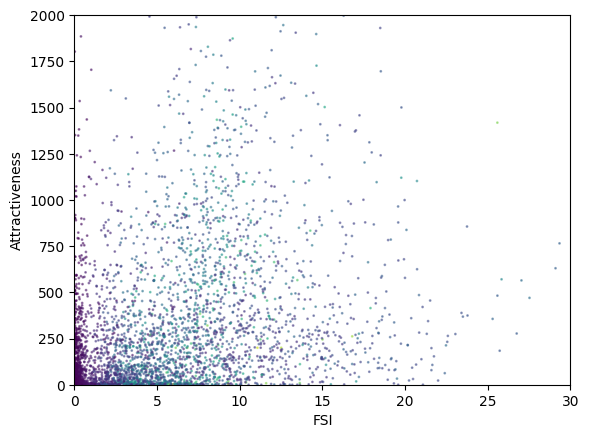

In [323]:
flow_df_merged = pd.merge(atn_df_list[city_id][year_id],block_gdf_joined_poi_list[city_id][year_id],on="block_id")
flow_df_merged =  flow_df_merged[flow_df_merged["area"]<500000]
flow_df_merged =  flow_df_merged[flow_df_merged["area"]>10000]

plt.scatter(flow_df_merged["FSI"],flow_df_merged["flow"], s=1,alpha=0.5,c=flow_df_merged["GSI"])
plt.xlim(0, 30) 
plt.ylim(0, 2000) 

plt.xlabel('FSI')
plt.ylabel('Attractiveness')

Text(0, 0.5, 'Attractiveness')

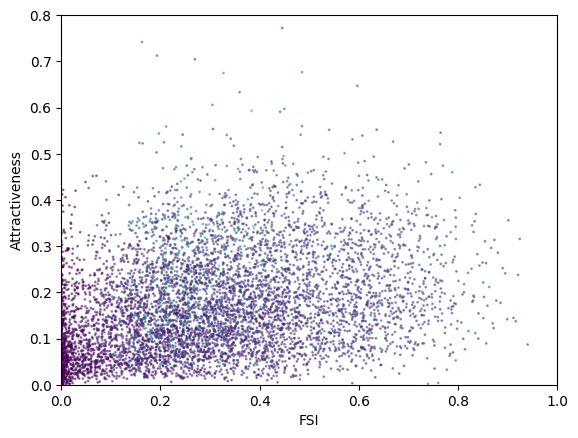

In [188]:
i = 4
flow_df_merged = pd.merge(atn_df_list[0][i],block_gdf_joined_poi_list[0][i],on="block_id")
flow_df_merged =  flow_df_merged[flow_df_merged["area"]<500000]
flow_df_merged =  flow_df_merged[flow_df_merged["area"]>10000]

plt.scatter(flow_df_merged["GSI"],flow_df_merged["flow"], s=1,alpha=0.5,c=flow_df_merged["FSI"])
plt.xlim(0, 1) 
plt.ylim(0, 0.8) 

plt.xlabel('FSI')
plt.ylabel('Attractiveness')

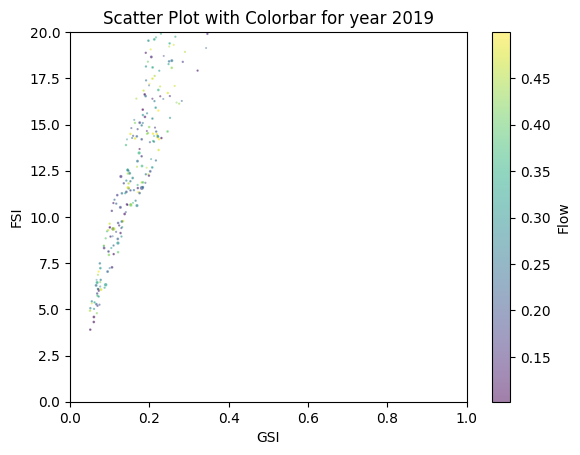

In [168]:
i = 1
block_cluster = 4

flow_df_merged = pd.merge(atn_df_list[0][i],block_gdf_joined_poi_list[0][i],on="block_id")
flow_df_merged =  flow_df_merged[flow_df_merged["area"]<500000]
flow_df_merged =  flow_df_merged[flow_df_merged["area"]>10000]

flow_df_merged_s10 = flow_df_merged[(flow_df_merged["flow"]<0.5) & (flow_df_merged["flow"]>0.1)]
max_area = flow_df_merged_s10["area"].max()
flow_df_merged_s10 = flow_df_merged_s10[flow_df_merged_s10["cluster"] == block_cluster]

scatter = plt.scatter(flow_df_merged_s10["GSI"],flow_df_merged_s10["FSI"], s=flow_df_merged_s10["area"]/80000,alpha=0.5,c=flow_df_merged_s10["flow"])
plt.xlim(0, 1) 
plt.ylim(0, 20) 

# Add colorbar
cbar = plt.colorbar(scatter)
cbar.set_label('Flow')

# Add labels and title
plt.xlabel('GSI')
plt.ylabel('FSI')
plt.title(f'Scatter Plot with Colorbar for year {joined_year_list[0][i]}')

plt.show()

In [40]:
columns_to_sum = poi_column_list.copy()
columns_to_sum.append("area")

lam = 2
gam = 1

for index,row in tqdm(block_accessibility_df.iterrows(), total=len(block_accessibility_df)):
    block_id = row["block_id"]
    v_o = block_gdf.loc[block_gdf["block_id"] == block_id, "area"].item() * block_gdf.loc[block_gdf["block_id"] == block_id, "GSI"].item()    
    row["accessible_blocks"] = ast.literal_eval(row["accessible_blocks"])
    
    for accessible_block_id, access_distance in row["accessible_blocks"].items():
        v_d = block_gdf.loc[block_gdf["block_id"] == accessible_block_id, "area"].item() * block_gdf.loc[block_gdf["block_id"] == accessible_block_id, "GSI"].item()
        c_od = math.pow((v_d*v_o),lam) * math.pow((access_distance),(gam*(1-lam)))
        print(accessible_block_id)
        print(c_od)
        print(v_d*v_o)
        print(math.pow((v_d*v_o),lam))
        print(math.pow((access_distance),(gam*(1-lam))))

  0%|▏                                                                                                                                                                      | 10/7831 [00:00<01:21, 95.81it/s]

17232
650724863.0638843
650724863.0638843
650724863.0638843
1.0
20
70352210.28760973
70352210.28760973
70352210.28760973
1.0
7
10046836.042886667
10046836.042886667
10046836.042886667
1.0
19
20958153.65865182
20958153.65865182
20958153.65865182
1.0
3
22088825.372217968
22088825.372217968
22088825.372217968
1.0
4
85832542.93149614
85832542.93149614
85832542.93149614
1.0
2
475119.5974075551
475119.5974075551
475119.5974075551
1.0
84
42928528.94130556
42928528.94130556
42928528.94130556
1.0
3
1026933447.886824
1026933447.886824
1026933447.886824
1.0
4
3990448010.1688857
3990448010.1688857
3990448010.1688857
1.0
17232
30252904624.45157
30252904624.45157
30252904624.45157
1.0
20
3270750556.4321246
3270750556.4321246
3270750556.4321246
1.0
7
467088303.88291633
467088303.88291633
467088303.88291633
1.0
11
828293718.2843088
828293718.2843088
828293718.2843088
1.0
2
22088825.372217968
22088825.372217968
22088825.372217968
1.0
19
974367293.6584067
974367293.6584067
974367293.6584067
1.0
481
9804

  0%|▌                                                                                                                                                                      | 29/7831 [00:00<01:30, 86.21it/s]

59
2815158.6436696863
2815158.6436696863
2815158.6436696863
1.0
163
16932991.933506608
16932991.933506608
16932991.933506608
1.0
162
16671779.470805263
16671779.470805263
16671779.470805263
1.0
108
8700.073386649883
8700.073386649883
8700.073386649883
1.0
170
14983606.993160663
14983606.993160663
14983606.993160663
1.0
187
24603373.547825076
24603373.547825076
24603373.547825076
1.0
17
6986083.785860283
6986083.785860283
6986083.785860283
1.0
166
24557138.234041385
24557138.234041385
24557138.234041385
1.0
151
13610491.401515827
13610491.401515827
13610491.401515827
1.0
72
230997.94601323712
230997.94601323712
230997.94601323712
1.0
38
1597455.762073676
1597455.762073676
1597455.762073676
1.0
63
2024393.934684379
2024393.934684379
2024393.934684379
1.0
67
1193774.3658092418
1193774.3658092418
1193774.3658092418
1.0
68
1193817.3473721615
1193817.3473721615
1193817.3473721615
1.0
139
7945708.7333020745
7945708.7333020745
7945708.7333020745
1.0
185
16409332.800355868
16409332.800355868
16

  1%|█                                                                                                                                                                      | 47/7831 [00:00<01:42, 75.84it/s]

92
31045375.069293756
31045375.069293756
31045375.069293756
1.0
8
254100.43701531115
254100.43701531115
254100.43701531115
1.0
12
0.0
0.0
0.0
1.0
30
25632945.654206112
25632945.654206112
25632945.654206112
1.0
45
7070065.165782003
7070065.165782003
7070065.165782003
1.0
22
94893130.19304106
94893130.19304106
94893130.19304106
1.0
13
0.0
0.0
0.0
1.0
18
17434057.4400767
17434057.4400767
17434057.4400767
1.0
41
21331951.56340601
21331951.56340601
21331951.56340601
1.0
60
8130795.2681303825
8130795.2681303825
8130795.2681303825
1.0
69
24270670.594161116
24270670.594161116
24270670.594161116
1.0
55
7518265.732910167
7518265.732910167
7518265.732910167
1.0
135
30711911.78668429
30711911.78668429
30711911.78668429
1.0
103
33886980.53324144
33886980.53324144
33886980.53324144
1.0
37
2950335.5870469837
2950335.5870469837
2950335.5870469837
1.0
185
41187400.31979719
41187400.31979719
41187400.31979719
1.0
151
34162312.674360074
34162312.674360074
34162312.674360074
1.0
154
158128795.78615278
158

  1%|█▏                                                                                                                                                                     | 55/7831 [00:00<01:58, 65.52it/s]

138
153055414.03898817
153055414.03898817
153055414.03898817
1.0
144
79228290.20782532
79228290.20782532
79228290.20782532
1.0
8
820293.9645555475
820293.9645555475
820293.9645555475
1.0
93
165867369.71572563
165867369.71572563
165867369.71572563
1.0
110
203271274.15091765
203271274.15091765
203271274.15091765
1.0
66
76738409.37111928
76738409.37111928
76738409.37111928
1.0
38
12943937.347744592
12943937.347744592
12943937.347744592
1.0
63
16403351.429083407
16403351.429083407
16403351.429083407
1.0
218
58465572.84191678
58465572.84191678
58465572.84191678
1.0
67
9672969.333635725
9672969.333635725
9672969.333635725
1.0
68
9673317.606602496
9673317.606602496
9673317.606602496
1.0
22
306336592.29183066
306336592.29183066
306336592.29183066
1.0
268
163305602.34702766
163305602.34702766
163305602.34702766
1.0
223
43283020.75297755
43283020.75297755
43283020.75297755
1.0
145
201922798.60706887
201922798.60706887
201922798.60706887
1.0
228
201749756.22144565
201749756.22144565
201749756.221

  1%|█▎                                                                                                                                                                     | 62/7831 [00:00<02:15, 57.35it/s]

108
148309.64044265056
148309.64044265056
148309.64044265056
1.0
218
123001133.39886315
123001133.39886315
123001133.39886315
1.0
111
99171594.94356172
99171594.94356172
99171594.94356172
1.0
256
650917433.4752927
650917433.4752927
650917433.4752927
1.0
323
411777002.8397444
411777002.8397444
411777002.8397444
1.0
223
91059752.78712778
91059752.78712778
91059752.78712778
1.0
93
348955350.59729093
348955350.59729093
348955350.59729093
1.0
110
427646491.64727485
427646491.64727485
427646491.64727485
1.0
66
161443921.0814745
161443921.0814745
161443921.0814745
1.0
131
51386708.74497721
51386708.74497721
51386708.74497721
1.0
21
54159338.26295759
54159338.26295759
54159338.26295759
1.0
59
47989844.185951464
47989844.185951464
47989844.185951464
1.0
38
27231734.626484197
27231734.626484197
27231734.626484197
1.0
67
20350201.555138536
20350201.555138536
20350201.555138536
1.0
30
174089077.9189846
174089077.9189846
174089077.9189846
1.0
8
1725752.1385002362
1725752.1385002362
1725752.13850023

  1%|█▌                                                                                                                                                                     | 75/7831 [00:01<02:45, 47.00it/s]

201
203019169.91136304
203019169.91136304
203019169.91136304
1.0
160
300953679.7827067
300953679.7827067
300953679.7827067
1.0
78
531334347.18129027
531334347.18129027
531334347.18129027
1.0
76
136249407.69135448
136249407.69135448
136249407.69135448
1.0
89
112566326.2593488
112566326.2593488
112566326.2593488
1.0
192
102459860.52142864
102459860.52142864
102459860.52142864
1.0
83
62359555.861606695
62359555.861606695
62359555.861606695
1.0
28
13500797.25478235
13500797.25478235
13500797.25478235
1.0
175
135478024.38526115
135478024.38526115
135478024.38526115
1.0
101
153840379.26016557
153840379.26016557
153840379.26016557
1.0
217
210964104.44533002
210964104.44533002
210964104.44533002
1.0
90
44270429.741302796
44270429.741302796
44270429.741302796
1.0
143
263188659.0957897
263188659.0957897
263188659.0957897
1.0
170
169513789.43610594
169513789.43610594
169513789.43610594
1.0
24
403271.8122145221
403271.8122145221
403271.8122145221
1.0
62
946657.2591889525
946657.2591889525
946657.2

  1%|█▋                                                                                                                                                                     | 80/7831 [00:01<02:45, 46.74it/s]

151
224185476.50244913
224185476.50244913
224185476.50244913
1.0
18
114408603.18300676
114408603.18300676
114408603.18300676
1.0
154
1037698465.2647254
1037698465.2647254
1037698465.2647254
1.0
197
66562868.883809894
66562868.883809894
66562868.883809894
1.0
240
389292408.7999192
389292408.7999192
389292408.7999192
1.0
74
189481394.3740324
189481394.3740324
189481394.3740324
1.0
248
456787383.404263
456787383.404263
456787383.404263
1.0
201
295584772.62514234
295584772.62514234
295584772.62514234
1.0
170
246802776.9455144
246802776.9455144
246802776.9455144
1.0
62
1378281.0304734947
1378281.0304734947
1378281.0304734947
1.0
36
93772575.65340504
93772575.65340504
93772575.65340504
1.0
39
44248895.54100581
44248895.54100581
44248895.54100581
1.0
106
224683797.7123083
224683797.7123083
224683797.7123083
1.0
94
184834304.77698594
184834304.77698594
184834304.77698594
1.0
133
130656.71677117285
130656.71677117285
130656.71677117285
1.0
70
32055056.213594947
32055056.213594947
32055056.21359

  1%|█▉                                                                                                                                                                     | 90/7831 [00:01<03:06, 41.41it/s]

55
36213893.60813166
36213893.60813166
36213893.60813166
1.0
283
250272715.15548205
250272715.15548205
250272715.15548205
1.0
235
413086770.30731577
413086770.30731577
413086770.30731577
1.0
284
316306109.526175
316306109.526175
316306109.526175
1.0
127
215467003.23784047
215467003.23784047
215467003.23784047
1.0
163
204722091.05824587
204722091.05824587
204722091.05824587
1.0
162
201563998.15979737
201563998.15979737
201563998.15979737
1.0
121
237648694.10147658
237648694.10147658
237648694.10147658
1.0
256
461647453.94286466
461647453.94286466
461647453.94286466
1.0
323
292042884.6685781
292042884.6685781
292042884.6685781
1.0
187
297458009.75851613
297458009.75851613
297458009.75851613
1.0
215
105162069.25910582
105162069.25910582
105162069.25910582
1.0
481
4040819248.931511
4040819248.931511
4040819248.931511
1.0
339
344255776.7010027
344255776.7010027
344255776.7010027
1.0
285
70104678.71749206
70104678.71749206
70104678.71749206
1.0
242
46099434.05171422
46099434.05171422
4609943

  1%|██                                                                                                                                                                     | 95/7831 [00:01<03:06, 41.52it/s]

241
563440054.6191257
563440054.6191257
563440054.6191257
1.0
165
338397722.25981635
338397722.25981635
338397722.25981635
1.0
268
470936786.70981914
470936786.70981914
470936786.70981914
1.0
272
619191715.3947834
619191715.3947834
619191715.3947834
1.0
228
581801117.3463349
581801117.3463349
581801117.3463349
1.0
126
246409655.86122456
246409655.86122456
246409655.86122456
1.0
161
142576883.26415655
142576883.26415655
142576883.26415655
1.0
190
176766493.4360405
176766493.4360405
176766493.4360405
1.0
199
177195363.5160282
177195363.5160282
177195363.5160282
1.0
135
285912068.95569795
285912068.95569795
285912068.95569795
1.0
103
315470322.4669078
315470322.4669078
315470322.4669078
1.0
269
490221597.87130284
490221597.87130284
490221597.87130284
1.0
293
523232523.93892694
523232523.93892694
523232523.93892694
1.0
92
289016440.2404894
289016440.2404894
289016440.2404894
1.0
227
1219714852.8428767
1219714852.8428767
1219714852.8428767
1.0
210
335042231.1615916
335042231.1615916
3350422

  1%|██▏                                                                                                                                                                   | 106/7831 [00:01<02:55, 44.12it/s]

170
209328120.51067552
209328120.51067552
209328120.51067552
1.0
24
497989.7552087854
497989.7552087854
497989.7552087854
1.0
62
1169002.1531168893
1169002.1531168893
1169002.1531168893
1.0
36
79534101.1146964
79534101.1146964
79534101.1146964
1.0
310
492605563.92596126
492605563.92596126
492605563.92596126
1.0
260
154847121.2858929
154847121.2858929
154847121.2858929
1.0
39
37530121.2284042
37530121.2284042
37530121.2284042
1.0
106
190567698.08834648
190567698.08834648
190567698.08834648
1.0
94
156768971.98529288
156768971.98529288
156768971.98529288
1.0
133
110817.73589542406
110817.73589542406
110817.73589542406
1.0
70
27187800.53085555
27187800.53085555
27187800.53085555
1.0
121
274609543.0757164
274609543.0757164
274609543.0757164
1.0
64
4715504.464736049
4715504.464736049
4715504.464736049
1.0
127
248977994.72767916
248977994.72767916
248977994.72767916
1.0
48
101380604.76034427
101380604.76034427
101380604.76034427
1.0
59
39329106.00816899
39329106.00816899
39329106.00816899
1.0

  1%|██▍                                                                                                                                                                   | 116/7831 [00:02<03:09, 40.69it/s]

161
61229323.62254818
61229323.62254818
61229323.62254818
1.0
190
75911975.2405144
75911975.2405144
75911975.2405144
1.0
199
76096152.53713086
76096152.53713086
76096152.53713086
1.0
269
210524568.7494321
210524568.7494321
210524568.7494321
1.0
339
285732518.2076331
285732518.2076331
285732518.2076331
1.0
241
241968071.2353855
241968071.2353855
241968071.2353855
1.0
285
58186928.85866604
58186928.85866604
58186928.85866604
1.0
126
105820075.57630908
105820075.57630908
105820075.57630908
1.0
66
95035238.82855292
95035238.82855292
95035238.82855292
1.0
55
30057555.21058952
30057555.21058952
30057555.21058952
1.0
165
145324144.94565117
145324144.94565117
145324144.94565117
1.0
176
16375749.484668083
16375749.484668083
16375749.484668083
1.0
293
30620806.675588433
30620806.675588433
30620806.675588433
1.0
300
11877523.112405347
11877523.112405347
11877523.112405347
1.0
150
38132110.310929246
38132110.310929246
38132110.310929246
1.0
138
25830459.07061584
25830459.07061584
25830459.07061584

  2%|██▌                                                                                                                                                                   | 121/7831 [00:02<03:14, 39.68it/s]

39
9096961.855513413
9096961.855513413
9096961.855513413
1.0
138
66215245.78527489
66215245.78527489
66215245.78527489
1.0
145
87356385.42006597
87356385.42006597
87356385.42006597
1.0
80
187674659.25950605
187674659.25950605
187674659.25950605
1.0
85
71312240.78710245
71312240.78710245
71312240.78710245
1.0
116
61462253.05760643
61462253.05760643
61462253.05760643
1.0
107
22101765.168206234
22101765.168206234
22101765.168206234
1.0
136
68989595.39115408
68989595.39115408
68989595.39115408
1.0
178
261676266.51934075
261676266.51934075
261676266.51934075
1.0
139
27853482.46859114
27853482.46859114
27853482.46859114
1.0
115
64497096.32893794
64497096.32893794
64497096.32893794
1.0
17232
3615165364.6997666
3615165364.6997666
3615165364.6997666
1.0
166
86084431.51381208
86084431.51381208
86084431.51381208
1.0
269
73542807.96116318
73542807.96116318
73542807.96116318
1.0
293
78495091.1876741
78495091.1876741
78495091.1876741
1.0
278
30567019.166036505
30567019.166036505
30567019.166036505
1

  2%|██▊                                                                                                                                                                   | 133/7831 [00:02<02:56, 43.70it/s]

78
3418300.7522157747
3418300.7522157747
3418300.7522157747
1.0
276
888596.7696772908
888596.7696772908
888596.7696772908
1.0
209
6321.684736021973
6321.684736021973
6321.684736021973
1.0
297
237402.97453210602
237402.97453210602
237402.97453210602
1.0
298
879866.928162969
879866.928162969
879866.928162969
1.0
147
1230.511533145913
1230.511533145913
1230.511533145913
1.0
368
1009385.4325797589
1009385.4325797589
1009385.4325797589
1.0
202
442822.8909007134
442822.8909007134
442822.8909007134
1.0
176
118774.38356125075
118774.38356125075
118774.38356125075
1.0
361
633311.4325947948
633311.4325947948
633311.4325947948
1.0
296
903983.5366836841
903983.5366836841
903983.5366836841
1.0
271
414848.5539638373
414848.5539638373
414848.5539638373
1.0
126
767519.9389651527
767519.9389651527
767519.9389651527
1.0
474
1092696.5373039888
1092696.5373039888
1092696.5373039888
1.0
200
264744.84680170217
264744.84680170217
264744.84680170217
1.0
161
444100.2945208338
444100.2945208338
444100.294520833

  2%|██▉                                                                                                                                                                   | 140/7831 [00:02<02:43, 47.16it/s]

278
39031520.78769193
39031520.78769193
39031520.78769193
1.0
310
157832834.78136835
157832834.78136835
157832834.78136835
1.0
248
124133693.0714662
124133693.0714662
124133693.0714662
1.0
187
110129560.26761805
110129560.26761805
110129560.26761805
1.0
215
38934747.30682233
38934747.30682233
38934747.30682233
1.0
260
49613650.14943309
49613650.14943309
49613650.14943309
1.0
235
152939449.85125005
152939449.85125005
152939449.85125005
1.0
268
90213756.36509126
90213756.36509126
90213756.36509126
1.0
272
118613818.52577038
118613818.52577038
118613818.52577038
1.0
228
111451187.79085977
111451187.79085977
111451187.79085977
1.0
256
170918346.2320183
170918346.2320183
170918346.2320183
1.0
323
108124687.89778955
108124687.89778955
108124687.89778955
1.0
347
135056429.95237413
135056429.95237413
135056429.95237413
1.0
92
55364667.74558267
55364667.74558267
55364667.74558267
1.0
325
49527325.76148909
49527325.76148909
49527325.76148909
1.0
336
100985872.25650848
100985872.25650848
10098587

  2%|███▏                                                                                                                                                                  | 150/7831 [00:03<03:13, 39.79it/s]

509
1721435.7508109827
1721435.7508109827
1721435.7508109827
1.0
297
222945534.95369256
222945534.95369256
222945534.95369256
1.0
136
1345179990.3871827
1345179990.3871827
1345179990.3871827
1.0
103
922790419.3580542
922790419.3580542
922790419.3580542
1.0
151
930288103.0692477
930288103.0692477
930288103.0692477
1.0
133
542177.803373371
542177.803373371
542177.803373371
1.0
166
1678500273.8410563
1678500273.8410563
1678500273.8410563
1.0
481
22844522168.743046
22844522168.743046
22844522168.743046
1.0
201
1226569185.9775515
1226569185.9775515
1226569185.9775515
1.0
500
2814150121.054108
2814150121.054108
2814150121.054108
1.0
170
1024141665.1018293
1024141665.1018293
1024141665.1018293
1.0
80
1532845198.6481555
1532845198.6481555
1532845198.6481555
1.0
85
582447445.6309123
582447445.6309123
582447445.6309123
1.0
116
501997019.03909504
501997019.03909504
501997019.03909504
1.0
107
180517629.56920332
180517629.56920332
180517629.56920332
1.0
136
563477085.6612226
563477085.6612226
56347

  2%|███▍                                                                                                                                                                  | 161/7831 [00:03<02:50, 45.03it/s]

503
93837211.63781478
93837211.63781478
93837211.63781478
1.0
368
261158242.43822634
261158242.43822634
261158242.43822634
1.0
471
23470516.837229483
23470516.837229483
23470516.837229483
1.0
530
172950701.08549213
172950701.08549213
172950701.08549213
1.0
275
12010138.733582636
12010138.733582636
12010138.733582636
1.0
366
100262178.78029068
100262178.78029068
100262178.78029068
1.0
17232
19420439310.035
19420439310.035
19420439310.035
1.0
150
525106741.2585384
525106741.2585384
525106741.2585384
1.0
78
884416782.4894764
884416782.4894764
884416782.4894764
1.0
126
198580395.3838966
198580395.3838966
198580395.3838966
1.0
91
104914212.44669768
104914212.44669768
104914212.44669768
1.0
390
679810210.2322115
679810210.2322115
679810210.2322115
1.0
462
163649952.5411829
163649952.5411829
163649952.5411829
1.0
513
82622582.4591851
82622582.4591851
82622582.4591851
1.0
145
469272968.2464495
469272968.2464495
469272968.2464495
1.0
272
499003723.0147293
499003723.0147293
499003723.0147293
1.0

  2%|███▌                                                                                                                                                                  | 166/7831 [00:03<03:17, 38.87it/s]

111
98250234.9362922
98250234.9362922
98250234.9362922
1.0
223
90213756.36509126
90213756.36509126
90213756.36509126
1.0
110
423673414.73067236
423673414.73067236
423673414.73067236
1.0
101
229654229.62282622
229654229.62282622
229654229.62282622
1.0
342
295948629.3923578
295948629.3923578
295948629.3923578
1.0
93
345713358.7290949
345713358.7290949
345713358.7290949
1.0
485
80551878.21529266
80551878.21529266
80551878.21529266
1.0
541
251740583.2946935
251740583.2946935
251740583.2946935
1.0
542
260541776.98887134
260541776.98887134
260541776.98887134
1.0
458
135015506.5136097
135015506.5136097
135015506.5136097
1.0
142
278551113.3508202
278551113.3508202
278551113.3508202
1.0
166
414734840.5351096
414734840.5351096
414734840.5351096
1.0
151
229861677.17162317
229861677.17162317
229861677.17162317
1.0
115
310732062.5875054
310732062.5875054
310732062.5875054
1.0
201
303068747.54781824
303068747.54781824
303068747.54781824
1.0
76
203394277.30484334
203394277.30484334
203394277.30484334

  2%|███▋                                                                                                                                                                  | 176/7831 [00:03<03:09, 40.37it/s]

364
32099104.8211134
32099104.8211134
32099104.8211134
1.0
318
17982681.55901902
17982681.55901902
17982681.55901902
1.0
319
4730886.968186828
4730886.968186828
4730886.968186828
1.0
474
153593014.1775597
153593014.1775597
153593014.1775597
1.0
739
976127.4564591073
976127.4564591073
976127.4564591073
1.0
266
282686860.94186014
282686860.94186014
282686860.94186014
1.0
503
50980053.42461291
50980053.42461291
50980053.42461291
1.0
396
341978168.2760322
341978168.2760322
341978168.2760322
1.0
390
369328544.94868004
369328544.94868004
369328544.94868004
1.0
332
429497829.610391
429497829.610391
429497829.610391
1.0
270
0.0
0.0
0.0
1.0
462
88908048.07463859
88908048.07463859
88908048.07463859
1.0
365
13013836.290359769
13013836.290359769
13013836.290359769
1.0
354
4992353.904610497
4992353.904610497
4992353.904610497
1.0
342
179277795.1970596
179277795.1970596
179277795.1970596
1.0
344
79288583.42868486
79288583.42868486
79288583.42868486
1.0
397
234804602.07095236
234804602.07095236
23480

  2%|███▊                                                                                                                                                                  | 181/7831 [00:03<03:19, 38.42it/s]

218
35059675.088076286
35059675.088076286
35059675.088076286
1.0
223
25955251.452559024
25955251.452559024
25955251.452559024
1.0
200
17674279.411271643
17674279.411271643
17674279.411271643
1.0
142
80141482.63765733
80141482.63765733
80141482.63765733
1.0
250
0.0
0.0
0.0
1.0
276
59322429.80726775
59322429.80726775
59322429.80726775
1.0
458
38845089.29406905
38845089.29406905
38845089.29406905
1.0
485
23175448.38275749
23175448.38275749
23175448.38275749
1.0
538
81086103.44002873
81086103.44002873
81086103.44002873
1.0
542
74960046.09624562
74960046.09624562
74960046.09624562
1.0
541
72427869.1354439
72427869.1354439
72427869.1354439
1.0
501
522140.2767768184
522140.2767768184
522140.2767768184
1.0
397
111519010.99210322
111519010.99210322
111519010.99210322
1.0
344
37657628.210625544
37657628.210625544
37657628.210625544
1.0
473
94335648.21765377
94335648.21765377
94335648.21765377
1.0
493
112647385.88415714
112647385.88415714
112647385.88415714
1.0
578
47067379.11666112
47067379.1166

  2%|████                                                                                                                                                                  | 192/7831 [00:04<02:57, 43.01it/s]

368
5373965.505865428
5373965.505865428
5373965.505865428
1.0
719
3775930.044882792
3775930.044882792
3775930.044882792
1.0
369
10032975.870044392
10032975.870044392
10032975.870044392
1.0
668
236857.34126675705
236857.34126675705
236857.34126675705
1.0
365
492914.1487786336
492914.1487786336
492914.1487786336
1.0
354
189091.19650718628
189091.19650718628
189091.19650718628
1.0
275
247137.79152575656
247137.79152575656
247137.79152575656
1.0
530
3558880.9802490612
3558880.9802490612
3558880.9802490612
1.0
450
461571.13421406253
461571.13421406253
461571.13421406253
1.0
356
2415284.766496171
2415284.766496171
2415284.766496171
1.0
513
1700160.423794427
1700160.423794427
1700160.423794427
1.0
17240
903173.811910506
903173.811910506
903173.811910506
1.0
209
33656.633644406844
33656.633644406844
33656.633644406844
1.0
344
3003147.091804506
3003147.091804506
3003147.091804506
1.0
471
482962.9220603265
482962.9220603265
482962.9220603265
1.0
406
163778.89328114886
163778.89328114886
163778.8

  3%|████▎                                                                                                                                                                 | 202/7831 [00:04<03:06, 40.97it/s]

231
401611370.1411035
401611370.1411035
401611370.1411035
1.0
283
493926094.45064294
493926094.45064294
493926094.45064294
1.0
284
624246399.5009677
624246399.5009677
624246399.5009677
1.0
339
679406507.3068928
679406507.3068928
679406507.3068928
1.0
384
983867726.6097884
983867726.6097884
983867726.6097884
1.0
381
742804301.7713951
742804301.7713951
742804301.7713951
1.0
468
383683140.4076081
383683140.4076081
383683140.4076081
1.0
387
286520.1283424518
286520.1283424518
286520.1283424518
1.0
358
175601600.1406234
175601600.1406234
175601600.1406234
1.0
282
389069409.26252747
389069409.26252747
389069409.26252747
1.0
376
668757407.3450043
668757407.3450043
668757407.3450043
1.0
501
2564020.1170172417
2564020.1170172417
2564020.1170172417
1.0
385
160669386.40949526
160669386.40949526
160669386.40949526
1.0
516
121786245.5206165
121786245.5206165
121786245.5206165
1.0
340
111776970.17562969
111776970.17562969
111776970.17562969
1.0
611
617603111.8491106
617603111.8491106
617603111.84911

  3%|████▍                                                                                                                                                                 | 210/7831 [00:04<02:41, 47.10it/s]

327
2452047.007920568
2452047.007920568
2452047.007920568
1.0
463
276612.1406039088
276612.1406039088
276612.1406039088
1.0
565
77492661.01783396
77492661.01783396
77492661.01783396
1.0
352
31543.619468600213
31543.619468600213
31543.619468600213
1.0
639
946327.1118960489
946327.1118960489
946327.1118960489
1.0
559
286283.9577189073
286283.9577189073
286283.9577189073
1.0
254
2113.026908394961
2113.026908394961
2113.026908394961
1.0
249
4123412.9281584644
4123412.9281584644
4123412.9281584644
1.0
454
4177.78551561174
4177.78551561174
4177.78551561174
1.0
570
2093.962860028854
2093.962860028854
2093.962860028854
1.0
257
2808300.848426764
2808300.848426764
2808300.848426764
1.0
274
266226.55933572806
266226.55933572806
266226.55933572806
1.0
517
2596.266226388459
2596.266226388459
2596.266226388459
1.0
326
26423864.632147502
26423864.632147502
26423864.632147502
1.0
351
247575.0724733627
247575.0724733627
247575.0724733627
1.0
214
3959072.8412180566
3959072.8412180566
3959072.8412180566


  3%|████▌                                                                                                                                                                 | 217/7831 [00:04<02:31, 50.31it/s]

460
209865859.14240697
209865859.14240697
209865859.14240697
1.0
508
190450396.34841678
190450396.34841678
190450396.34841678
1.0
475
174212541.53362828
174212541.53362828
174212541.53362828
1.0
483
119861922.26037548
119861922.26037548
119861922.26037548
1.0
489
104242479.59484242
104242479.59484242
104242479.59484242
1.0
495
123468245.682433
123468245.682433
123468245.682433
1.0
427
452563380.0563795
452563380.0563795
452563380.0563795
1.0
581
239452.6664120699
239452.6664120699
239452.6664120699
1.0
490
95199397.60374622
95199397.60374622
95199397.60374622
1.0
453
310197595.56511563
310197595.56511563
310197595.56511563
1.0
482
204875870.40992528
204875870.40992528
204875870.40992528
1.0
762
46725879.38432603
46725879.38432603
46725879.38432603
1.0
597
5740062.0489283735
5740062.0489283735
5740062.0489283735
1.0
853
139225902.80013934
139225902.80013934
139225902.80013934
1.0
687
10727816.933760911
10727816.933760911
10727816.933760911
1.0
1089
469491283.28155726
469491283.28155726


  3%|████▋                                                                                                                                                                 | 223/7831 [00:04<03:05, 41.02it/s]

577
73202426.00936362
73202426.00936362
73202426.00936362
1.0
578
54658496.59387511
54658496.59387511
54658496.59387511
1.0
250
0.0
0.0
0.0
1.0
276
68890065.44265291
68890065.44265291
68890065.44265291
1.0
606
36006409.03821437
36006409.03821437
36006409.03821437
1.0
620
369952035.46388537
369952035.46388537
369952035.46388537
1.0
659
44972534.16156715
44972534.16156715
44972534.16156715
1.0
765
90540.80310711075
90540.80310711075
90540.80310711075
1.0
761
173357224.75348344
173357224.75348344
173357224.75348344
1.0
576
51155872.81159033
51155872.81159033
51155872.81159033
1.0
527
53913867.580214925
53913867.580214925
53913867.580214925
1.0
647
141198192.00072107
141198192.00072107
141198192.00072107
1.0
551
209494559.85843334
209494559.85843334
209494559.85843334
1.0
593
73935208.09431608
73935208.09431608
73935208.09431608
1.0
624
64391752.39973138
64391752.39973138
64391752.39973138
1.0
664
77419237.09065388
77419237.09065388
77419237.09065388
1.0
582
10438174.079740508
10438174.079

  3%|████▉                                                                                                                                                                 | 235/7831 [00:05<02:53, 43.76it/s]

269
403483946.6008197
403483946.6008197
403483946.6008197
1.0
293
430654064.7444303
430654064.7444303
430654064.7444303
1.0
278
167702347.39266866
167702347.39266866
167702347.39266866
1.0
300
167046664.1080083
167046664.1080083
167046664.1080083
1.0
242
73332670.32661138
73332670.32661138
73332670.32661138
1.0
390
694293106.294567
694293106.294567
694293106.294567
1.0
270
0.0
0.0
0.0
1.0
241
463747451.9643447
463747451.9643447
463747451.9643447
1.0
591
97964737.49364698
97964737.49364698
97964737.49364698
1.0
601
1348881.686349116
1348881.686349116
1348881.686349116
1.0
617
159639.3928029462
159639.3928029462
159639.3928029462
1.0
669
18709195.48565649
18709195.48565649
18709195.48565649
1.0
206
159299.89642469113
159299.89642469113
159299.89642469113
1.0
202
117012413.54232217
117012413.54232217
117012413.54232217
1.0
488
241388325.92349285
241388325.92349285
241388325.92349285
1.0
200
69956712.11609805
69956712.11609805
69956712.11609805
1.0
582
35577427.53461399
35577427.53461399
3

  3%|█████▏                                                                                                                                                                | 247/7831 [00:05<02:35, 48.92it/s]

463
62929577.194381915
62929577.194381915
62929577.194381915
1.0
454
950450.9655009138
950450.9655009138
950450.9655009138
1.0
532
298412293.55969703
298412293.55969703
298412293.55969703
1.0
545
187976980.5402028
187976980.5402028
187976980.5402028
1.0
498
578649093.8212276
578649093.8212276
578649093.8212276
1.0
455
61079820.10384357
61079820.10384357
61079820.10384357
1.0
639
215290496.32161146
215290496.32161146
215290496.32161146
1.0
559
65129926.60934045
65129926.60934045
65129926.60934045
1.0
257
638891643.1516273
638891643.1516273
638891643.1516273
1.0
604
27594861.50036306
27594861.50036306
27594861.50036306
1.0
565
17629668686.533936
17629668686.533936
17629668686.533936
1.0
254
480716.0295109905
480716.0295109905
480716.0295109905
1.0
249
938081139.8962641
938081139.8962641
938081139.8962641
1.0
352
7176209.37391146
7176209.37391146
7176209.37391146
1.0
274
60566845.62122091
60566845.62122091
60566845.62122091
1.0
517
590653.5250187439
590653.5250187439
590653.5250187439
1.0

  3%|█████▎                                                                                                                                                                | 252/7831 [00:05<02:41, 46.86it/s]


687
5119443.609604541
5119443.609604541
5119443.609604541
1.0
700
122902714.23792331
122902714.23792331
122902714.23792331
1.0
469
93854583.83947743
93854583.83947743
93854583.83947743
1.0
17230
867941291.9495087
867941291.9495087
867941291.9495087
1.0
515
39227198.02464341
39227198.02464341
39227198.02464341
1.0
414
217205565.985768
217205565.985768
217205565.985768
1.0
420
173371804.62480006
173371804.62480006
173371804.62480006
1.0
415
105139967.97495094
105139967.97495094
105139967.97495094
1.0
465
85795732.33175525
85795732.33175525
85795732.33175525
1.0
17264
40962439.72722575
40962439.72722575
40962439.72722575
1.0
555
75420748.33876419
75420748.33876419
75420748.33876419
1.0
546
32721915.60129449
32721915.60129449
32721915.60129449
1.0
491
87342316.05187261
87342316.05187261
87342316.05187261
1.0
504
4760582.414962506
4760582.414962506
4760582.414962506
1.0
520
88855075.96620443
88855075.96620443
88855075.96620443
1.0
431
115038517.46950032
115038517.46950032
115038517.46950032

KeyboardInterrupt: 

  0%|▏                                                                                     | 18/7831 [00:00<00:43, 178.66it/s]

0.0005765513430646136
1.2059814010437564e-05
0.0
1.0970043701589688e-05
2.079583809319323e-06
6.105765575464449e-06
2.2162290489176918e-05
2.1746778050818815e-05
5.32878939528094e-05
7.823270654830118e-05
0.0019199607617684526
4.2001754759698486e-05
0.0
9.96964004676368e-06
2.174271264721509e-06
3.505376371025614e-05
0.0017448320065337434
5.9466026187656884e-05
0.0
3.667423778020889e-05
3.8444453078214886e-05
2.1575503813464908e-05
0.000124964690873905
0.0
5.414501940235549e-05
0.0
0.0
0.0
2.2786790430679058e-05
0.0031847505320958445
6.434222085038082e-05
0.0
9.319522781038064e-05
0.00017161260748229293
5.925139037939622e-05
4.802441095338956e-06
1.4224238708315147e-05
0.00018569592158900323
1.0272683237130671e-05
3.6406975005593416e-05
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0

  1%|▌                                                                                     | 54/7831 [00:00<00:54, 143.45it/s]

0.00010019111275857368
0.00011376963807404625
0.00013093076480859628
8.60497506257394e-05
0.0
0.0
0.0
9.900520217210613e-05
3.9803763693131855e-06
2.9962519222354975e-06
3.083244736537582e-05
0.0
2.964240251450566e-05
0.000127584235850921
3.254010944412323e-05
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.13366000797816324
0.012865853358134706
0.012176366954217647
0.0026430339472580827
0.010203442781080561
0.002604077060259251
0.0
0.0010954993498819795
0.0004941919620363198
0.008777863330290401
0.0001150755227402315
0.0033523301748276434
0.04355960553042439
0.009859004381173594
0.06631817158773136
0.0026955929558568036
0.0072535755936094515
0.0
0.0
0.0007005974097618793
8.230115709839165e-05
0.0010344050856062985
0.0
0.0006515070733827939
0.022922967869164767
0.010437890649551175
0.0004999144913982561
0.24663822491249277
0.004247811460302401
0.009626004854086838
0.0
0.0017098574707437445
0.001582734835207058
0.02127669322079239
0.002725137482174783
0.0003184

  1%|▋                                                                                     | 59/7831 [00:00<00:55, 139.38it/s]

0.0001815760875394294
0.0
0.0
0.0
0.0024687047382385336
2.1887278564863114e-05
0.0034305834379210354
0.0
0.0064842375253879566
0.001845142879764522
0.1765188381588375
0.27364475047894904
0.16304975738761168
0.05643154558957539
0.09723390093308888
0.06644453894539452
0.019982318509765905
0.014926720124465751
0.05054099335694269
0.0009104358988461594
0.019577462263577643
0.010511185320568148
0.052825224984040214
0.016077477543294083
0.004075660151382957
0.01107138074755506
0.02121851276616199
0.002328787841729916
0.06823069273249661
0.005342023819251131
0.0019465448051941296
0.0010301504406087056
0.004724909737149722
0.011151099283902658
0.018354539950471302
0.12490610467409548
0.010681373456186695
0.007519182301100339
0.010827539609823928
0.0017525443818313011
0.07870776010713876
0.003901613512777837
0.006241345652438306
0.010947376338563727
0.0027080170892454314
0.007107793745797494
0.011351163081282265
0.00786094271232084
0.006800223923757917
0.02910507863204347
0.0008029295510777611


ZeroDivisionError: float division by zero

In [97]:
def multiply_columns_by_access_dist(df, columns):
    df['access_dist'] = df['access_dist']+1
    for col in columns:        
        transformed_dist = df['access_dist'] ** -2        
        df[col] = df[col] * transformed_dist
    return df

In [100]:
accessible_block_poi_list = []
block_gdf_joined_poi = block_gdf_joined_poi.to_crs('EPSG:3857')
block_gdf_og = block_gdf.copy()
block_gdf_og = block_gdf_og.to_crs('EPSG:3857')

for index,row in tqdm(block_accessibility_df.iterrows(), total=len(block_accessibility_df)):
    accessible_blocks = ast.literal_eval(row["accessible_blocks"])
    accessible_block_poi_df = block_gdf_joined_poi[block_gdf_joined_poi["block_id"].isin(accessible_blocks)]
    
    # caculate the distance between the target block and accessible blocks
    # Get the centroid of the target block
    target_block_centroid = block_gdf_og[block_gdf_og["block_id"] == row["block_id"]].geometry.centroid.iloc[0]
    
    accessible_block_poi_df['access_dist'] = accessible_block_poi_df.centroid.distance(target_block_centroid)
    accessible_block_poi_df = multiply_columns_by_access_dist(accessible_block_poi_df, poi_column_list)
    
    accessible_block_poi_list.append(list(accessible_block_poi_df[columns_to_sum].sum(axis=0)))
    

  0%|                                                                                                                                                                                | 0/7831 [00:00<?, ?it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  0%|▌                                                                                                                                                                     | 25/7831 [00:00<01:05, 119.07it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  1%|█                                                                                                                                            

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  1%|█▌                                                                                                                                           

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  1%|██▏                                                                                                                                          

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  2%|██▋                                                                                                                                          

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  2%|███▏                                                                                                                                         

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  4%|█████▊                                                                                                                                       

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  4%|██████▎                                                                                                                                                              | 300/7831 [00:02<01:03, 119.23it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  4%|██████▊                                                                                                                                                              | 325/7831 [00:02<01:02, 119.29it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  4%|███████▎                                                                                                                                                             | 350/7831 [00:02<01:02, 119.60it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  5%|███████▉                                                                                                                                                             | 375/7831 [00:03<01:02, 119.63it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  5%|████████▍                                                                                                                                                            | 400/7831 [00:03<01:02, 119.51it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  5%|████████▉                                                                                                                                    

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  7%|██████████▉                                                                                                                                  

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  7%|███████████▌                                                                                                                                 

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  7%|████████████                                                                                                                                                         | 571/7831 [00:04<01:01, 118.96it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  8%|████████████▌                                                                                                                                                        | 596/7831 [00:05<01:00, 119.11it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  8%|█████████████                                                                                                                                                        | 621/7831 [00:05<01:00, 119.41it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
  8%|█████████████▌                                                                                                                                                       | 646/7831 [00:05<01:00, 119.45it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

  9%|██████████████                                                                                                                                                       | 670/7831 [00:05<00:59, 119.63it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

  9%|██████████████▌                                                                                                                                                      | 694/7831 [00:05<01:00, 118.82it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

  9%|███████████████▏                                                                                                                                                     | 718/7831 [00:06<00:59, 119.07it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

  9%|███████████████▋                                                                                                                                                     | 742/7831 [00:06<00:59, 118.82it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

 10%|████████████████▏                                                                                                                                                    | 766/7831 [00:06<00:59, 118.38it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

 10%|████████████████▋                                                                                                                                                    | 790/7831 [00:06<00:59, 118.01it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

 10%|█████████████████▏                                                                                                                                                   | 814/7831 [00:06<00:59, 118.02it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

 11%|█████████████████▋                                                                                                                                                   | 838/7831 [00:07<00:59, 118.18it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
 11%|██████████████████▉                                                                                                                                                  | 900/7831 [00:07<00:58, 118.92it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
 12%|███████████████████▊                                                                                                                                                 | 939/7831 [00:07<00:57, 120.16it/s]/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retur

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is tryin

KeyboardInterrupt: 

In [26]:
accessible_block_poi_list = np.array(accessible_block_poi_list)
accessible_block_poi_list.shape

(7831, 12)

In [27]:
for i in range(len(poi_column_list)-1):
    block_accessibility_df[poi_column_list[i]] = accessible_block_poi_list[:,i]
block_accessibility_df["accessible_area"] = accessible_block_poi_list[:,-1]

In [28]:
column_to_join = poi_column_list.copy()
column_to_join.append("block_id")
column_to_join.append("accessible_area")
block_gdf_joined_accessible_poi = pd.merge(block_gdf,block_accessibility_df[column_to_join],on = "block_id",how="left" )
block_gdf_joined_accessible_poi= block_gdf_joined_accessible_poi.fillna(0)

KeyError: "['poi_count_10'] not in index"

In [170]:
# calculate acceesible poi density by deviding the accessible area

In [255]:
for poi_column in poi_column_list:
    block_gdf_joined_accessible_poi[f"{poi_column}_density"] = block_gdf_joined_accessible_poi[f"{poi_column}"]/block_gdf_joined_accessible_poi["accessible_area"]*1000000

In [256]:
block_gdf_joined_accessible_poi.head()

,block_id,area,FSI,GSI,cluster_2018,geometry,cluster_2022,poi_count_-1,poi_count_1,poi_count_2,...,poi_count_1_density,poi_count_2_density,poi_count_3_density,poi_count_4_density,poi_count_5_density,poi_count_6_density,poi_count_7_density,poi_count_8_density,poi_count_9_density,poi_count_10_density
0,13652,61018.959259,3.071522,0.390326,6,"POLYGON ((113.83764 22.72095, 113.83733 22.720...",0,0.0,565.0,44.0,...,394.873775,30.751232,185.905175,536.049886,32.847907,57.309114,43.331281,35.643473,18.870074,113.919337
1,7266,96456.238439,5.738073,0.584851,6,"POLYGON ((114.11162 22.60042, 114.11176 22.600...",6,93.0,1517.0,139.0,...,433.850814,39.752975,203.626750,478.751656,34.033123,145.856239,42.326909,24.309373,30.029226,205.056713
2,4153,19271.643437,6.112808,0.522914,6,"POLYGON ((113.89609 22.55703, 113.89572 22.556...",6,0.0,767.0,24.0,...,702.112992,21.969637,221.527176,537.340712,46.685479,331.375363,54.924093,26.546645,72.316723,352.429598
3,11350,85875.704733,4.502390,0.518459,6,"POLYGON ((114.15124 22.67771, 114.15096 22.677...",6,0.0,532.0,20.0,...,118.955641,4.472017,27.950104,80.719899,5.366420,44.720166,7.155227,1.118004,4.919218,53.664199
4,11352,76372.925599,9.081217,0.510905,6,"POLYGON ((113.92524 22.67676, 113.92524 22.676...",6,92.0,1228.0,123.0,...,92.916052,9.306738,53.873150,107.216649,8.020441,24.817968,7.566454,4.539872,6.355821,86.711559


### visualization

In [262]:
plot_df = block_gdf_joined_accessible_poi[block_gdf_joined_accessible_poi["cluster_2018"]!=block_gdf_joined_accessible_poi["cluster_2022"]]

In [257]:
colors = ['#D3D3D3','#68B3D4','#F0C808', '#D9598C', '#7ACB77', "#FF6F61", "#926AA6", "#F29844"]

cluster_labels = block_gdf_joined_accessible_poi['cluster_2022'].unique()
cluster_labels.sort()  # Sort the labels if necessary
palette = {cluster: color for cluster, color in zip(cluster_labels, colors)}

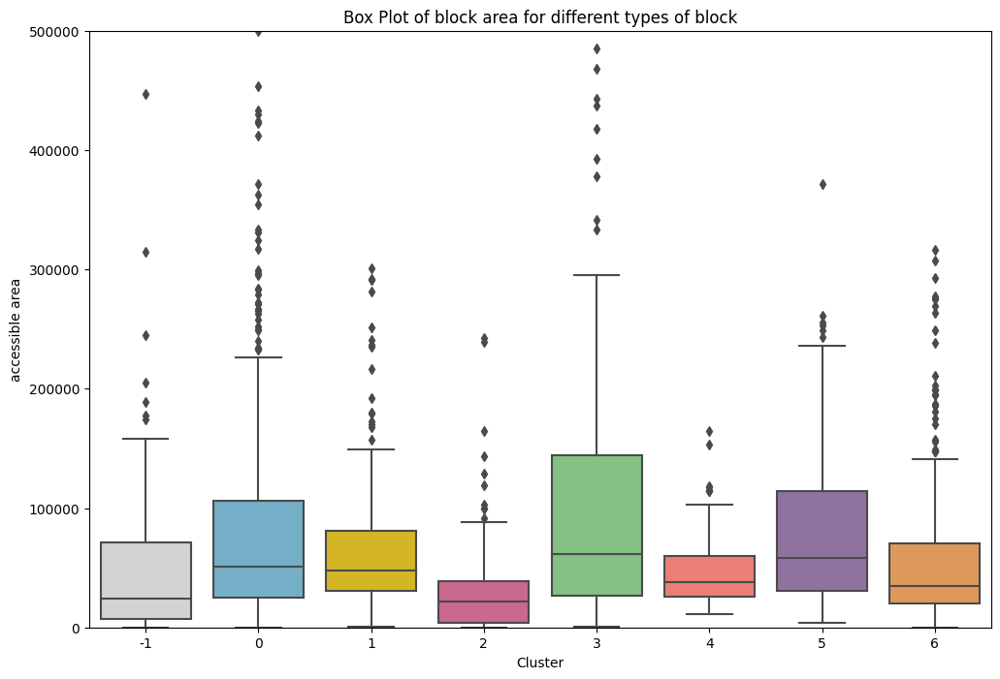

In [263]:
# Create the box plot
plt.figure(figsize=(12, 8))  # Set the figure size for better visibility
sns.boxplot(x='cluster_2022', y='area', data=plot_df,palette=palette)

# Adding titles and labels
plt.ylim(top=500000,bottom = 0) 

plt.title(f'Box Plot of block area for different types of block')
plt.xlabel('Cluster')
plt.ylabel('accessible area')

# Show the plot
plt.show()


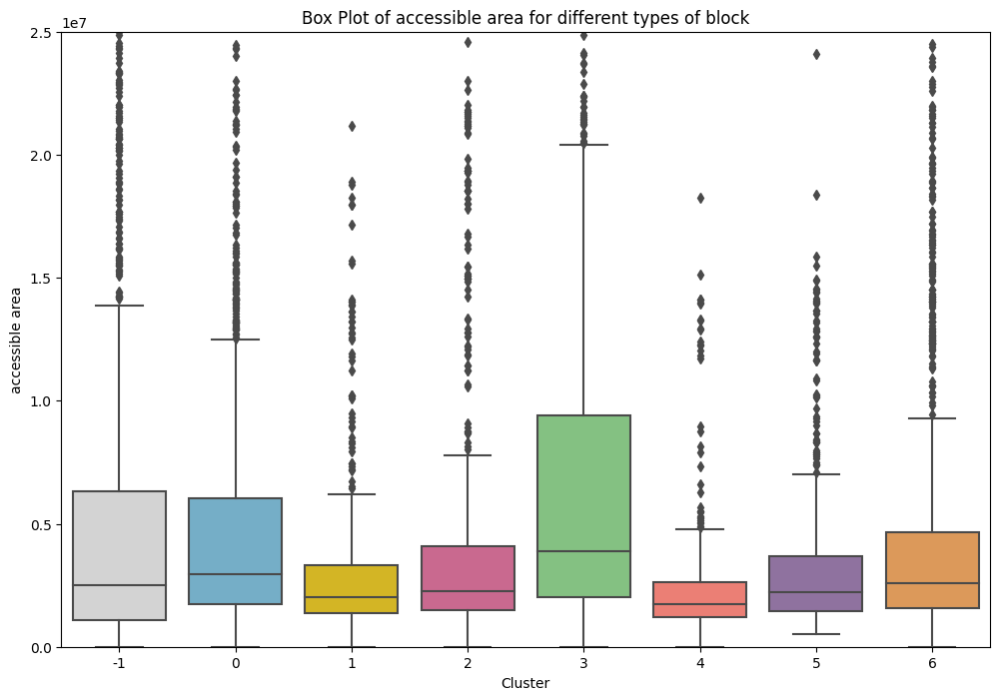

In [190]:
# Create the box plot
plt.figure(figsize=(12, 8))  # Set the figure size for better visibility
sns.boxplot(x='cluster', y='accessible_area', data=block_gdf_joined_accessible_poi,palette=palette)

# Adding titles and labels
plt.ylim(top=25000000,bottom = 0) 

plt.title(f'Box Plot of accessible area for different types of block')
plt.xlabel('Cluster')
plt.ylabel('accessible area')

# Show the plot
plt.show()


In [272]:
plot_df_block_class4 = plot_df[plot_df["cluster_2022"]==4]
plot_df_block_class4 = plot_df[plot_df["cluster_2022"]==4]

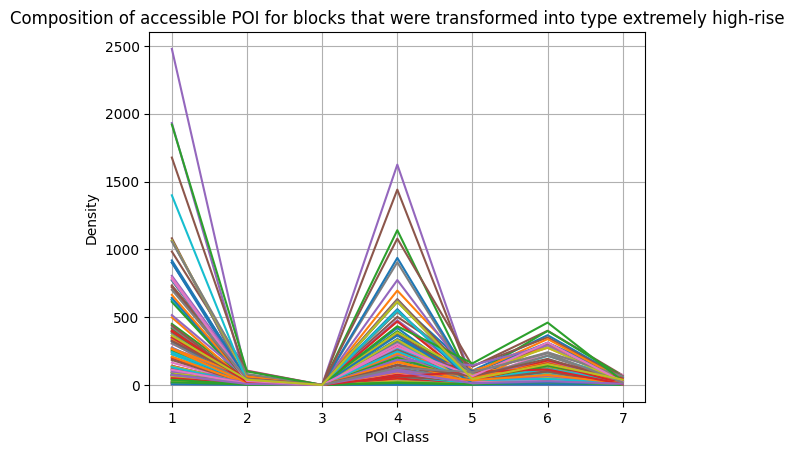

In [275]:
# Iterate through each row in the dataframe
for index, row in plot_df_block_class4.iterrows():
    # Extract the values for columns poi_count_{selected_poi_class}_density
    y_values = row[[f'poi_count_{i}_density' for i in range(1, 8)]].values
    x_values = range(1, 8)  # x-axis values are 1 through 7

    # Plot the values
    plt.plot(x_values, y_values, label=f'Row {index + 1}')

# Add labels and legend
plt.xlabel('POI Class')
plt.ylabel('Density')
plt.title('Composition of accessible POI for blocks that were transformed into type extremely high-rise')
#plt.legend()
plt.grid(True)

# Show the plot
plt.show()

In [264]:
selected_poi_class = 3

In [265]:
plot_df[f"poi_count_{selected_poi_class}_density"] = plot_df[f"poi_count_{selected_poi_class}"]/plot_df["area"]

/data-nfs/mujiang/anaconda3/envs/env_pytorch/lib/python3.8/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


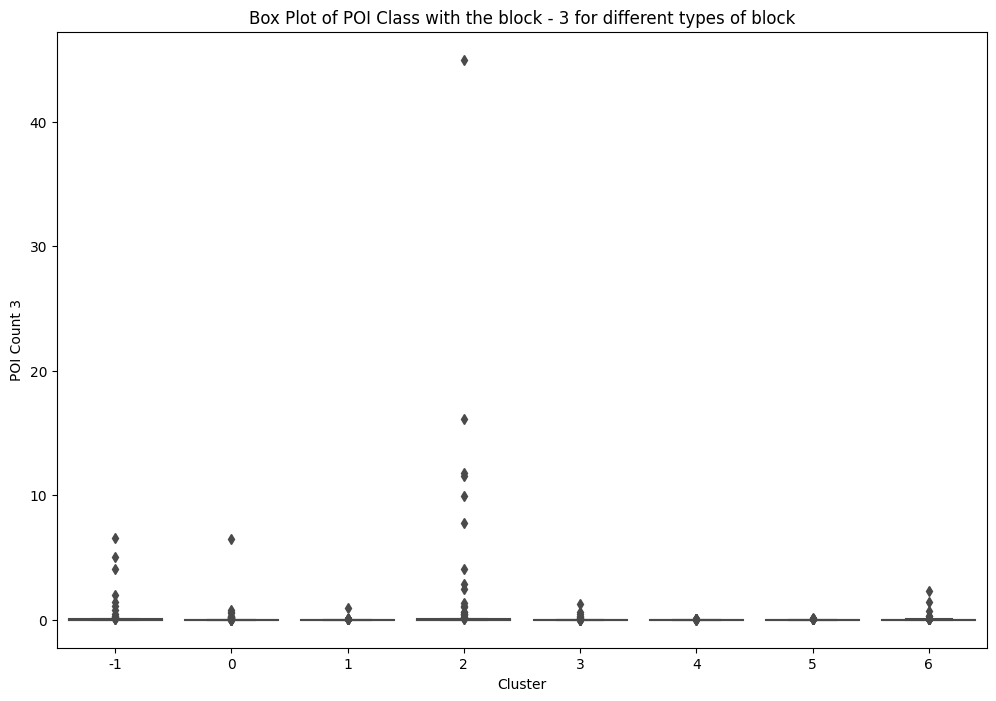

In [267]:
# Create the box plot
plt.figure(figsize=(12, 8))  # Set the figure size for better visibility
sns.boxplot(x='cluster_2022', y=f'poi_count_{selected_poi_class}_density', data=plot_df,palette=palette)

# Adding titles and labels
plt.title(f'Box Plot of POI Class with the block - {selected_poi_class} for different types of block')
plt.xlabel('Cluster')
plt.ylabel(f'POI Count {selected_poi_class}')

# Show the plot
plt.show()

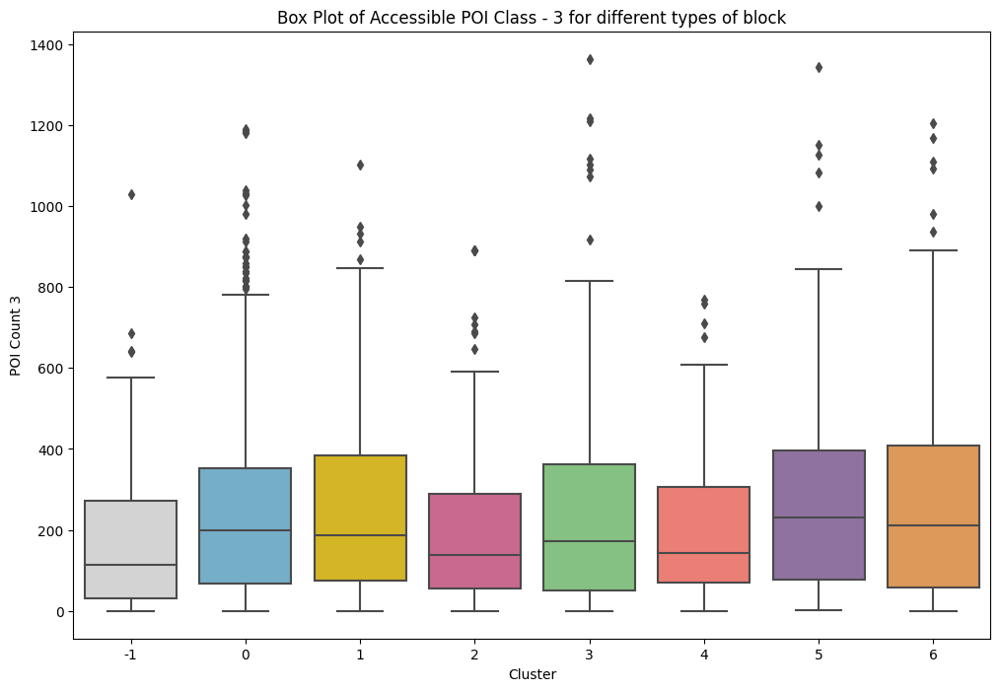

In [268]:
# Create the box plot
plt.figure(figsize=(12, 8))  # Set the figure size for better visibility
sns.boxplot(x='cluster_2022', y=f'poi_count_{selected_poi_class}', data=plot_df,palette=palette)

# Adding titles and labels
plt.title(f'Box Plot of Accessible POI Class - {selected_poi_class} for different types of block')
plt.xlabel('Cluster')
plt.ylabel(f'POI Count {selected_poi_class}')

# Show the plot
plt.show()

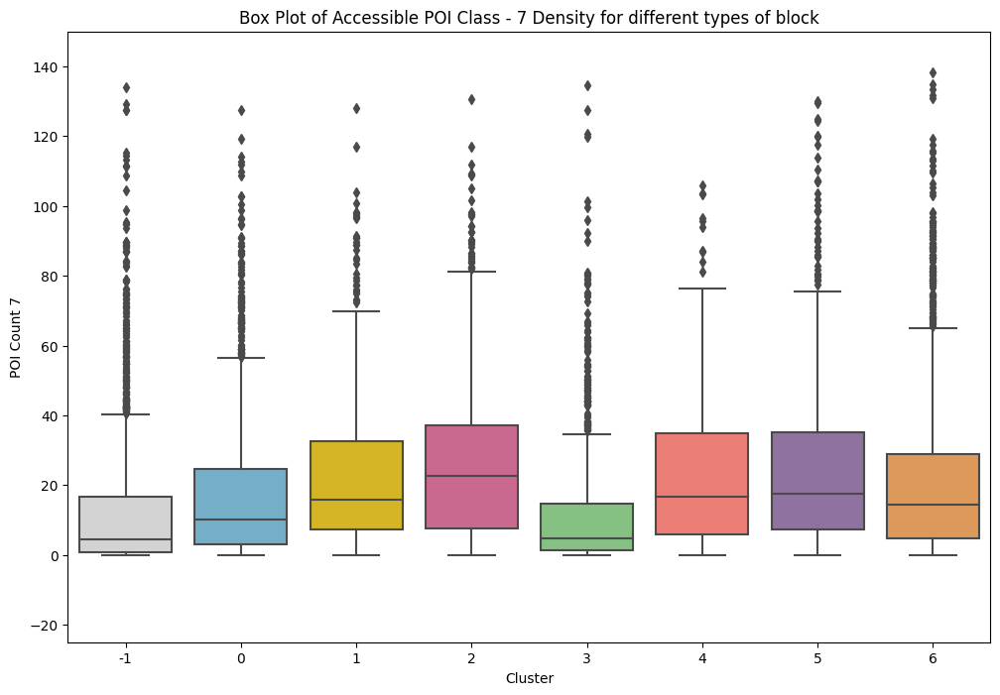

In [214]:
# Create the box plot
plt.figure(figsize=(12, 8))  # Set the figure size for better visibility
sns.boxplot(x='cluster', y=f'poi_count_{selected_poi_class}_density', data=block_gdf_joined_accessible_poi,palette=palette)

plt.ylim(top=150,bottom = -25) 

# Adding titles and labels
plt.title(f'Box Plot of Accessible POI Class - {selected_poi_class} Density for different types of block')
plt.xlabel('Cluster')
plt.ylabel(f'POI Count {selected_poi_class}')

# Show the plot
plt.show()


In [150]:
block_gdf_joined_accessible_poi[block_gdf_joined_accessible_poi["cluster"]==4].sort_values(by="poi_count_3",ascending=False)

,block_id,area,FSI,GSI,cluster,geometry,poi_count_-1,poi_count_1,poi_count_2,poi_count_3,poi_count_4,poi_count_5,poi_count_6,poi_count_7,poi_count_8,poi_count_9,poi_count_10
2473,9963,79414.515546,9.697848,0.103013,4,"POLYGON ((114.02307 22.65002, 114.02294 22.649...",15.0,1812.0,155.0,1001.0,1843.0,254.0,710.0,194.0,94.0,89.0,880.0
2150,6518,34406.572798,26.458637,0.285003,4,"POLYGON ((113.85815 22.58490, 113.85796 22.584...",101.0,2166.0,118.0,822.0,1388.0,150.0,643.0,118.0,71.0,70.0,437.0
2254,8711,31379.382069,17.144006,0.241594,4,"POLYGON ((114.05739 22.62923, 114.05739 22.629...",5.0,1752.0,111.0,794.0,1162.0,118.0,323.0,125.0,74.0,56.0,464.0
2196,14813,269213.061186,9.352383,0.109590,4,"POLYGON ((113.81198 22.73562, 113.81197 22.735...",0.0,1413.0,125.0,780.0,1645.0,159.0,348.0,164.0,51.0,110.0,471.0
2394,2385,17415.603452,21.353780,0.293103,4,"POLYGON ((113.97308 22.54059, 113.97267 22.540...",527.0,966.0,497.0,759.0,1056.0,121.0,458.0,119.0,206.0,182.0,720.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2339,1487,15480.421610,22.987179,0.266272,4,"POLYGON ((113.89276 22.53132, 113.89276 22.531...",14.0,61.0,2.0,1.0,9.0,2.0,58.0,0.0,0.0,7.0,7.0
2357,1646,20248.039507,34.134050,0.350113,4,"POLYGON ((113.89388 22.53146, 113.89388 22.531...",14.0,32.0,1.0,1.0,9.0,1.0,55.0,0.0,0.0,7.0,5.0
2178,6122,18063.842874,18.713924,0.192405,4,"POLYGON ((113.93701 22.57696, 113.93566 22.576...",0.0,36.0,1.0,1.0,8.0,7.0,26.0,1.0,1.0,0.0,18.0
2397,694,13879.328935,22.822660,0.365079,4,"POLYGON ((114.04841 22.51800, 114.04819 22.517...",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
